<a href="https://colab.research.google.com/github/AdepojuJeremy/AI/blob/master/Calibrated_Machine_Learning_for_Disease_Diagnosis_Latest.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Predictive Modelling for Disease Diagnosis using Calibrated Machine Learning: A Comparative Analysis using Spline vs Beta vs Platt Calibration Scaling

# Research Base.

## 1. Abstract

## 2. Introduction

### A. Background and Context

### B. Research Problem Statement

### C. Research Objective

### C. Significance of the Study

### D. Scope

### Limitations

### Overview Of Calibrated Machine Learning

## 3. Literature Review

### A. Overview of Disease Diagnosis Methods.

### B. Machine Learning in Disease Diagnosis.

### C. Calibration in Machine Learning.

### D. Comparative Studies in Healthcare

## 4. Research Methodology

### A. Data Collection.

### B. Feature Selection and Engineering.

### C. Model Selection

### D. Calibration Techniques

### E. Evaluation Metrics

### F. Experimental Set-up

# Code Base

### Subject Matter Information.

### Dataset Information.

### Domain Knowledge.

### Preface.

### 1.Import Libraries and Data

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import colorama
from colorama import Fore, Back, Style

#sklearn package
from sklearn.preprocessing import LabelEncoder
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.feature_selection import RFECV
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn import metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
from sklearn.metrics import matthews_corrcoef
from sklearn.metrics import balanced_accuracy_score
from sklearn.metrics import roc_auc_score
from sklearn.metrics import roc_curve, auc
#import pybaobabdt
#from scipy.io import arff


##keras package
from keras.models import Sequential
from keras.layers import Dense
from keras import layers
from keras.utils import to_categorical

##lime package
import lime
from lime import lime_tabular

import warnings
warnings.filterwarnings("ignore")
import pickle

#Importing necessary libraries for calibration
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import f1_score
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.datasets import make_classification
from sklearn.calibration import CalibratedClassifierCV, calibration_curve
from sklearn.model_selection import cross_val_score, train_test_split
from sklearn.metrics import log_loss, brier_score_loss, roc_auc_score
import ml_insights as mli
mli.__version__
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import log_loss, brier_score_loss, roc_auc_score
from sklearn.isotonic import IsotonicRegression
from sklearn.linear_model import LogisticRegression
from sklearn.calibration import calibration_curve
from betacal import BetaCalibration
from sklearn.metrics import jaccard_score
from sklearn import metrics
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import make_scorer, classification_report, confusion_matrix, accuracy_score
from sklearn.metrics import precision_score, recall_score, f1_score, cohen_kappa_score, average_precision_score
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold
from sklearn.calibration import calibration_curve
import scikitplot as skplt
plt.style.use('fivethirtyeight')
%config InlineBackend.figure_format = 'retina'
%matplotlib inline
from sklearn import metrics
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import make_scorer, classification_report, confusion_matrix, precision_recall_curve
from sklearn.metrics import accuracy_score, brier_score_loss
from sklearn.metrics import precision_score, recall_score, f1_score, cohen_kappa_score, average_precision_score
from sklearn.model_selection import train_test_split, cross_val_score, StratifiedKFold, GridSearchCV
from sklearn.calibration import CalibratedClassifierCV, calibration_curve
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.preprocessing import StandardScaler
from sklearn.feature_selection import SelectKBest, f_classif
from imblearn.over_sampling import SMOTE
from imblearn.under_sampling import RandomUnderSampler
from imblearn.pipeline import make_pipeline
from imblearn.over_sampling import SMOTE
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
#Importing necessary libraries for Modelling
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.metrics import confusion_matrix
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.ensemble import RandomForestClassifier, BaggingClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
#from xgboost import XGBClassifier
from catboost import CatBoostClassifier
from sklearn.naive_bayes import GaussianNB, BernoulliNB
from sklearn.neighbors import KNeighborsClassifier
# "pip install ml_insights" in terminal if needed

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import ml_insights as mli
%matplotlib inline

from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split
from sklearn.metrics import log_loss, brier_score_loss, roc_auc_score

mli.__version__

'1.0.2'

In [ ]:
df = pd.read_csv('Desktop/Downloads/odata.csv', delimiter = ',')

In [ ]:
df.head

<bound method NDFrame.head of      geotype  AGEfinal  Sex  Race  hhinc2  aindex_cat  dwell_typ1  medaid1  \
0          3        17    2     1       2           2           1        1   
1          1        15    1     1       1           1           1        2   
2          1        15    1     1       1           2           1        2   
3          1        15    2     3       2           2           1        2   
4          1        15    2     1       2           1           1        2   
..       ...       ...  ...   ...     ...         ...         ...      ...   
666        1        15    1     3       3           3           1        1   
667        1        15    2     3       3           1           1        2   
668        1        17    2     1       3           2           1        2   
669        3        16    1     1       1           1           1        2   
670        4        16    2     1       2           2           1        2   

     agric_animal1  Hunger_cat1  

In [ ]:
df.tail

<bound method NDFrame.tail of      geotype  AGEfinal  Sex  Race  hhinc2  aindex_cat  dwell_typ1  medaid1  \
0          3        17    2     1       2           2           1        1   
1          1        15    1     1       1           1           1        2   
2          1        15    1     1       1           2           1        2   
3          1        15    2     3       2           2           1        2   
4          1        15    2     1       2           1           1        2   
..       ...       ...  ...   ...     ...         ...         ...      ...   
666        1        15    1     3       3           3           1        1   
667        1        15    2     3       3           1           1        2   
668        1        17    2     1       3           2           1        2   
669        3        16    1     1       1           1           1        2   
670        4        16    2     1       2           2           1        2   

     agric_animal1  Hunger_cat1  

In [ ]:
df.head()

,geotype,AGEfinal,Sex,Race,hhinc2,aindex_cat,dwell_typ1,medaid1,agric_animal1,Hunger_cat1,...,physical_activity,Healthcare_access2yr,famhist_hbp,famhist_diabetes,famhist_heartdis,redmeat_wfat,milkserv_daily,snack_freq,overweight,AuditC3_MF1
0,3,17,2,1,2,2,1,1,2,1,...,1,1,2,2,2,1,5,2,1,2
1,1,15,1,1,1,1,1,2,2,2,...,2,1,1,2,2,1,3,1,1,2
2,1,15,1,1,1,2,1,2,2,3,...,2,2,1,1,2,1,3,2,0,2
3,1,15,2,3,2,2,1,2,2,1,...,2,2,1,1,1,2,5,1,0,2
4,1,15,2,1,2,1,1,2,2,1,...,1,2,1,1,2,1,4,1,1,2


In [ ]:
df.tail()

,geotype,AGEfinal,Sex,Race,hhinc2,aindex_cat,dwell_typ1,medaid1,agric_animal1,Hunger_cat1,...,physical_activity,Healthcare_access2yr,famhist_hbp,famhist_diabetes,famhist_heartdis,redmeat_wfat,milkserv_daily,snack_freq,overweight,AuditC3_MF1
666,1,15,1,3,3,3,1,1,2,1,...,2,2,2,2,2,2,4,2,0,2
667,1,15,2,3,3,1,1,2,2,1,...,2,2,1,2,1,1,2,1,0,2
668,1,17,2,1,3,2,1,2,2,2,...,1,1,2,2,2,1,1,2,0,2
669,3,16,1,1,1,1,1,2,2,3,...,2,2,2,2,2,1,3,2,0,2
670,4,16,2,1,2,2,1,2,2,1,...,2,1,2,2,2,1,1,2,0,2


### 3.| Data Processing.

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 671 entries, 0 to 670
Data columns (total 32 columns):
 #   Column                Non-Null Count  Dtype
---  ------                --------------  -----
 0   geotype               671 non-null    int64
 1   AGEfinal              671 non-null    int64
 2   Sex                   671 non-null    int64
 3   Race                  671 non-null    int64
 4   hhinc2                671 non-null    int64
 5   aindex_cat            671 non-null    int64
 6   dwell_typ1            671 non-null    int64
 7   medaid1               671 non-null    int64
 8   agric_animal1         671 non-null    int64
 9   Hunger_cat1           671 non-null    int64
 10  weightloss_attempt    671 non-null    int64
 11  weightgain_attempt    671 non-null    int64
 12  SBPfinal              671 non-null    int64
 13  DBPfinal              671 non-null    int64
 14  Cursmoker             671 non-null    int64
 15  Psych_dist2           671 non-null    int64
 16  buttersp

In [ ]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
geotype,671.0,2.156483,1.122743,1.0,1.0,2.0,3.0,4.0
AGEfinal,671.0,16.004471,0.854301,15.0,15.0,16.0,17.0,17.0
Sex,671.0,1.558867,0.496893,1.0,1.0,2.0,2.0,2.0
Race,671.0,1.529061,0.924931,1.0,1.0,1.0,2.0,4.0
hhinc2,671.0,2.183308,1.039843,1.0,1.0,2.0,3.0,4.0
aindex_cat,671.0,1.591654,0.757168,1.0,1.0,1.0,2.0,4.0
dwell_typ1,671.0,1.204173,0.403397,1.0,1.0,1.0,1.0,2.0
medaid1,671.0,1.885246,0.318963,1.0,2.0,2.0,2.0,2.0
agric_animal1,671.0,1.941878,0.234149,1.0,2.0,2.0,2.0,2.0
Hunger_cat1,671.0,2.010432,0.878369,1.0,1.0,2.0,3.0,3.0


In [ ]:
df.shape

(671, 32)

In [ ]:
df.columns

Index(['geotype', 'AGEfinal', 'Sex', 'Race', 'hhinc2', 'aindex_cat',
       'dwell_typ1', 'medaid1', 'agric_animal1', 'Hunger_cat1',
       'weightloss_attempt', 'weightgain_attempt', 'SBPfinal', 'DBPfinal',
       'Cursmoker', 'Psych_dist2', 'butterspread', 'scores_sugar',
       'scores_fruit', 'NutriKnowA_cat', 'DDScat1', 'CategoricalFatScore1',
       'physical_activity', 'Healthcare_access2yr', 'famhist_hbp',
       'famhist_diabetes', 'famhist_heartdis', 'redmeat_wfat',
       'milkserv_daily', 'snack_freq', 'overweight', 'AuditC3_MF1'],
      dtype='object')

In [ ]:
df.nunique()

geotype                  4
AGEfinal                 3
Sex                      2
Race                     4
hhinc2                   4
aindex_cat               4
dwell_typ1               2
medaid1                  2
agric_animal1            2
Hunger_cat1              3
weightloss_attempt       2
weightgain_attempt       2
SBPfinal                64
DBPfinal                48
Cursmoker                2
Psych_dist2              2
butterspread             5
scores_sugar             3
scores_fruit             3
NutriKnowA_cat           3
DDScat1                  2
CategoricalFatScore1     2
physical_activity        2
Healthcare_access2yr     2
famhist_hbp              2
famhist_diabetes         2
famhist_heartdis         2
redmeat_wfat             2
milkserv_daily           5
snack_freq               2
overweight               2
AuditC3_MF1              2
dtype: int64

In [ ]:
df.isnull().sum()

geotype                 0
AGEfinal                0
Sex                     0
Race                    0
hhinc2                  0
aindex_cat              0
dwell_typ1              0
medaid1                 0
agric_animal1           0
Hunger_cat1             0
weightloss_attempt      0
weightgain_attempt      0
SBPfinal                0
DBPfinal                0
Cursmoker               0
Psych_dist2             0
butterspread            0
scores_sugar            0
scores_fruit            0
NutriKnowA_cat          0
DDScat1                 0
CategoricalFatScore1    0
physical_activity       0
Healthcare_access2yr    0
famhist_hbp             0
famhist_diabetes        0
famhist_heartdis        0
redmeat_wfat            0
milkserv_daily          0
snack_freq              0
overweight              0
AuditC3_MF1             0
dtype: int64

### 4| Data Analysis

### A. Univariate Analysis

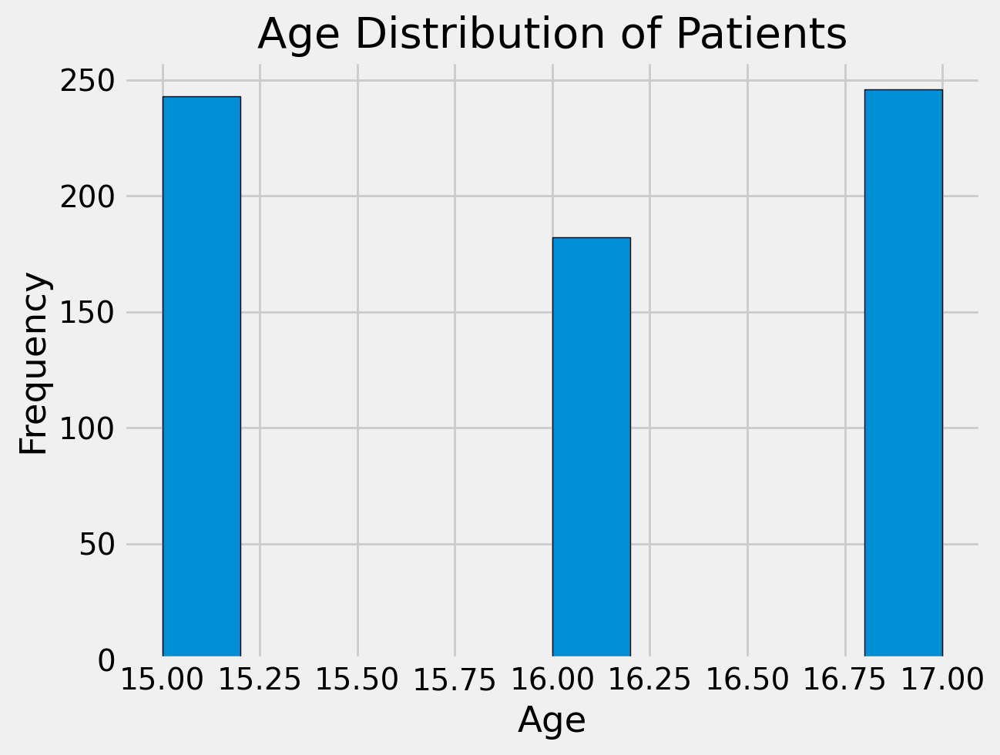

In [ ]:
plt.hist(df['AGEfinal'], bins=10, edgecolor='black')
plt.title('Age Distribution of Patients')
plt.xlabel('Age')
plt.ylabel('Frequency')
plt.show()

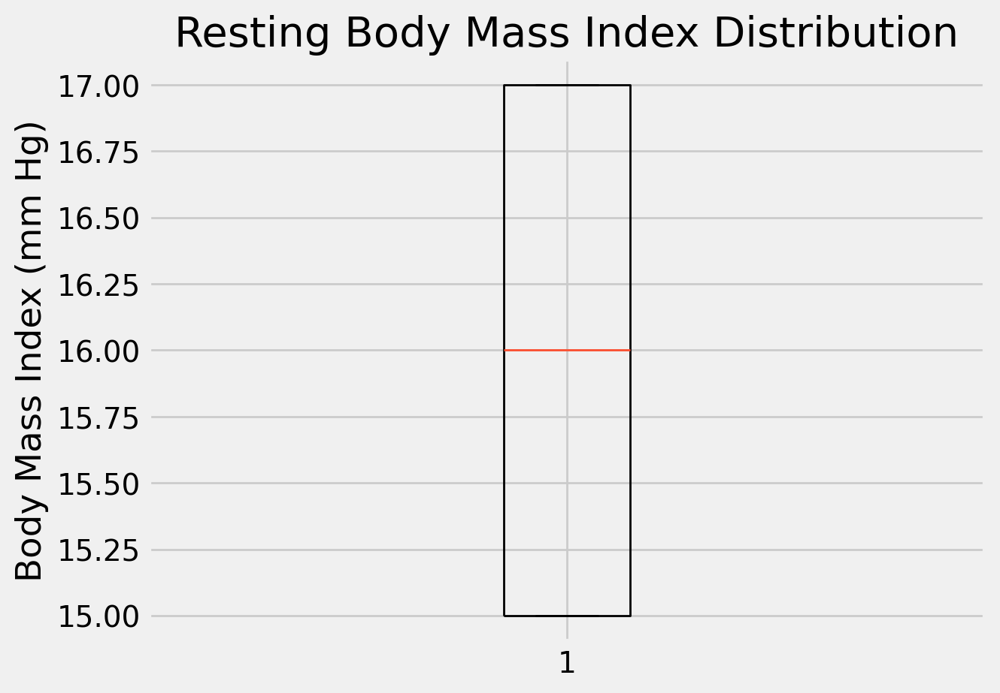

In [ ]:
plt.boxplot(df['AGEfinal'])
plt.title('Resting Body Mass Index Distribution')
plt.ylabel('Body Mass Index (mm Hg)')
plt.show()

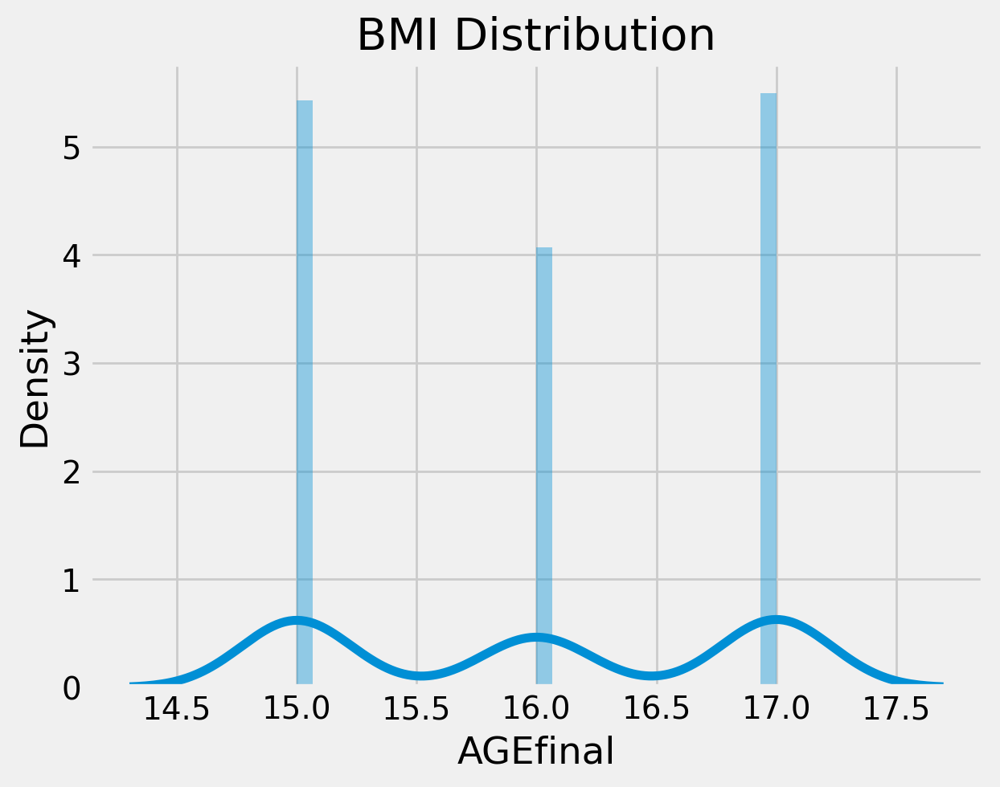

In [ ]:
# Distribution plot for BMI
sns.distplot(df['AGEfinal'], bins=30)
plt.title('BMI Distribution')
plt.show()

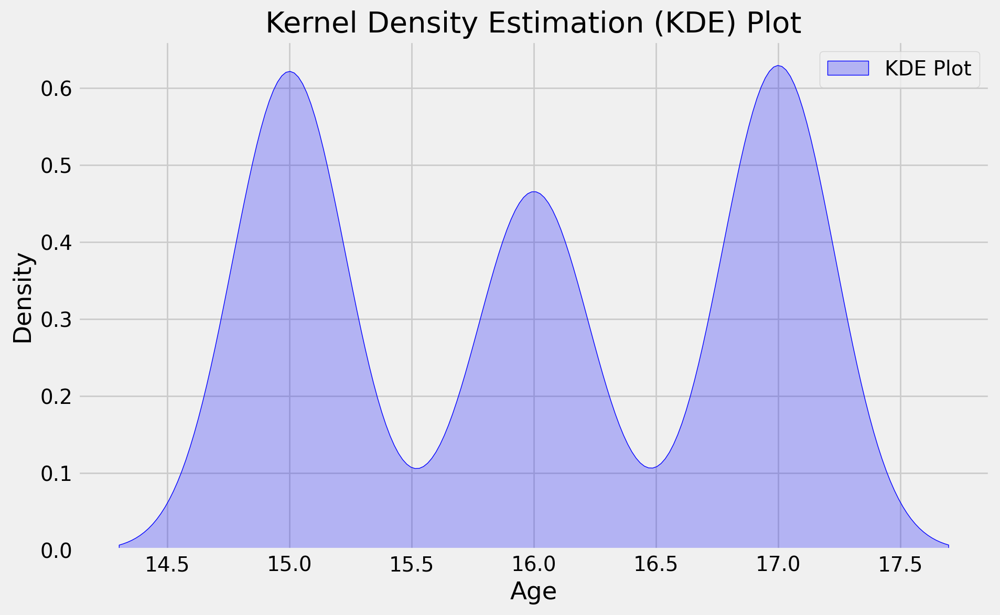

In [ ]:
plt.figure(figsize=(10,6))
sns.kdeplot(df['AGEfinal'], shade=True, color='blue',label='KDE Plot')
plt.xlabel('Age')
plt.ylabel('Density')
plt.title('Kernel Density Estimation (KDE) Plot')
plt.legend()
plt.show()

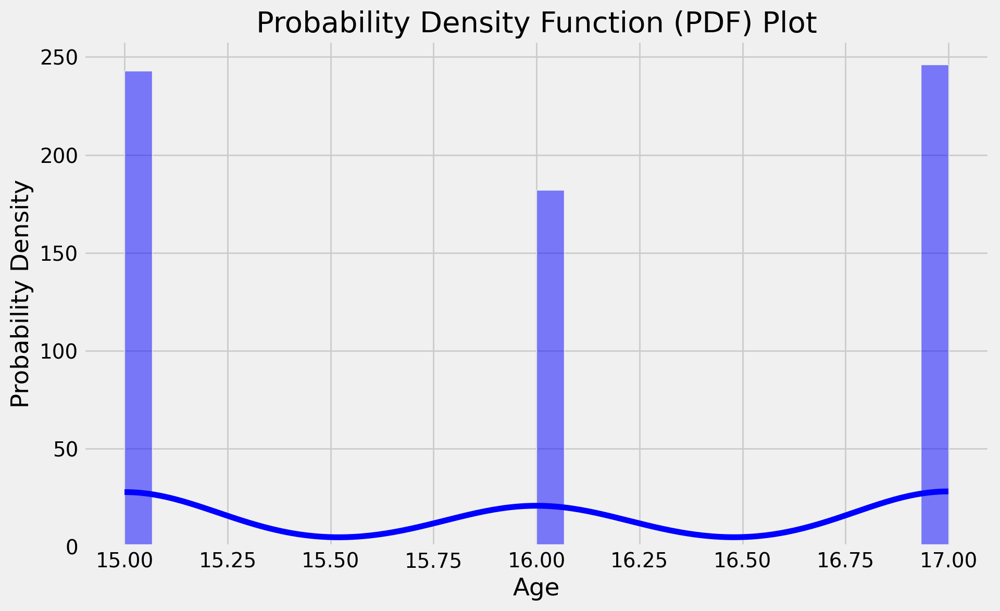

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your PDF plot
sns.histplot(data=df['AGEfinal'], kde=True, color='blue', bins=30)
# Replace 'column_name' with the name of the column you want to plot

# Add labels and title
plt.xlabel('Age')
plt.ylabel('Probability Density')
plt.title('Probability Density Function (PDF) Plot')

# Show the plot
plt.show()

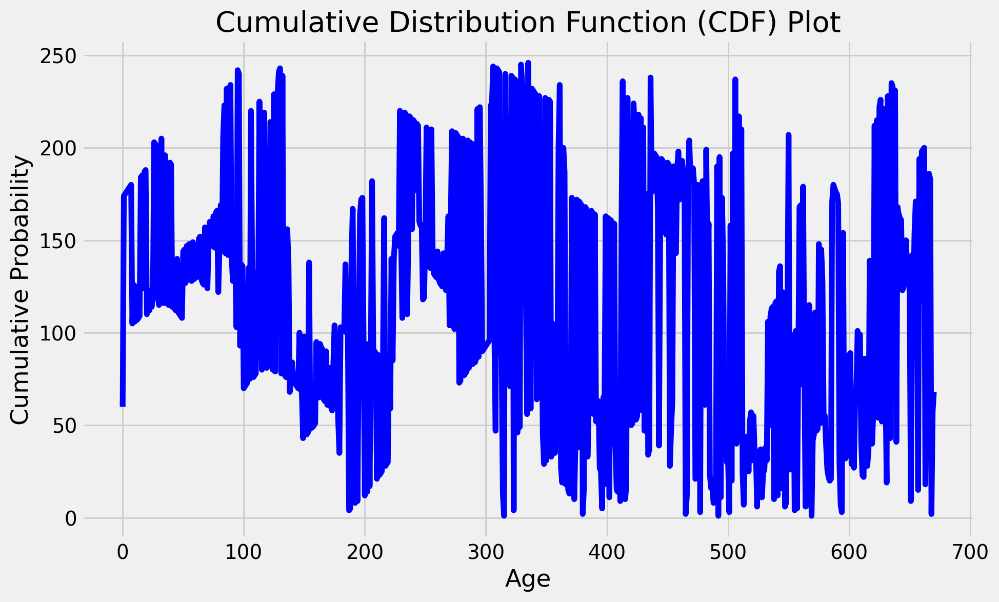

In [ ]:
# Sort the data (if it's not already sorted) for CDF calculation
df_sorted = df.sort_values(by='AGEfinal')
# Replace 'column_name' with the name of the column you want to use

# Create a cumulative count series
cdf = df_sorted.groupby('AGEfinal').cumcount() + 1

# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your CDF plot
sns.lineplot(data=cdf, color='blue')

# Add labels and title
plt.xlabel('Age')
plt.ylabel('Cumulative Probability')
plt.title('Cumulative Distribution Function (CDF) Plot')

# Show the plot
plt.show()

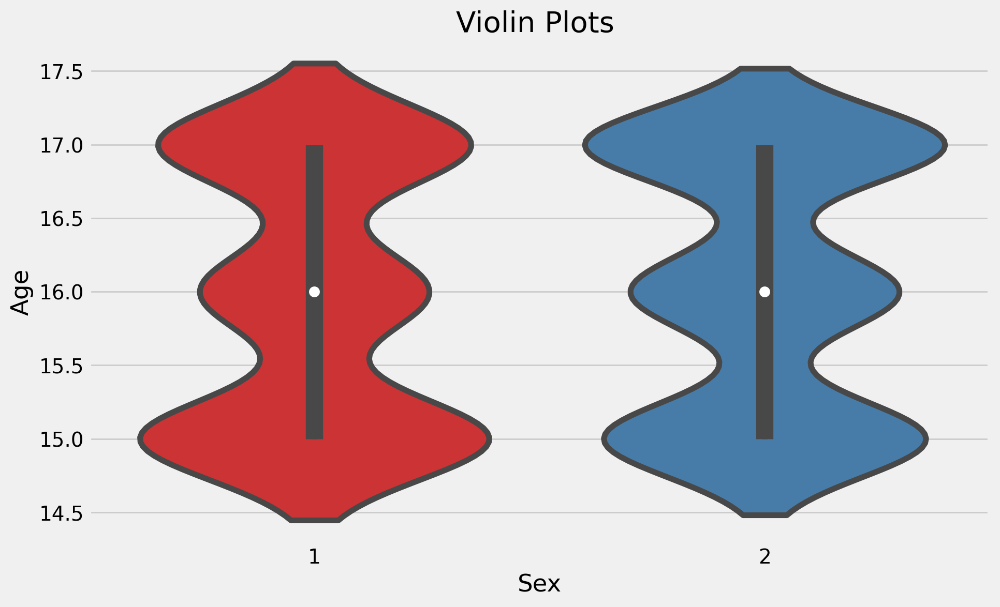

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your violin plot
sns.violinplot(x='Sex', y='AGEfinal', data=df, palette='Set1')
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Sex')
plt.ylabel('Age')
plt.title('Violin Plots ')

# Show the plot
plt.show()

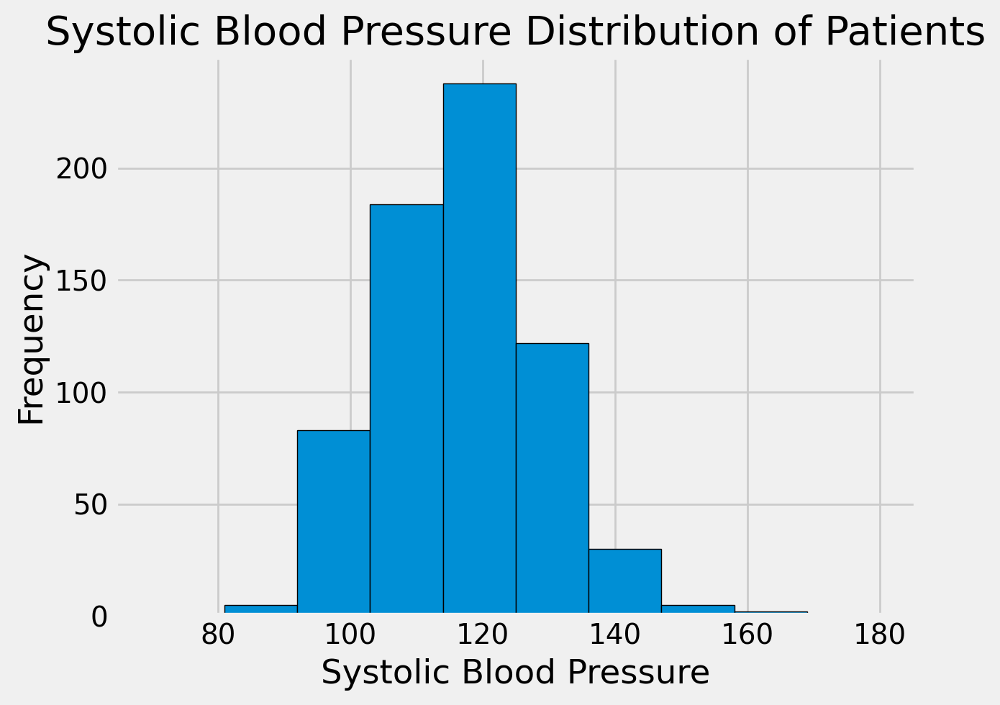

In [ ]:
plt.hist(df['SBPfinal'], bins=10, edgecolor='black')
plt.title('Systolic Blood Pressure Distribution of Patients')
plt.xlabel('Systolic Blood Pressure')
plt.ylabel('Frequency')
plt.show()

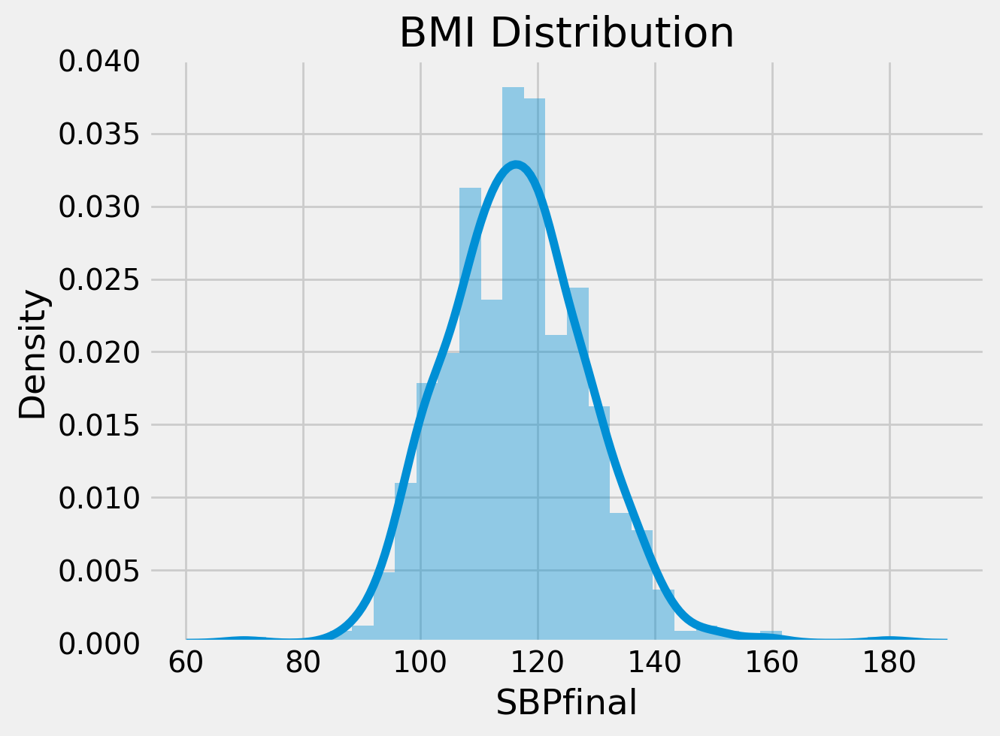

In [ ]:
# Distribution plot for BMI
sns.distplot(df['SBPfinal'], bins=30)
plt.title('BMI Distribution')
plt.show()

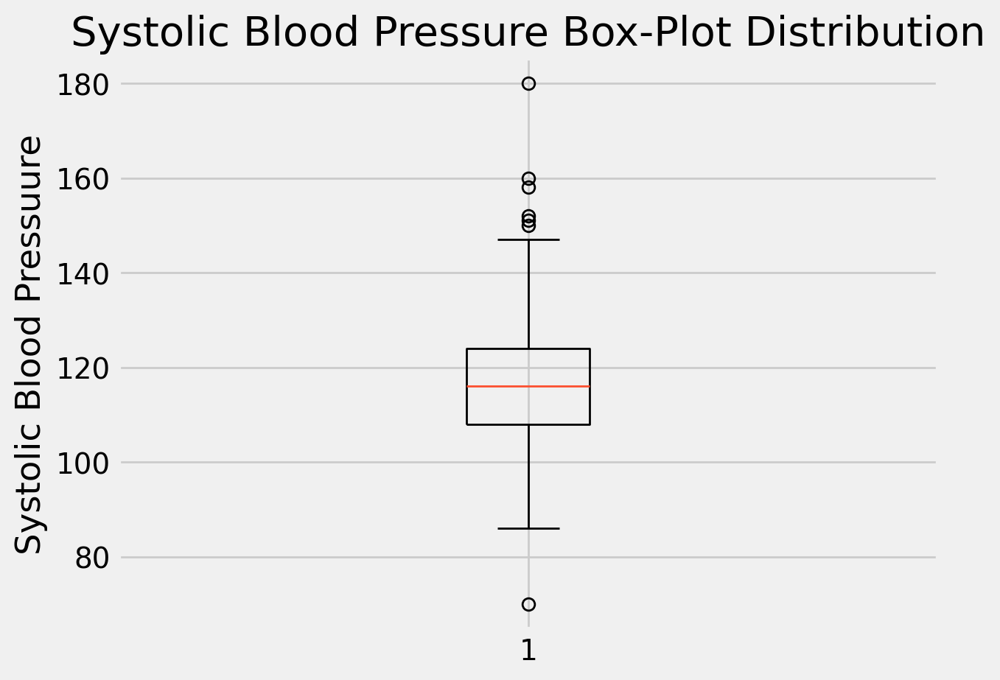

In [ ]:
plt.boxplot(df['SBPfinal'])
plt.title('Systolic Blood Pressure Box-Plot Distribution')
plt.ylabel('Systolic Blood Pressuure')
plt.show()

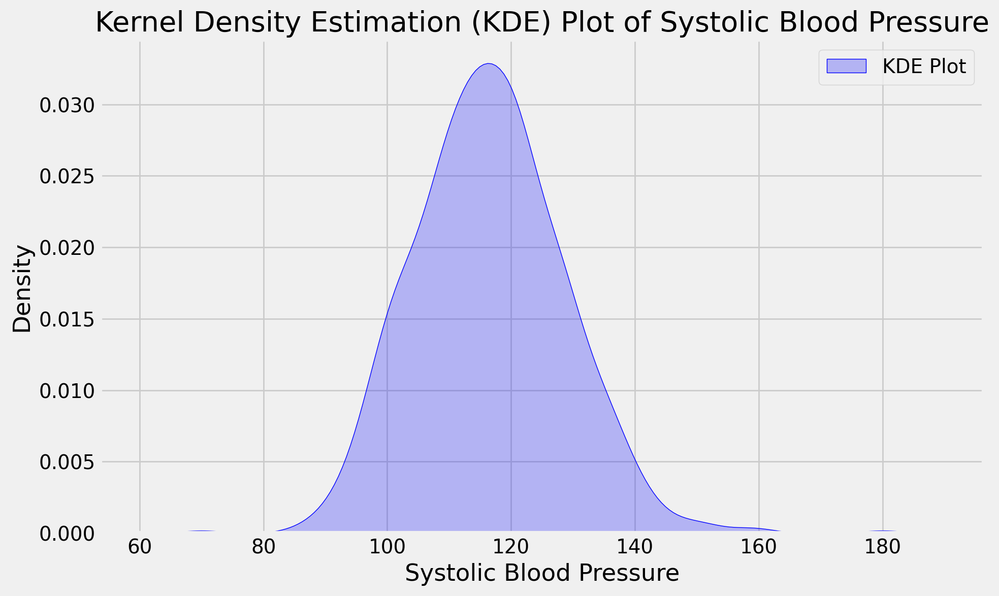

In [ ]:
plt.figure(figsize=(10,6))
sns.kdeplot(df['SBPfinal'], shade=True, color='blue',label='KDE Plot')
plt.xlabel('Systolic Blood Pressure')
plt.ylabel('Density')
plt.title('Kernel Density Estimation (KDE) Plot of Systolic Blood Pressure')
plt.legend()
plt.show()

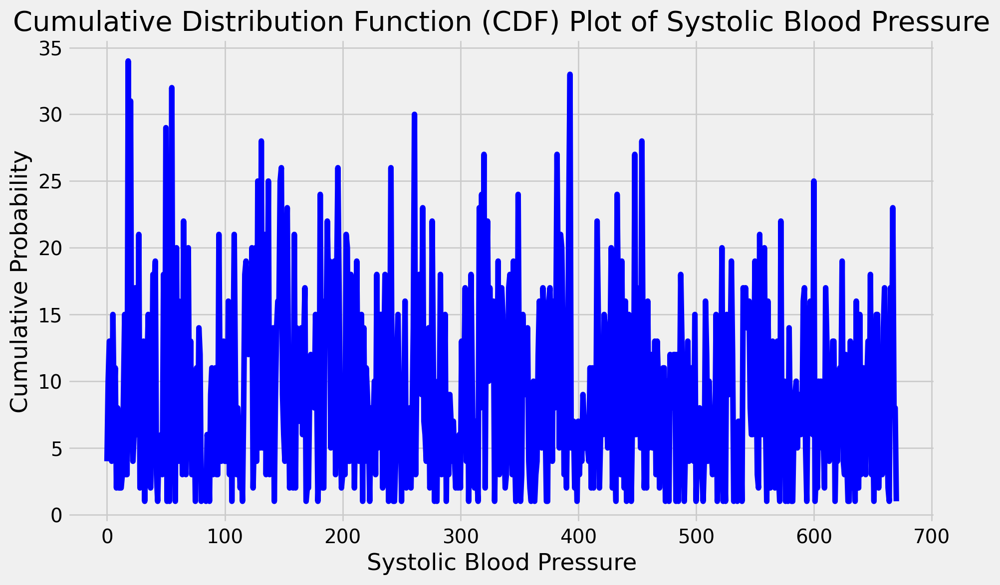

In [ ]:
# Sort the data (if it's not already sorted) for CDF calculation
df_sorted = df.sort_values(by='SBPfinal')
# Replace 'column_name' with the name of the column you want to use

# Create a cumulative count series
cdf = df_sorted.groupby('SBPfinal').cumcount() + 1

# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your CDF plot
sns.lineplot(data=cdf, color='blue')

# Add labels and title
plt.xlabel('Systolic Blood Pressure')
plt.ylabel('Cumulative Probability')
plt.title('Cumulative Distribution Function (CDF) Plot of Systolic Blood Pressure')

# Show the plot
plt.show()

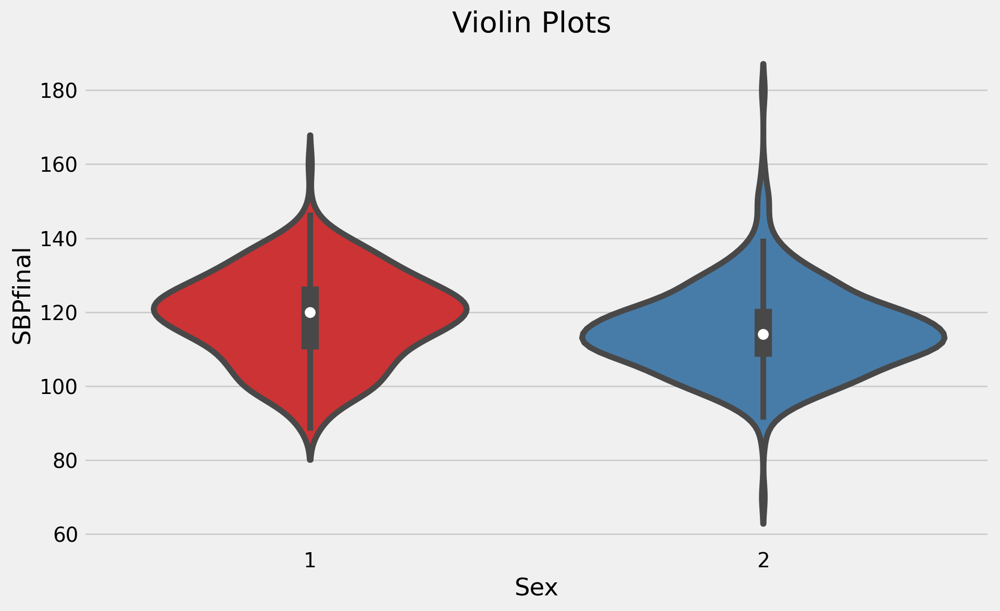

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your violin plot
sns.violinplot(x='Sex', y='SBPfinal', data=df, palette='Set1')
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Sex')
plt.ylabel('SBPfinal')
plt.title('Violin Plots ')

# Show the plot
plt.show()

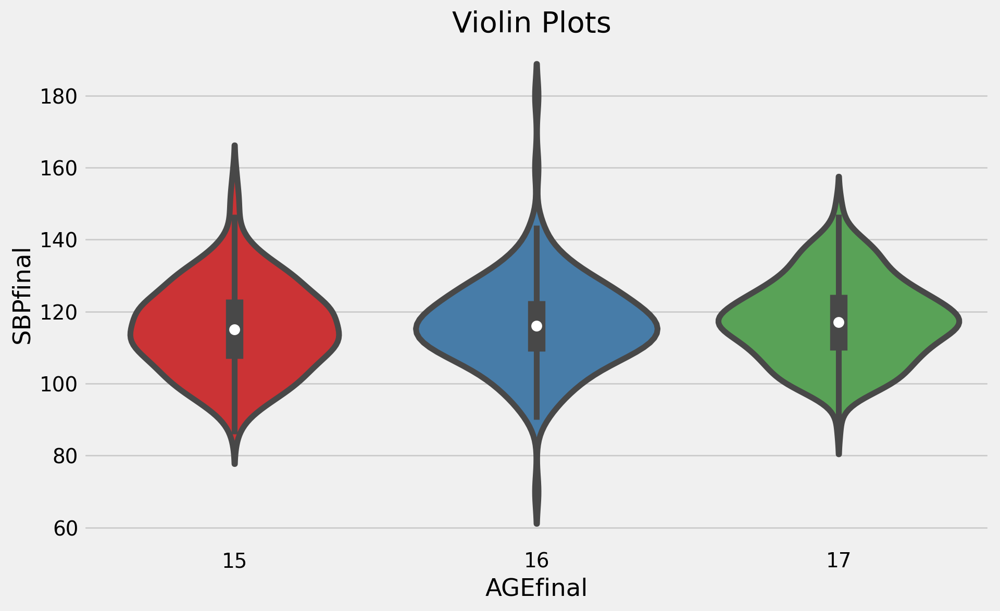

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your violin plot
sns.violinplot(x='AGEfinal', y='SBPfinal', data=df, palette='Set1')
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('AGEfinal')
plt.ylabel('SBPfinal')
plt.title('Violin Plots ')

# Show the plot
plt.show()

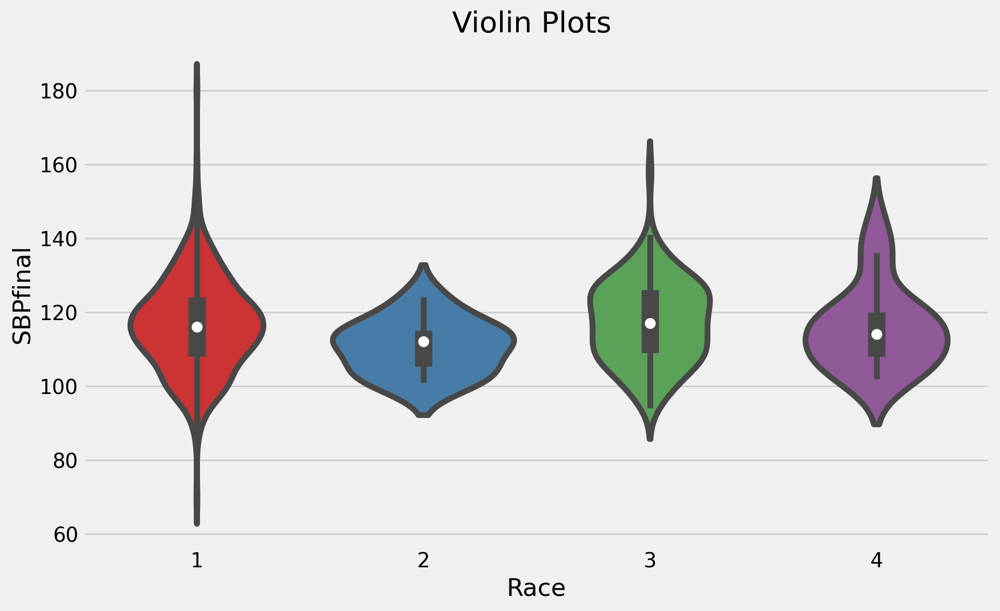

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your violin plot
sns.violinplot(x='Race', y='SBPfinal', data=df, palette='Set1')
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Race')
plt.ylabel('SBPfinal')
plt.title('Violin Plots ')

# Show the plot
plt.show()

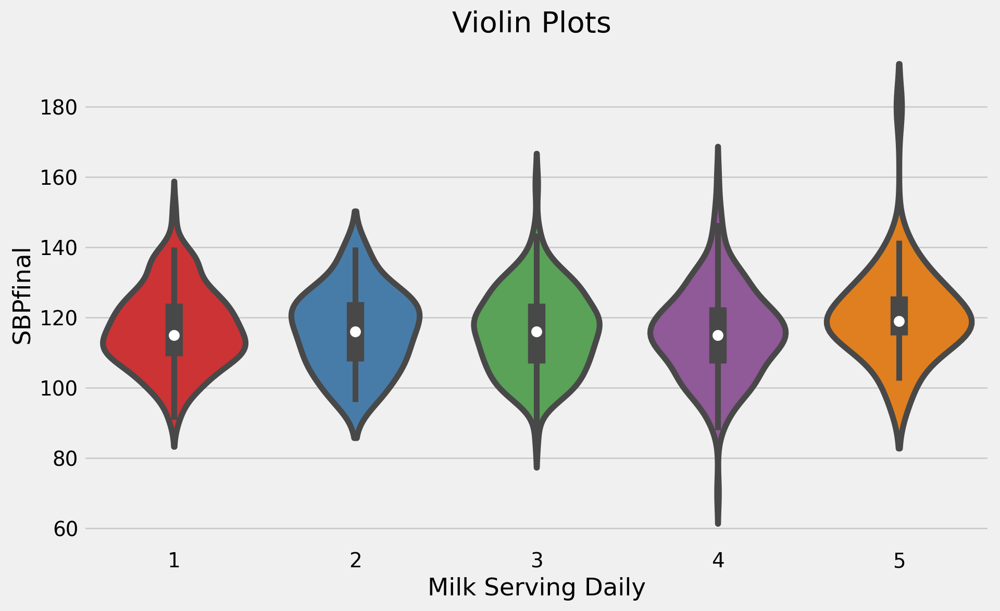

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your violin plot
sns.violinplot(x='milkserv_daily', y='SBPfinal', data=df, palette='Set1')
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Milk Serving Daily')
plt.ylabel('SBPfinal')
plt.title('Violin Plots ')

# Show the plot
plt.show()



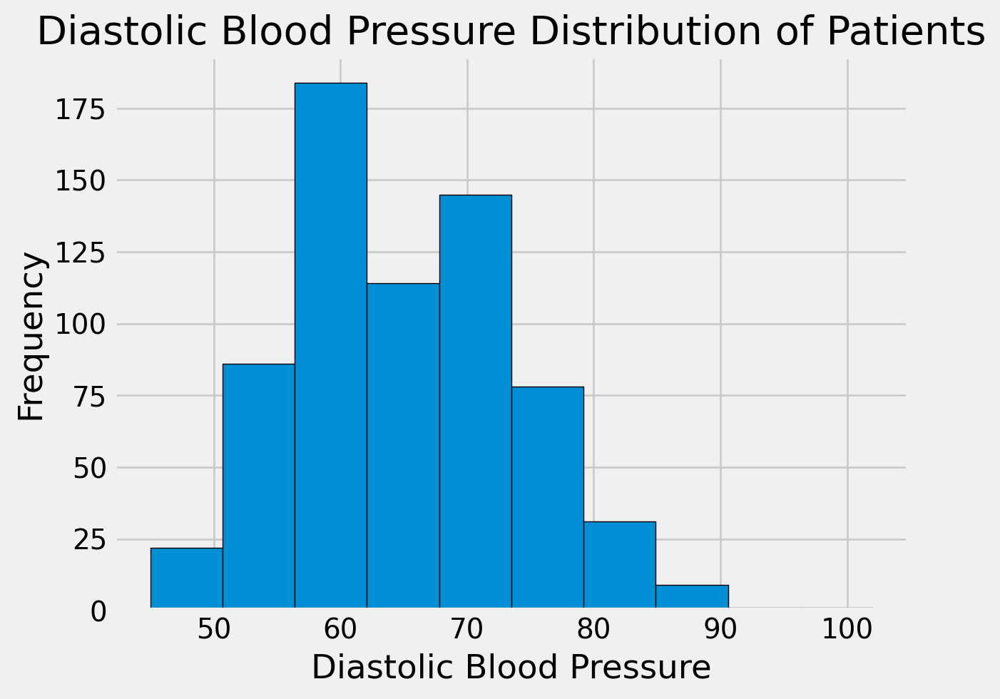

In [ ]:
plt.hist(df['DBPfinal'], bins=10, edgecolor='black')
plt.title('Diastolic Blood Pressure Distribution of Patients')
plt.xlabel('Diastolic Blood Pressure')
plt.ylabel('Frequency')
plt.show()

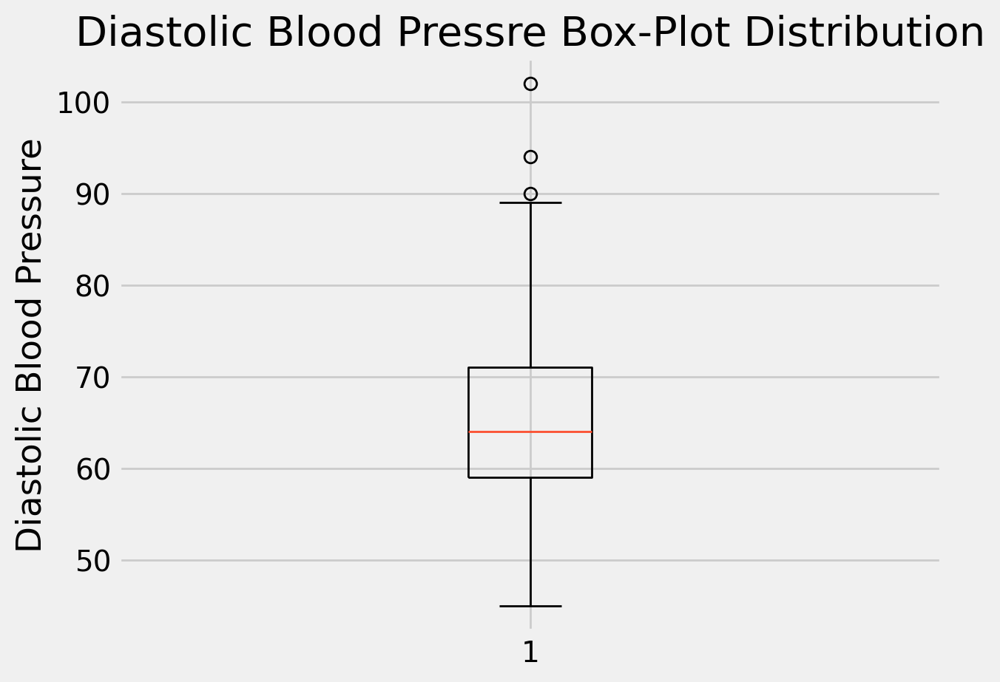

In [ ]:
plt.boxplot(df['DBPfinal'])
plt.title('Diastolic Blood Pressre Box-Plot Distribution')
plt.ylabel('Diastolic Blood Pressure')
plt.show()

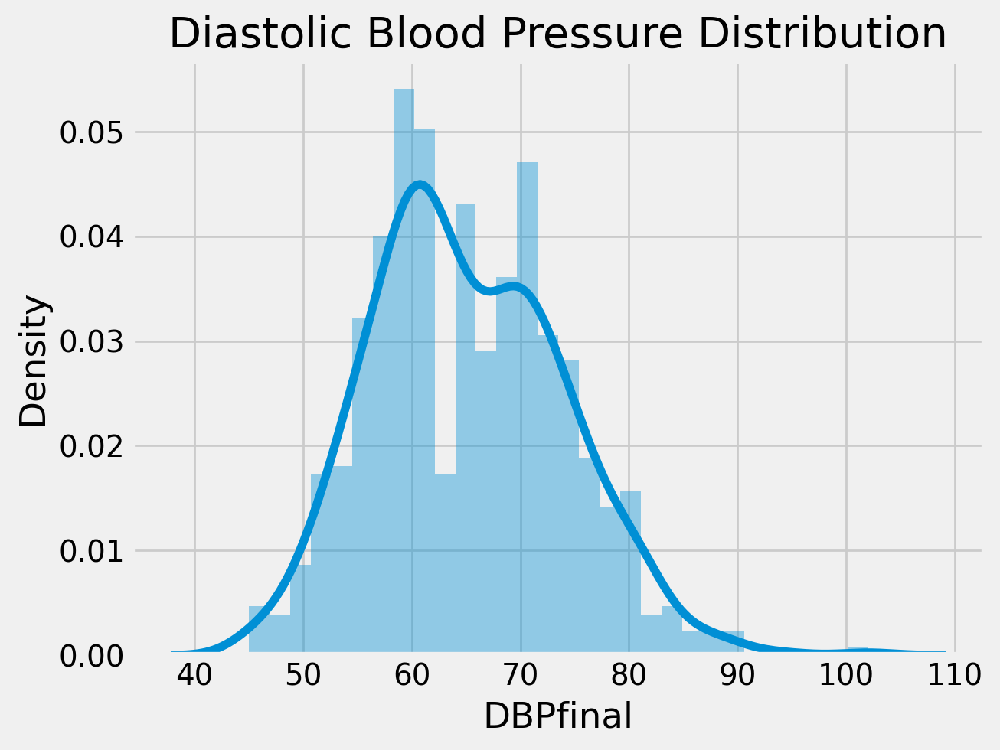

In [ ]:
# Distribution plot for BMI
sns.distplot(df['DBPfinal'], bins=30)
plt.title('Diastolic Blood Pressure Distribution')
plt.show()

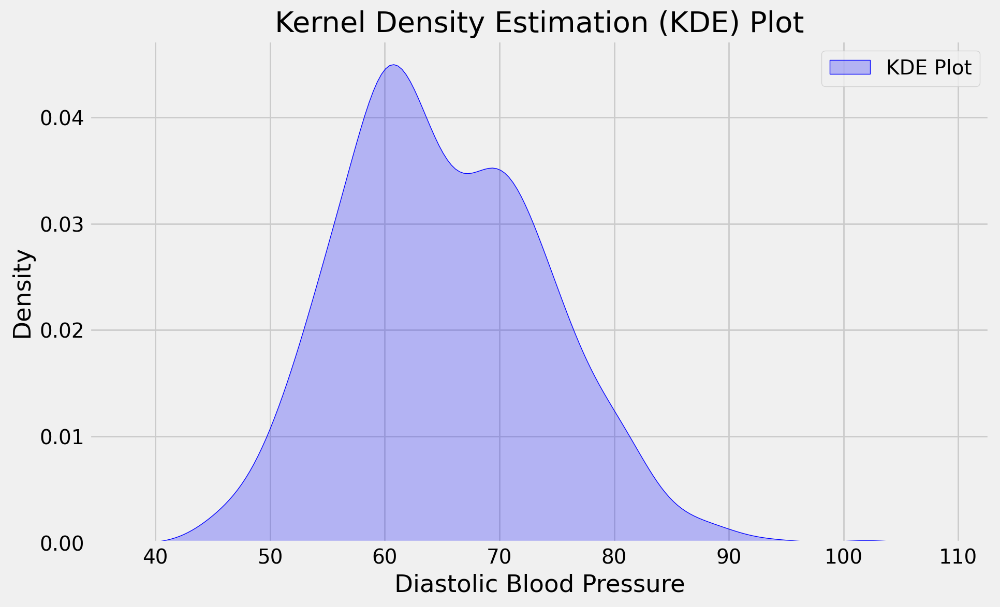

In [ ]:
plt.figure(figsize=(10,6))
sns.kdeplot(df['DBPfinal'], shade=True, color='blue',label='KDE Plot')
plt.xlabel('Diastolic Blood Pressure')
plt.ylabel('Density')
plt.title('Kernel Density Estimation (KDE) Plot')
plt.legend()
plt.show()

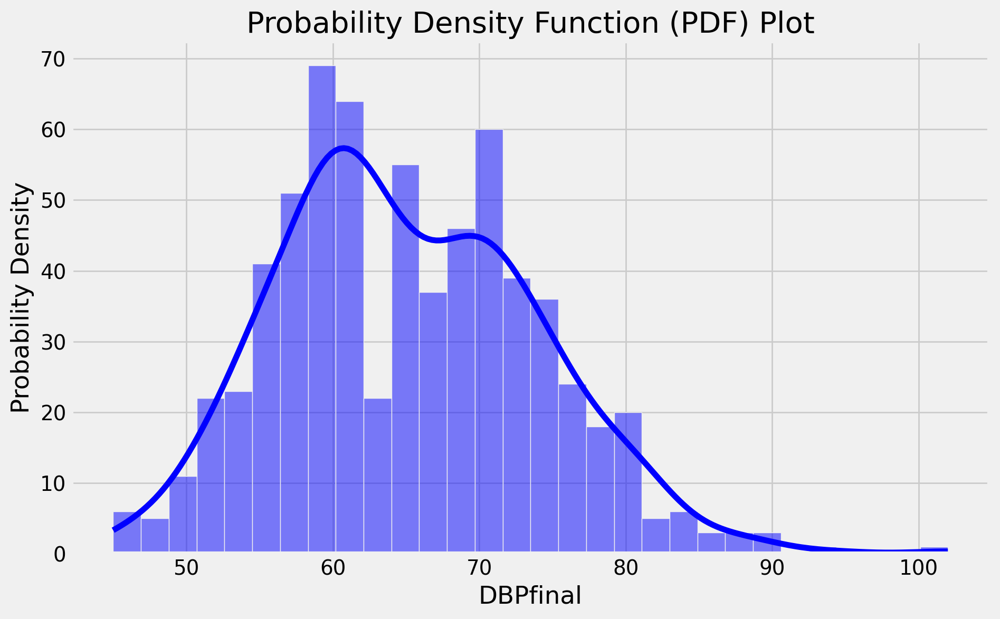

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your PDF plot
sns.histplot(data=df['DBPfinal'], kde=True, color='blue', bins=30)
# Replace 'column_name' with the name of the column you want to plot

# Add labels and title
plt.xlabel('DBPfinal')
plt.ylabel('Probability Density')
plt.title('Probability Density Function (PDF) Plot')

# Show the plot
plt.show()

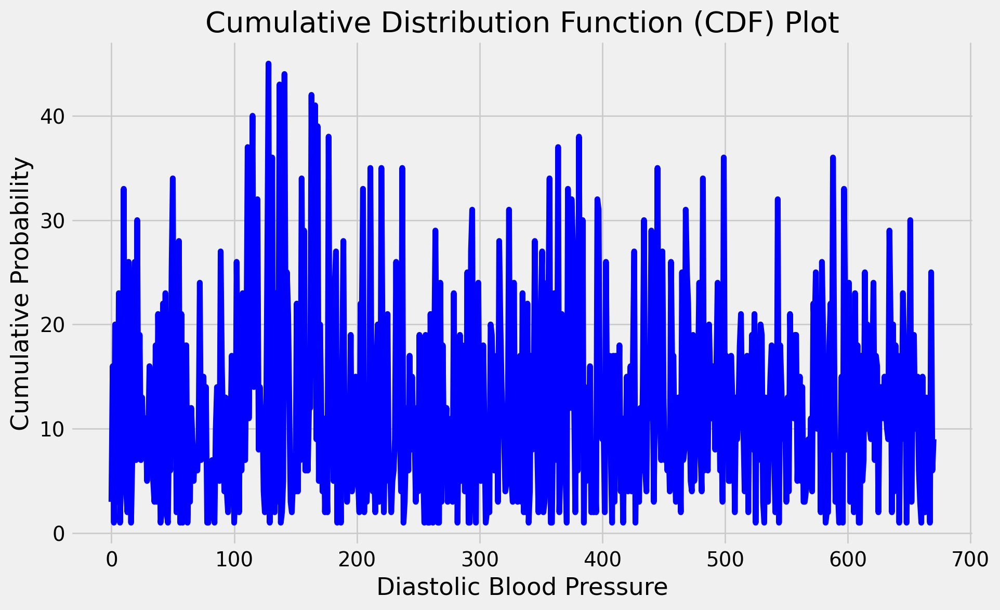

In [ ]:
# Sort the data (if it's not already sorted) for CDF calculation
df_sorted = df.sort_values(by='DBPfinal')
# Replace 'column_name' with the name of the column you want to use

# Create a cumulative count series
cdf = df_sorted.groupby('DBPfinal').cumcount() + 1

# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your CDF plot
sns.lineplot(data=cdf, color='blue')

# Add labels and title
plt.xlabel('Diastolic Blood Pressure')
plt.ylabel('Cumulative Probability')
plt.title('Cumulative Distribution Function (CDF) Plot')

# Show the plot
plt.show()

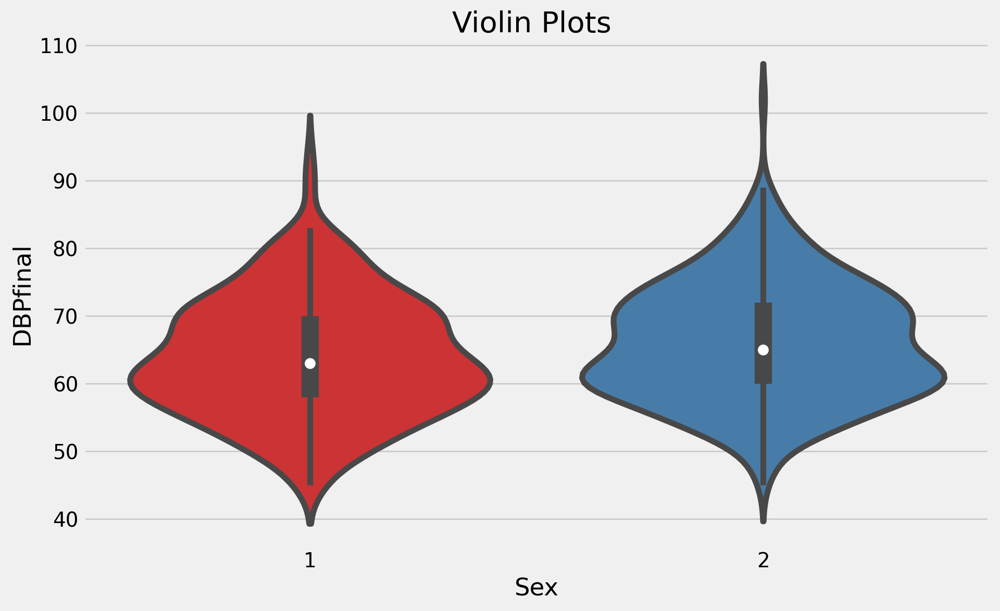

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your violin plot
sns.violinplot(x='Sex', y='DBPfinal', data=df, palette='Set1')
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Sex')
plt.ylabel('DBPfinal')
plt.title('Violin Plots ')

# Show the plot
plt.show()

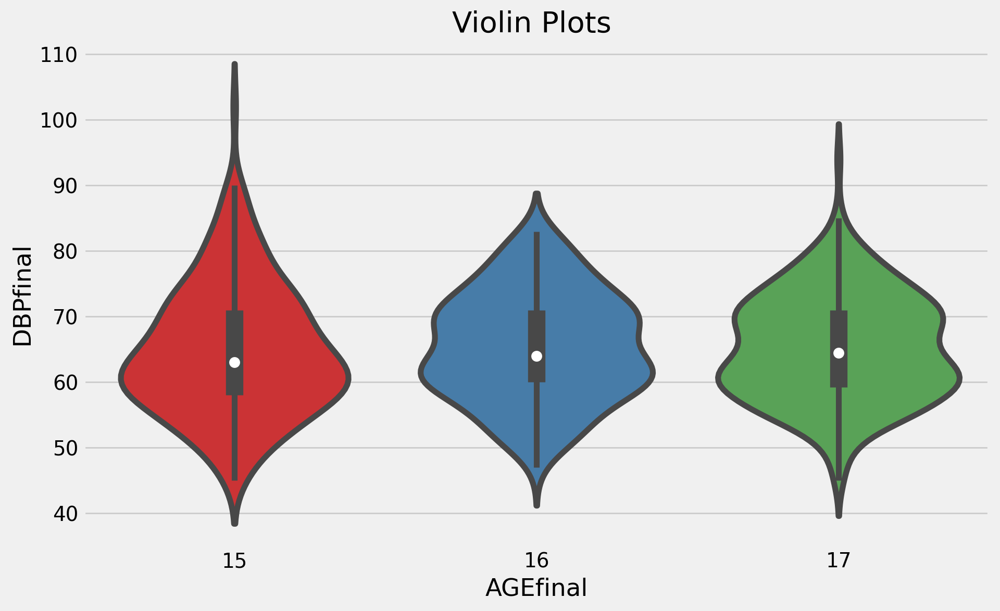

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your violin plot
sns.violinplot(x='AGEfinal', y='DBPfinal', data=df, palette='Set1')
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('AGEfinal')
plt.ylabel('DBPfinal')
plt.title('Violin Plots ')

# Show the plot
plt.show()

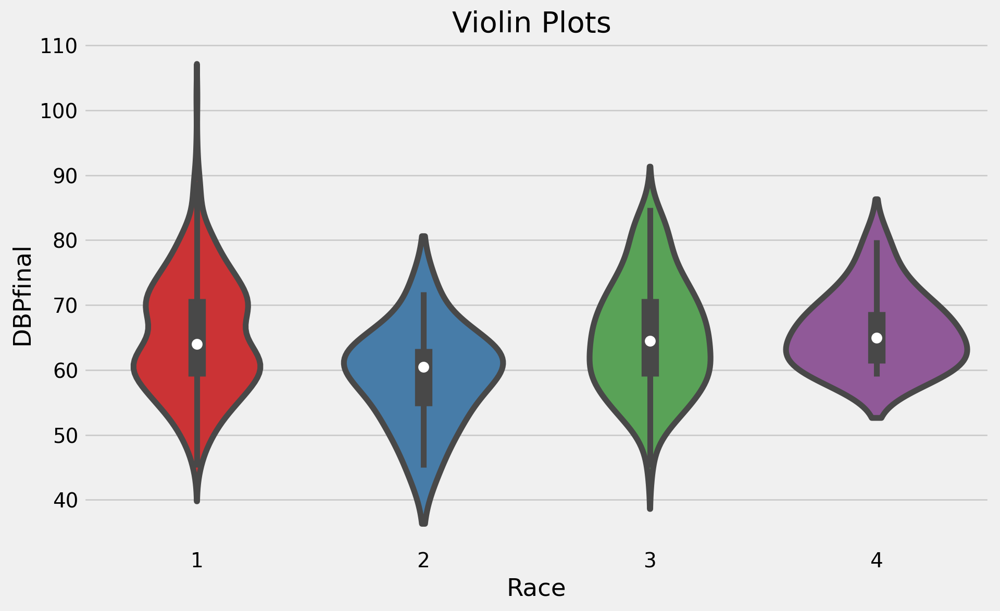

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your violin plot
sns.violinplot(x='Race', y='DBPfinal', data=df, palette='Set1')
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Race')
plt.ylabel('DBPfinal')
plt.title('Violin Plots ')

# Show the plot
plt.show()

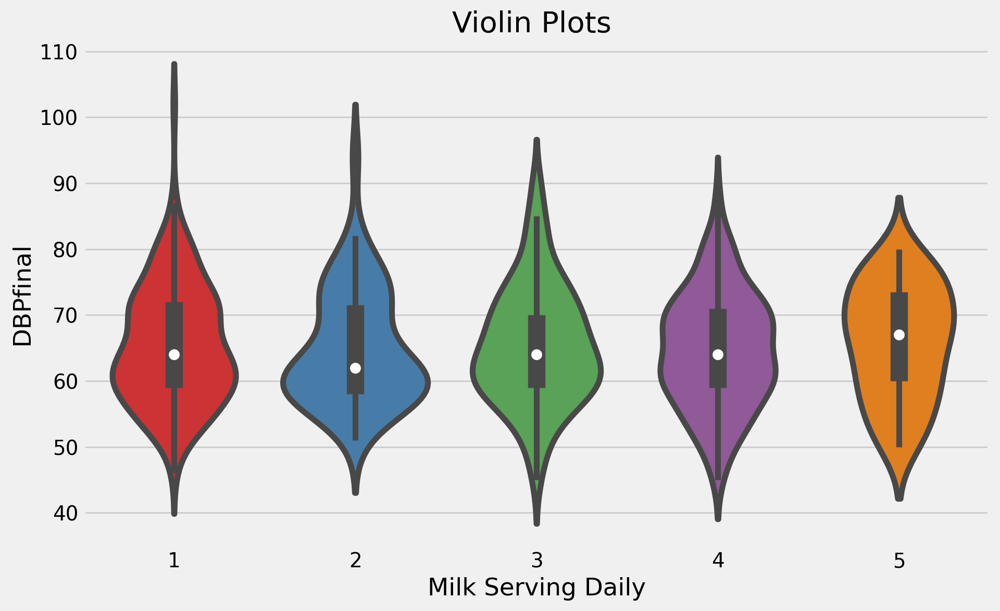

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your violin plot
sns.violinplot(x='milkserv_daily', y='DBPfinal', data=df, palette='Set1')
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Milk Serving Daily')
plt.ylabel('DBPfinal')
plt.title('Violin Plots ')

# Show the plot
plt.show()



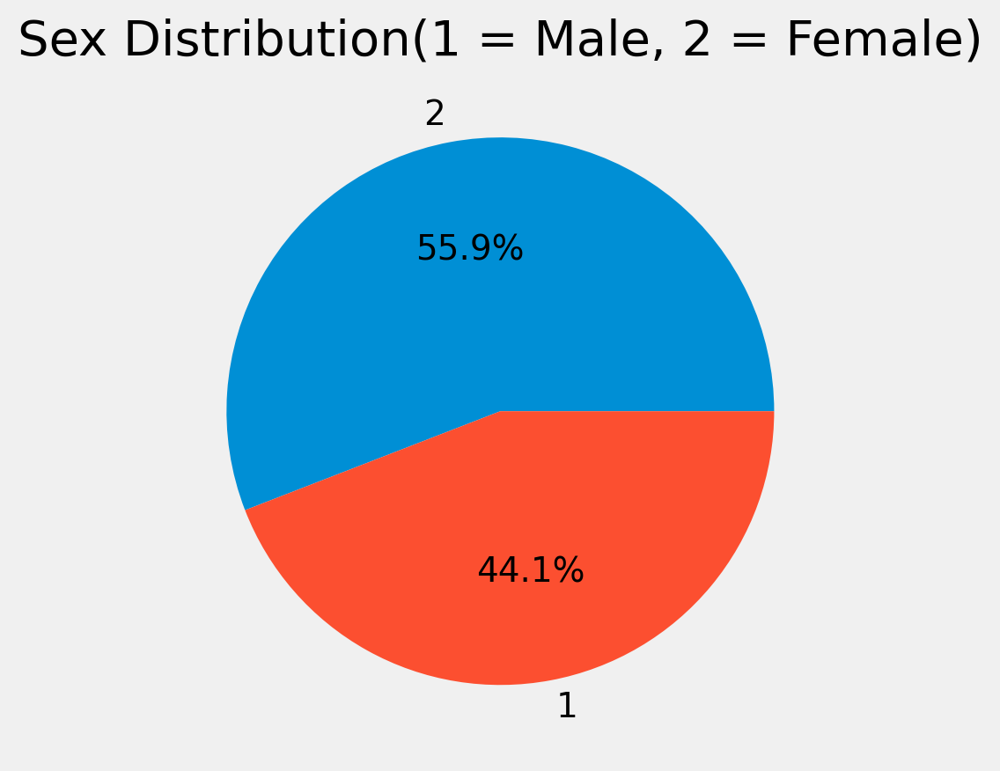

In [ ]:
sex_count = df['Sex'].value_counts()
plt.pie(sex_count, labels=sex_count.index, autopct='%1.1f%%')
plt.title('Sex Distribution(1 = Male, 2 = Female)')
plt.show()

In [ ]:
, 'Sex', 'Race', 'hhinc2', 'aindex_cat'


("'Sex',", "'Race',", "'hhinc2',", "'aindex_cat'")

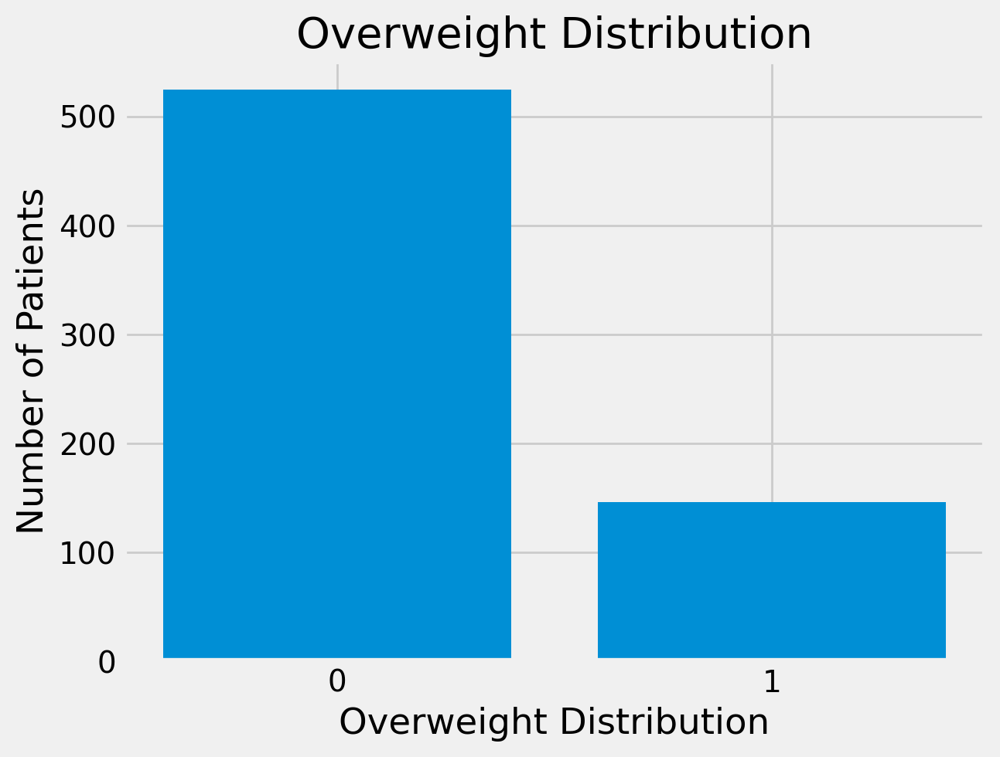

In [ ]:
overweight = df['overweight'].value_counts()
plt.bar(overweight.index, overweight.values)
plt.title('Overweight Distribution')
plt.xlabel('Overweight Distribution')
plt.ylabel('Number of Patients')
plt.xticks(overweight.index)
plt.show()

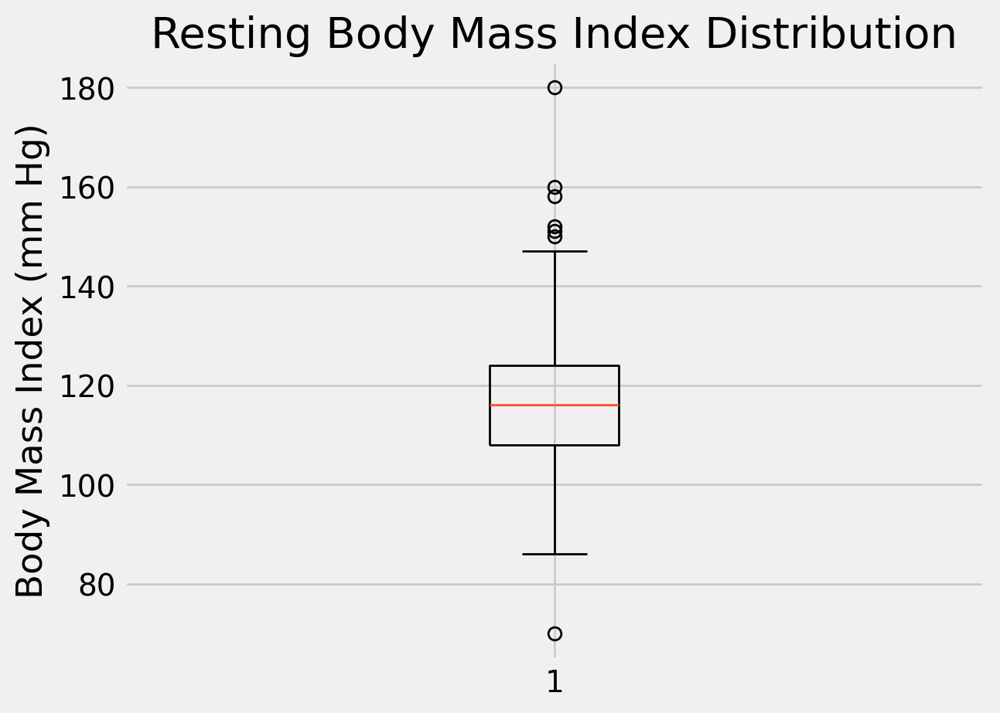

In [ ]:
plt.boxplot(df['SBPfinal'])
plt.title('Resting Body Mass Index Distribution')
plt.ylabel('Body Mass Index (mm Hg)')
plt.show()

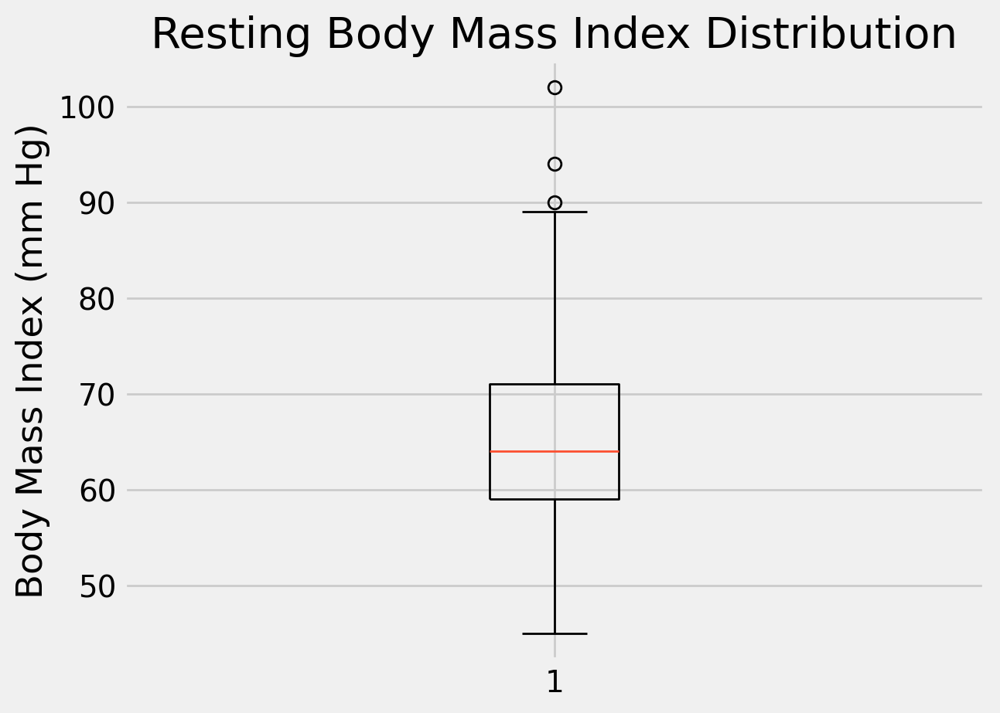

In [ ]:
plt.boxplot(df['DBPfinal'])
plt.title('Resting Body Mass Index Distribution')
plt.ylabel('Body Mass Index (mm Hg)')
plt.show()

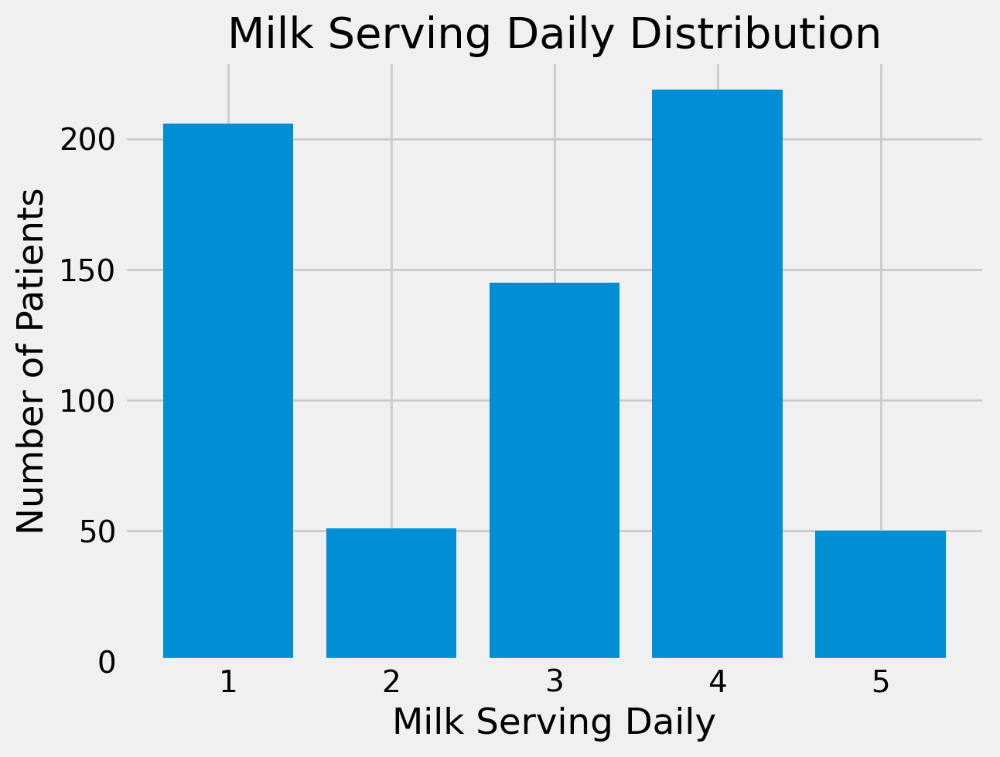

In [ ]:
milkserv_daily = df['milkserv_daily'].value_counts()
plt.bar(milkserv_daily.index, milkserv_daily.values)
plt.title('Milk Serving Daily Distribution')
plt.xlabel('Milk Serving Daily')
plt.ylabel('Number of Patients')
plt.xticks(milkserv_daily.index)
plt.show()

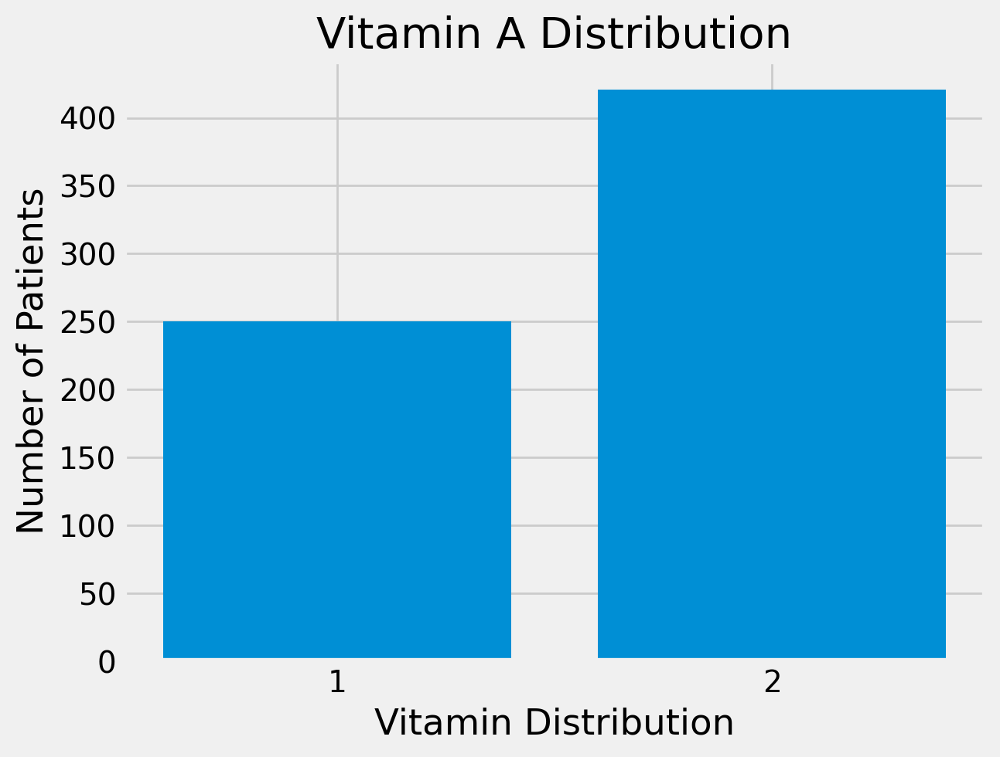

In [ ]:
snack_freq = df['snack_freq'].value_counts()
plt.bar(snack_freq.index, snack_freq.values)
plt.title('Vitamin A Distribution')
plt.xlabel('Vitamin Distribution')
plt.ylabel('Number of Patients')
plt.xticks(snack_freq.index)
plt.show()

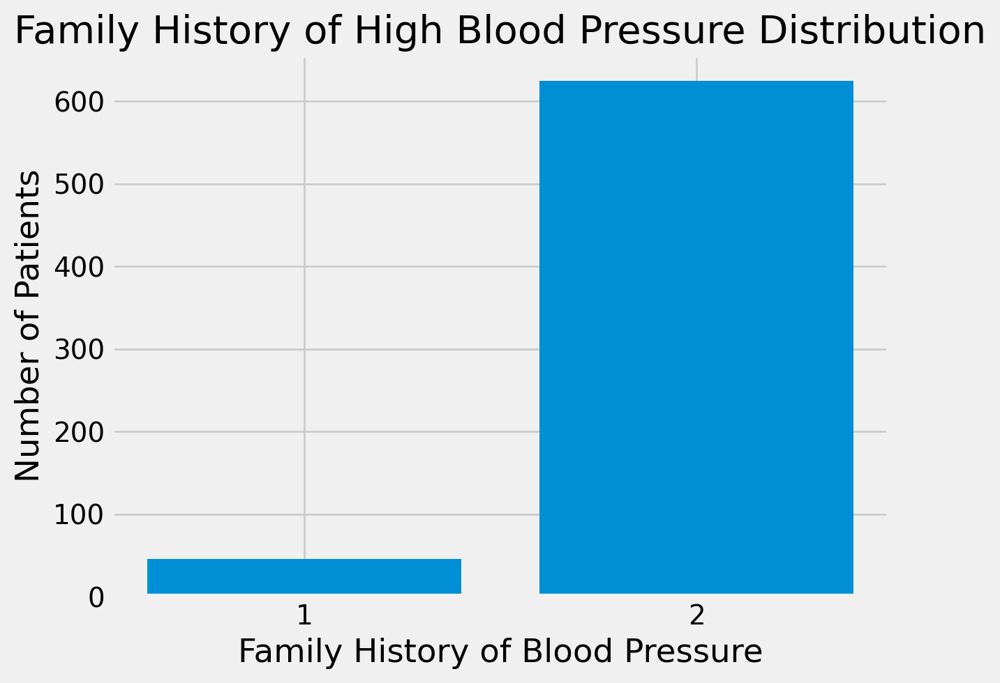

In [ ]:
AuditC3_MF1 = df['AuditC3_MF1'].value_counts()
plt.bar(AuditC3_MF1.index, AuditC3_MF1.values)
plt.title('Family History of High Blood Pressure Distribution')
plt.xlabel('Family History of Blood Pressure')
plt.ylabel('Number of Patients')
plt.xticks(AuditC3_MF1.index)
plt.show()

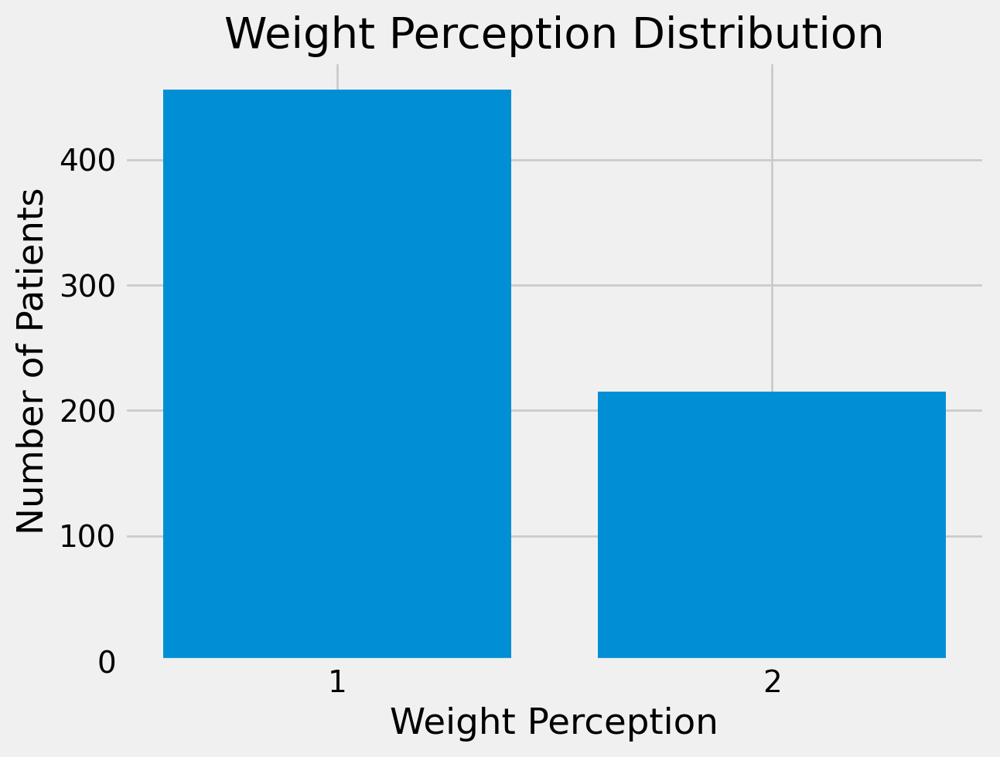

In [ ]:
redmeat_wfat = df['redmeat_wfat'].value_counts()
plt.bar(redmeat_wfat.index, redmeat_wfat.values)
plt.title('Weight Perception Distribution')
plt.xlabel('Weight Perception')
plt.ylabel('Number of Patients')
plt.xticks(redmeat_wfat.index)
plt.show()

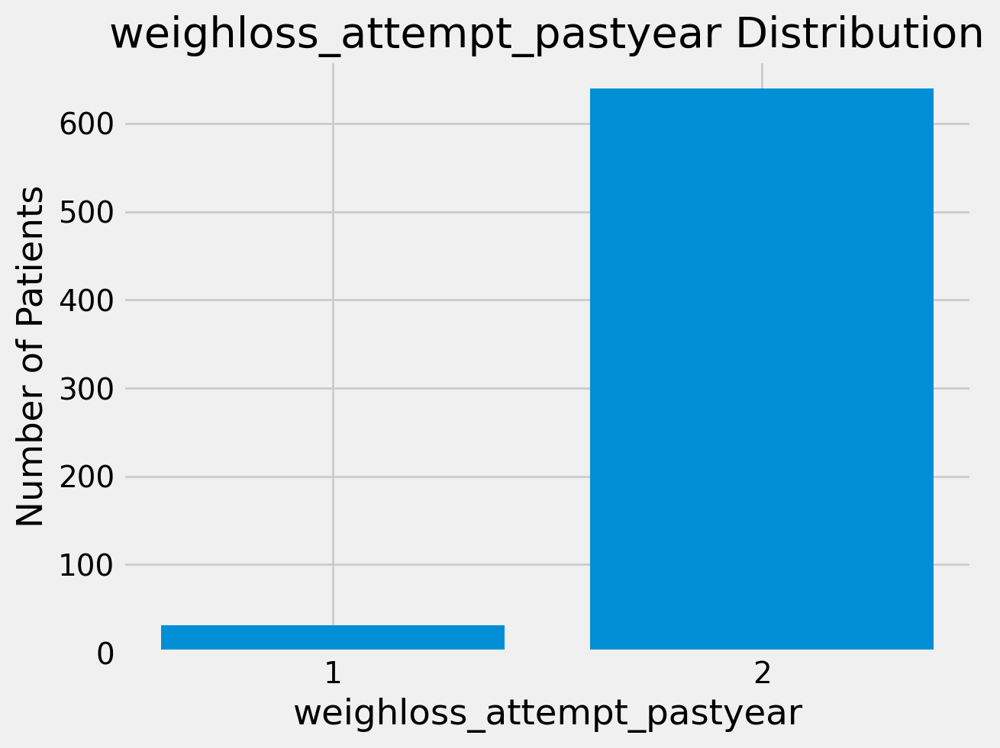

In [ ]:
famhist_heartdis = df['famhist_heartdis'].value_counts()
plt.bar(famhist_heartdis.index, famhist_heartdis.values)
plt.title('weighloss_attempt_pastyear Distribution')
plt.xlabel('weighloss_attempt_pastyear')
plt.ylabel('Number of Patients')
plt.xticks(famhist_heartdis.index)
plt.show()

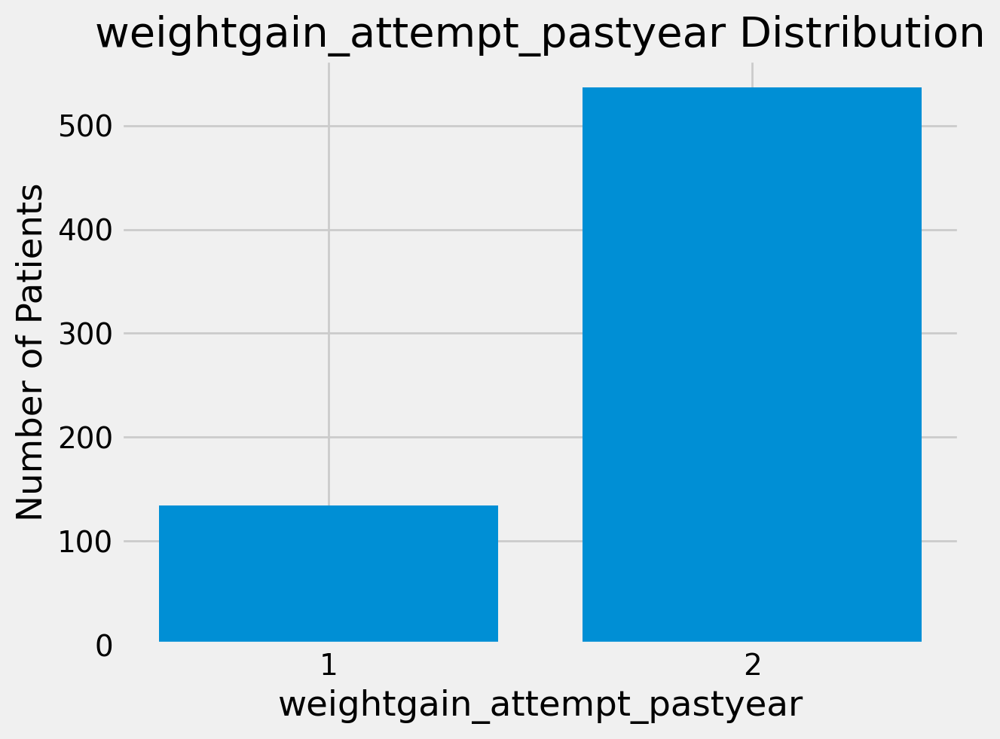

In [ ]:
famhist_diabetes = df['famhist_diabetes'].value_counts()
plt.bar(famhist_diabetes.index, famhist_diabetes.values)
plt.title('weightgain_attempt_pastyear Distribution')
plt.xlabel('weightgain_attempt_pastyear')
plt.ylabel('Number of Patients')
plt.xticks(famhist_diabetes.index)
plt.show()

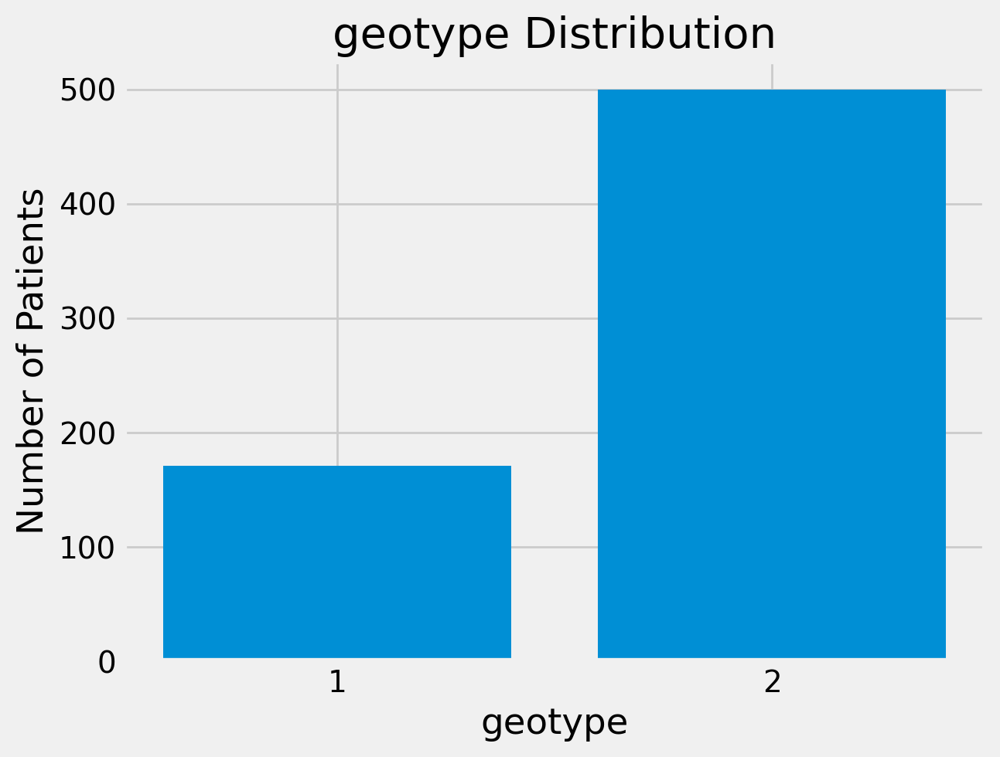

In [ ]:
physical_activity = df['physical_activity'].value_counts()
plt.bar(physical_activity.index, physical_activity.values)
plt.title('geotype Distribution')
plt.xlabel('geotype')
plt.ylabel('Number of Patients')
plt.xticks(physical_activity.index)
plt.show()

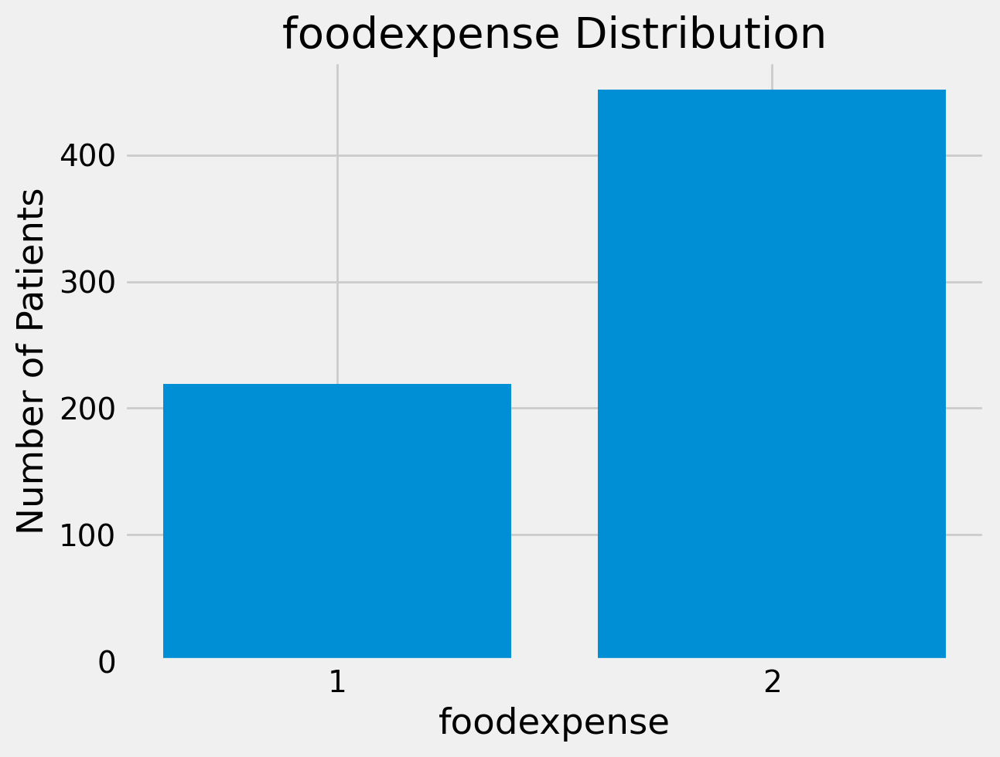

In [ ]:
Healthcare_access2yr = df['Healthcare_access2yr'].value_counts()
plt.bar(Healthcare_access2yr.index, Healthcare_access2yr.values)
plt.title('foodexpense Distribution')
plt.xlabel('foodexpense')
plt.ylabel('Number of Patients')
plt.xticks(Healthcare_access2yr.index)
plt.show()

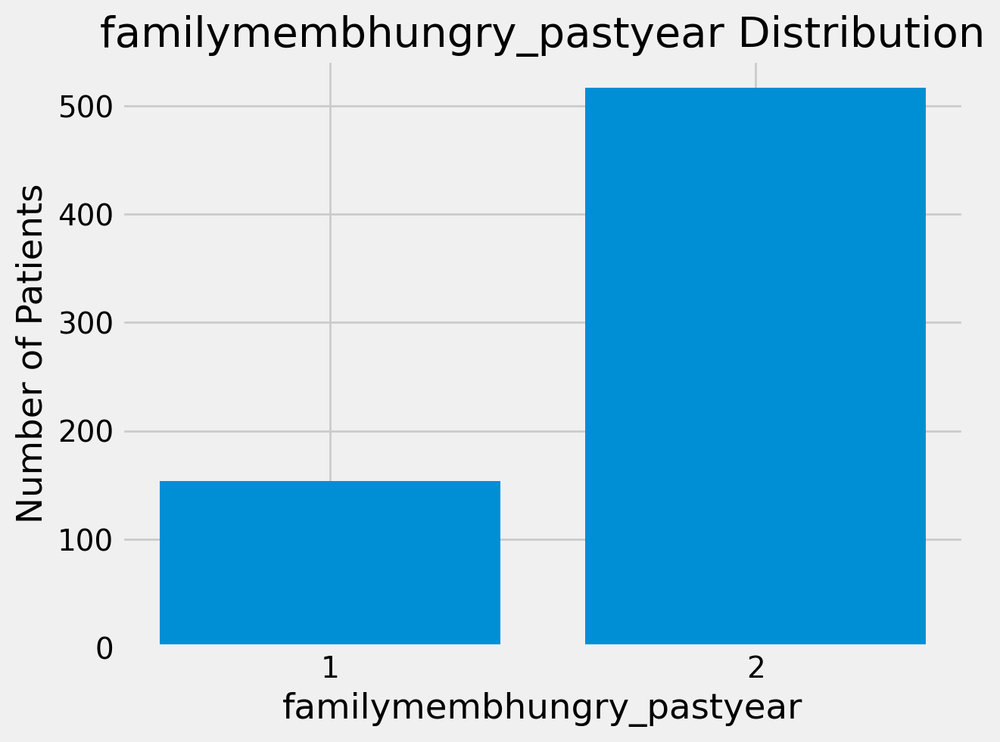

In [ ]:
famhist_hbp = df['famhist_hbp'].value_counts()
plt.bar(famhist_hbp.index, famhist_hbp.values)
plt.title('familymembhungry_pastyear Distribution')
plt.xlabel('familymembhungry_pastyear')
plt.ylabel('Number of Patients')
plt.xticks(famhist_hbp.index)
plt.show()

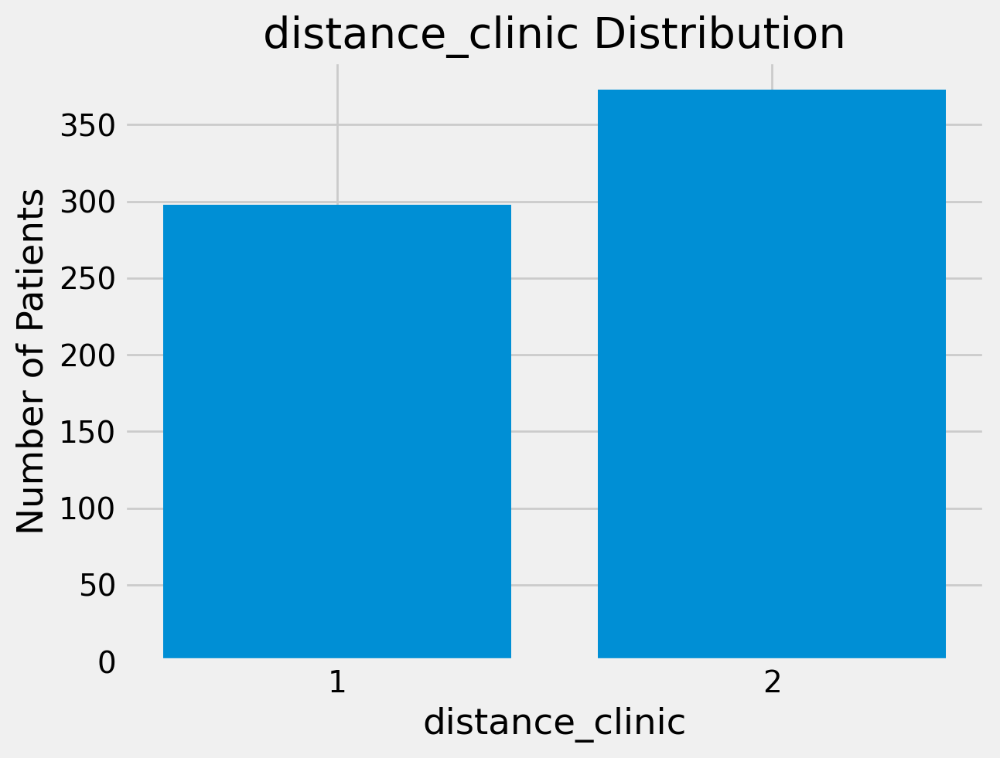

In [ ]:
CategoricalFatScore1 = df['CategoricalFatScore1'].value_counts()
plt.bar(CategoricalFatScore1.index, CategoricalFatScore1.values)
plt.title('distance_clinic Distribution')
plt.xlabel('distance_clinic')
plt.ylabel('Number of Patients')
plt.xticks(CategoricalFatScore1.index)
plt.show()

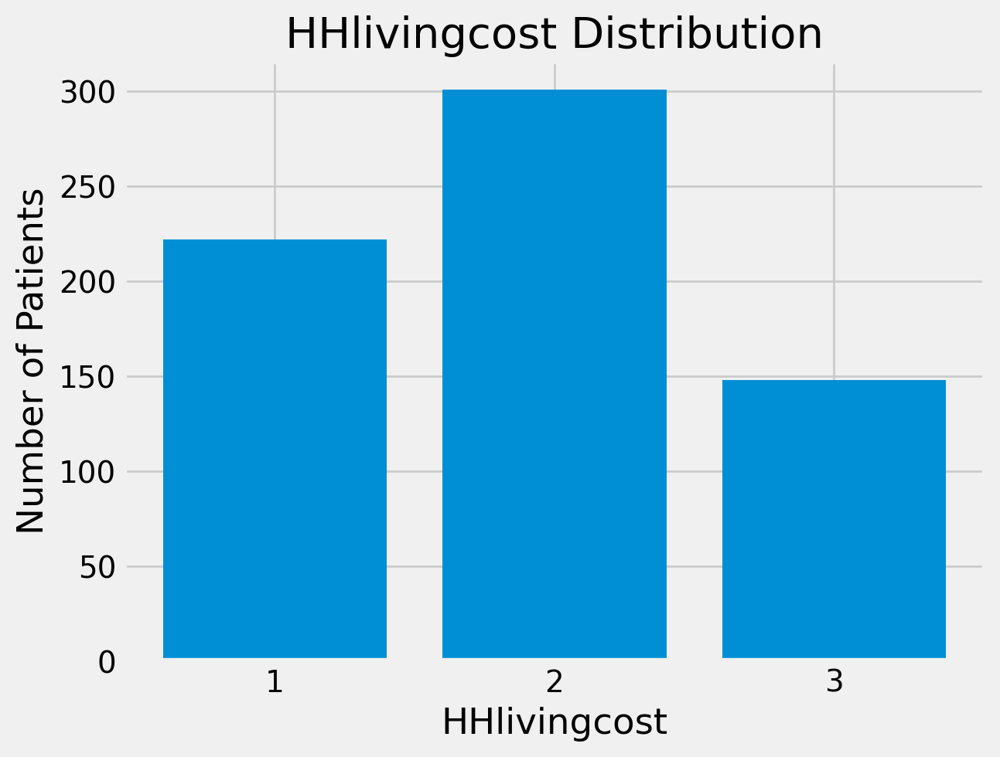

In [ ]:
scores_fruit = df['scores_fruit'].value_counts()
plt.bar(scores_fruit.index, scores_fruit.values)
plt.title('HHlivingcost Distribution')
plt.xlabel('HHlivingcost')
plt.ylabel('Number of Patients')
plt.xticks(scores_fruit.index)
plt.show()

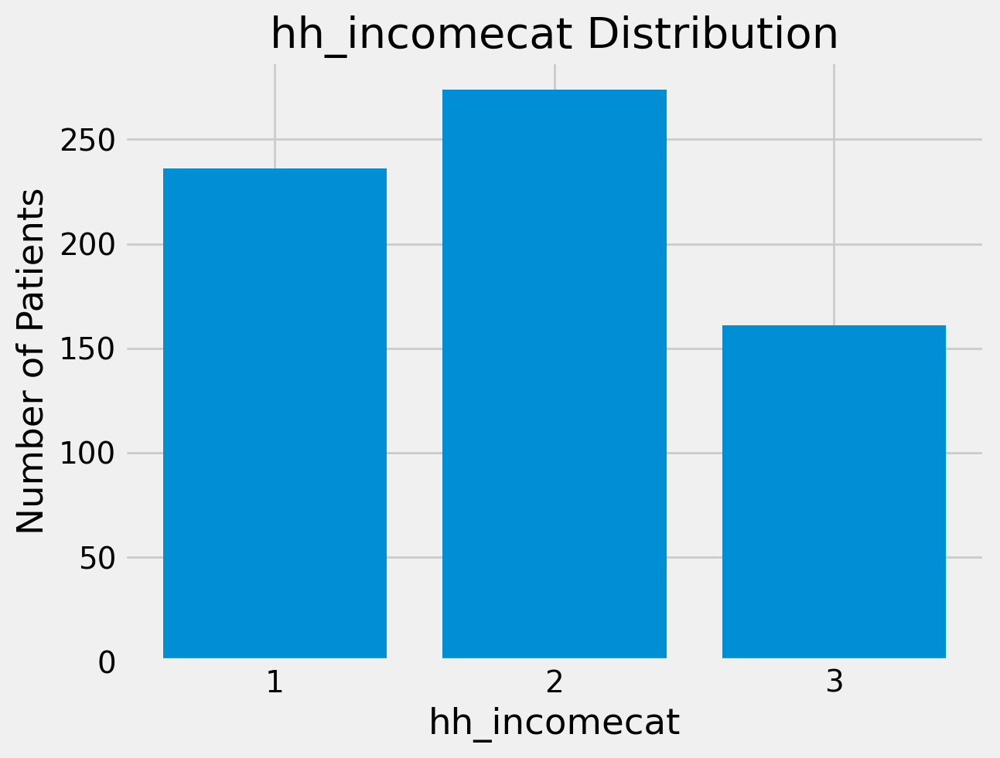

In [ ]:
scores_sugar = df['scores_sugar'].value_counts()
plt.bar(scores_sugar.index, scores_sugar.values)
plt.title('hh_incomecat Distribution')
plt.xlabel('hh_incomecat')
plt.ylabel('Number of Patients')
plt.xticks(scores_sugar.index)
plt.show()

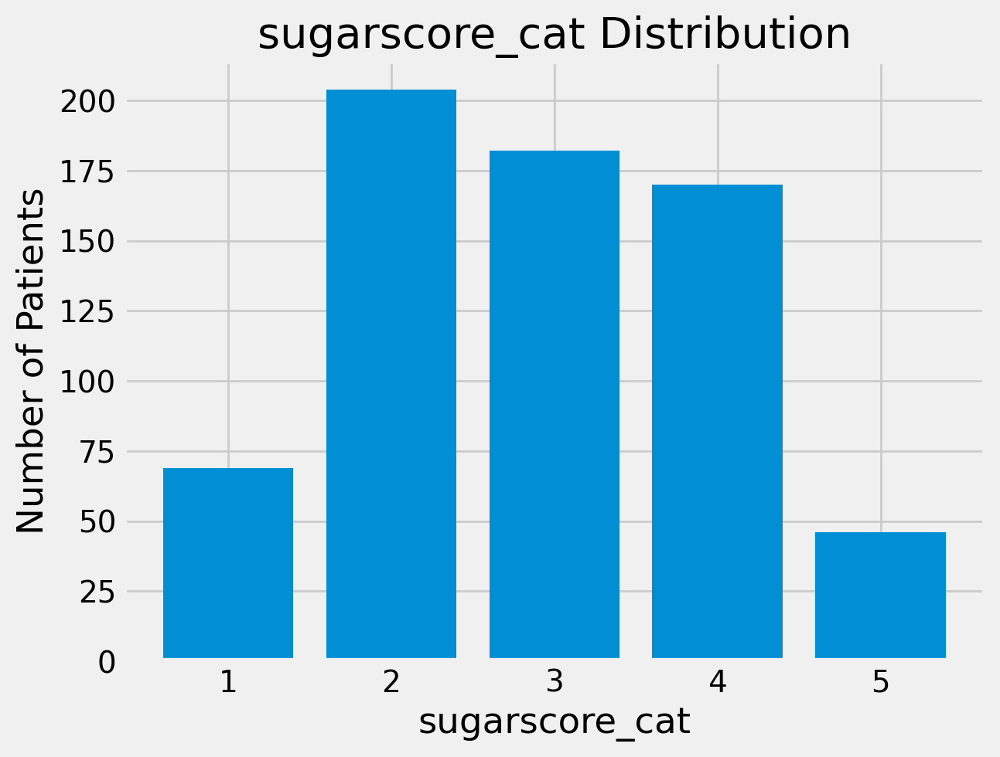

In [ ]:
butterspread = df['butterspread'].value_counts()
plt.bar(butterspread.index, butterspread.values)
plt.title('sugarscore_cat Distribution')
plt.xlabel('sugarscore_cat')
plt.ylabel('Number of Patients')
plt.xticks(butterspread.index)
plt.show()

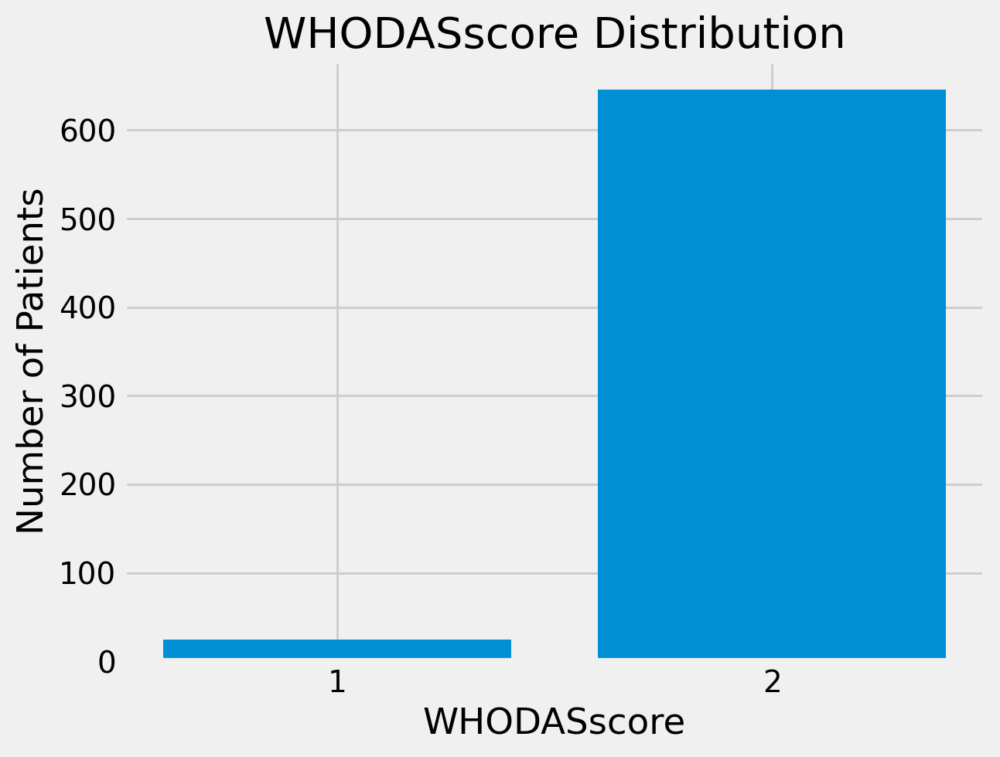

In [ ]:
Cursmoker = df['Cursmoker'].value_counts()
plt.bar(Cursmoker.index, Cursmoker.values)
plt.title('WHODASscore Distribution')
plt.xlabel('WHODASscore')
plt.ylabel('Number of Patients')
plt.xticks(Cursmoker.index)
plt.show()

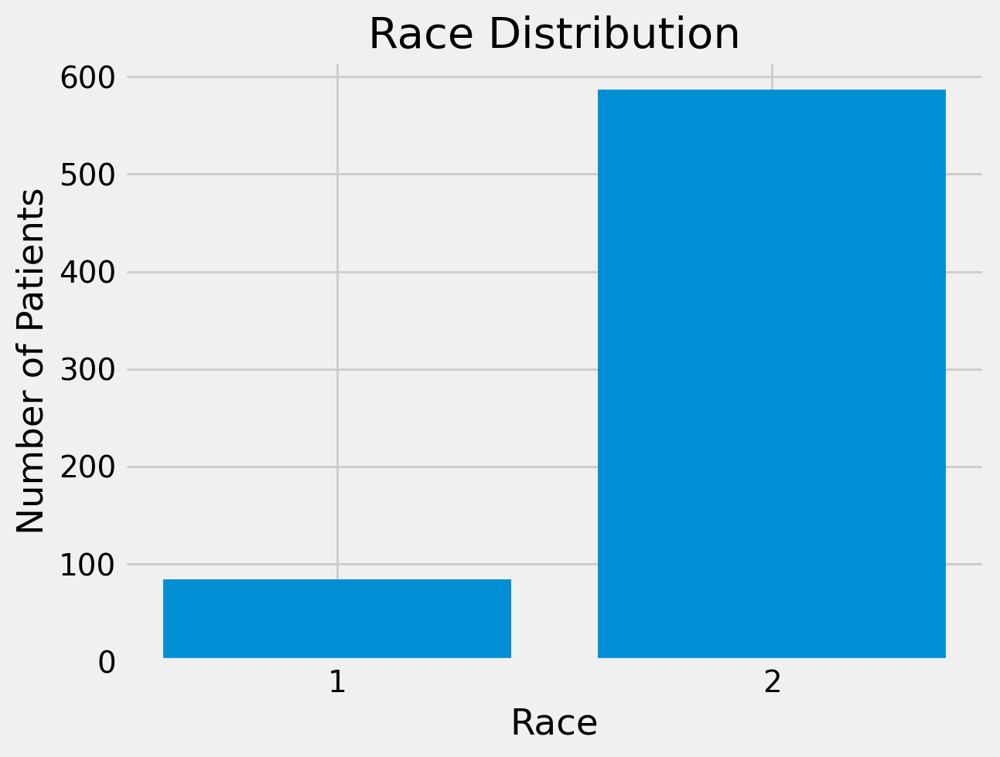

In [ ]:
weightloss_attempt = df['weightloss_attempt'].value_counts()
plt.bar(weightloss_attempt.index, weightloss_attempt.values)
plt.title('Race Distribution')
plt.xlabel('Race')
plt.ylabel('Number of Patients')
plt.xticks(weightloss_attempt.index)
plt.show()

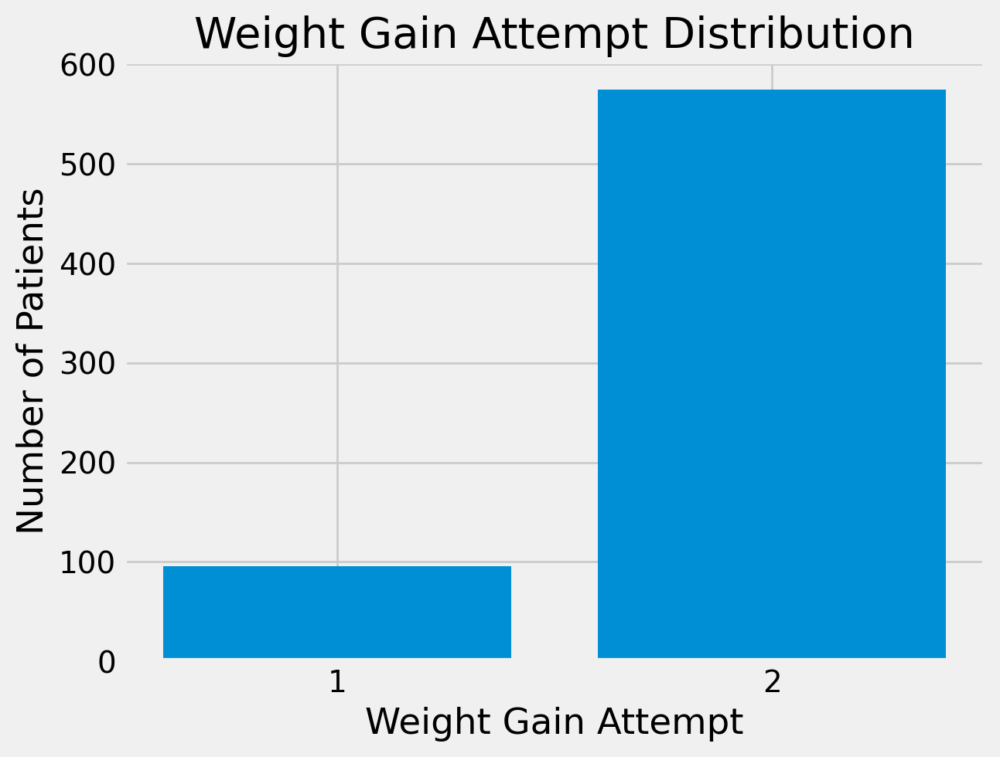

In [ ]:
weightgain_attempt = df['weightgain_attempt'].value_counts()
plt.bar(weightgain_attempt.index, weightgain_attempt.values)
plt.title('Weight Gain Attempt Distribution')
plt.xlabel('Weight Gain Attempt')
plt.ylabel('Number of Patients')
plt.xticks(weightgain_attempt.index)
plt.show()

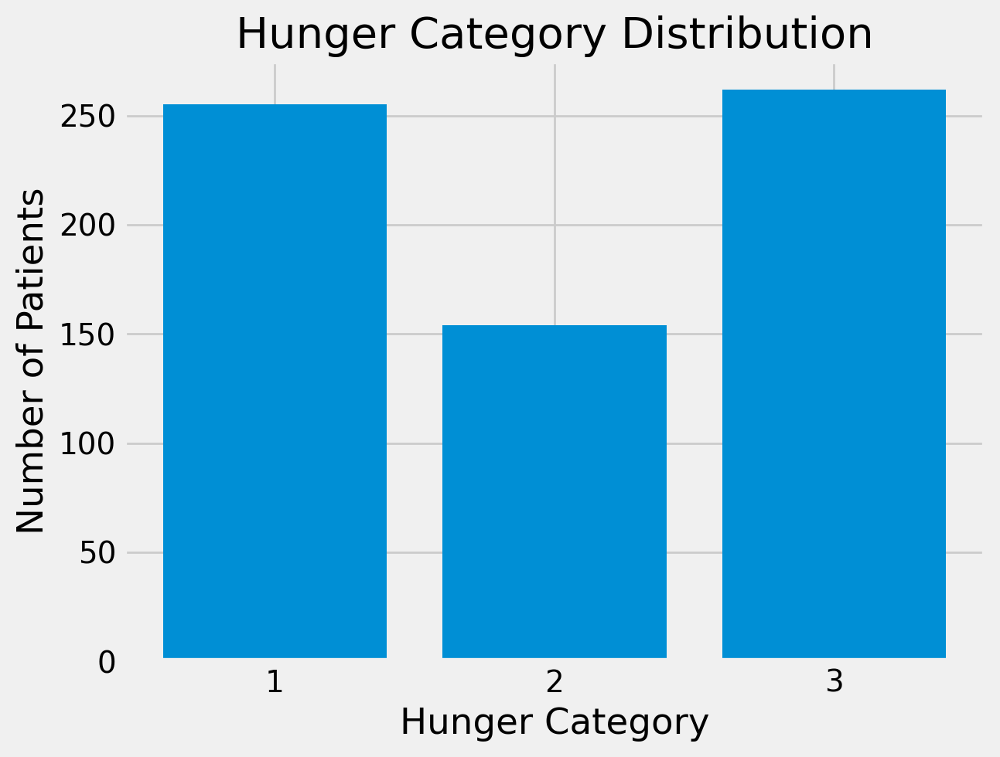

In [ ]:
Hunger_cat1 = df['Hunger_cat1'].value_counts()
plt.bar(Hunger_cat1.index, Hunger_cat1.values)
plt.title('Hunger Category Distribution')
plt.xlabel('Hunger Category')
plt.ylabel('Number of Patients')
plt.xticks(Hunger_cat1.index)
plt.show()

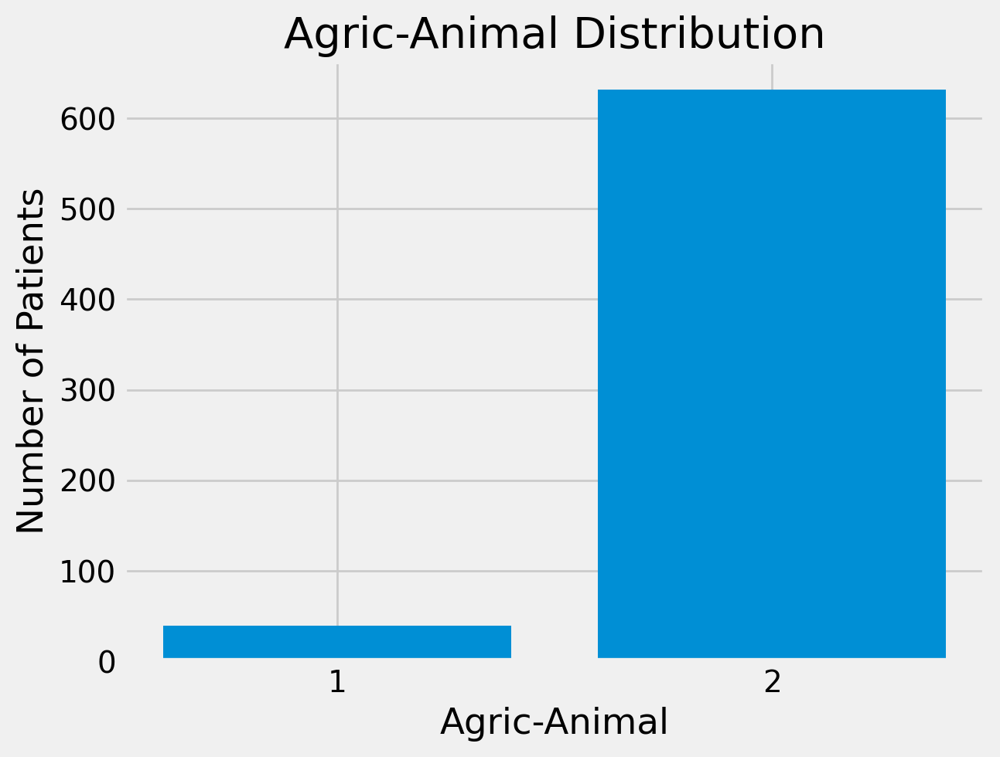

In [ ]:
agric_animal1 = df['agric_animal1'].value_counts()
plt.bar(agric_animal1.index, agric_animal1.values)
plt.title('Agric-Animal Distribution')
plt.xlabel('Agric-Animal')
plt.ylabel('Number of Patients')
plt.xticks(agric_animal1.index)
plt.show()

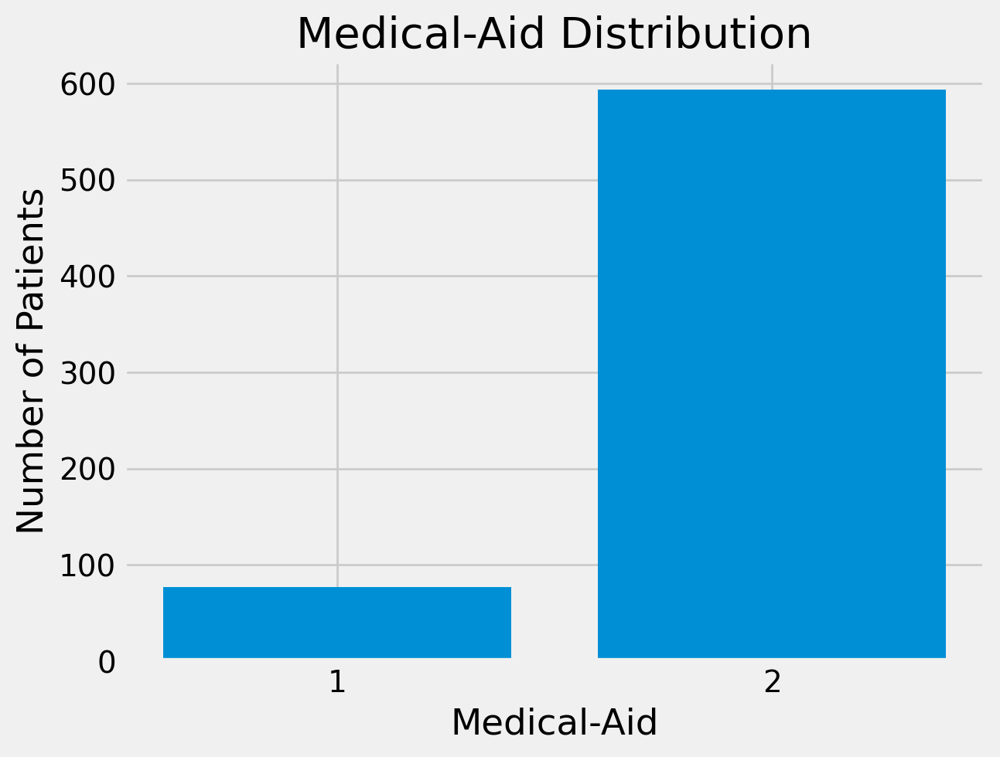

In [ ]:
medaid1 = df['medaid1'].value_counts()
plt.bar(medaid1.index, medaid1.values)
plt.title('Medical-Aid Distribution')
plt.xlabel('Medical-Aid')
plt.ylabel('Number of Patients')
plt.xticks(medaid1.index)
plt.show()



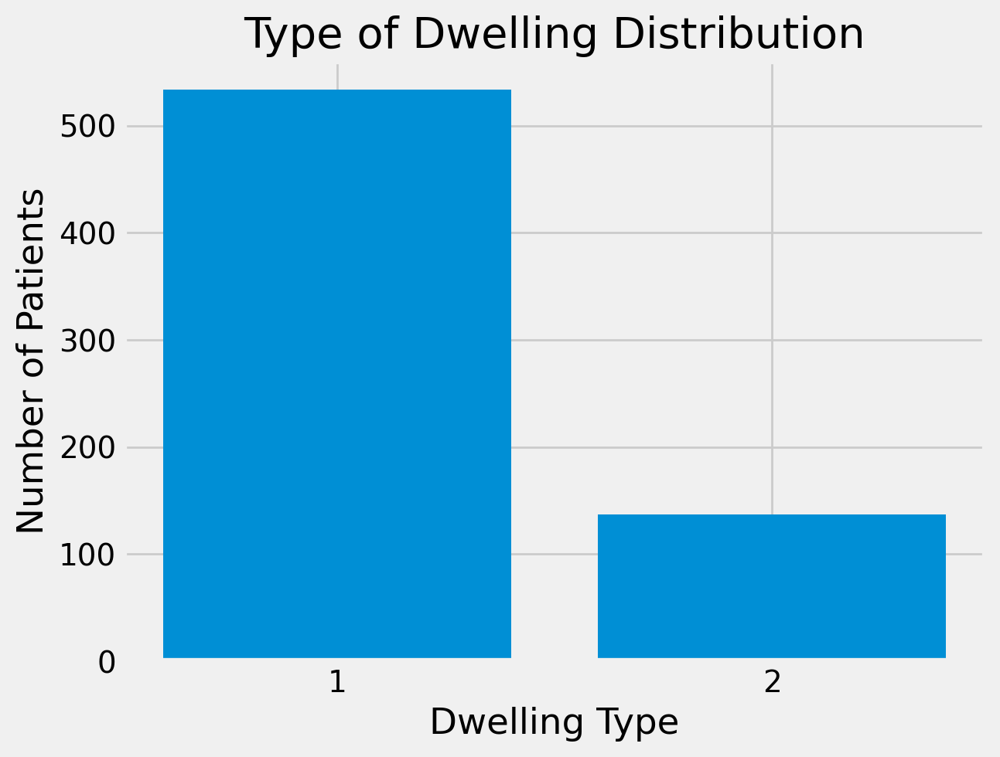

In [ ]:
dwell_typ1 = df['dwell_typ1'].value_counts()
plt.bar(dwell_typ1.index, dwell_typ1.values)
plt.title('Type of Dwelling Distribution')
plt.xlabel('Dwelling Type')
plt.ylabel('Number of Patients')
plt.xticks(dwell_typ1.index)
plt.show()

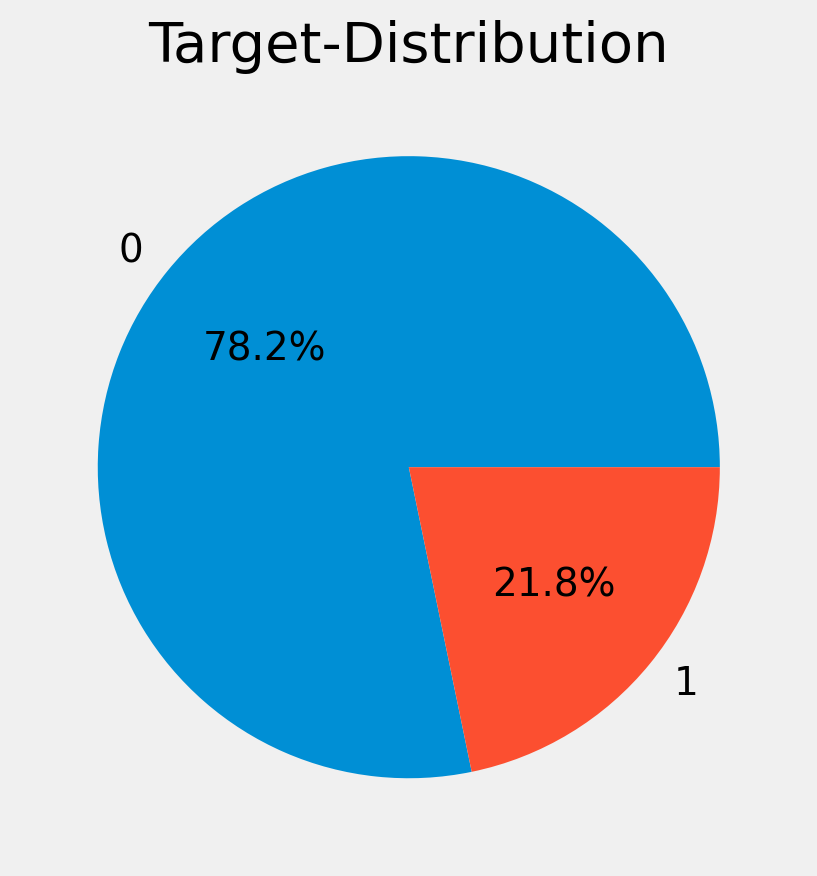

In [ ]:
target_count = df['overweight'].value_counts()
plt.pie(target_count, labels=target_count.index, autopct='%1.1f%%')
plt.title('Target-Distribution')
plt.show()

### B. Bivariate Analysis

In [ ]:
# Pair plot for numeric features
sns.pairplot(df, hue='SBPfinal')
plt.show()

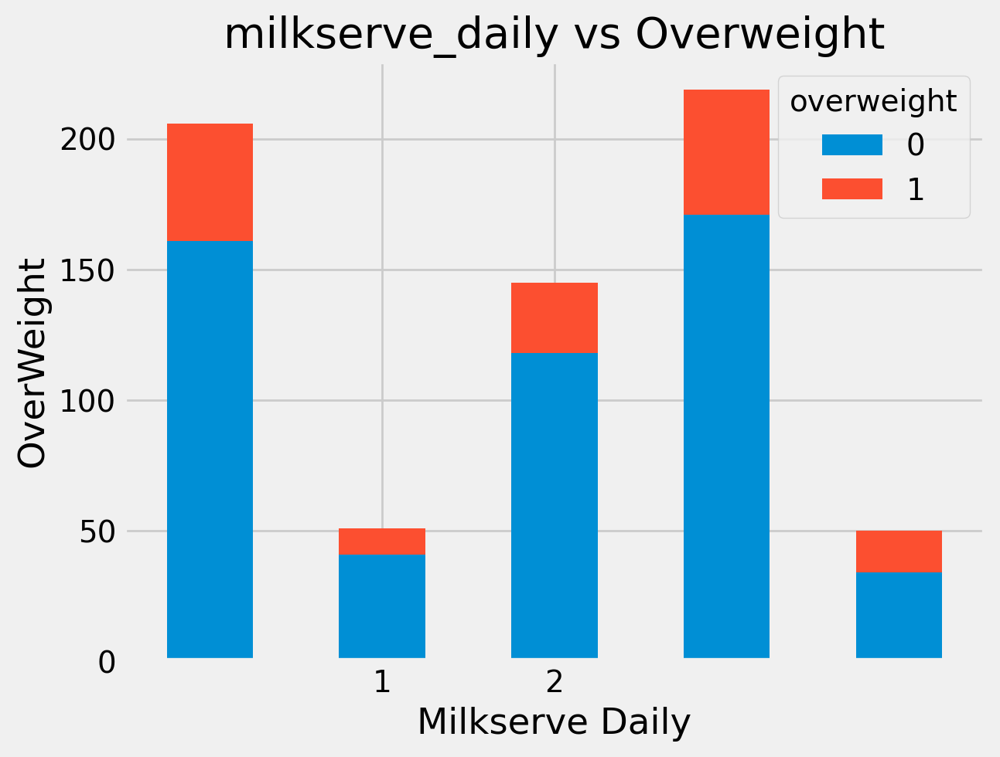

In [ ]:
cp_target = df.groupby(['milkserv_daily', 'overweight']).size().unstack().fillna(0)
cp_target.plot(kind='bar', stacked=True)
plt.title('milkserve_daily vs Overweight')
plt.xlabel('Milkserve Daily')
plt.ylabel('OverWeight')
plt.xticks(ticks=[1,2], labels=['1','2'], rotation=0)
plt.show()

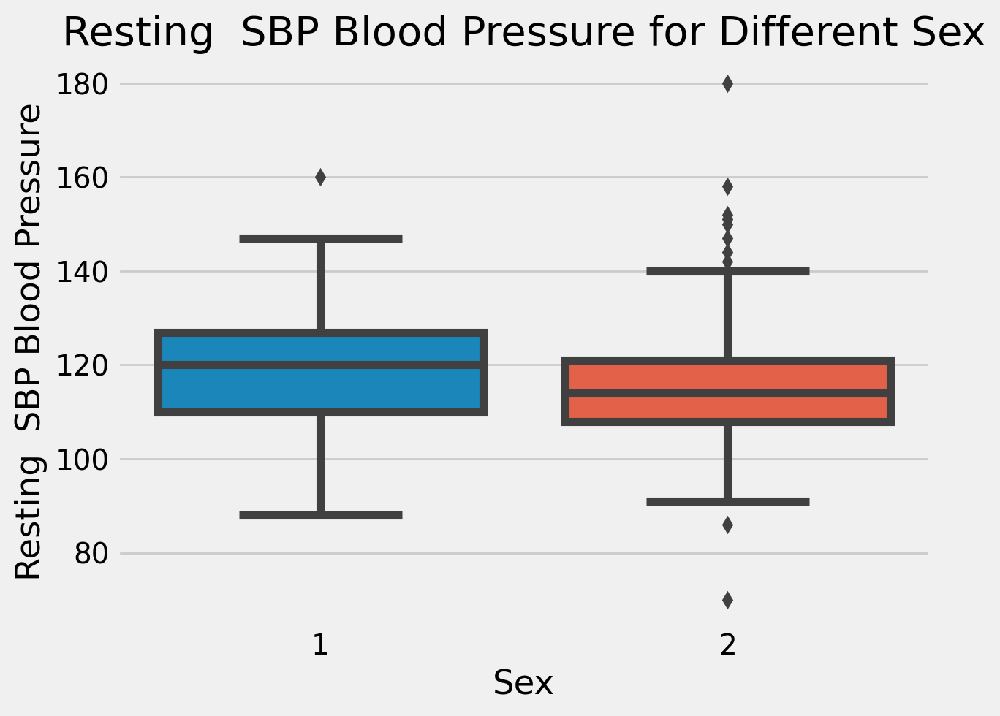

In [ ]:
sns.boxplot(x='Sex', y='SBPfinal', data=df)
plt.title('Resting  SBP Blood Pressure for Different Sex')
plt.xlabel('Sex')
plt.ylabel('Resting  SBP Blood Pressure')
plt.show()

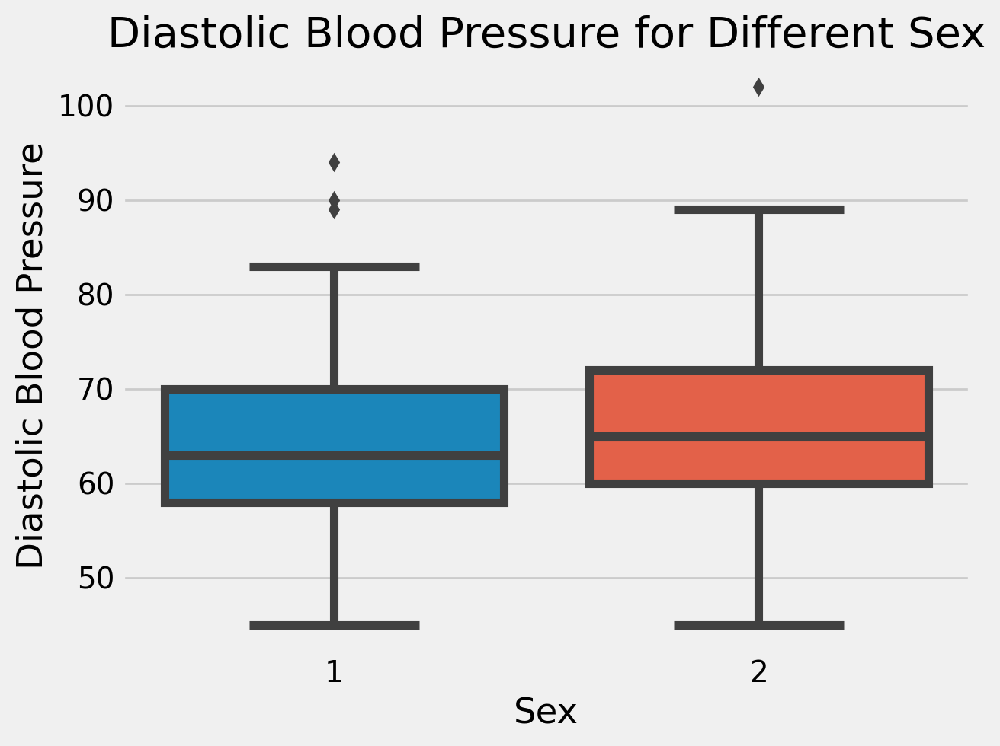

In [ ]:
sns.boxplot(x='Sex', y='DBPfinal', data=df)
plt.title('Diastolic Blood Pressure for Different Sex')
plt.xlabel('Sex')
plt.ylabel('Diastolic Blood Pressure')
plt.show()

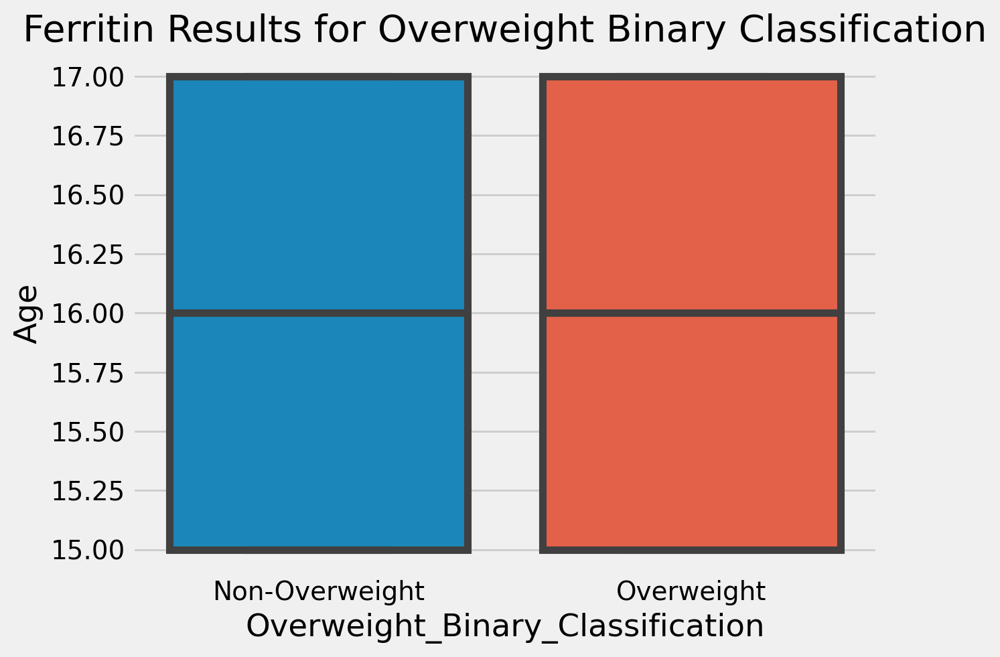

In [ ]:
sns.boxplot(x='overweight', y='AGEfinal', data=df)
plt.title('Ferritin Results for Overweight Binary Classification')
plt.xlabel('Overweight_Binary_Classification')
plt.ylabel('Age')
plt.xticks(ticks=[0,1], labels=['Non-Overweight', 'Overweight'])
plt.show()

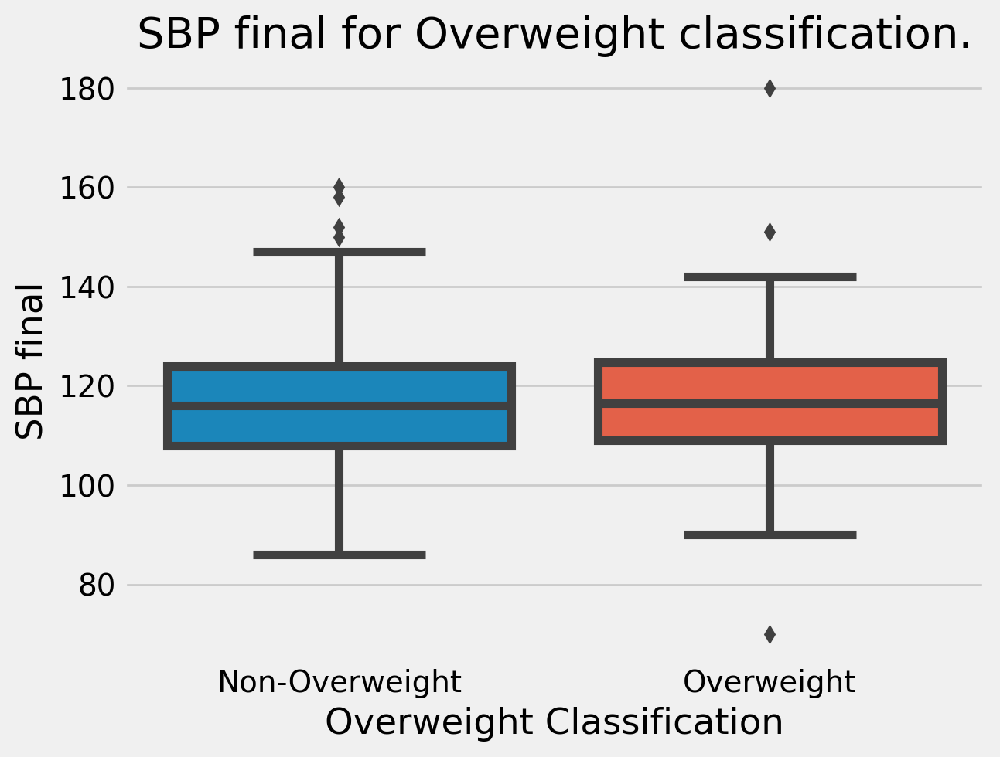

In [ ]:
sns.boxplot(x='overweight', y='SBPfinal', data=df)
plt.title('SBP final for Overweight classification.')
plt.xlabel('Overweight Classification')
plt.ylabel('SBP final')
plt.xticks(ticks=[0,1], labels=['Non-Overweight', 'Overweight'])
plt.show()

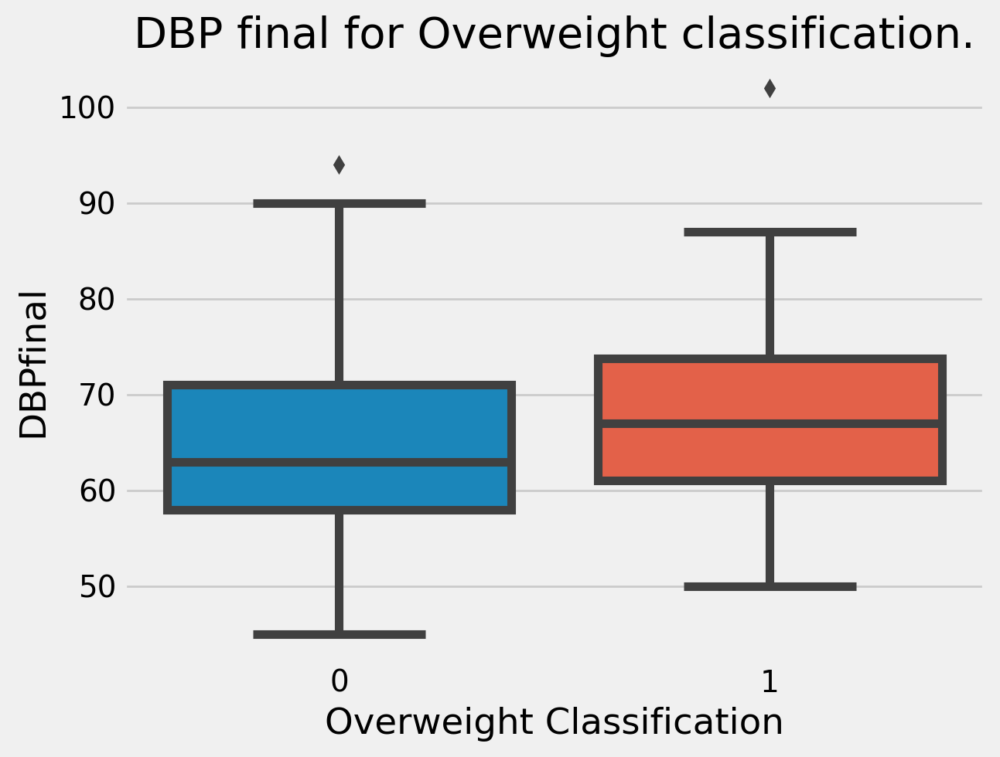

In [ ]:
sns.boxplot(x='overweight', y='DBPfinal', data=df)
plt.title('DBP final for Overweight classification.')
plt.xlabel('Overweight Classification')
plt.ylabel('DBPfinal')
plt.show()

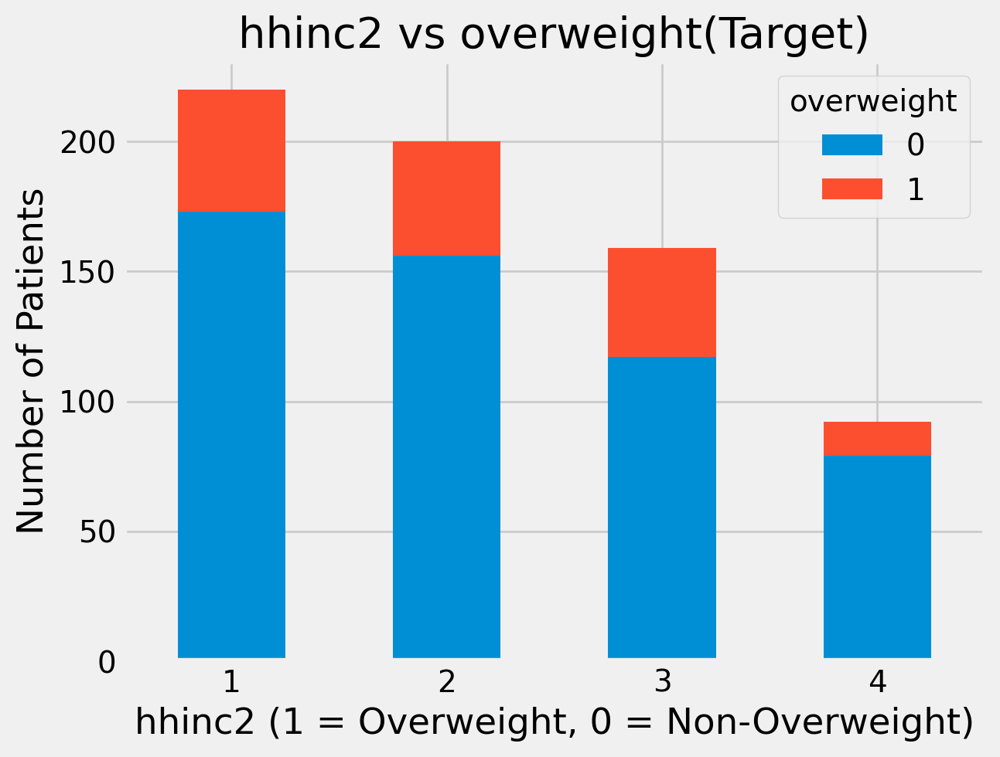

In [ ]:
exang_target = df.groupby(['hhinc2', 'overweight']).size().unstack().fillna(0)
exang_target.plot(kind='bar', stacked=True)
plt.title('hhinc2 vs overweight(Target)')
plt.xlabel('hhinc2 (1 = Overweight, 0 = Non-Overweight)')
plt.ylabel('Number of Patients')
plt.xticks(rotation=0)
plt.show()

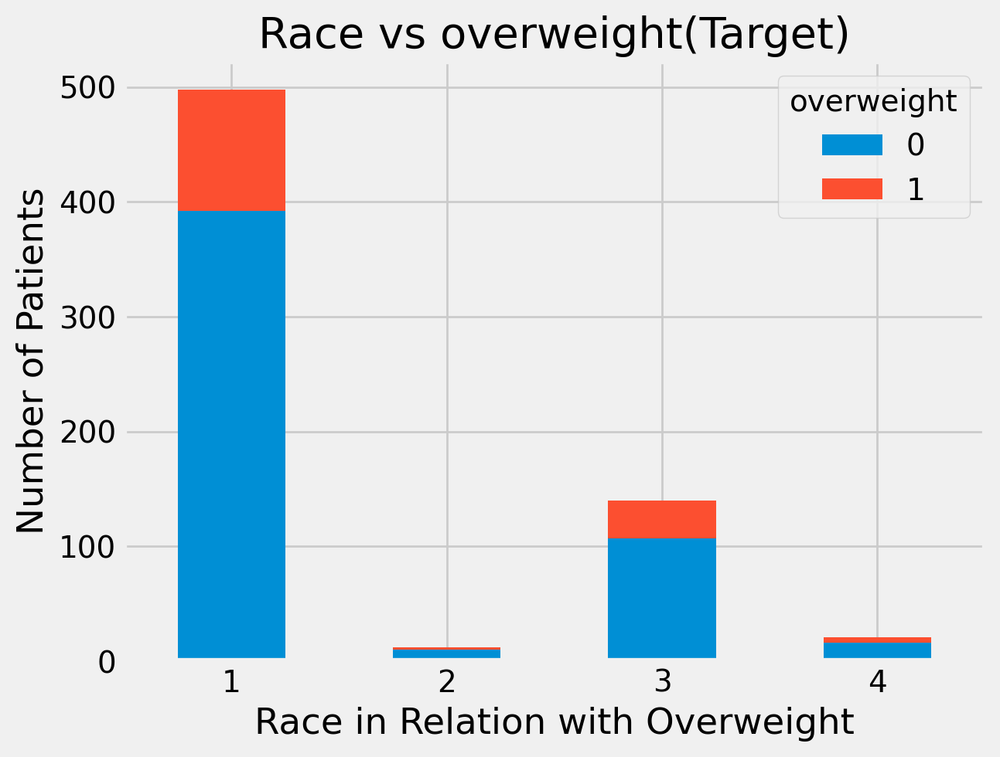

In [ ]:
ca_target = df.groupby(['Race', 'overweight']).size().unstack().fillna(0)
ca_target.plot(kind='bar', stacked=True)
plt.title('Race vs overweight(Target)')
plt.xlabel('Race in Relation with Overweight')
plt.ylabel('Number of Patients')
plt.xticks(rotation=0)
plt.show()

### C. Multivariate Analysis

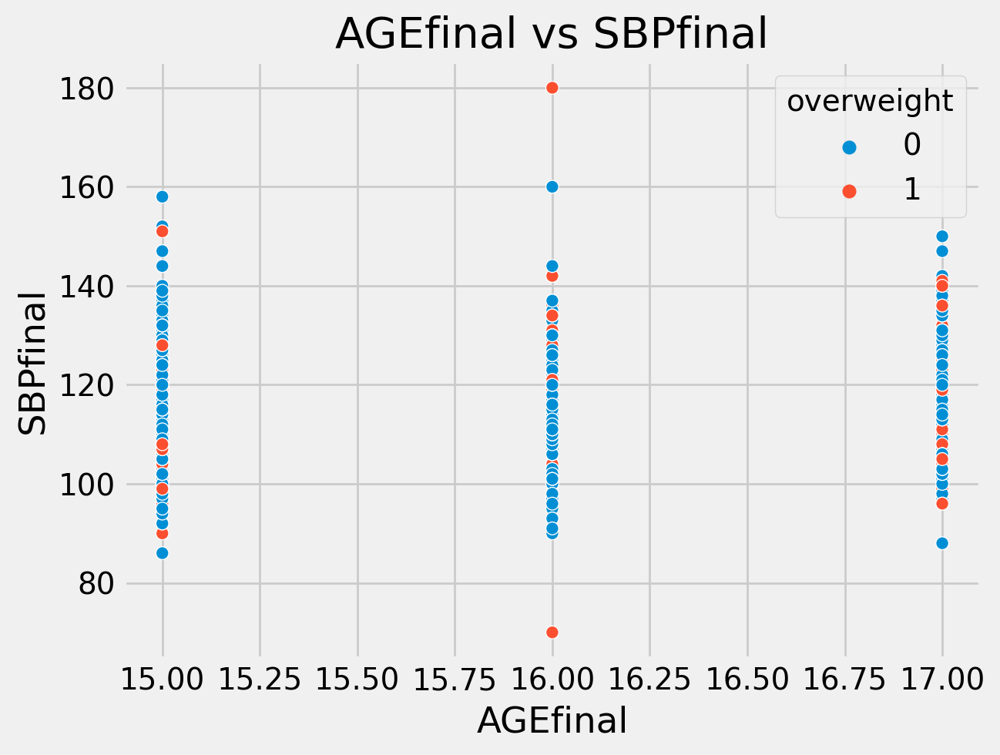

In [ ]:
sns.scatterplot(x='AGEfinal', y='SBPfinal', hue='overweight', data=df)
plt.title('AGEfinal vs SBPfinal')
plt.xlabel('AGEfinal')
plt.ylabel('SBPfinal')
plt.show()

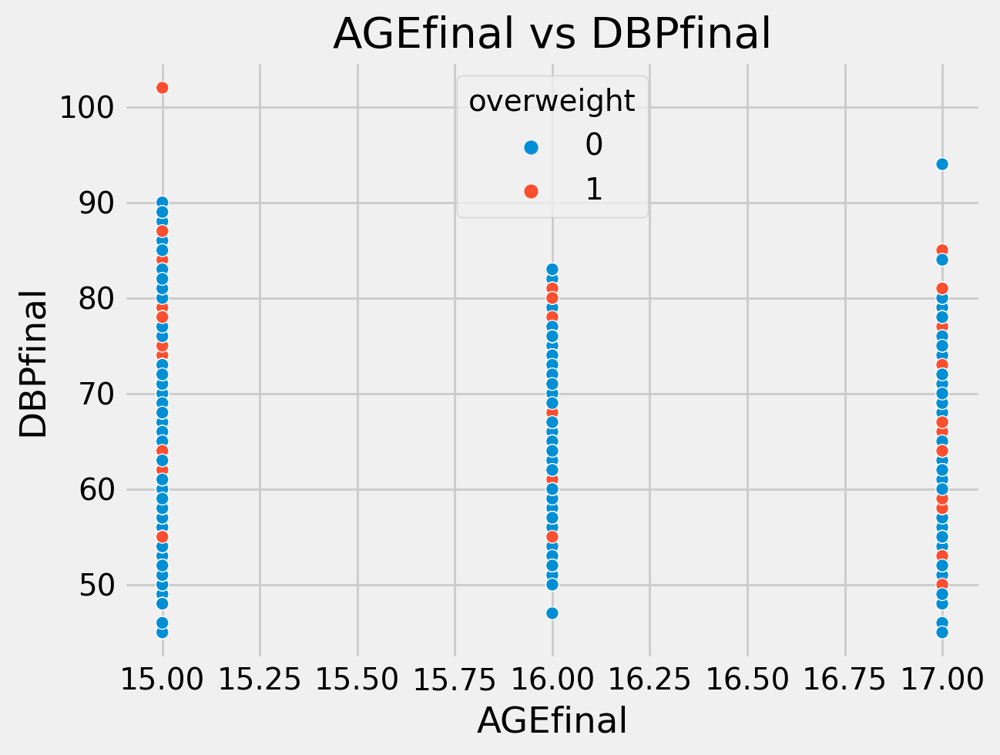

In [ ]:
sns.scatterplot(x='AGEfinal', y='DBPfinal', hue='overweight', data=df)
plt.title('AGEfinal vs DBPfinal')
plt.xlabel('AGEfinal')
plt.ylabel('DBPfinal')
plt.show()

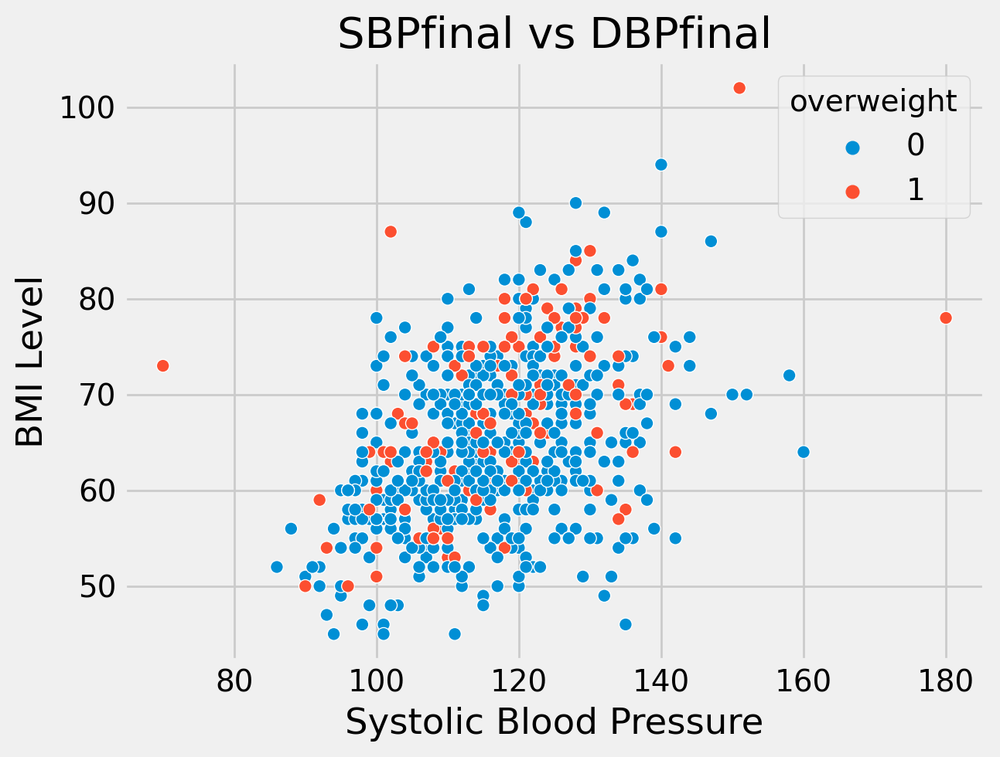

In [ ]:
sns.scatterplot(x='SBPfinal', y='DBPfinal', hue='overweight', data=df)
plt.title('SBPfinal vs DBPfinal')
plt.xlabel('Systolic Blood Pressure')
plt.ylabel('BMI Level')
plt.show()

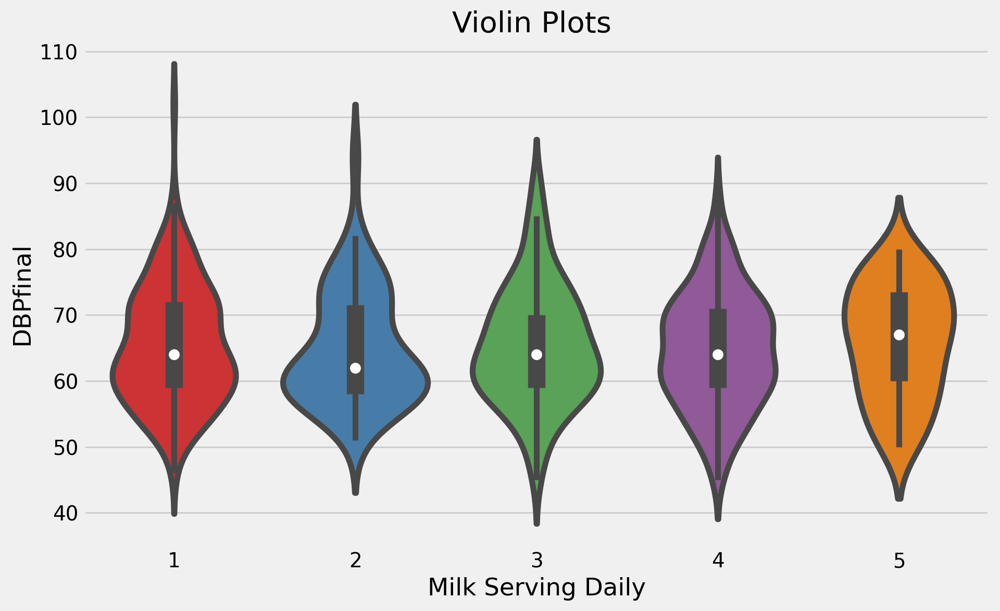

In [ ]:
# Create a figure and axis
plt.figure(figsize=(10, 6))

# Customize your violin plot
sns.violinplot(x='milkserv_daily', y='DBPfinal', data=df, palette='Set1')
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Milk Serving Daily')
plt.ylabel('DBPfinal')
plt.title('Violin Plots ')

# Show the plot
plt.show()


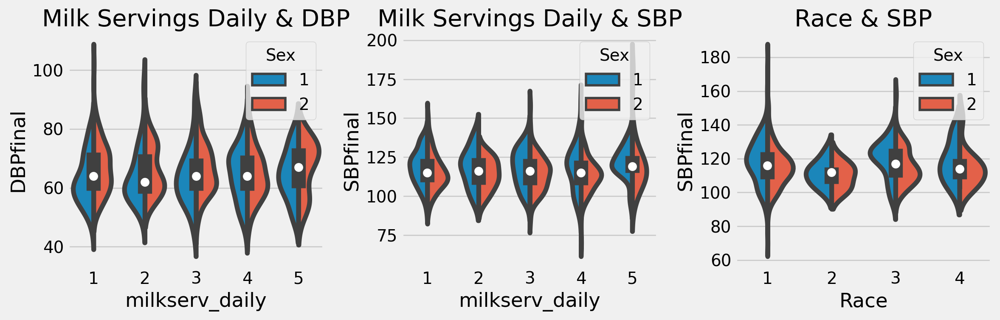

In [ ]:
# Create a figure and three violin subplots
fig, axs = plt.subplots(1, 3, figsize=(12, 4))

# Violin plot of Milk servings daily by Diastolic blood preesure and Sex
sns.violinplot(ax=axs[0], x='milkserv_daily', y='DBPfinal', hue='Sex', split=True, data=df)
axs[0].set_title('Milk Servings Daily & DBP')


# Violin plot of Milk servings by Systolic blood pressure and Sex
sns.violinplot(ax=axs[1], x='milkserv_daily', y='SBPfinal', hue='Sex', split=True, data=df)
axs[1].set_title('Milk Servings Daily & SBP')

# Violin plot of WritingScore by EthnicGroup and Gender
sns.violinplot(ax=axs[2], x='Race', y='SBPfinal', hue='Sex', split=True, data=df)
axs[2].set_title('Race & SBP')

# Adjust the spacing between subplots
plt.tight_layout()

# Display the merged graph
plt.show()

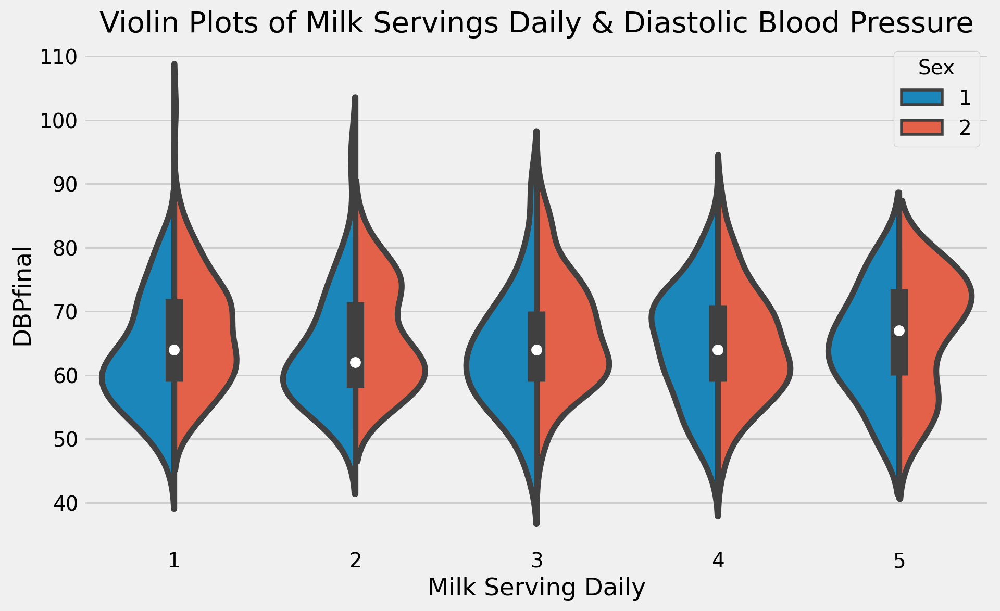

In [ ]:
# Violin plot of Milk servings daily by Diastolic blood preesure and Sex
plt.figure(figsize=(10, 6))
sns.violinplot(x='milkserv_daily', y='DBPfinal', hue='Sex', split=True, data=df)
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Milk Serving Daily')
plt.ylabel('DBPfinal')
plt.title('Violin Plots of Milk Servings Daily & Diastolic Blood Pressure')

# Show the plot
plt.show()



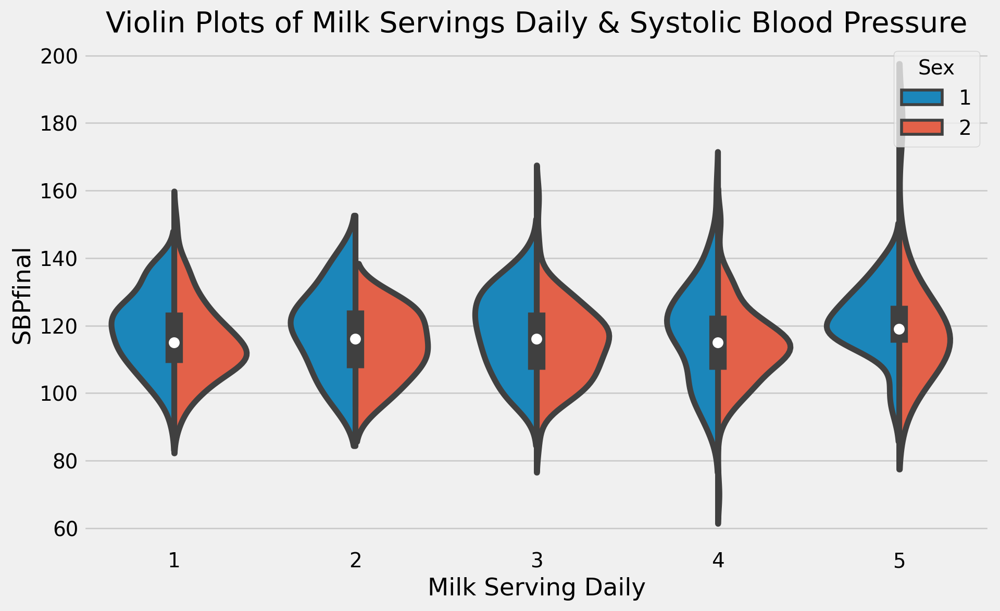

In [ ]:
plt.figure(figsize=(10, 6))
sns.violinplot(x='milkserv_daily', y='SBPfinal', hue='Sex', split=True, data=df)
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Milk Serving Daily')
plt.ylabel('SBPfinal')
plt.title('Violin Plots of Milk Servings Daily & Systolic Blood Pressure')

# Show the plot
plt.show()


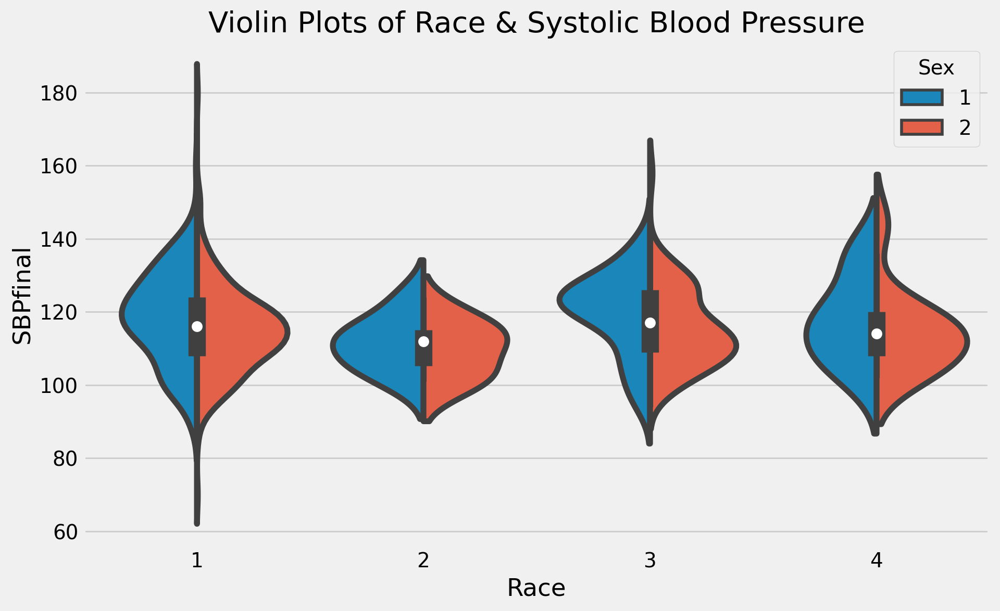

In [ ]:
plt.figure(figsize=(10, 6))
sns.violinplot(x='Race', y='SBPfinal', hue='Sex', split=True, data=df)
# Replace 'x_column_name' and 'y_column_name' with the actual column names you want to plot

# Add labels and title
plt.xlabel('Race')
plt.ylabel('SBPfinal')
plt.title('Violin Plots of Race & Systolic Blood Pressure')

# Show the plot
plt.show()


<AxesSubplot:>

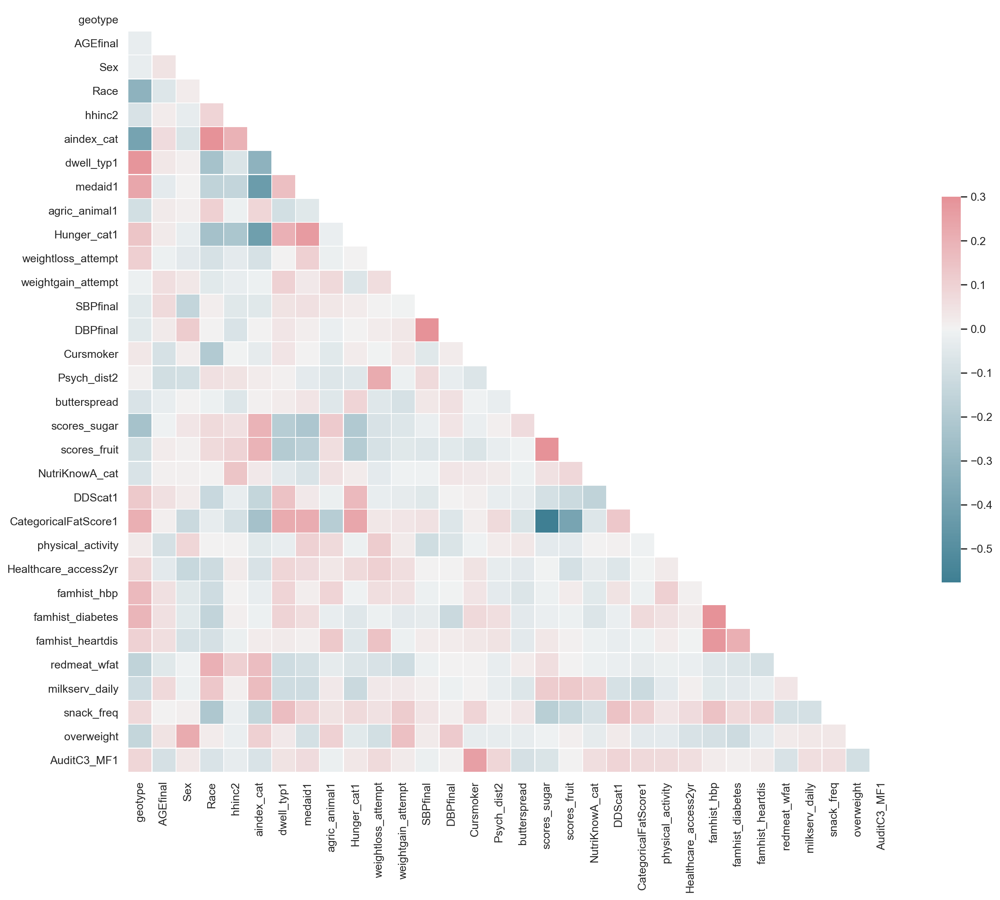

In [ ]:
# i. Correlation Matrix.
sns.set(style="white")


# Compute the correlation matrix
corr = df.corr()

# Generate a mask for the upper triangle
mask = np.zeros_like(corr, dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(15, 13))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5})

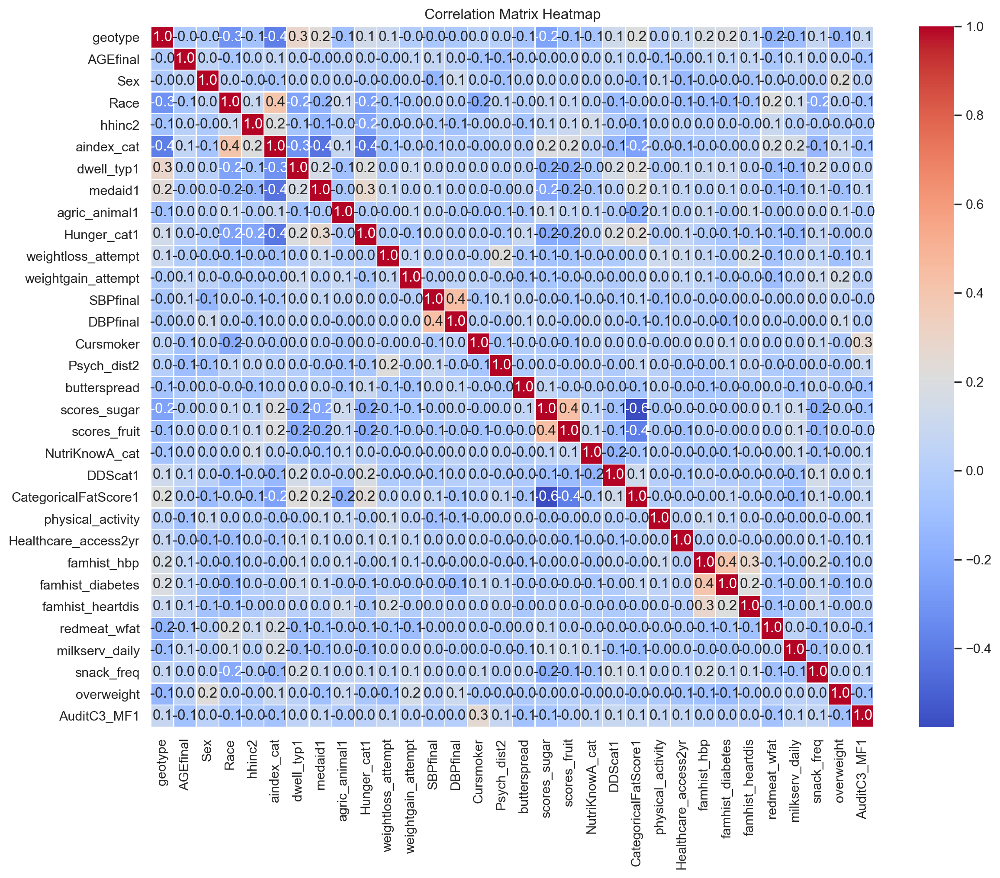

In [ ]:
correlation_matrix = df.corr()
#Graph I.
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5, fmt='.1f')
plt.title("Correlation Matrix Heatmap")
plt.show()

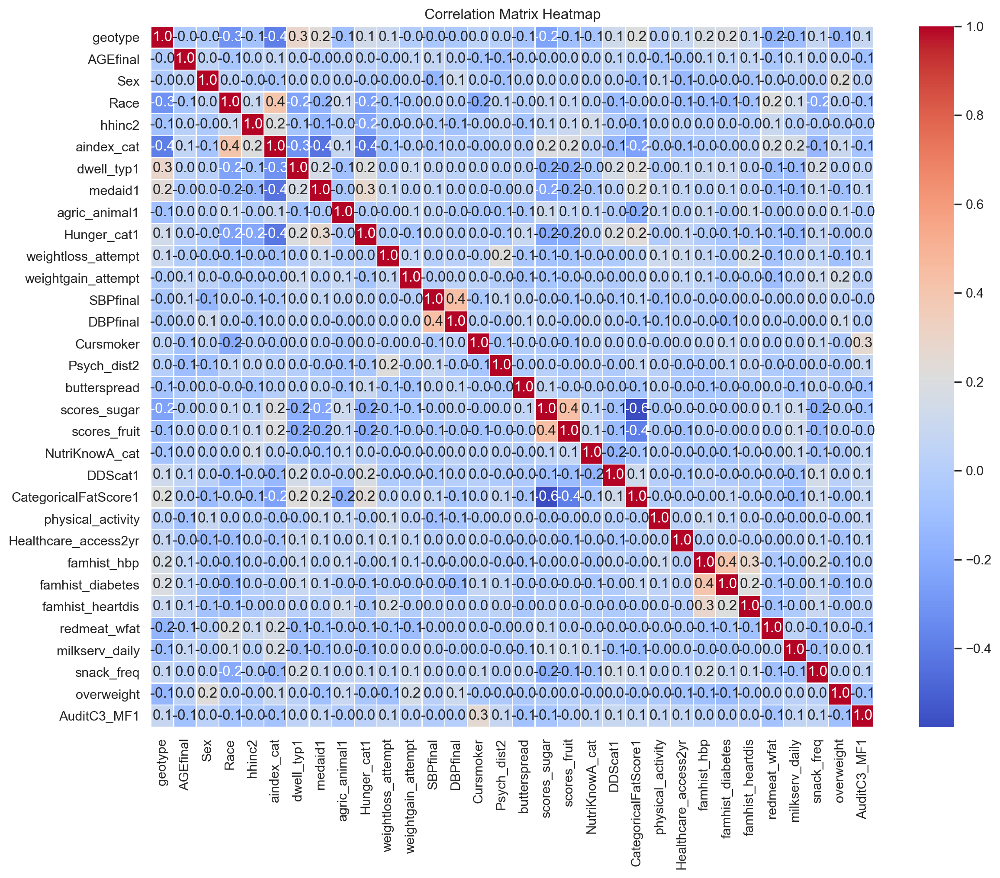

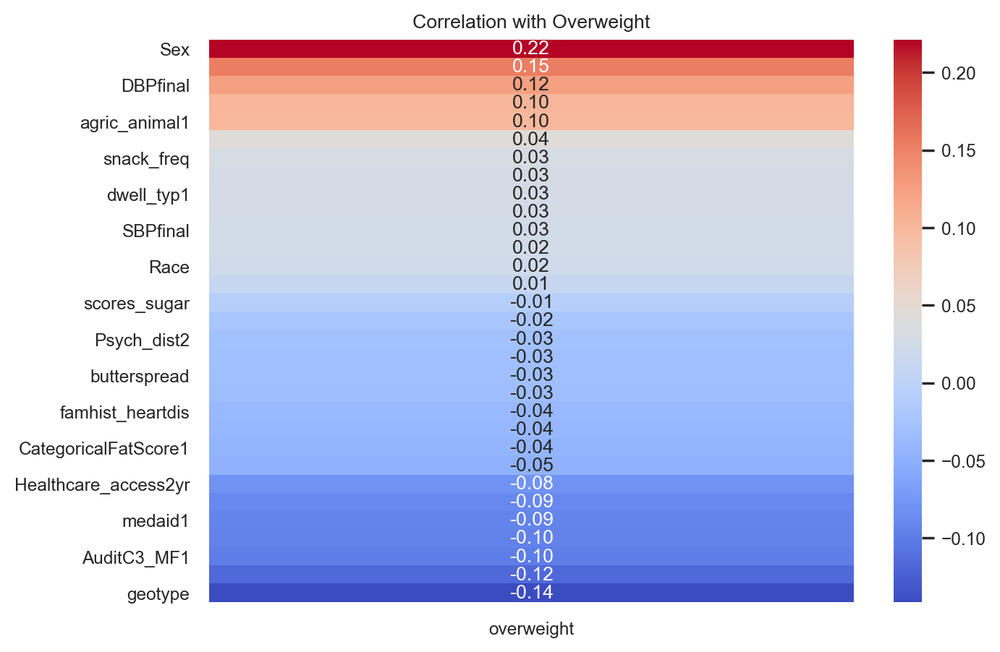

In [ ]:
# Compute the correlation matrix
correlation_matrix = df.corr()
#Graph I.
plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5, fmt='.1f')
plt.title("Correlation Matrix Heatmap")
plt.show()


#Graph II
# Create a heatmap of the correlations with the target column
corr = df.corr()
target_corr = corr['overweight'].drop('overweight')

# Sort correlation values in descending order
target_corr_sorted = target_corr.sort_values(ascending=False)

sns.set(font_scale=0.8)
sns.set_style("white")
sns.set_palette("PuBuGn_d")
sns.heatmap(target_corr_sorted.to_frame(), cmap="coolwarm", annot=True, fmt='.2f')
plt.title('Correlation with Overweight')
plt.show()


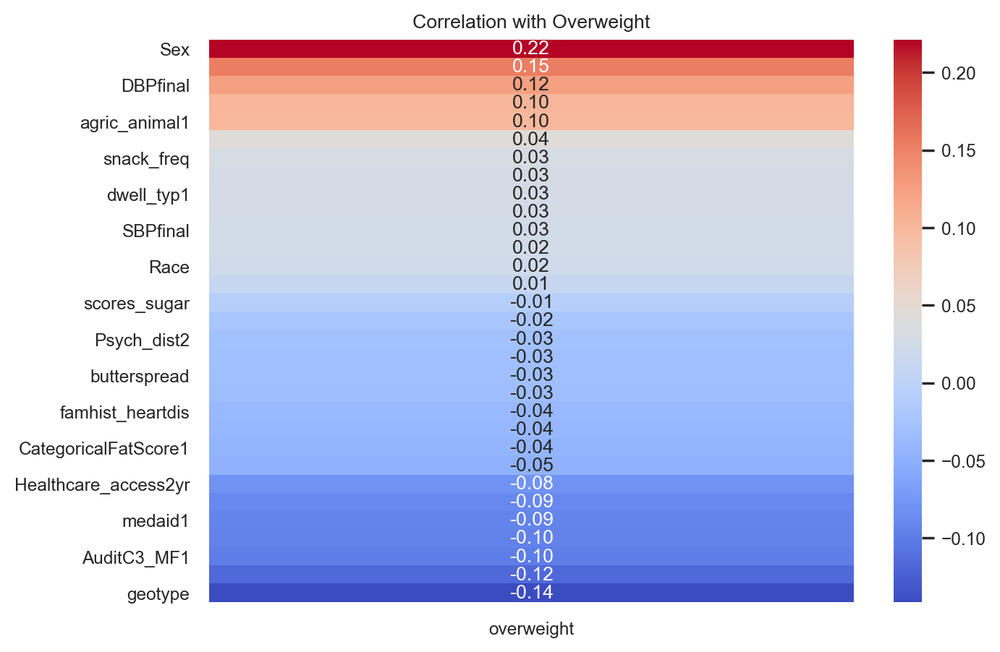

In [ ]:
# Sort correlation values in descending order
target_corr_sorted = target_corr.sort_values(ascending=False)

sns.set(font_scale=0.8)
sns.set_style("white")
sns.set_palette("PuBuGn_d")
sns.heatmap(target_corr_sorted.to_frame(), cmap="coolwarm", annot=True, fmt='.2f')
plt.title('Correlation with Overweight')
plt.show()

# Uncalibrated ML

 ### Dataset Splitting.

In [ ]:
# Splitting the dataset into dependent and independent variables
X = df.drop(["overweight"], axis=1)  # Independent variables
y = df.overweight  # Dependent variable

### Dataset Scaling and Normalization

In [ ]:
# 1. Scaling and Normalization
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

### Feature Selection.

In [ ]:
# Apply SMOTE
sm = SMOTE(random_state=42)
X_res, y_res = sm.fit_resample(X_scaled, y)

# Summarize class distribution before and after SMOTE
print('Original dataset shape:', Counter(y))
print('Resampled dataset shape:', Counter(y_res))

Original dataset shape: Counter({0: 525, 1: 146})
Resampled dataset shape: Counter({1: 525, 0: 525})


### UNCALIBRATED MACHINE LEARNING RESULTS

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import accuracy_score, f1_score, precision_score, matthews_corrcoef, roc_auc_score, recall_score, jaccard_score, brier_score_loss, log_loss
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier

# Split data into training and testing sets
x_train, x_test, y_train, y_test = train_test_split(X_res, y_res, test_size = 0.6, random_state=42)

# Initialize classifiers
classifiers = {
    "Logistic Regression": LogisticRegression(),
    "Naive Bayes": GaussianNB(),
    "Linear Discriminant Analysis": LinearDiscriminantAnalysis(),
    "Support Vector Machine": SVC(probability=True),
    "Decision Tree": DecisionTreeClassifier(),
    "K-Nearest Neighbor": KNeighborsClassifier(),
}

# Evaluate classifiers and apply calibration
results = {}

for name, classifier in classifiers.items():
    classifier.fit(x_train, y_train)

    # Predict probabilities for calibration
    y_pred_proba = classifier.predict_proba(x_test)[:, 1]

    # Uncalibrated metrics
    y_pred = classifier.predict(x_test)
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    mcc = matthews_corrcoef(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred_proba)
    recall = recall_score(y_test, y_pred)

    # Calibrate the classifier
    calibrated_classifier = CalibratedClassifierCV(classifier, method="sigmoid", cv="prefit")
    calibrated_classifier.fit(x_train, y_train)

    # Predict probabilities after calibration
    y_calibrated_proba = calibrated_classifier.predict_proba(x_test)[:, 1]

    # Calibrated metrics
    y_calibrated_pred = calibrated_classifier.predict(x_test)
    jaccard = jaccard_score(y_test, y_calibrated_pred)
    brier = brier_score_loss(y_test, y_calibrated_proba)
    logloss = log_loss(y_test, y_calibrated_proba)

    results[name] = {
        "Uncalibrated Metrics": {
            "Accuracy": accuracy,
            "F1-Score": f1,
            "Precision": precision,
            "Matthews Correlation Coefficient": mcc,
            "ROC-AUC Score": roc_auc,
            "Recall": recall,
        },
        "Calibrated Metrics (Sigmoid)": {
            "Jaccard Score": jaccard,
            "Brier Score": brier,
            "Log Loss": logloss,
        },
    }

# Print the results
for name, metrics in results.items():
    print(f"Classifier: {name}")
    for metric_name, metric_value in metrics.items():
        print(f"{metric_name}: {metric_value}")
    print()


Classifier: Logistic Regression
Uncalibrated Metrics: {'Accuracy': 0.6571428571428571, 'F1-Score': 0.6851311953352769, 'Precision': 0.5860349127182045, 'Matthews Correlation Coefficient': 0.3553406144910273, 'ROC-AUC Score': 0.7152809560132215, 'Recall': 0.8245614035087719}
Calibrated Metrics (Sigmoid): {'Jaccard Score': 0.5188470066518847, 'Brier Score': 0.2339541814441371, 'Log Loss': 0.6923027543310918}

Classifier: Naive Bayes
Uncalibrated Metrics: {'Accuracy': 0.5523809523809524, 'F1-Score': 0.6634844868735084, 'Precision': 0.5027124773960217, 'Matthews Correlation Coefficient': 0.2709978619102221, 'ROC-AUC Score': 0.7120264429188915, 'Recall': 0.9754385964912281}
Calibrated Metrics (Sigmoid): {'Jaccard Score': 0.4919499105545617, 'Brier Score': 0.2476253498714166, 'Log Loss': 0.6840256482282329}

Classifier: Linear Discriminant Analysis
Uncalibrated Metrics: {'Accuracy': 0.6619047619047619, 'F1-Score': 0.6917510853835022, 'Precision': 0.5886699507389163, 'Matthews Correlation Coe

In [ ]:
df = pd.read_csv('Desktop/Downloads/odata.csv', delimiter = ',')

In [ ]:
# Splitting our dataset into dependent and independent variables
X = df.drop(["overweight"], axis=1)  # Independent variables
y = df.overweight  # Dependent variable

# 1. Scaling and Normalization
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 2. Feature Selection
selector = SelectKBest(score_func=f_classif, k=10)  # Select the top 10 features
X_selected = selector.fit_transform(X_scaled, y)

In [ ]:
train_perc_1 = .6
calib_perc_1 = .05
test_perc_1 = 1-train_perc_1-calib_perc_1
rs = 42

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=test_perc_1, random_state=rs)

In [ ]:
X_train, X_calib, y_train, y_calib = train_test_split(X_train, y_train,
                                                              test_size=calib_perc_1/(1-test_perc_1),
                                                              random_state=rs)

In [ ]:
from imblearn.over_sampling import SMOTE
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
# Perform oversampling using SMOTE
smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train, y_train)

# Verify the class distribution before and after oversampling
print("Before oversampling: ", y_train.value_counts())
print("After oversampling: ", y_train_resampled.value_counts())


Before oversampling:  0    313
1     89
Name: overweight, dtype: int64
After oversampling:  0    313
1    313
Name: overweight, dtype: int64


In [ ]:
### Calibration CV Gridsearch

In [ ]:
# Dictionary of classifiers using the tuned model parameters
clf_dict = { 'LR': LogisticRegression(C=0.1, class_weight='balanced', max_iter=3000, penalty='l1', solver='liblinear', random_state=8), 'NB': GaussianNB(var_smoothing=0.0001, priors=None), 'SVM': SVC(C=1000, kernel='rbf', gamma=0.01, class_weight='balanced', max_iter=200000, random_state=8), 'KNN': KNeighborsClassifier(),
              'DT': DecisionTreeClassifier(random_state=123),
              'LDA': LDA(),
}

In [ ]:
def prob_calibration(X_train, y_train, X_test, y_test, dictionary, new_dictionary, verbose=True):
    '''
    Fits a dictionary of algorithms, run calibration, capture best_estimators, & generate calibration curves
    '''
    # Setting the calibration plot parameters
    plt.figure(figsize=(12, 10))
    ax1 = plt.subplot2grid((3, 1), (0, 0), rowspan=2)
    ax2 = plt.subplot2grid((3, 1), (2, 0))
    ax1.plot([0, 1], [0, 1], "k:", label="Perfectly calibrated")

    # Loop through dictionary items
    for key, clf in dictionary.items():

        # Set calibration parameters
        calibrated = CalibratedClassifierCV(clf, cv=3)
        param_grid = dict(method=['sigmoid','isotonic'])

        # Gridsearch on best probability scaling regressor
        kf = StratifiedKFold(n_splits=3)
        clf_grid = GridSearchCV(estimator=calibrated, param_grid=param_grid, n_jobs=-1,
                                cv=kf, scoring='neg_brier_score')  # Use 'neg_brier_score' for Brier score

        clf_grid = clf_grid.fit(X_train, y_train)

        # Populating new dictionary with the Gridsearch best_estimators
        new_dictionary[key] = clf_grid.best_estimator_
        print('{} optimal calibration {}'.format(key, clf_grid.best_params_))

        # Retrieving predicted probabilities
        prob_pos = clf_grid.best_estimator_.predict_proba(X_test)[:, 1]

        fraction_of_positives, mean_predicted_value = calibration_curve(y_test, prob_pos, n_bins=10)

        ax1.plot(mean_predicted_value, fraction_of_positives, "s-",
             label="%s" % (key, ))

        ax2.hist(prob_pos, range=(0, 1), bins=10, label=key,
             histtype="step", lw=2)

    # Generate calibration curves
    ax1.set_ylabel("Fraction of positives")
    ax1.set_ylim([-0.05, 1.05])
    ax1.legend(loc="upper left", fontsize=12)
    ax1.set_title('Calibration Curves of the Respective Algorithms', fontsize=18)

    ax2.set_xlabel("Mean predicted value")
    ax2.set_ylabel("Count")
    ax2.legend(loc="upper right", ncol=2, fontsize=12)

    plt.tight_layout()
    plt.show()

In [ ]:
# Using only the training data as split initially for the calibration train-validation tuning
X_train_cab, X_test_cab, y_train_cab, y_test_cab = train_test_split(X_train_resampled, y_train_resampled,
                                                                    stratify=y_train_resampled, test_size=0.3, random_state=8)

In [ ]:
# Create an empty dictionary to contain the probability scaled models
clf_cal_dict = {}

LR optimal calibration {'method': 'isotonic'}
NB optimal calibration {'method': 'isotonic'}
SVM optimal calibration {'method': 'isotonic'}
KNN optimal calibration {'method': 'sigmoid'}
DT optimal calibration {'method': 'isotonic'}
LDA optimal calibration {'method': 'isotonic'}


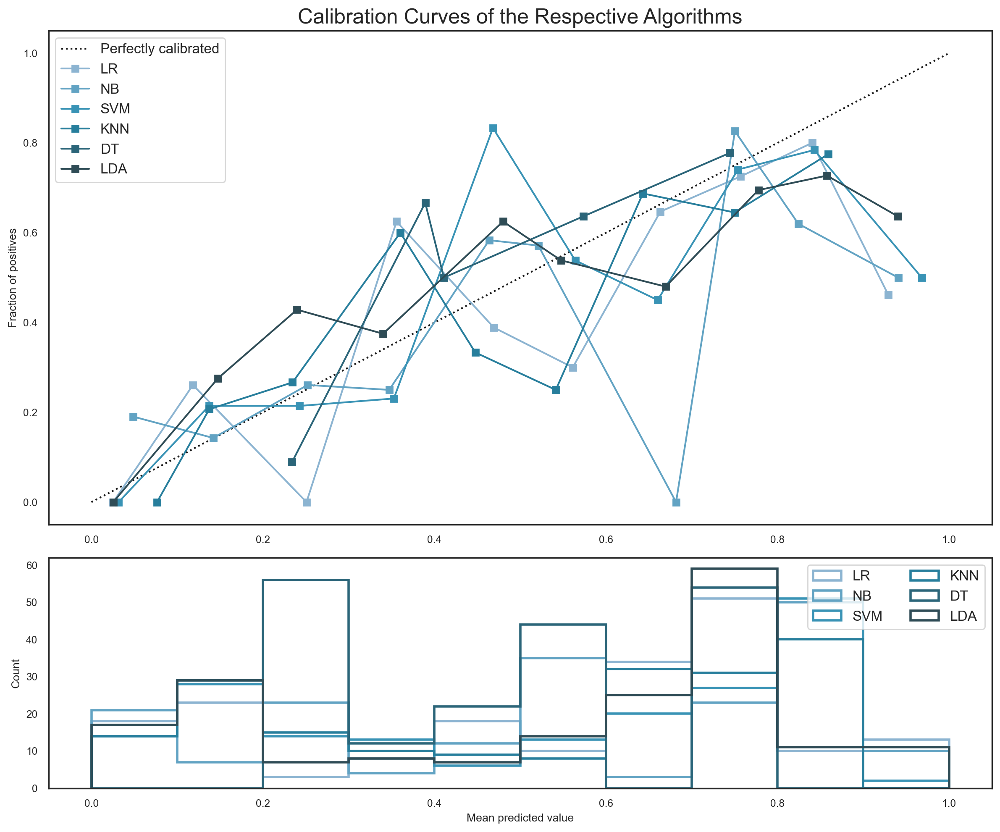

In [ ]:
# Create an empty dictionary to contain the probability scaled models
clf_cal_dict = {}
# Call the function
prob_calibration(X_train_cab, y_train_cab, X_test_cab, y_test_cab, clf_dict, clf_cal_dict)

In [ ]:
clf_cal_dict

{'LR': CalibratedClassifierCV(base_estimator=LogisticRegression(C=0.1,
                                                          class_weight='balanced',
                                                          max_iter=3000,
                                                          penalty='l1',
                                                          random_state=8,
                                                          solver='liblinear'),
                        cv=3, method='isotonic'),
 'NB': CalibratedClassifierCV(base_estimator=GaussianNB(var_smoothing=0.0001), cv=3,
                        method='isotonic'),
 'SVM': CalibratedClassifierCV(base_estimator=SVC(C=1000, class_weight='balanced',
                                           gamma=0.01, max_iter=200000,
                                           random_state=8),
                        cv=3, method='isotonic'),
 'KNN': CalibratedClassifierCV(base_estimator=KNeighborsClassifier(), cv=3),
 'DT': CalibratedClassifier

In [ ]:
# Getting Predicted Probabilities on Training Set

In [ ]:
def prob_predictions(X, y, dictionary):
    '''
    Fits a dictionary of algorithms, get predicted probabilities, & populate DF with probabilities
    '''
    # Empty dictionary with keys according to the clf models
    adf = pd.DataFrame(columns=dictionary.keys()) # Columns of DF will accord with dictionary keys

    for key, clf in dictionary.items():
        clf.fit(X, y)

        if hasattr(clf, "predict_proba"):
            prob_pos = clf.predict_proba(X)[:, 1] # The predicted probabilities are in a Numpy array
        else:
            prob_pos = clf.decision_function(X)
            prob_pos = (prob_pos - prob_pos.min())/(prob_pos.max() - prob_pos.min())

        # Appending Numpy array of probabilities to Pandas Dataframe
        adf[key] = pd.Series(prob_pos).transpose()

    return adf

In [ ]:
train_probabilities = prob_predictions(X_train_resampled, y_train_resampled, clf_cal_dict)

In [ ]:
train_probabilities

,LR,NB,SVM,KNN,DT,LDA
0,0.279798,0.083487,0.092593,0.192621,0.179491,0.225096
1,0.811869,0.790556,0.558333,0.649617,0.645246,0.815821
2,0.053763,0.067949,0.000000,0.075643,0.179491,0.000000
3,0.144673,0.242127,0.193651,0.075643,0.179491,0.141762
4,0.465765,0.576547,0.193651,0.324125,0.179491,0.265572
...,...,...,...,...,...,...
621,0.465765,0.530093,0.358277,0.316526,0.813594,0.469048
622,0.653590,0.576547,0.840831,0.697401,0.572236,0.670726
623,0.683022,0.591097,0.706825,0.771260,0.776998,0.775437
624,0.653590,0.576547,0.784287,0.627567,0.813594,0.657290


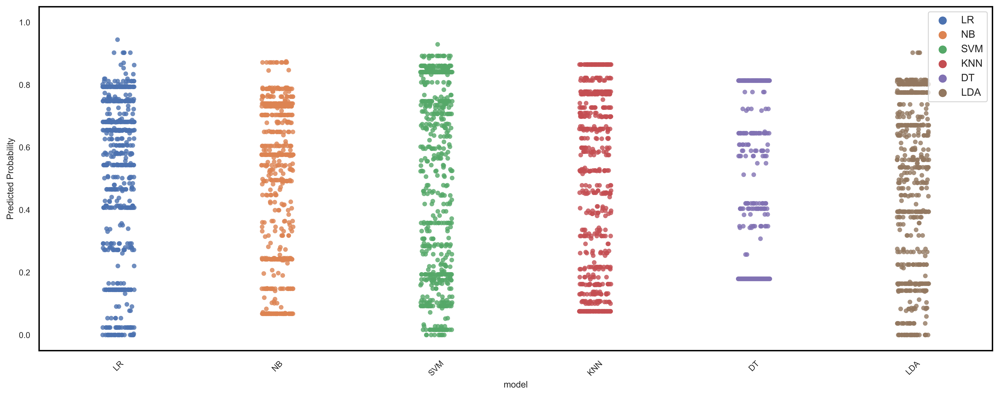

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Assuming you have 'train_probabilities' DataFrame and necessary data

plt.figure(figsize=(15, 6), dpi=300)  # Increase dpi for sharper image
sns.set_style("white")  # Set plain background style without grid

df_melt = pd.melt(train_probabilities, var_name='model', value_name='probabilities')

# Adjust the palette and alpha for sharper and deeper color
dot_palette = sns.color_palette("deep")  # You can use other palettes as well
sns.stripplot(x='model', y='probabilities', data=df_melt, hue='model', jitter=0.1, alpha=0.8, palette=dot_palette)

ax = plt.gca()
ax.set_ylabel("Predicted Probability")
ax.legend(loc="upper right", fontsize=11)
ax.set_ylim([-0.05, 1.05])
plt.xticks(rotation=45)

# Removing spines
sns.despine()

# Adjusting the edge color and linewidth of the spines
for spine in ax.spines.values():
    spine.set_visible(True)
    spine.set_edgecolor('black')
    spine.set_linewidth(1.5)

plt.tight_layout()
plt.show()


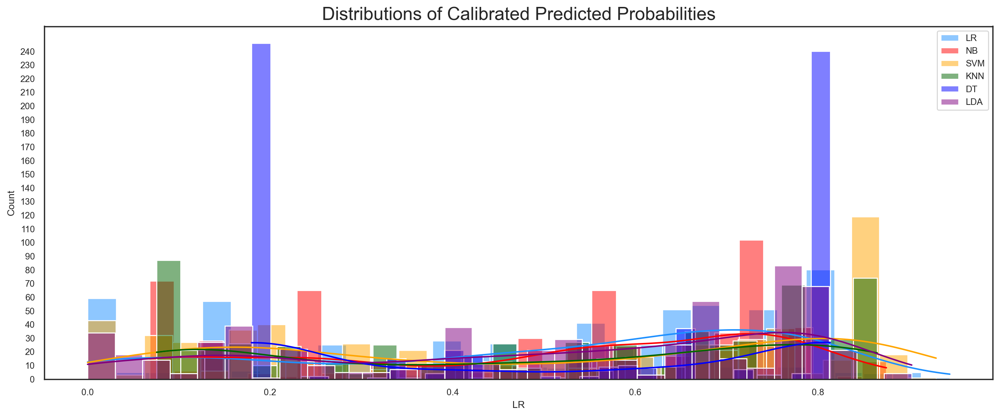

In [ ]:
fig, ax = plt.subplots(figsize=(15,6))

sns.histplot(train_probabilities['LR'], bins=30, kde=True, ax=ax,
             color='dodgerblue', label='LR')
sns.histplot(train_probabilities['NB'], bins=30, kde=True, ax=ax,
             color='red', label='NB')
sns.histplot(train_probabilities['SVM'], bins=30, kde=True, ax=ax,
             color='orange', label='SVM')
sns.histplot(train_probabilities['KNN'], bins=30, kde=True, ax=ax,
             color='darkgreen', label='KNN')
sns.histplot(train_probabilities['DT'], bins=30, kde=True, ax=ax,
             color='blue', label='DT')
sns.histplot(train_probabilities['LDA'], bins=30, kde=True, ax=ax,
             color='purple', label='LDA')


ax.yaxis.set_ticks(np.arange(0.00, 250, 10))
ax.legend(loc="upper right", fontsize=12)
plt.title('Distributions of Calibrated Predicted Probabilities', fontsize=18)
plt.legend();

In [ ]:
# Altering Probability Thresholds

In [ ]:
def f1_threshold(precision, recall):
    numer = 2 * recall * precision
    denom = recall + precision
    f1_scores = np.divide(numer, denom, out=np.zeros_like(denom), where=(denom!=0))
    max_f1 = np.max(f1_scores)
    max_f1_thresh = thresholds[np.argmax(f1_scores)]

    print("Maximum F1 score: {:0.4f}".format(max_f1))
    print("Optimal probability threshold: {:0.4f}".format(max_f1_thresh))
    return max_f1_thresh

In [ ]:
### LOGISTIC REGRESSION

In [ ]:
precision, recall, thresholds = precision_recall_curve(y_train_resampled, train_probabilities['LR'],
                                                       pos_label=1)
thresholds = np.append(thresholds, 1)

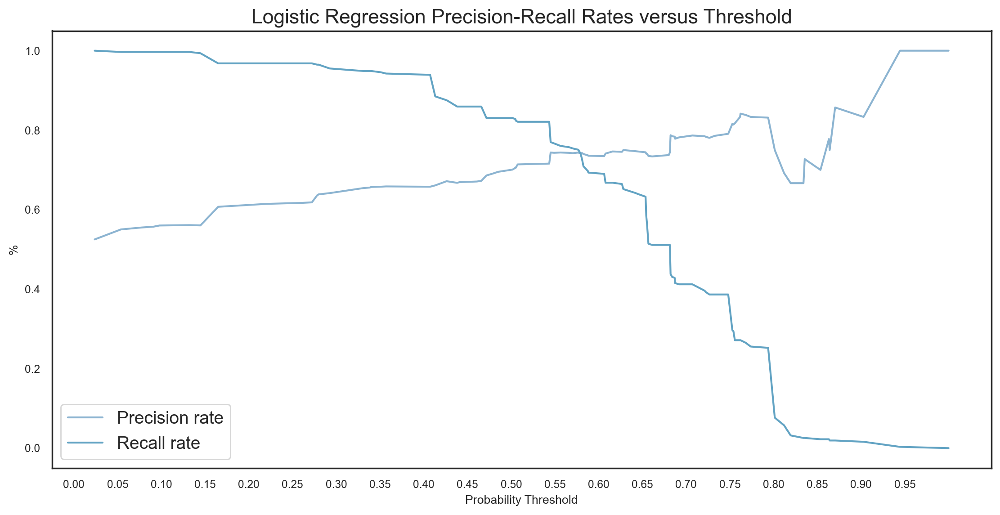

In [ ]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(thresholds, precision, color=sns.color_palette()[0])
ax.plot(thresholds, recall, color=sns.color_palette()[1])
ax.legend(('Precision rate', 'Recall rate'), fontsize=14)

ax.set_title("Logistic Regression Precision-Recall Rates versus Threshold", fontsize=16)
ax.set_xlabel('Probability Threshold')
ax.xaxis.set_ticks(np.arange(0.00, 1.00, 0.05))
ax.set_ylabel('%');

In [ ]:
threshold = f1_threshold(precision, recall)

Maximum F1 score: 0.7765
Optimal probability threshold: 0.3399


In [ ]:
threshold

0.3399014778325123

In [ ]:
p_list = train_probabilities['LR'].tolist()
logit_train_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
p_list = clf_cal_dict['LR'].predict_proba(X_test)[:, 1].tolist()
logit_test_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
### SUPPORT VECTOR MACHINES(S.V.M)

In [ ]:
precision, recall, thresholds = precision_recall_curve(y_train_resampled, train_probabilities['SVM'],
                                                       pos_label=1)
thresholds = np.append(thresholds, 1)

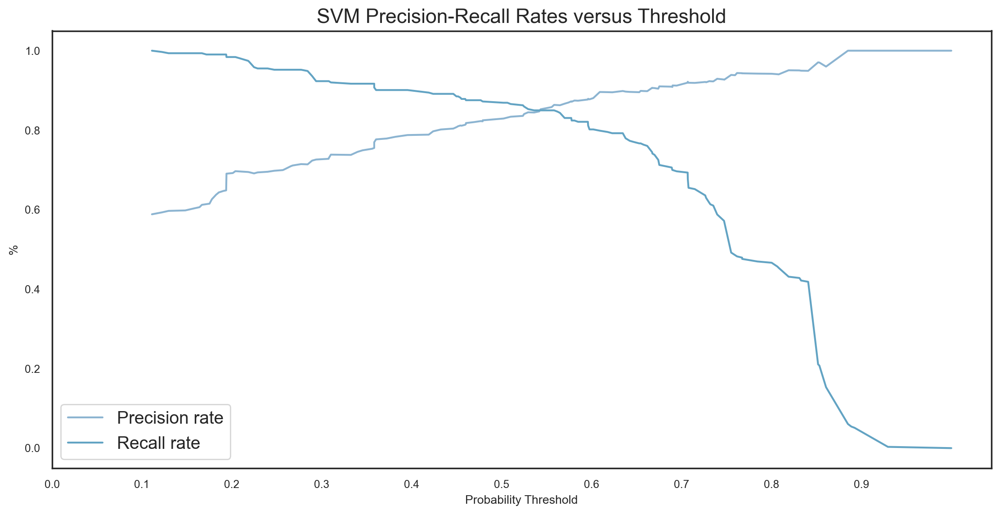

In [ ]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(thresholds, precision, color=sns.color_palette()[0])
ax.plot(thresholds, recall, color=sns.color_palette()[1])
ax.legend(('Precision rate', 'Recall rate'), fontsize=14)

ax.set_title("SVM Precision-Recall Rates versus Threshold", fontsize=16)
ax.set_xlabel('Probability Threshold')
ax.xaxis.set_ticks(np.arange(0.00, 1.00, 0.1))
ax.set_ylabel('%');

In [ ]:
threshold = f1_threshold(precision, recall)

Maximum F1 score: 0.8567
Optimal probability threshold: 0.5583


In [ ]:
p_list = train_probabilities['SVM'].tolist()
svc_train_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
p_list = clf_cal_dict['SVM'].predict_proba(X_test)[:, 1].tolist()
svc_test_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
### K-NEAREST NEIGHBOUR(KNN)

In [ ]:
precision, recall, thresholds = precision_recall_curve(y_train_resampled, train_probabilities['KNN'],
                                                       pos_label=1)
thresholds = np.append(thresholds, 1)

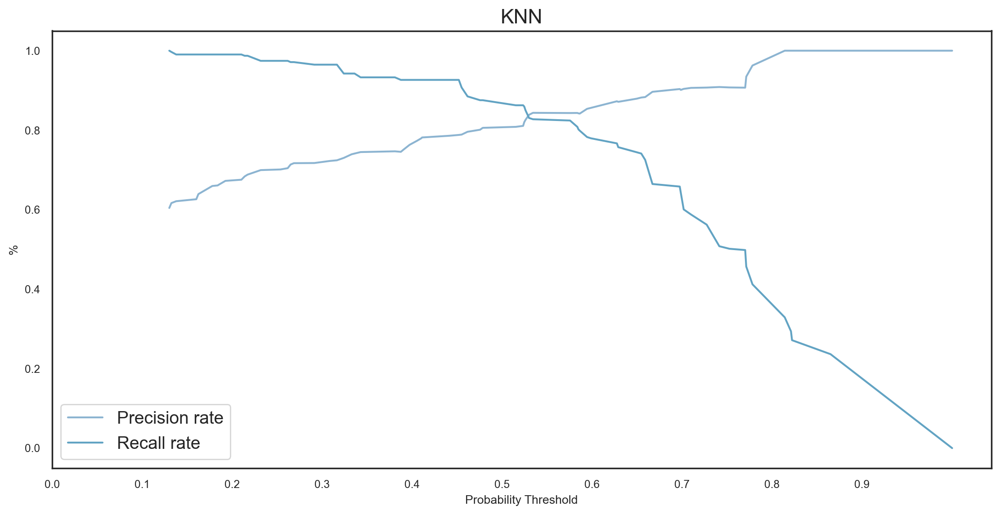

In [ ]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(thresholds, precision, color=sns.color_palette()[0])
ax.plot(thresholds, recall, color=sns.color_palette()[1])
ax.legend(('Precision rate', 'Recall rate'), fontsize=14)

ax.set_title("KNN", fontsize=16)
ax.set_xlabel('Probability Threshold')
ax.xaxis.set_ticks(np.arange(0.00, 1.00, 0.1))
ax.set_ylabel('%');

In [ ]:
threshold = f1_threshold(precision, recall)

Maximum F1 score: 0.8517
Optimal probability threshold: 0.4520


In [ ]:
p_list = train_probabilities['KNN'].tolist()
knn_train_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
p_list = clf_cal_dict['KNN'].predict_proba(X_test)[:, 1].tolist()
knn_test_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
### DECISION TREES

In [ ]:
precision, recall, thresholds = precision_recall_curve(y_train_resampled, train_probabilities['DT'],
                                                       pos_label=1)
thresholds = np.append(thresholds, 1)

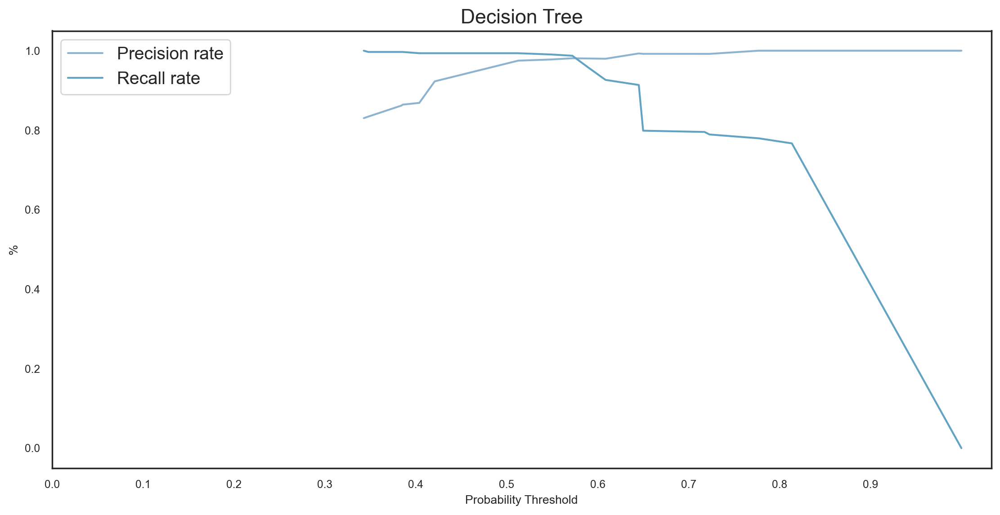

In [ ]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(thresholds, precision, color=sns.color_palette()[0])
ax.plot(thresholds, recall, color=sns.color_palette()[1])
ax.legend(('Precision rate', 'Recall rate'), fontsize=14)

ax.set_title("Decision Tree", fontsize=16)
ax.set_xlabel('Probability Threshold')
ax.xaxis.set_ticks(np.arange(0.00, 1.00, 0.1))
ax.set_ylabel('%');

In [ ]:
threshold = f1_threshold(precision, recall)

Maximum F1 score: 0.9842
Optimal probability threshold: 0.5126


In [ ]:
p_list = train_probabilities['DT'].tolist()
DT_train_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
p_list = clf_cal_dict['DT'].predict_proba(X_test)[:, 1].tolist()
DT_test_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
### NAIVE-BAYES

In [ ]:
precision, recall, thresholds = precision_recall_curve(y_train_resampled, train_probabilities['NB'],
                                                       pos_label=1)
thresholds = np.append(thresholds, 1)

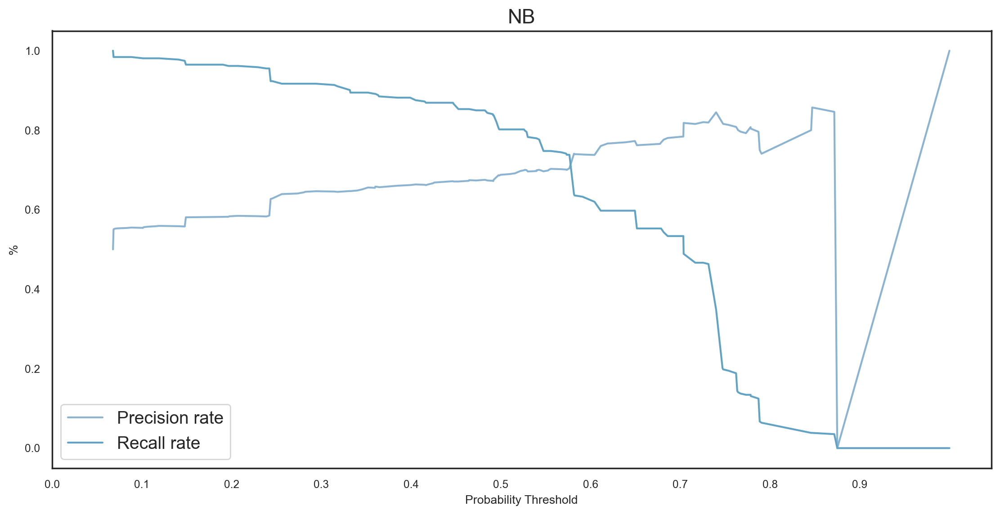

In [ ]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(thresholds, precision, color=sns.color_palette()[0])
ax.plot(thresholds, recall, color=sns.color_palette()[1])
ax.legend(('Precision rate', 'Recall rate'), fontsize=14)

ax.set_title("NB", fontsize=16)
ax.set_xlabel('Probability Threshold')
ax.xaxis.set_ticks(np.arange(0.00, 1.00, 0.1))
ax.set_ylabel('%');

In [ ]:
threshold = f1_threshold(precision, recall)

Maximum F1 score: 0.7583
Optimal probability threshold: 0.2940


In [ ]:
p_list = train_probabilities['NB'].tolist()
NB_train_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
p_list = clf_cal_dict['NB'].predict_proba(X_test)[:, 1].tolist()
NB_test_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
### LINEAR DISCRIMINANT ANALYSIS

In [ ]:
precision, recall, thresholds = precision_recall_curve(y_train_resampled, train_probabilities['LDA'],
                                                       pos_label=1)
thresholds = np.append(thresholds, 1)

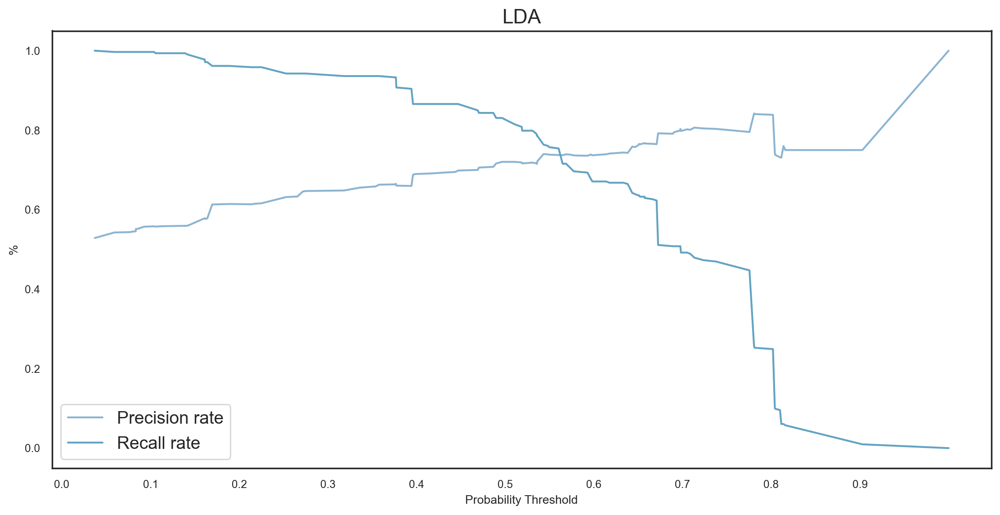

In [ ]:
fig, ax = plt.subplots(figsize=(12,6))

ax.plot(thresholds, precision, color=sns.color_palette()[0])
ax.plot(thresholds, recall, color=sns.color_palette()[1])
ax.legend(('Precision rate', 'Recall rate'), fontsize=14)

ax.set_title("LDA", fontsize=16)
ax.set_xlabel('Probability Threshold')
ax.xaxis.set_ticks(np.arange(0.00, 1.00, 0.1))
ax.set_ylabel('%');

In [ ]:
threshold = f1_threshold(precision, recall)

Maximum F1 score: 0.7766
Optimal probability threshold: 0.3767


In [ ]:
p_list = train_probabilities['LDA'].tolist()
LDA_train_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
p_list = clf_cal_dict['LDA'].predict_proba(X_test)[:, 1].tolist()
LDA_test_class = [1 if i > threshold else 0 for i in p_list]

In [ ]:
print("NaN or Inf values in X_train_resampled:", np.any(np.isnan(X_train_resampled)) or np.any(np.isinf(X_train_resampled)))
print("NaN or Inf values in y_train_resampled:", np.any(np.isnan(y_train_resampled)) or np.any(np.isinf(y_train_resampled)))
print("NaN or Inf values in X_test:", np.any(np.isnan(X_test)) or np.any(np.isinf(X_test)))
print("NaN or Inf values in y_test:", np.any(np.isnan(y_test)) or np.any(np.isinf(y_test)))

NaN or Inf values in X_train_resampled: False
NaN or Inf values in y_train_resampled: False
NaN or Inf values in X_test: False
NaN or Inf values in y_test: False


In [ ]:
## Comparative Test Scoring.

### BETA CALIBRATION.

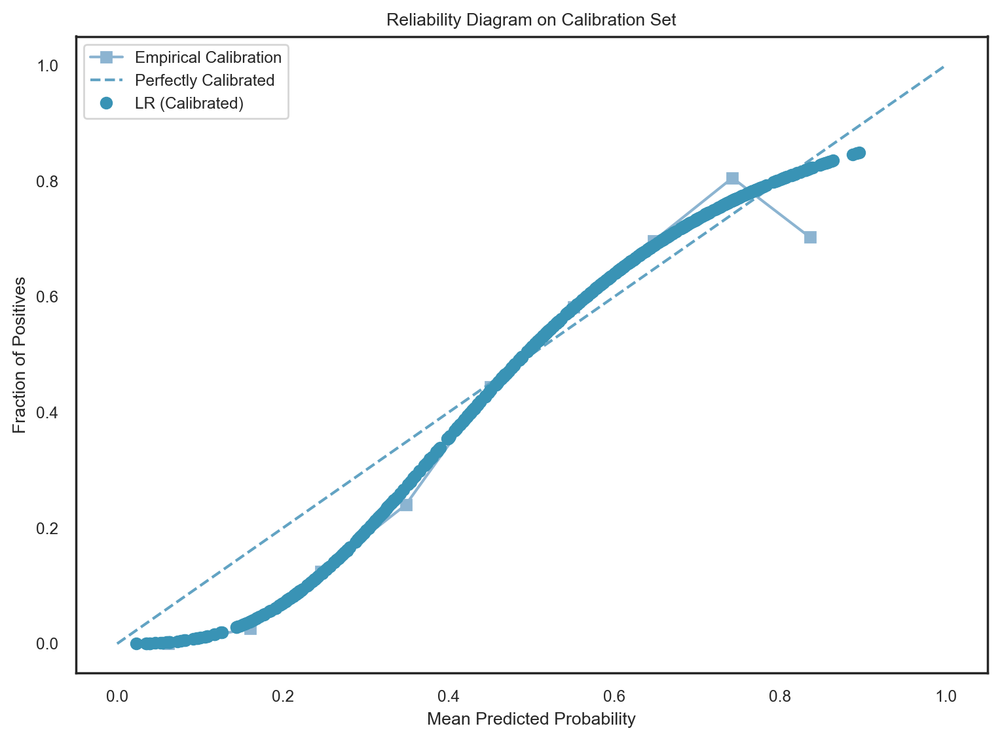

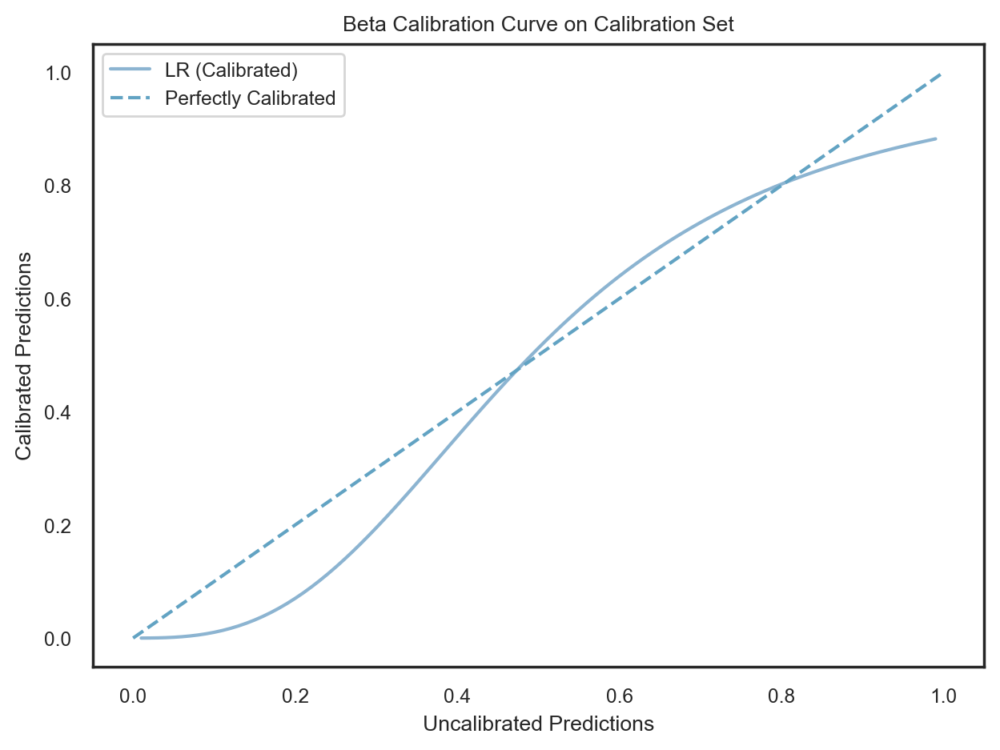

Classifier: LR
Brier Score: 0.2443
Jaccard Score: 0.2556
F1 Score: 0.4072
Accuracy: 0.5787
ROC AUC: 0.6778
Precision: 0.2881
Recall: 0.6939
Log Loss: 0.6699
MCC: 0.1968
---------------------------------------------------


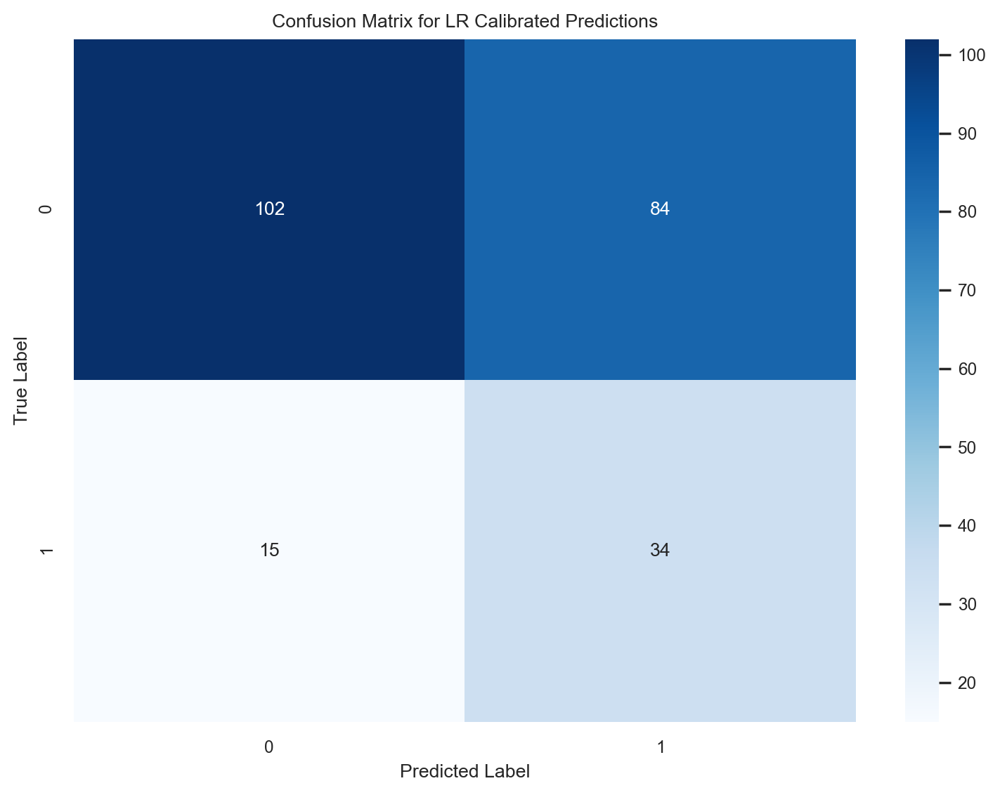

---------------------------------------------------


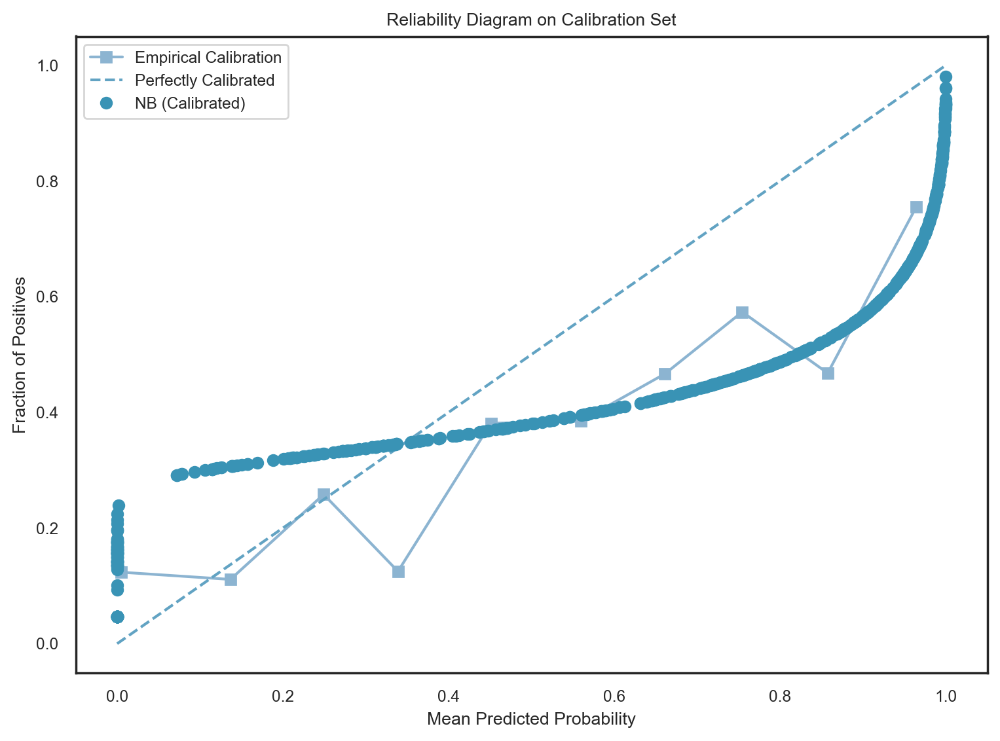

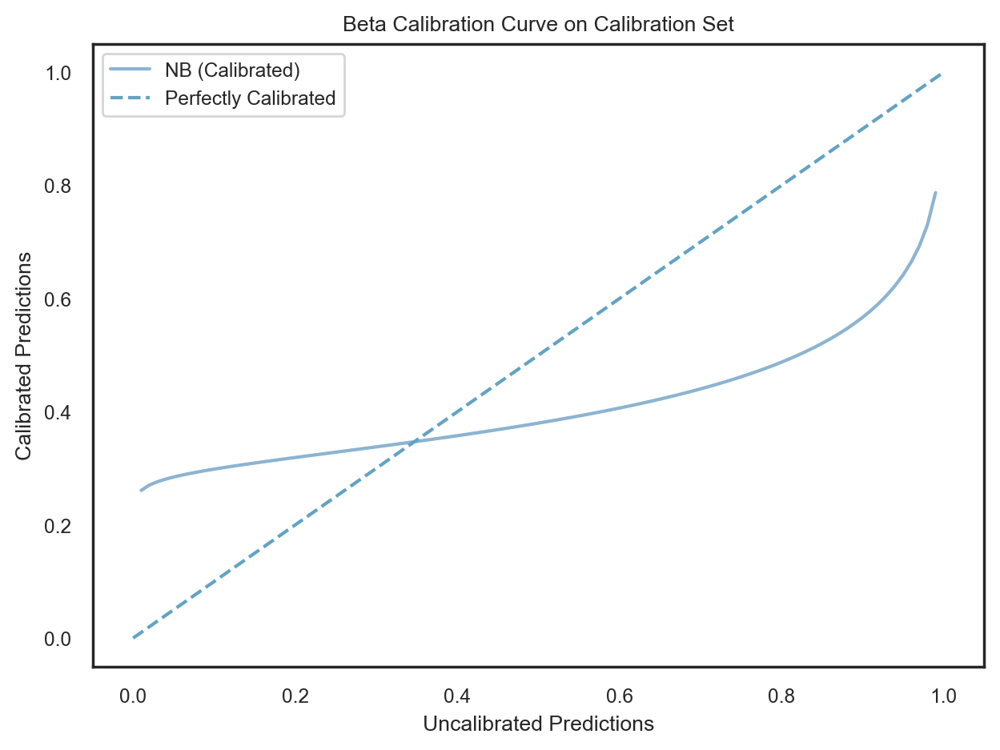

Classifier: NB
Brier Score: 0.2287
Jaccard Score: 0.2617
F1 Score: 0.4148
Accuracy: 0.6638
ROC AUC: 0.6837
Precision: 0.3256
Recall: 0.5714
Log Loss: 0.6716
MCC: 0.2189
---------------------------------------------------


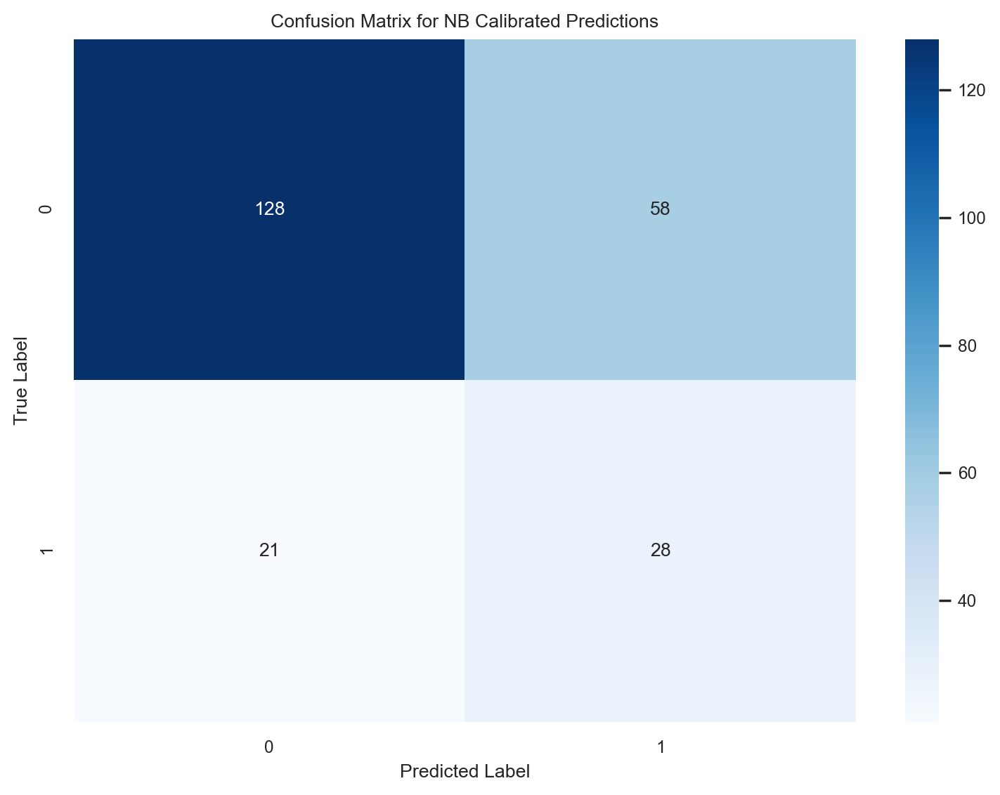

---------------------------------------------------


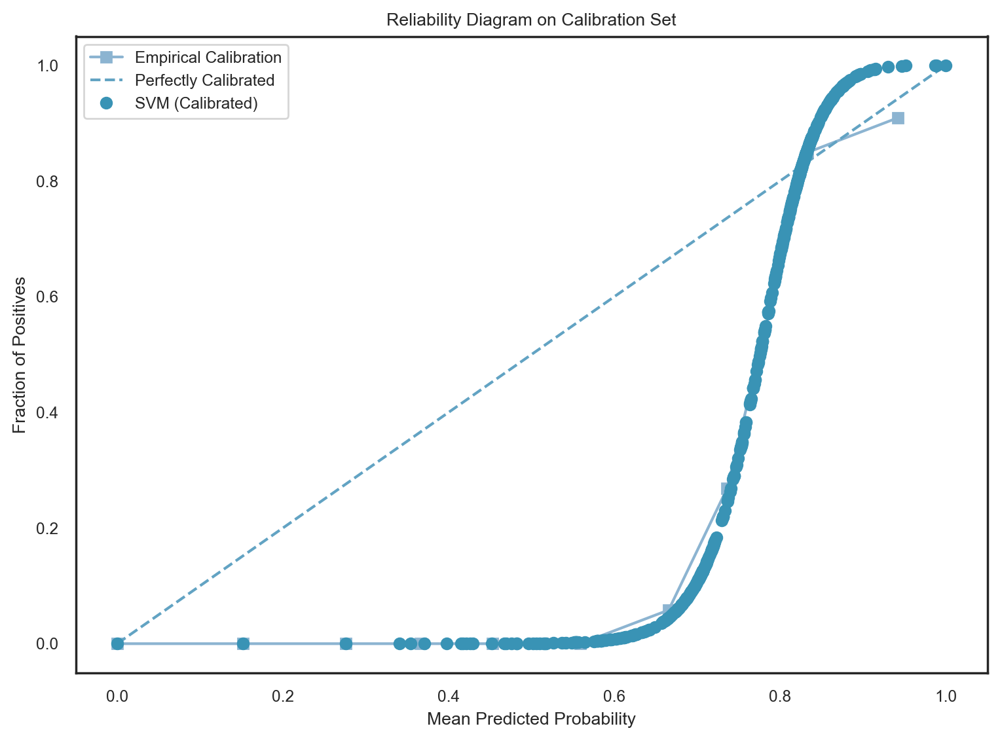

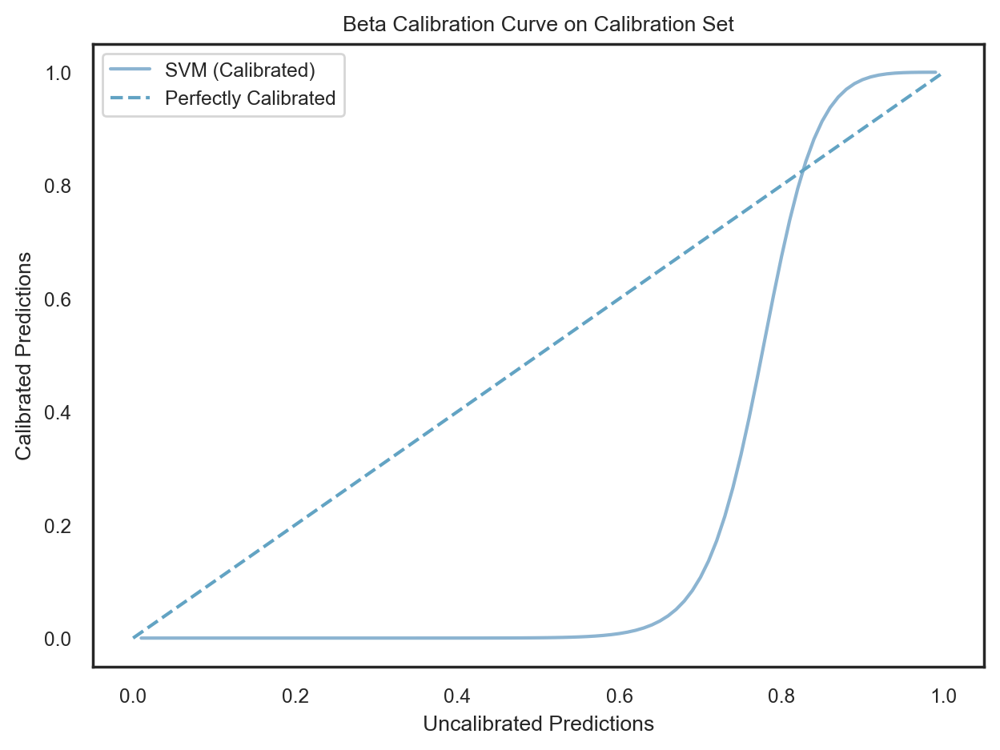

Classifier: SVM
Brier Score: 0.1883
Jaccard Score: 0.0588
F1 Score: 0.1111
Accuracy: 0.7957
ROC AUC: 0.6449
Precision: 0.6000
Recall: 0.0612
Log Loss: 1.0967
MCC: 0.1421
---------------------------------------------------


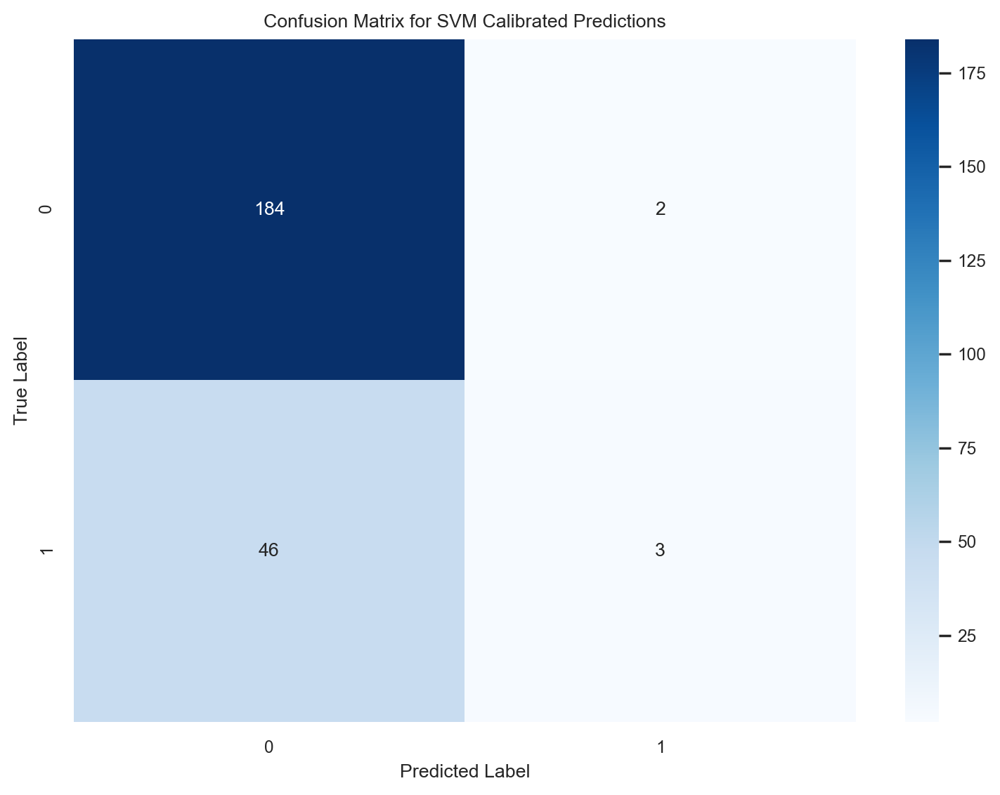

---------------------------------------------------


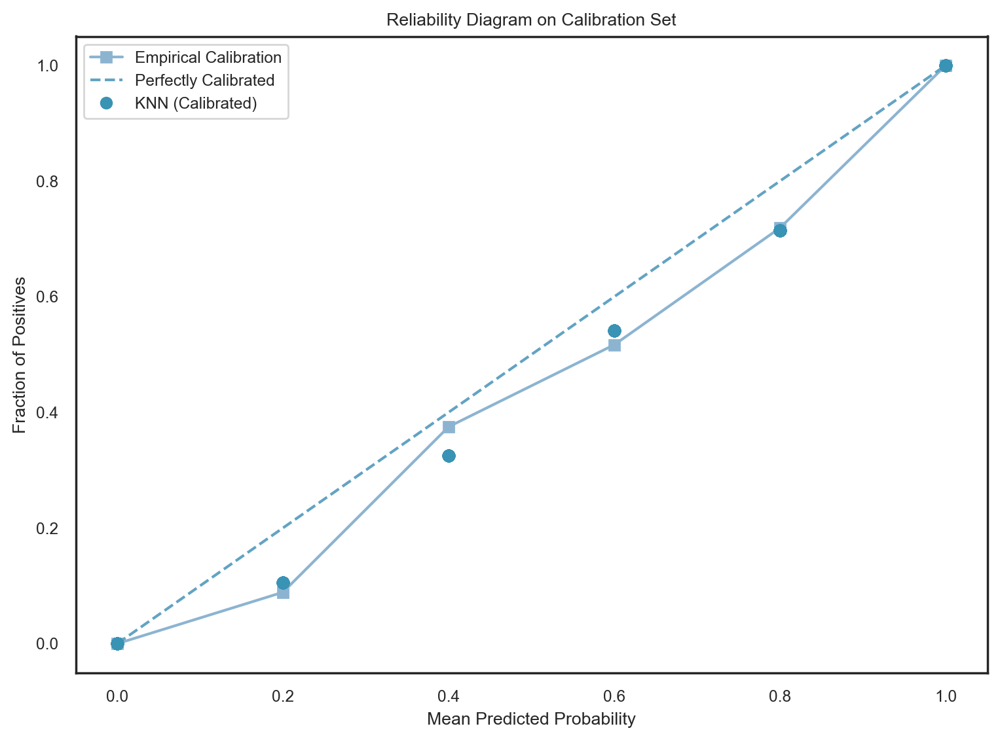

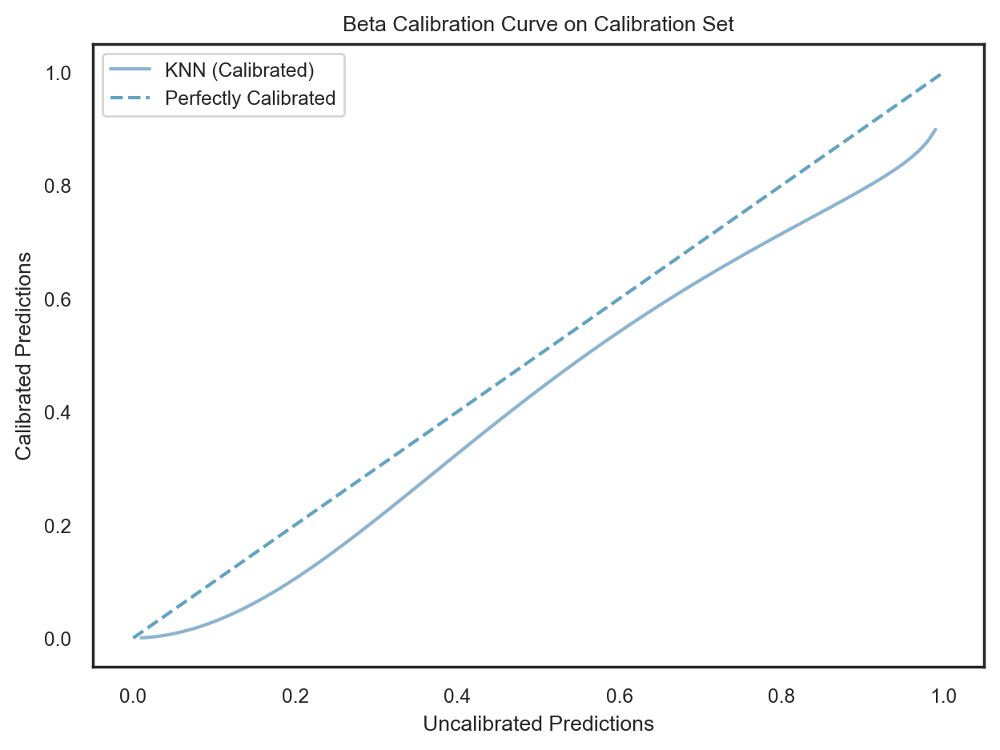

Classifier: KNN
Brier Score: 0.2562
Jaccard Score: 0.2353
F1 Score: 0.3810
Accuracy: 0.6128
ROC AUC: 0.6066
Precision: 0.2857
Recall: 0.5714
Log Loss: 2.6327
MCC: 0.1607
---------------------------------------------------


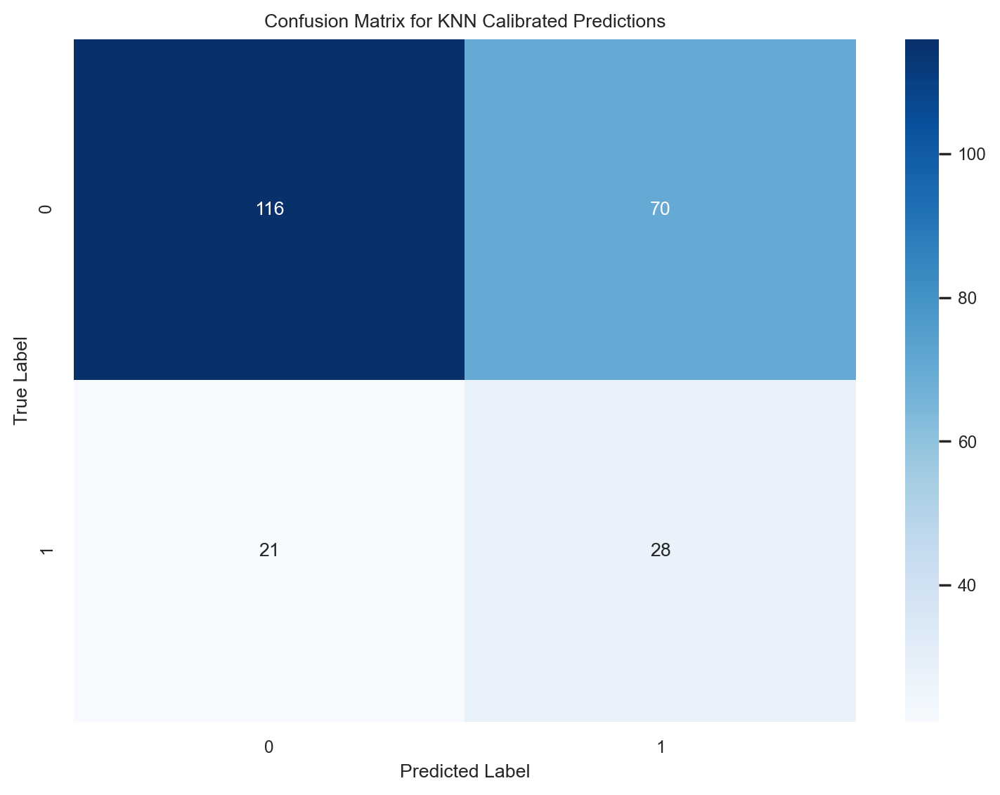

---------------------------------------------------


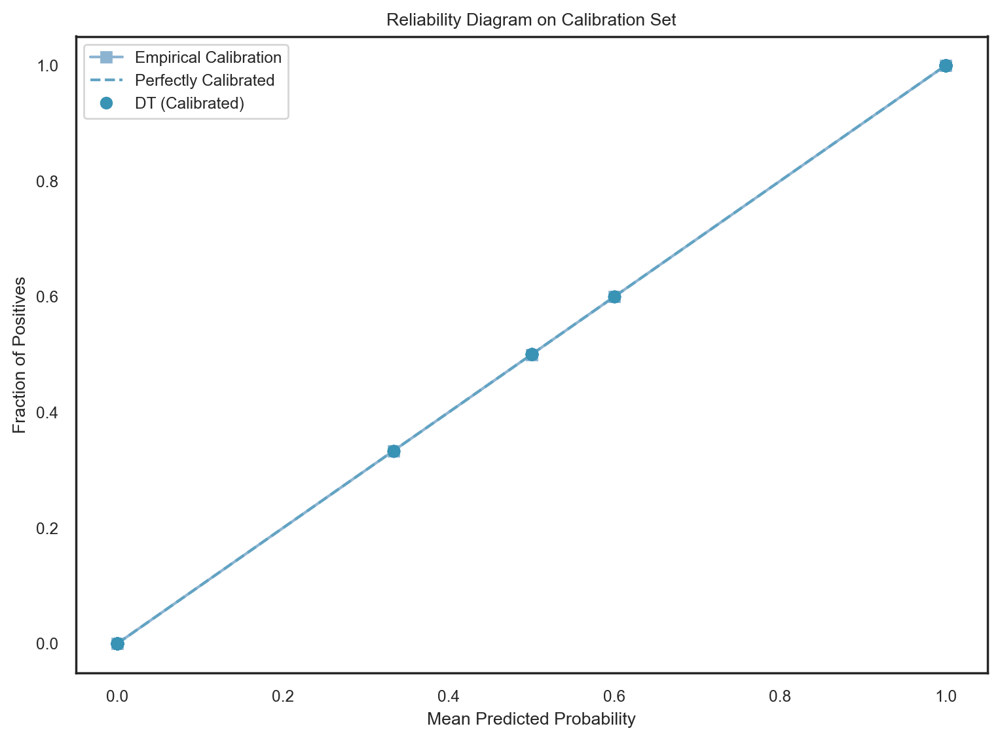

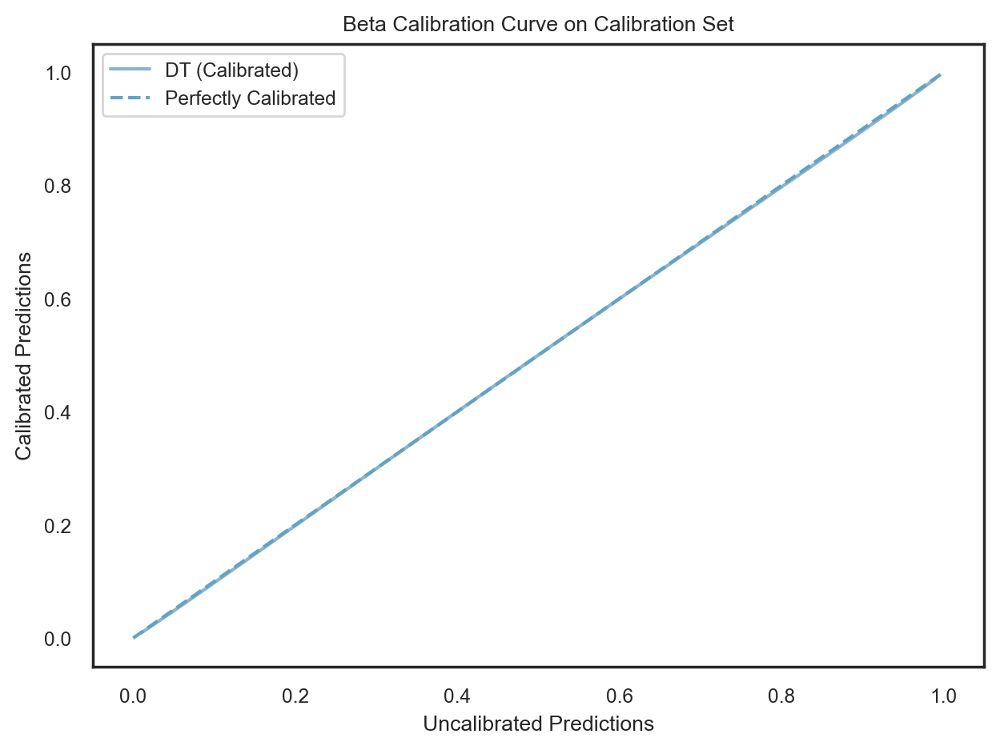

Classifier: DT
Brier Score: 0.3208
Jaccard Score: 0.1856
F1 Score: 0.3130
Accuracy: 0.6638
ROC AUC: 0.5496
Precision: 0.2727
Recall: 0.3673
Log Loss: 10.7584
MCC: 0.0988
---------------------------------------------------


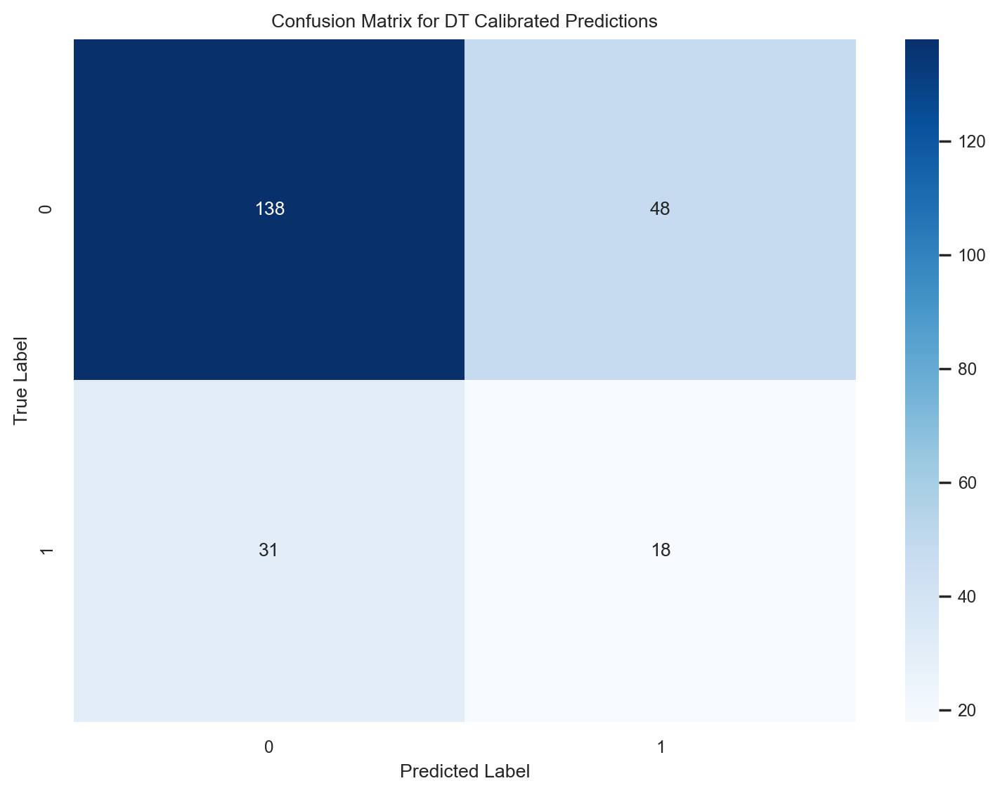

---------------------------------------------------


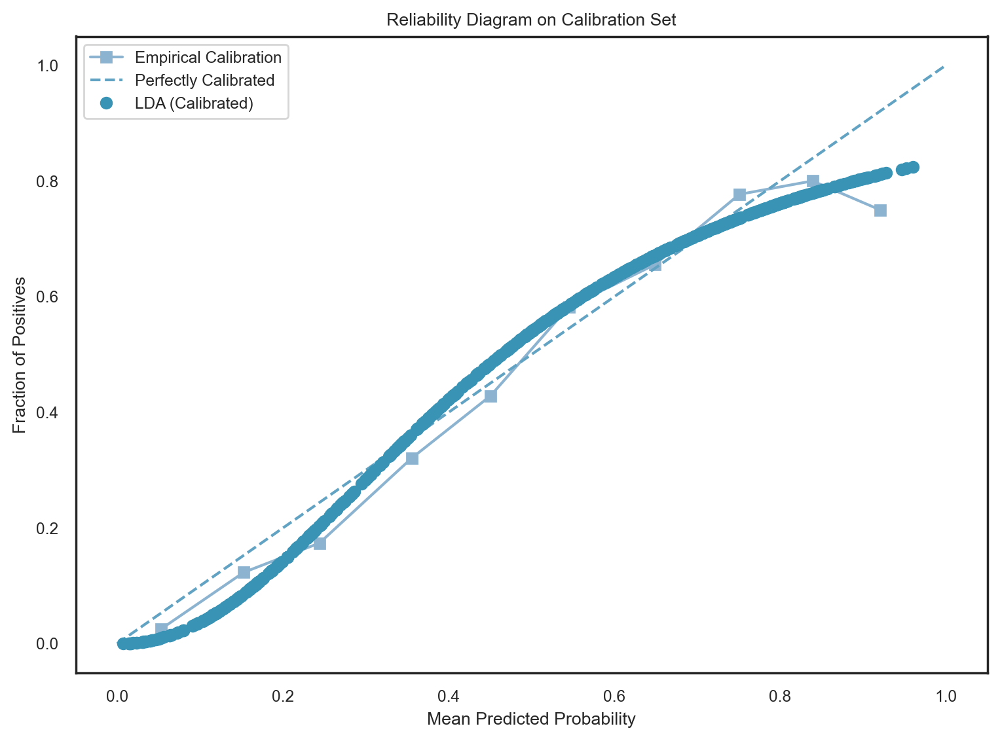

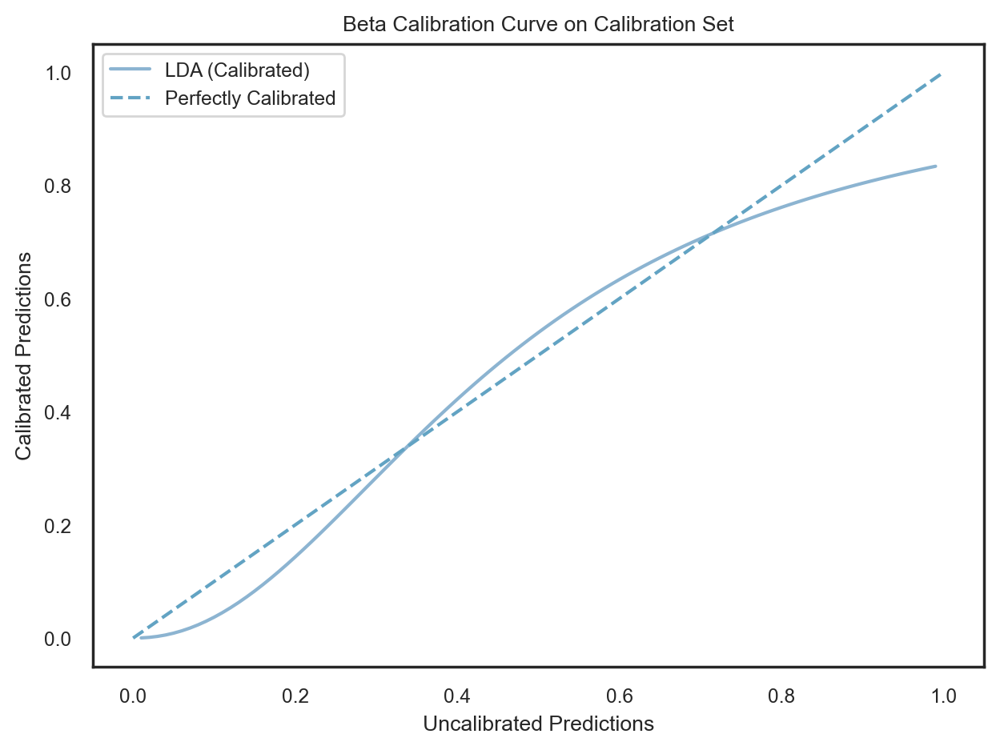

Classifier: LDA
Brier Score: 0.2406
Jaccard Score: 0.2632
F1 Score: 0.4167
Accuracy: 0.5830
ROC AUC: 0.6827
Precision: 0.2941
Recall: 0.7143
Log Loss: 0.6585
MCC: 0.2134
---------------------------------------------------


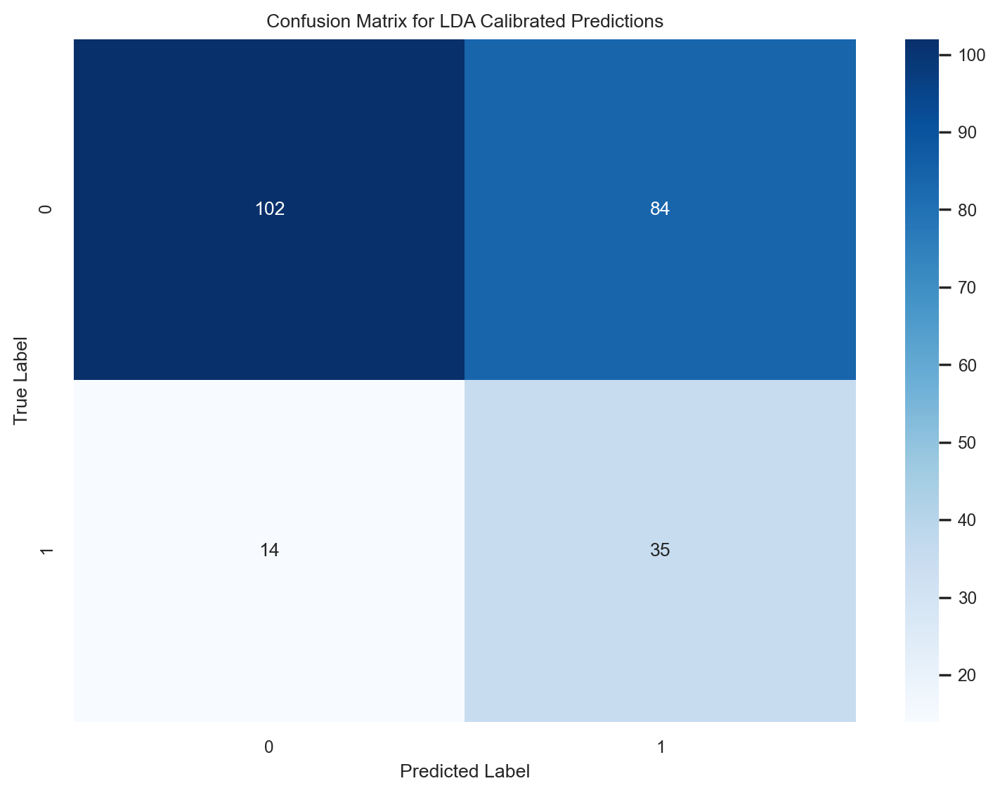

---------------------------------------------------


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from betacal import BetaCalibration
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    brier_score_loss,
    jaccard_score,
    f1_score,
    accuracy_score,
    roc_auc_score,
    precision_score,
    recall_score,
    log_loss,
    matthews_corrcoef,
    confusion_matrix,
)
from sklearn.metrics import plot_confusion_matrix

# Assuming you have defined the dictionary of classifiers (e.g., {'Logistic Regression': LogisticRegression()})
for key, clf in clf_dict.items():
    # Train the classifier on the resampled training data
    clf.fit(X_train_resampled, y_train_resampled)

    # Get the predicted probabilities for the training set
    if hasattr(clf, "predict_proba"):
        prob_pos_beta = clf.predict_proba(X_train_resampled)[:, 1]
        test_pos_beta = clf.predict_proba(X_test)[:, 1]
    else:
        prob_pos_beta = clf.decision_function(X_train_resampled)
        prob_pos_beta = (prob_pos_beta - prob_pos_beta.min()) / (prob_pos_beta.max() - prob_pos_beta.min())
        test_pos_beta = clf.decision_function(X_test)
        test_pos_beta = (test_pos_beta - test_pos_beta.min()) / (test_pos_beta.max() - test_pos_beta.min())

    # Fit three-parameter beta calibration on the training set
    bc = BetaCalibration()
    bc.fit(prob_pos_beta, y_train_resampled)

    # Calibrate the predicted probabilities on the calibration set and test set
    calibset_bc_probs = bc.predict(prob_pos_beta)
    testset_bc_probs = bc.predict(test_pos_beta)

    # Compute empirical probabilities for the reliability diagram
    fraction_of_positives, mean_predicted_value = calibration_curve(y_train_resampled, prob_pos_beta, n_bins=10)

    # Plot the reliability diagram for the calibration set with classifier label
    plt.figure(figsize=(8, 6))
    plt.plot(mean_predicted_value, fraction_of_positives, 's-', label='Empirical Calibration')
    plt.plot([0, 1], [0, 1], '--', label='Perfectly Calibrated')
    plt.plot(prob_pos_beta, calibset_bc_probs, 'o', label=f'{key} (Calibrated)')
    plt.xlabel('Mean Predicted Probability')
    plt.ylabel('Fraction of Positives')
    plt.title('Reliability Diagram on Calibration Set')
    plt.legend(loc='best')
    plt.show()

    # Plot the Beta calibration curve on the calibration set with classifier label
    tvec = np.linspace(.01, .99, 99)
    plt.plot(tvec, bc.predict(tvec), label=f'{key} (Calibrated)')
    plt.plot([0, 1], [0, 1], '--', label='Perfectly Calibrated')
    plt.xlabel('Uncalibrated Predictions')
    plt.ylabel('Calibrated Predictions')
    plt.title('Beta Calibration Curve on Calibration Set')
    plt.legend(loc='best')
    plt.show()

    # Evaluate the calibrated classifier on the test set
    testset_calibrated_probs = bc.predict(test_pos_beta)
    testset_pred_labels = (testset_calibrated_probs > 0.5).astype(int)
    brier_score = brier_score_loss(y_test, testset_calibrated_probs)
    jaccard = jaccard_score(y_test, testset_pred_labels)
    f1 = f1_score(y_test, testset_pred_labels)
    accuracy = accuracy_score(y_test, testset_pred_labels)
    roc_auc = roc_auc_score(y_test, testset_calibrated_probs)
    precision = precision_score(y_test, testset_pred_labels)
    recall = recall_score(y_test, testset_pred_labels)
    logloss = log_loss(y_test, testset_calibrated_probs)
    mcc = matthews_corrcoef(y_test, testset_pred_labels)

    # Print the evaluation metrics for the calibrated classifier
    print(f'Classifier: {key}')
    print(f'Brier Score: {brier_score:.4f}')
    print(f'Jaccard Score: {jaccard:.4f}')
    print(f'F1 Score: {f1:.4f}')
    print(f'Accuracy: {accuracy:.4f}')
    print(f'ROC AUC: {roc_auc:.4f}')
    print(f'Precision: {precision:.4f}')
    print(f'Recall: {recall:.4f}')
    print(f'Log Loss: {logloss:.4f}')
    print(f'MCC: {mcc:.4f}')
    print('---------------------------------------------------')

    # Calculate confusion matrix for the calibrated predictions
    conf_matrix_calibrated = confusion_matrix(y_test, testset_pred_labels)

    # Plot the confusion matrix as a heatmap
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix_calibrated, annot=True, fmt='d', cmap='Blues',
                xticklabels=['0', '1'],
                yticklabels=['0', '1'])
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.title(f'Confusion Matrix for {key} Calibrated Predictions')
    plt.show()

    print('---------------------------------------------------')


## SPLINE CALIBRATION

In [ ]:
calib1 = mli.SplineCalib()

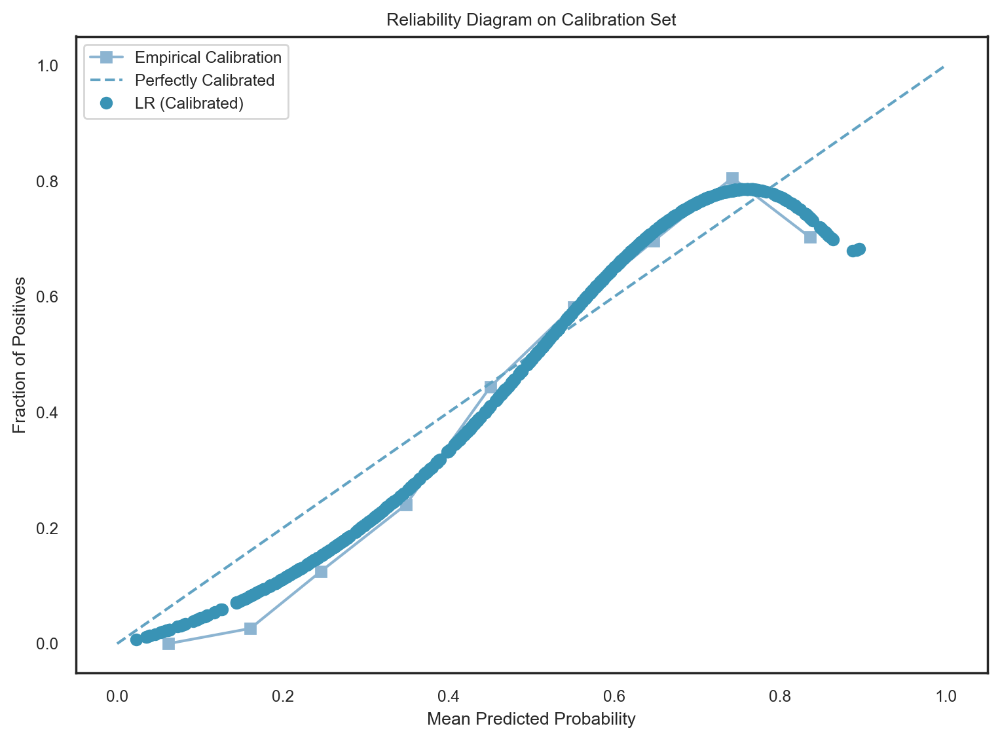

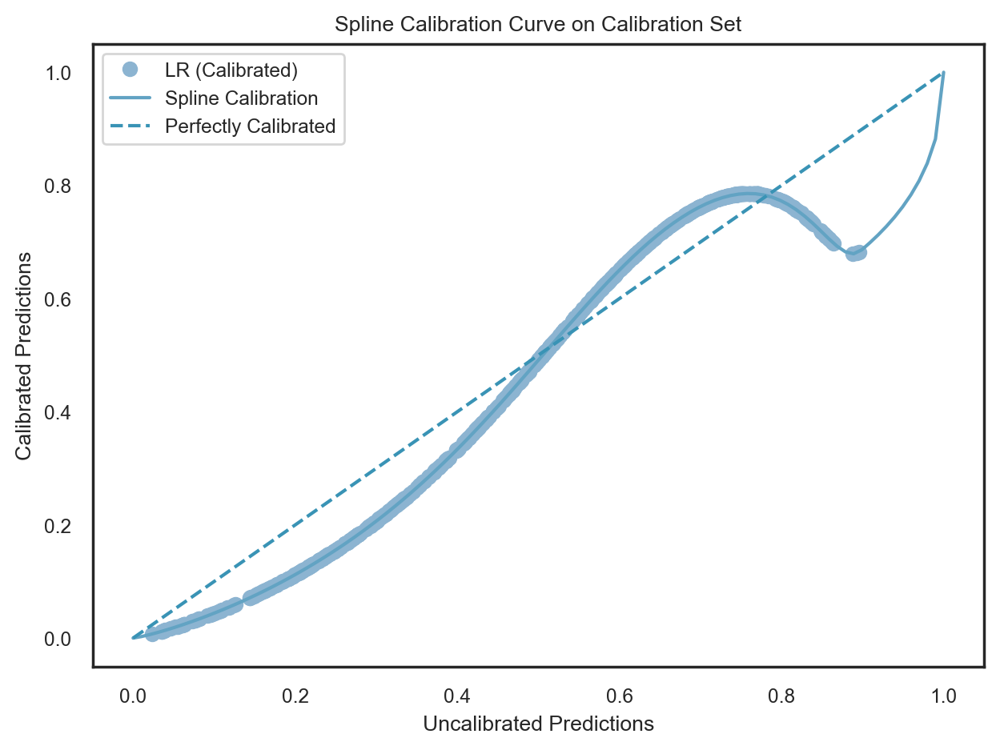

Classifier: LR
Brier Score: 0.2410
Stratified Brier Score: 0.2410
Jaccard Score: 0.2558
F1 Score: 0.4074
Accuracy: 0.5915
ROC AUC: 0.6792
Precision: 0.2920
Recall: 0.6735
Log Loss: 0.6639
MCC: 0.1979
---------------------------------------------------


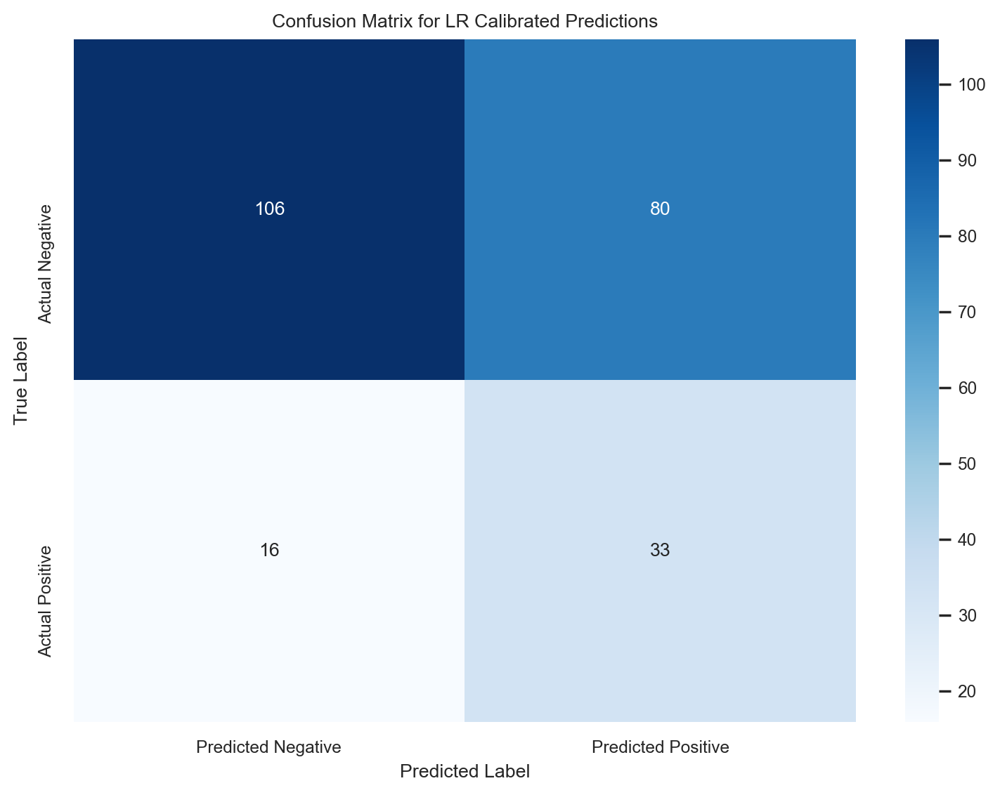

---------------------------------------------------


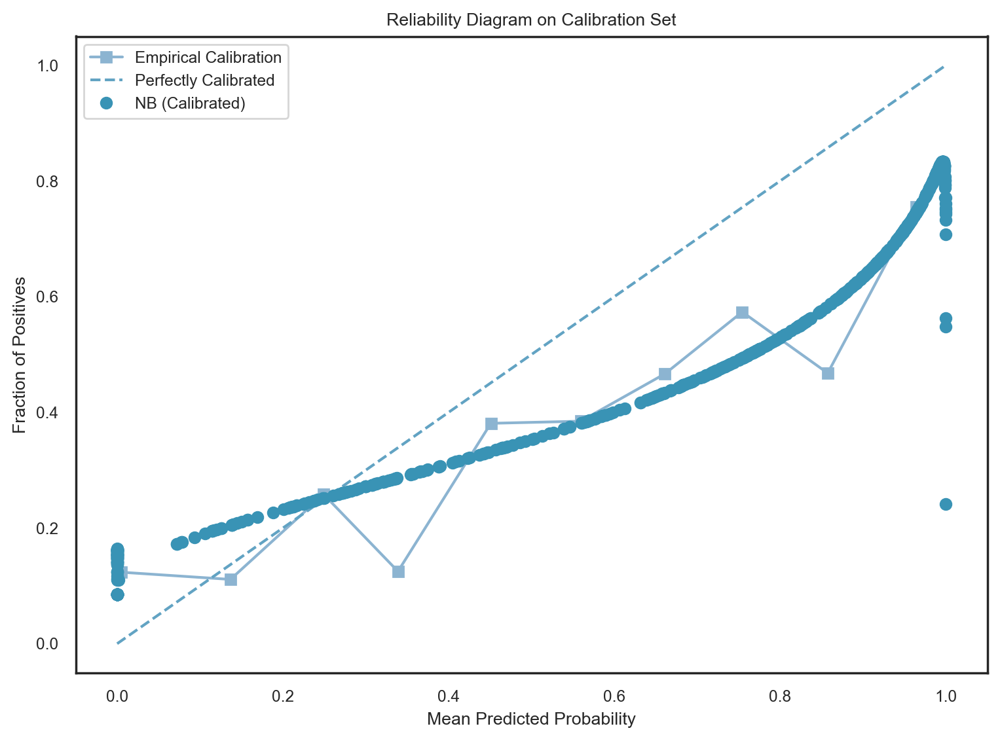

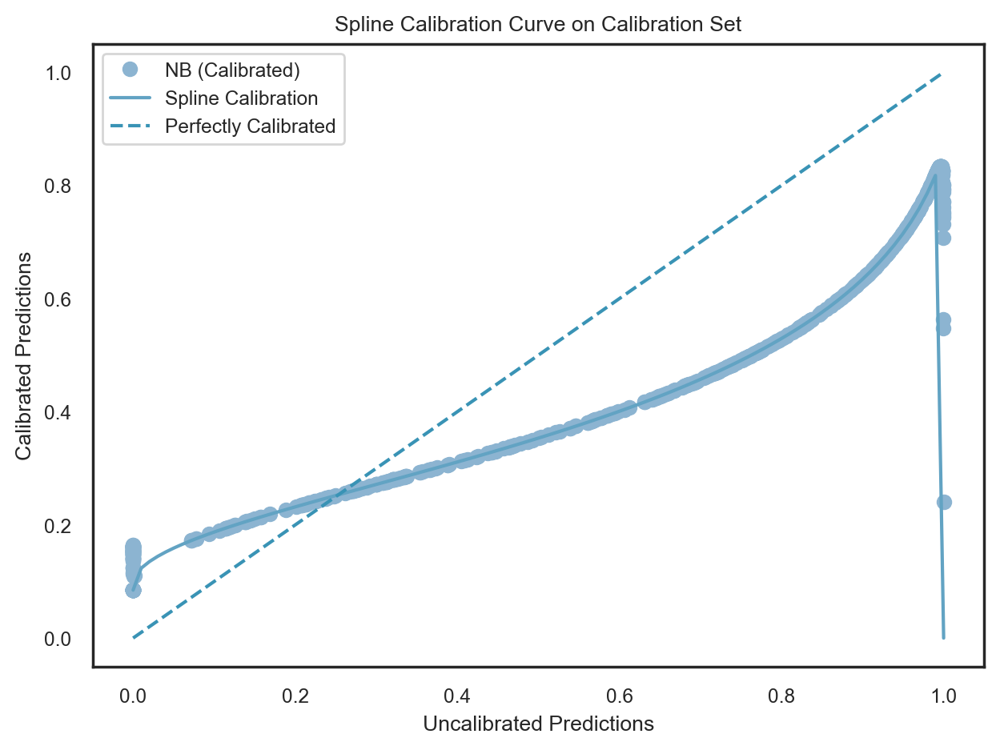

Classifier: NB
Brier Score: 0.2296
Stratified Brier Score: 0.2296
Jaccard Score: 0.2605
F1 Score: 0.4133
Accuracy: 0.6255
ROC AUC: 0.6790
Precision: 0.3069
Recall: 0.6327
Log Loss: 0.6516
MCC: 0.2103
---------------------------------------------------


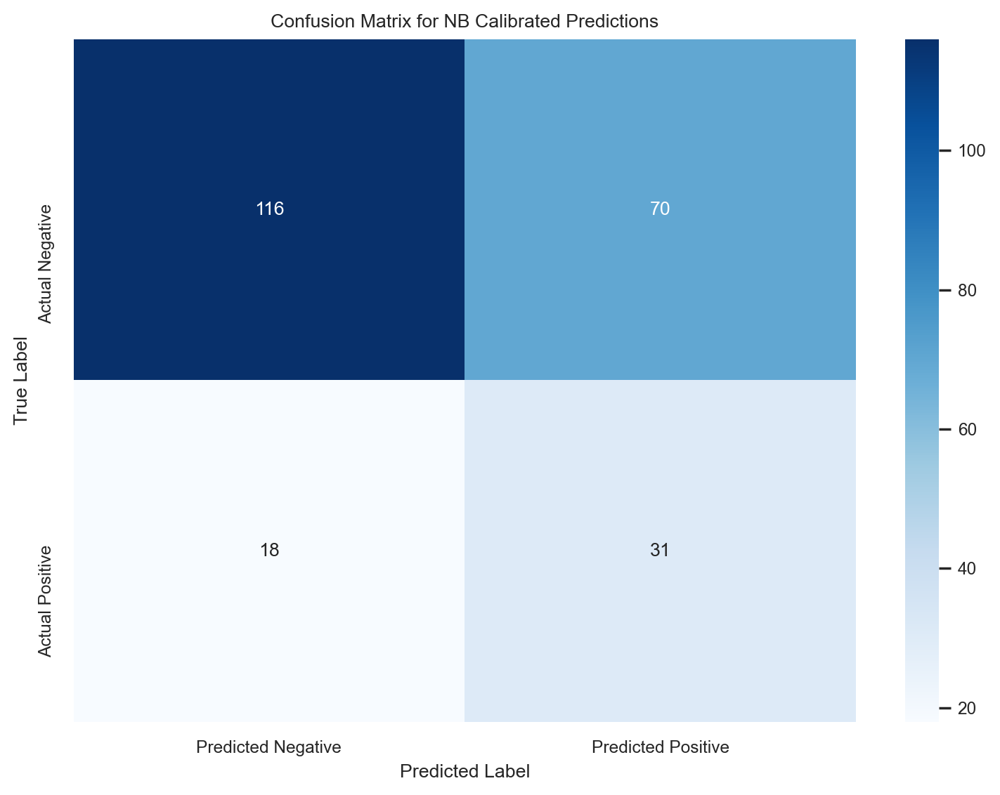

---------------------------------------------------


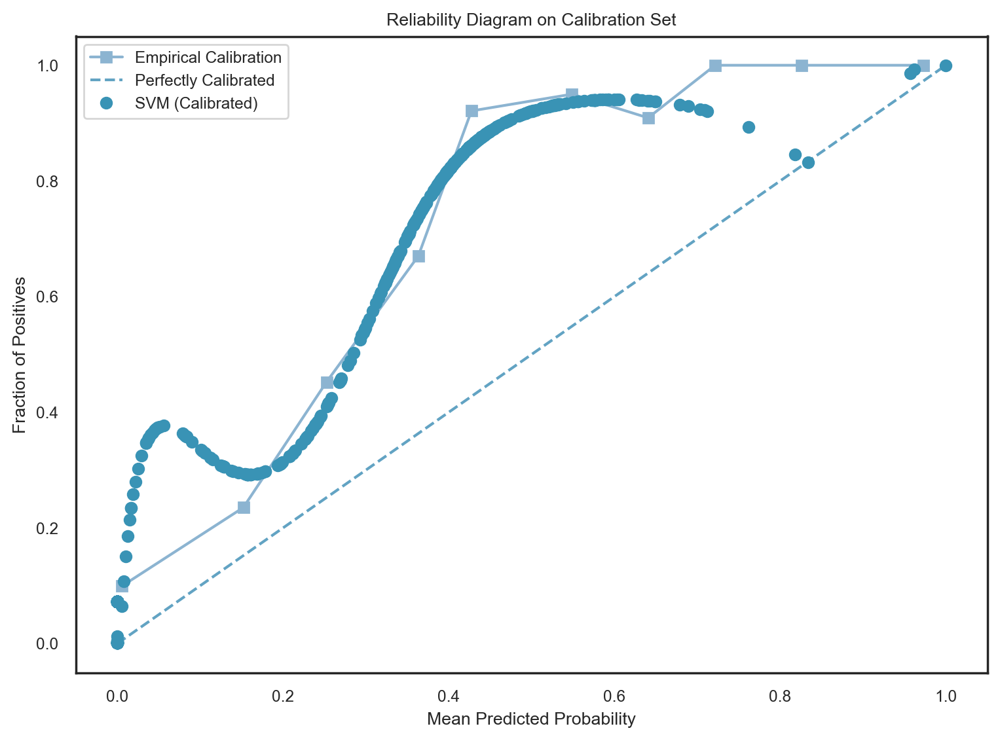

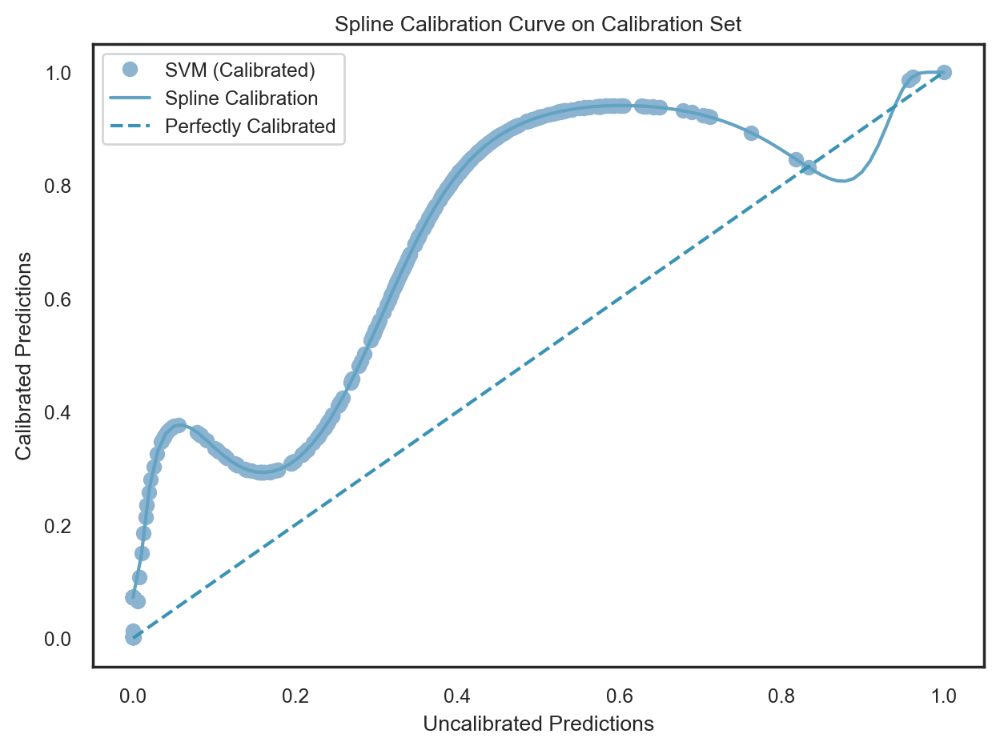

Classifier: SVM
Brier Score: 0.1834
Stratified Brier Score: 0.1834
Jaccard Score: 0.1918
F1 Score: 0.3218
Accuracy: 0.7489
ROC AUC: 0.6392
Precision: 0.3684
Recall: 0.2857
Log Loss: 0.5855
MCC: 0.1729
---------------------------------------------------


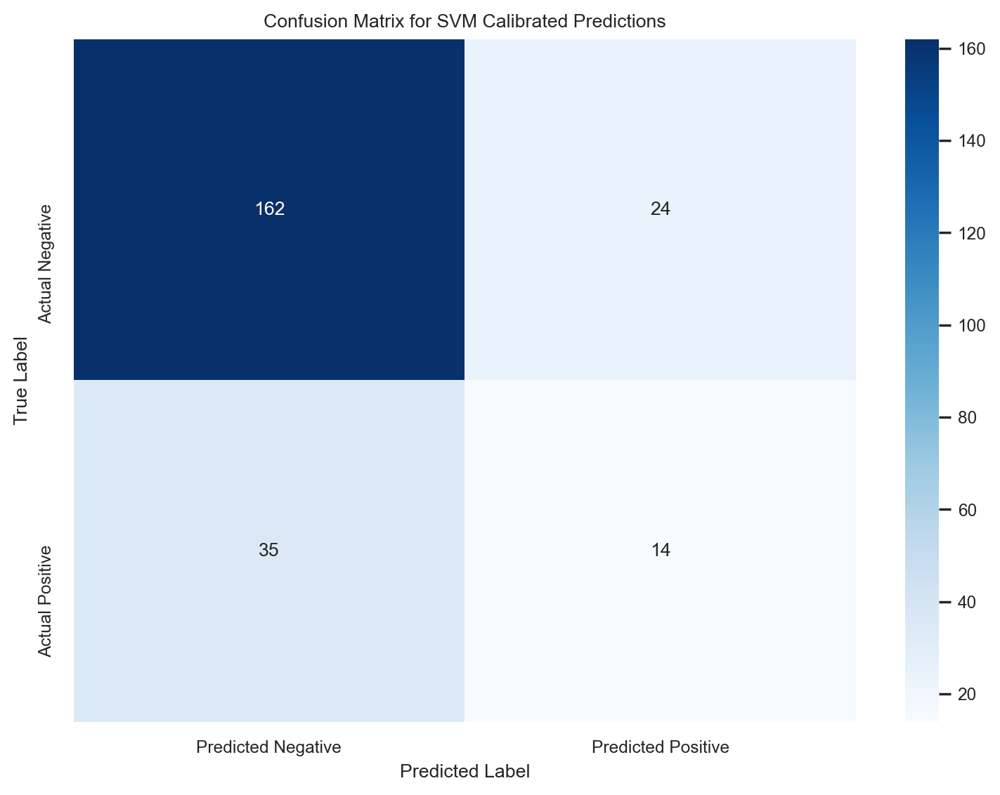

---------------------------------------------------


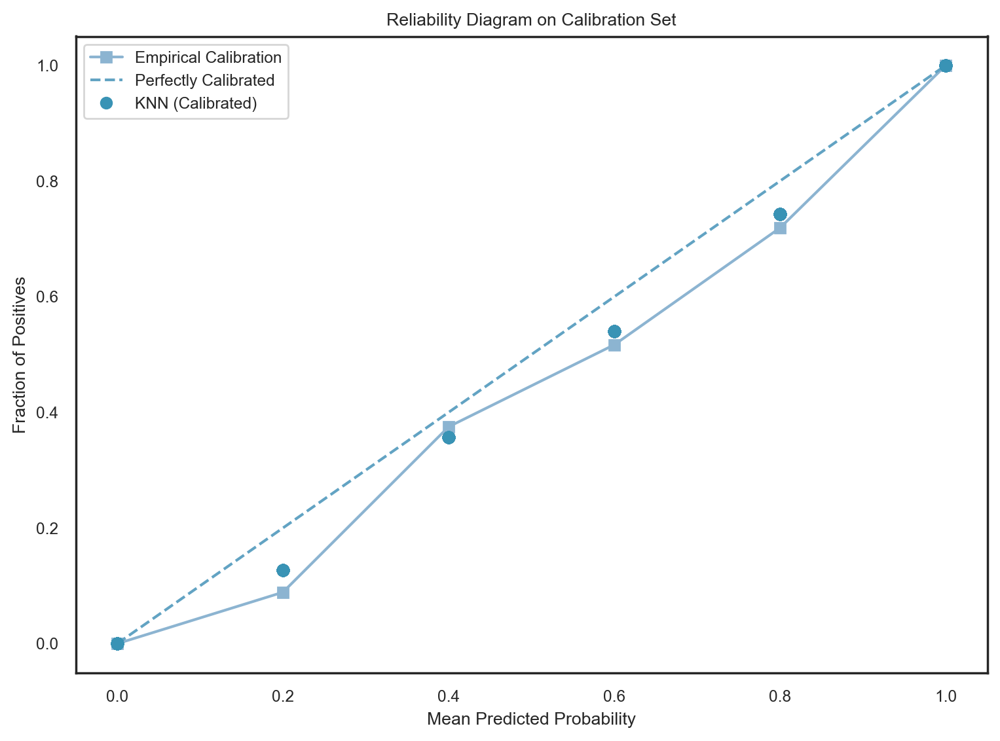

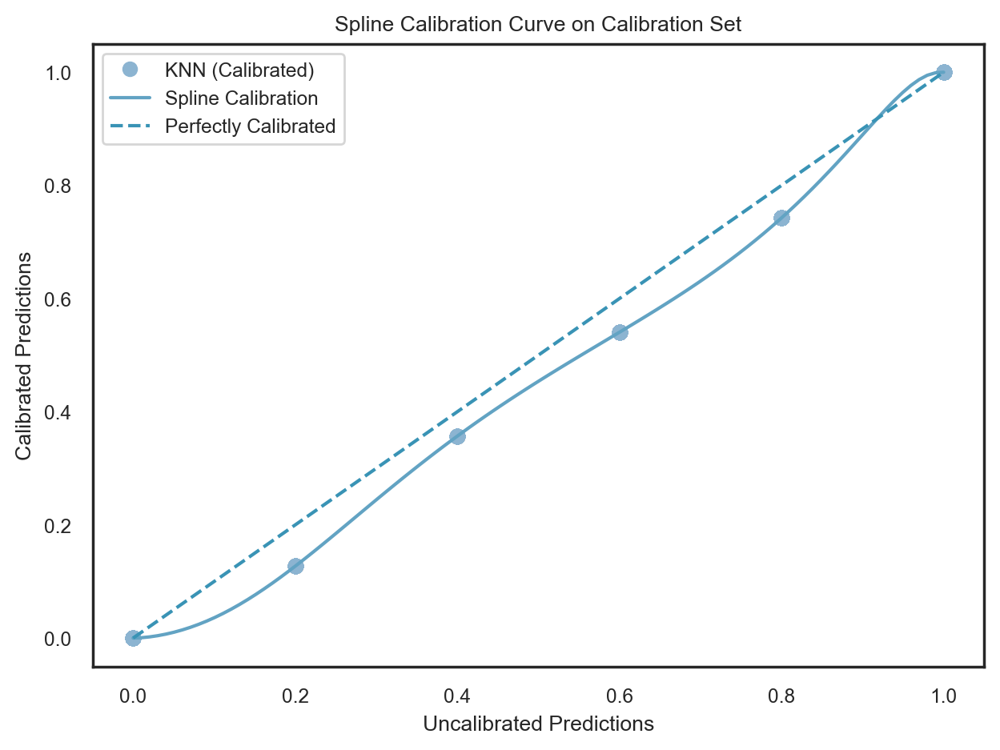

Classifier: KNN
Brier Score: 0.2603
Stratified Brier Score: 0.2603
Jaccard Score: 0.2353
F1 Score: 0.3810
Accuracy: 0.6128
ROC AUC: 0.6052
Precision: 0.2857
Recall: 0.5714
Log Loss: 4.1344
MCC: 0.1607
---------------------------------------------------


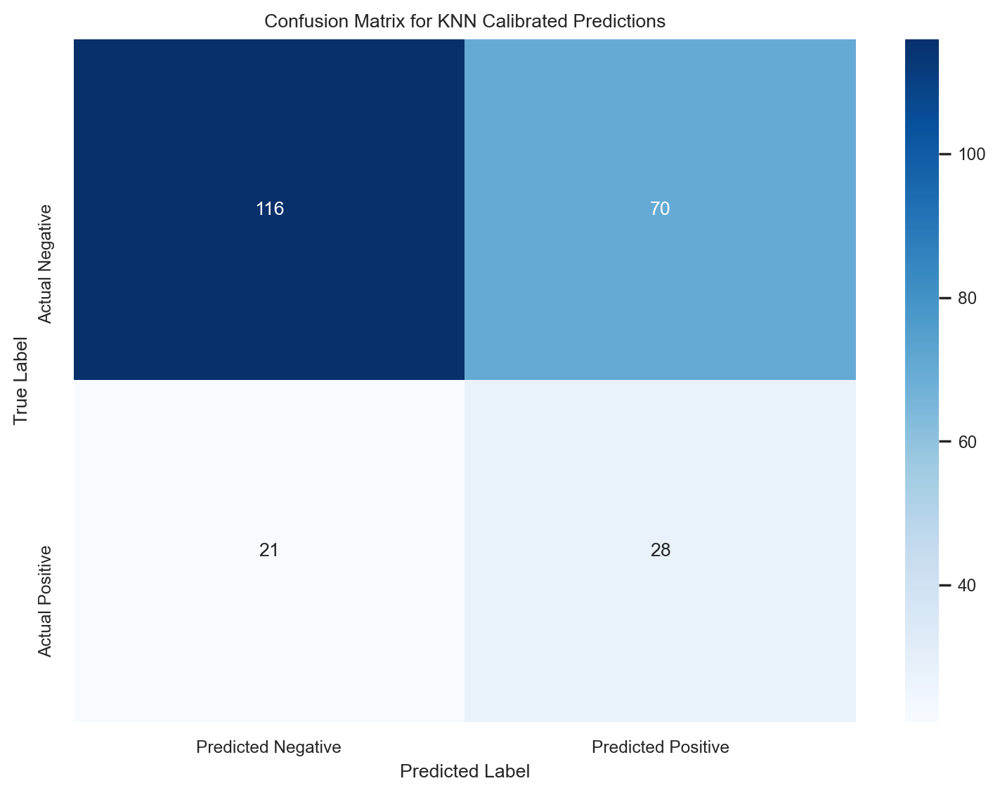

---------------------------------------------------


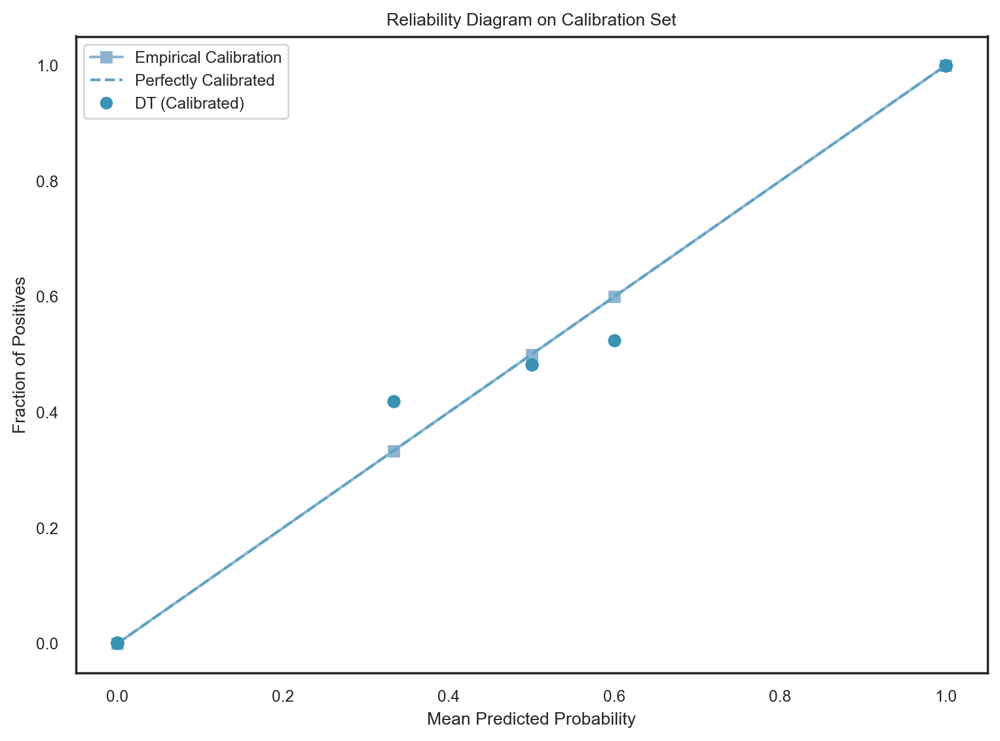

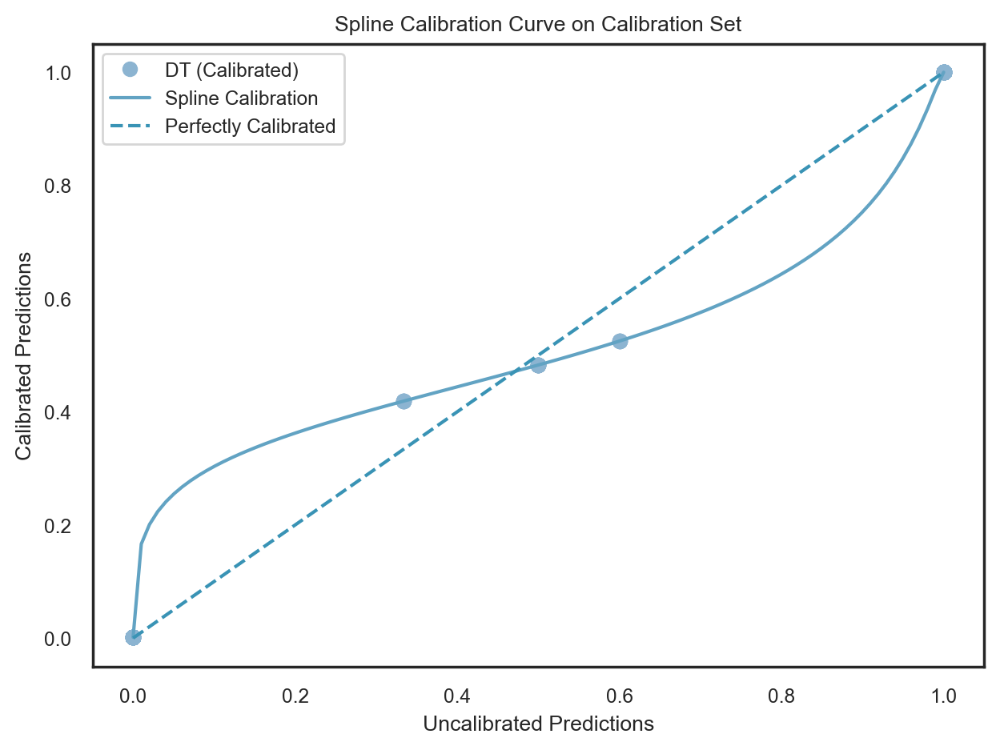

Classifier: DT
Brier Score: 0.3209
Stratified Brier Score: 0.3209
Jaccard Score: 0.1758
F1 Score: 0.2991
Accuracy: 0.6809
ROC AUC: 0.5496
Precision: 0.2759
Recall: 0.3265
Log Loss: 7.0699
MCC: 0.0949
---------------------------------------------------


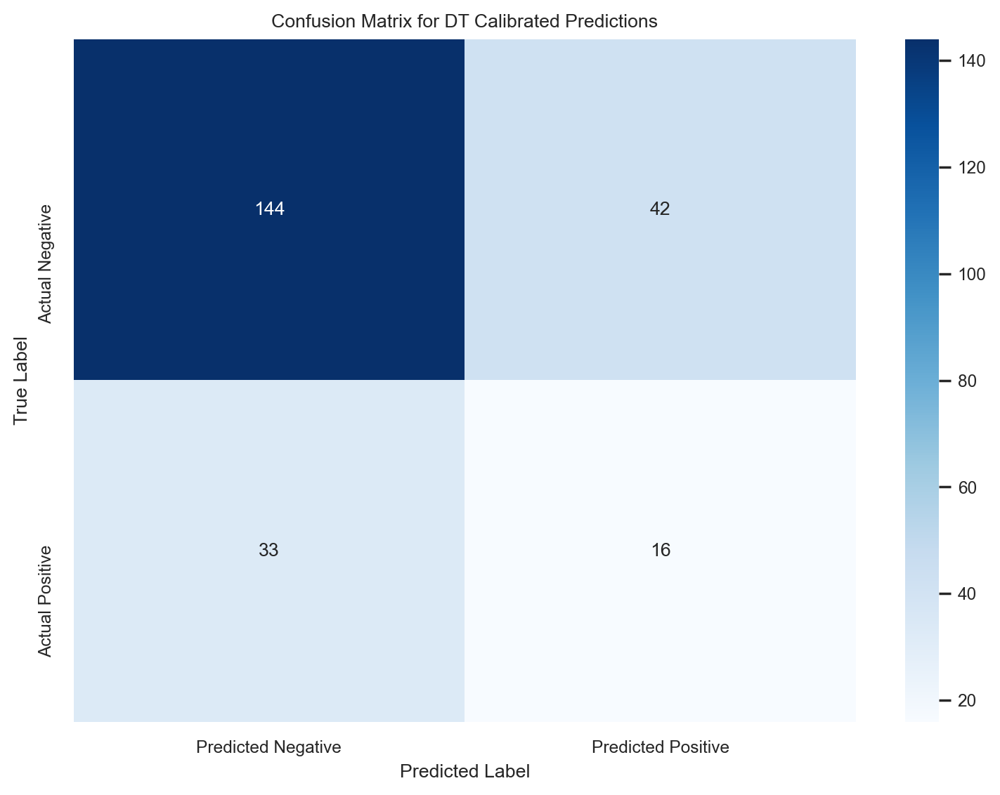

---------------------------------------------------


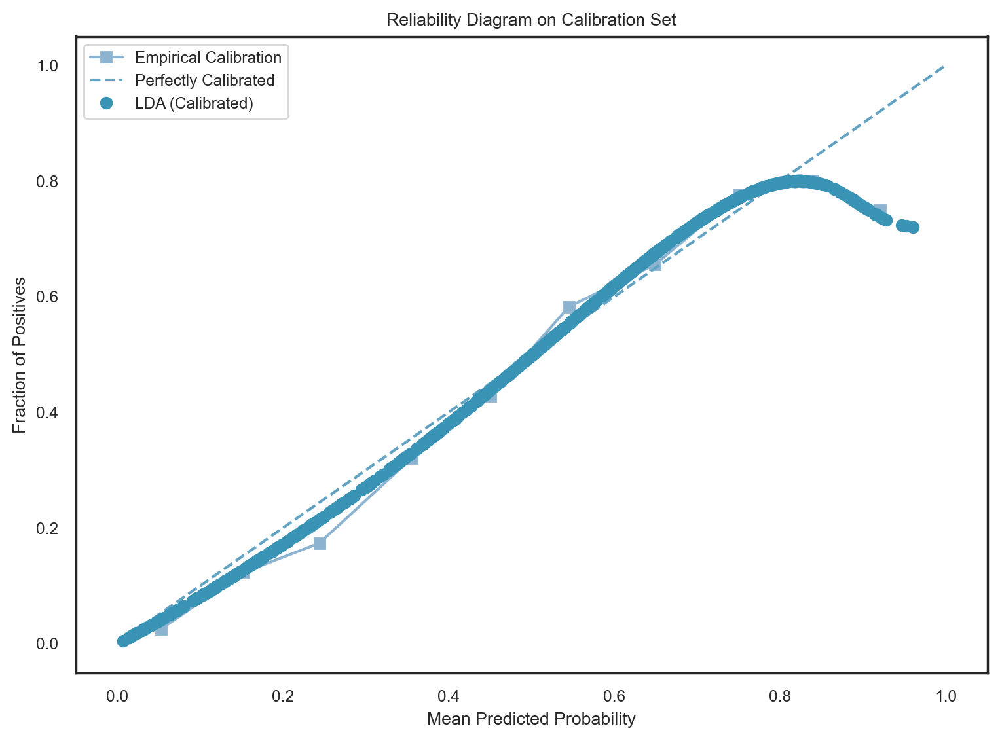

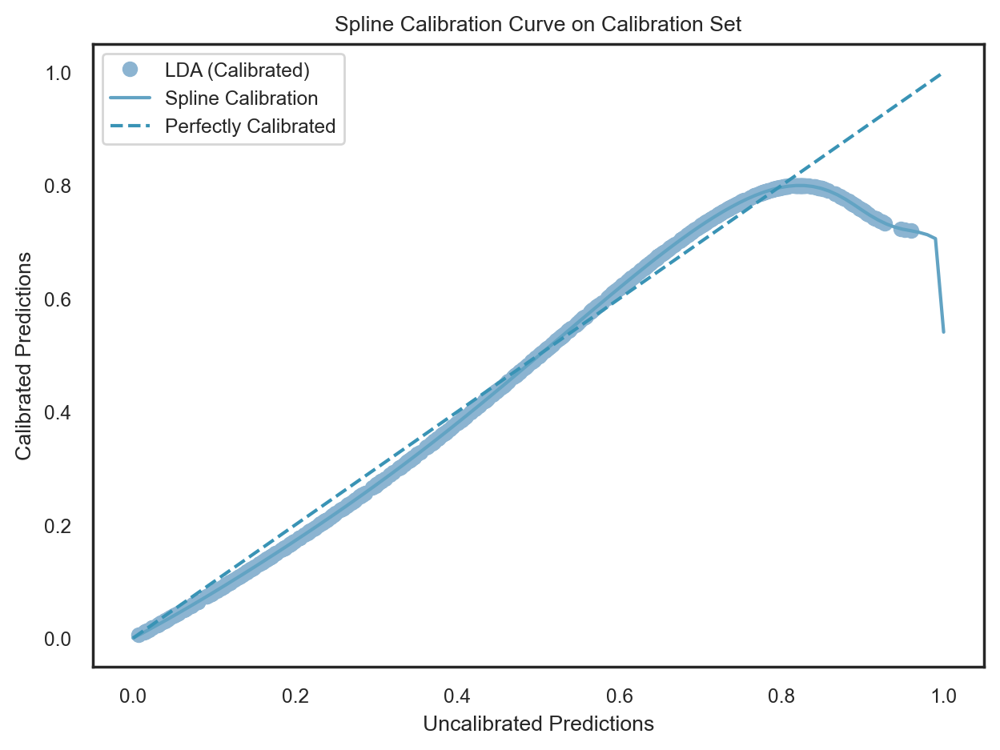

Classifier: LDA
Brier Score: 0.2367
Stratified Brier Score: 0.2367
Jaccard Score: 0.2500
F1 Score: 0.4000
Accuracy: 0.5915
ROC AUC: 0.6781
Precision: 0.2883
Recall: 0.6531
Log Loss: 0.6556
MCC: 0.1858
---------------------------------------------------


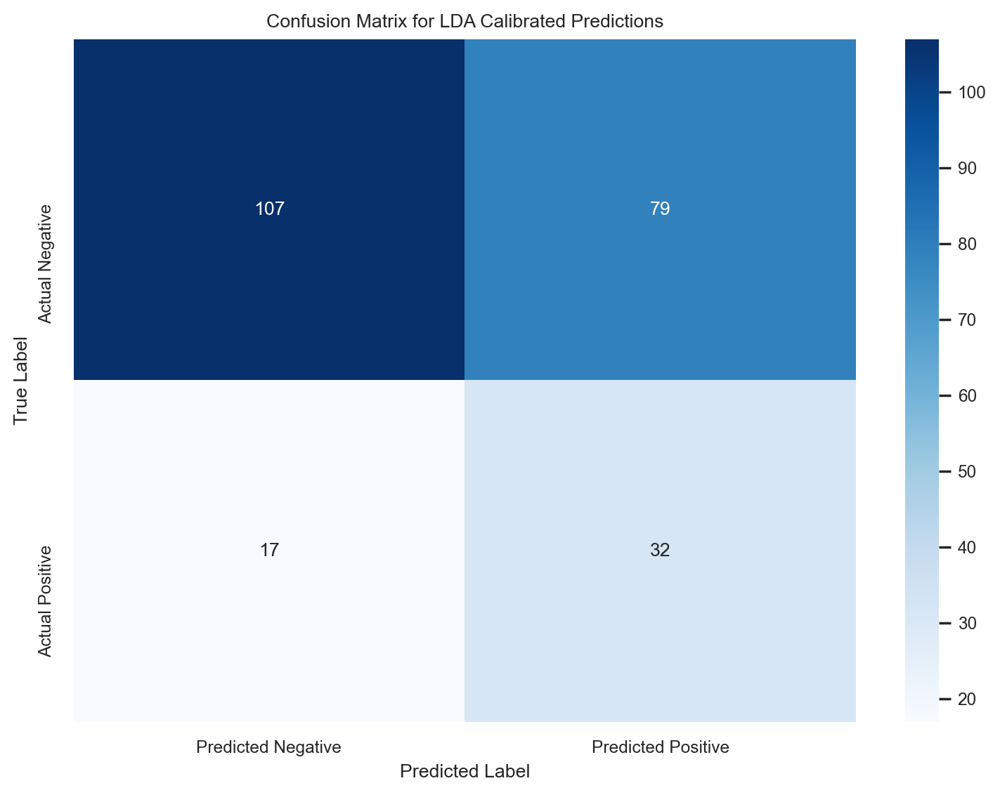

---------------------------------------------------


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.isotonic import IsotonicRegression
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import (
    brier_score_loss,
    jaccard_score,
    f1_score,
    accuracy_score,
    roc_auc_score,
    precision_score,
    recall_score,
    log_loss,
    matthews_corrcoef,
    confusion_matrix,
)
from sklearn.datasets import make_classification
from sklearn.preprocessing import MinMaxScaler
from sklearn.calibration import calibration_curve
from sklearn.metrics import plot_confusion_matrix

# Assuming you have defined the dictionary of classifiers (e.g., {'Logistic Regression': LogisticRegression()})
for key, clf in clf_dict.items():
    try:
        # Train the classifier on the resampled training data
        clf.fit(X_train_resampled, y_train_resampled)

        # Get the predicted probabilities for the training set
        if hasattr(clf, "predict_proba"):
            prob_pos_spline = clf.predict_proba(X_train_resampled)[:, 1]
            test_pos_spline = clf.predict_proba(X_test)[:, 1]
        else:
            prob_pos_spline = clf.decision_function(X_train_resampled)
            # Clip or scale the predicted probabilities to a manageable range
            prob_pos_spline = np.clip(prob_pos_spline, -1, 100)  # Example range, adjust as needed
            prob_pos_spline = (prob_pos_spline - prob_pos_spline.min()) / (prob_pos_spline.max() - prob_pos_spline.min())

            test_pos_spline = clf.decision_function(X_test)
            # Clip or scale the test predicted probabilities as well
            test_pos_spline = np.clip(test_pos_spline, -1, 100)  # Example range, adjust as needed
            test_pos_spline = (test_pos_spline - test_pos_spline.min()) / (test_pos_spline.max() - test_pos_spline.min())

        # Fit isotonic regression (spline calibration) on the training set
        ir = calib1
        ir.fit(prob_pos_spline, y_train_resampled)

        # Calibrate the predicted probabilities on the calibration set and test set
        calibset_spline_probs = ir.transform(prob_pos_spline)
        testset_spline_probs = ir.transform(test_pos_spline)

        # Compute empirical probabilities for the reliability diagram
        fraction_of_positives, mean_predicted_value = calibration_curve(y_train_resampled, prob_pos_spline, n_bins=10)

        # Plot the reliability diagram for the calibration set with classifier label
        plt.figure(figsize=(8, 6))
        plt.plot(mean_predicted_value, fraction_of_positives, 's-', label='Empirical Calibration')
        plt.plot([0, 1], [0, 1], '--', label='Perfectly Calibrated')
        plt.plot(prob_pos_spline, calibset_spline_probs, 'o', label=f'{key} (Calibrated)')
        plt.xlabel('Mean Predicted Probability')
        plt.ylabel('Fraction of Positives')
        plt.title('Reliability Diagram on Calibration Set')
        plt.legend(loc='best')
        plt.show()

        # Plot the calibration curve on the calibration set with classifier label
        tvec = np.linspace(0, 1, 100)
        plt.plot(prob_pos_spline, calibset_spline_probs, 'o', label=f'{key} (Calibrated)')
        plt.plot(tvec, ir.transform(tvec), label='Spline Calibration')
        plt.plot([0, 1], [0, 1], '--', label='Perfectly Calibrated')
        plt.xlabel('Uncalibrated Predictions')
        plt.ylabel('Calibrated Predictions')
        plt.title('Spline Calibration Curve on Calibration Set')
        plt.legend(loc='best')
        plt.show()

        # Evaluate the calibrated classifier on the test set
        testset_calibrated_probs = ir.transform(test_pos_spline)
        testset_pred_labels = (testset_calibrated_probs > 0.5).astype(int)
        brier_score = brier_score_loss(y_test, testset_calibrated_probs)
        jaccard = jaccard_score(y_test, testset_pred_labels)
        f1 = f1_score(y_test, testset_pred_labels)
        accuracy = accuracy_score(y_test, testset_pred_labels)
        roc_auc = roc_auc_score(y_test, testset_calibrated_probs)
        precision = precision_score(y_test, testset_pred_labels)
        recall = recall_score(y_test, testset_pred_labels)
        logloss = log_loss(y_test, testset_calibrated_probs)
        mcc = matthews_corrcoef(y_test, testset_pred_labels)

        # Compute stratified Brier score
        stratified_brier_score = brier_score_loss(y_test, testset_calibrated_probs)

        # Print the evaluation metrics for the calibrated classifier
        print(f'Classifier: {key}')
        print(f'Brier Score: {brier_score:.4f}')
        print(f'Stratified Brier Score: {stratified_brier_score:.4f}')
        print(f'Jaccard Score: {jaccard:.4f}')
        print(f'F1 Score: {f1:.4f}')
        print(f'Accuracy: {accuracy:.4f}')
        print(f'ROC AUC: {roc_auc:.4f}')
        print(f'Precision: {precision:.4f}')
        print(f'Recall: {recall:.4f}')
        print(f'Log Loss: {logloss:.4f}')
        print(f'MCC: {mcc:.4f}')
        print('---------------------------------------------------')

        # Calculate confusion matrix for the calibrated predictions
        conf_matrix_calibrated = confusion_matrix(y_test, testset_pred_labels)

        # Plot the confusion matrix as a heatmap
        plt.figure(figsize=(8, 6))
        sns.heatmap(conf_matrix_calibrated, annot=True, fmt='d', cmap='Blues',
                    xticklabels=['Predicted Negative', 'Predicted Positive'],
                    yticklabels=['Actual Negative', 'Actual Positive'])
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix for {key} Calibrated Predictions')
        plt.show()

        print('---------------------------------------------------')

    except ValueError as e:
        print(f'Skipping classifier: {key} due to ValueError: {e}')
        continue

# ...


### PLATT'S SCALING (SIGMOID) CALIBRATION

--- Logistic Regression ---
Jaccard score = 0.256
F1 score = 0.4076433121019108
Accuracy = 0.6042553191489362
Matthews Correlation Coefficient = 0.19927230123934206
Precision = 0.2962962962962963
ROC AUC = 0.6802172481895984
Brier score = 0.23423577771694482
Log loss = 0.6640876720219119
Recall = 0.6530612244897959
Confusion Matrix:
[[110  76]
 [ 17  32]]


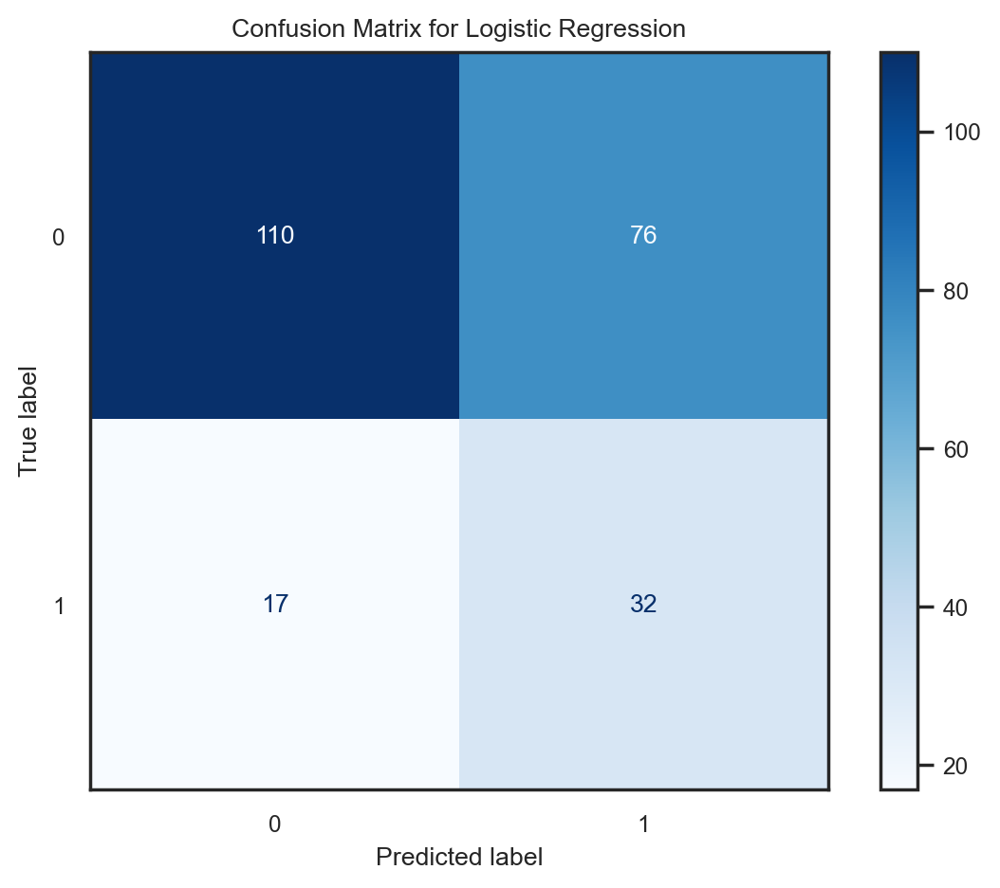

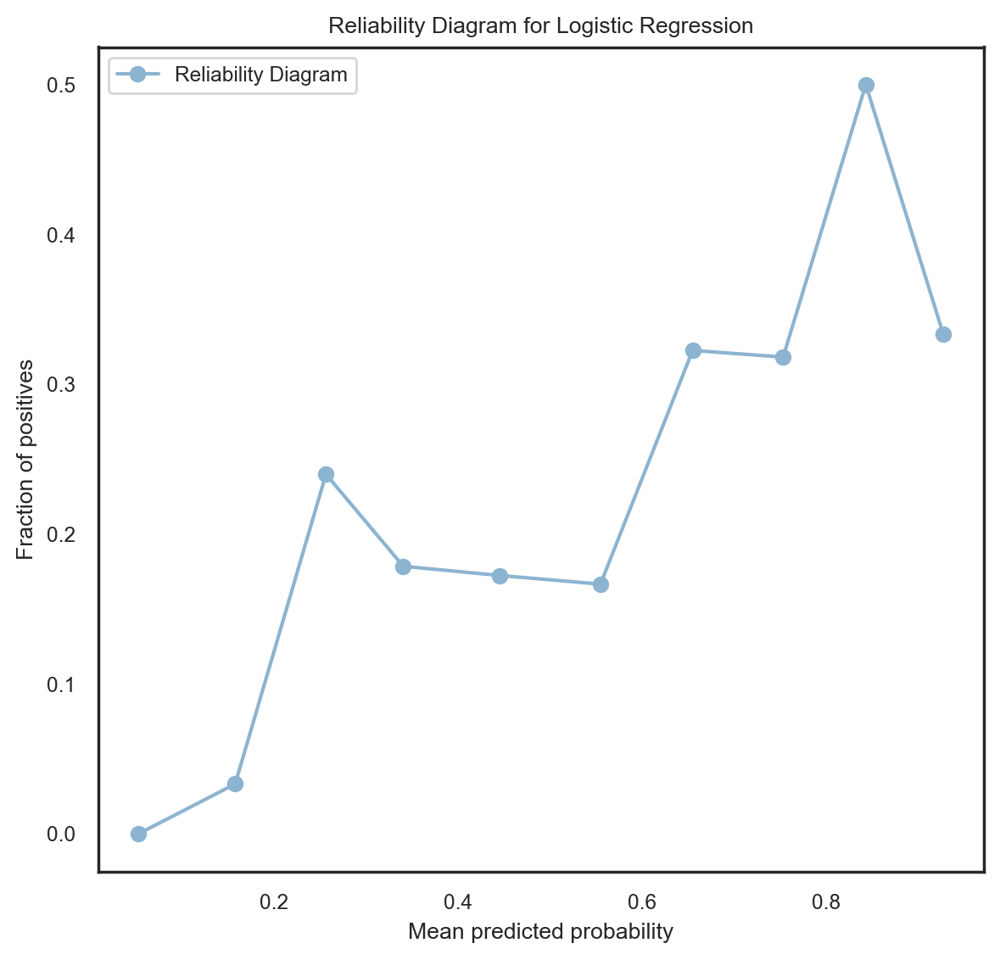

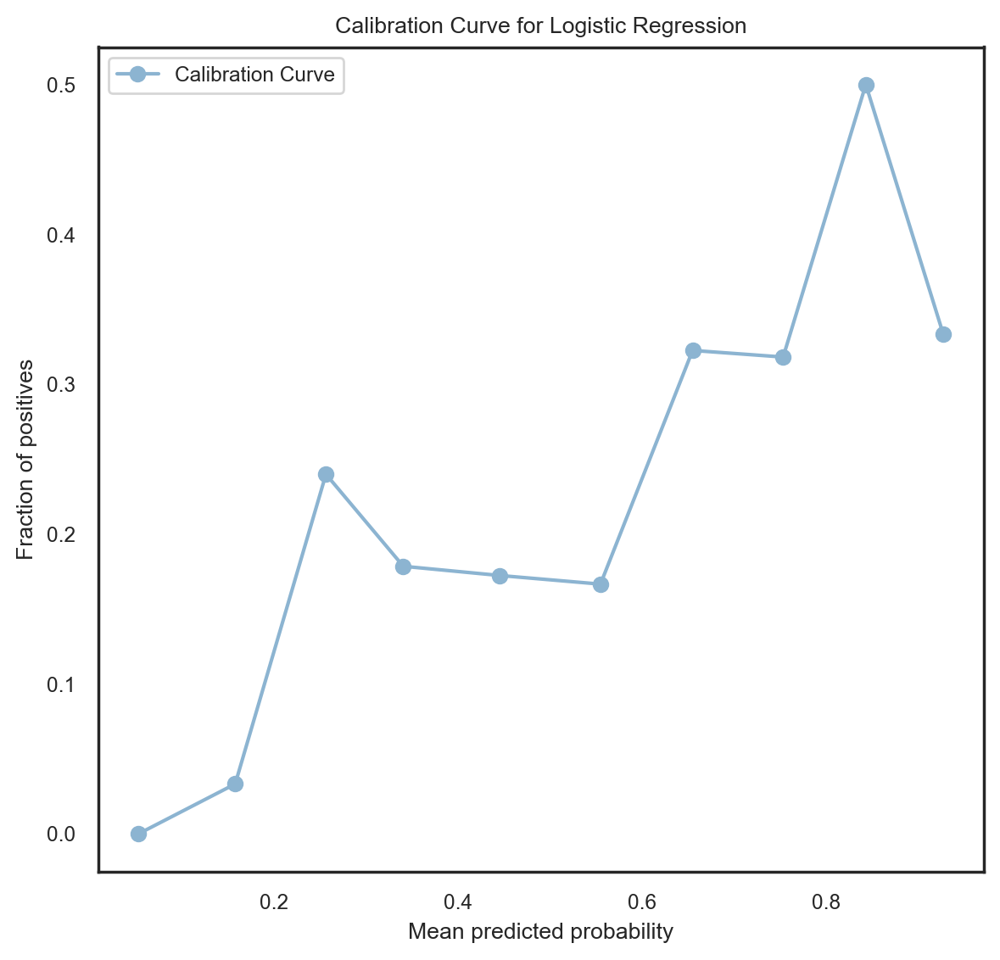

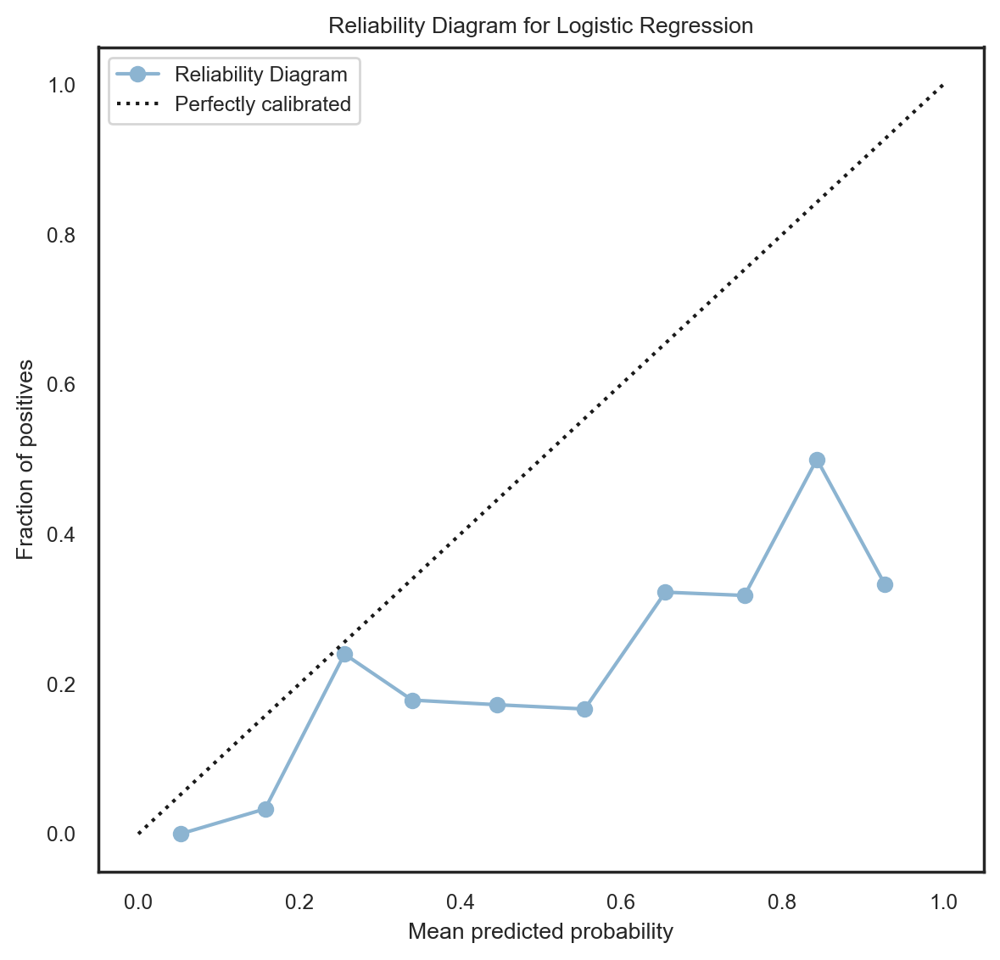

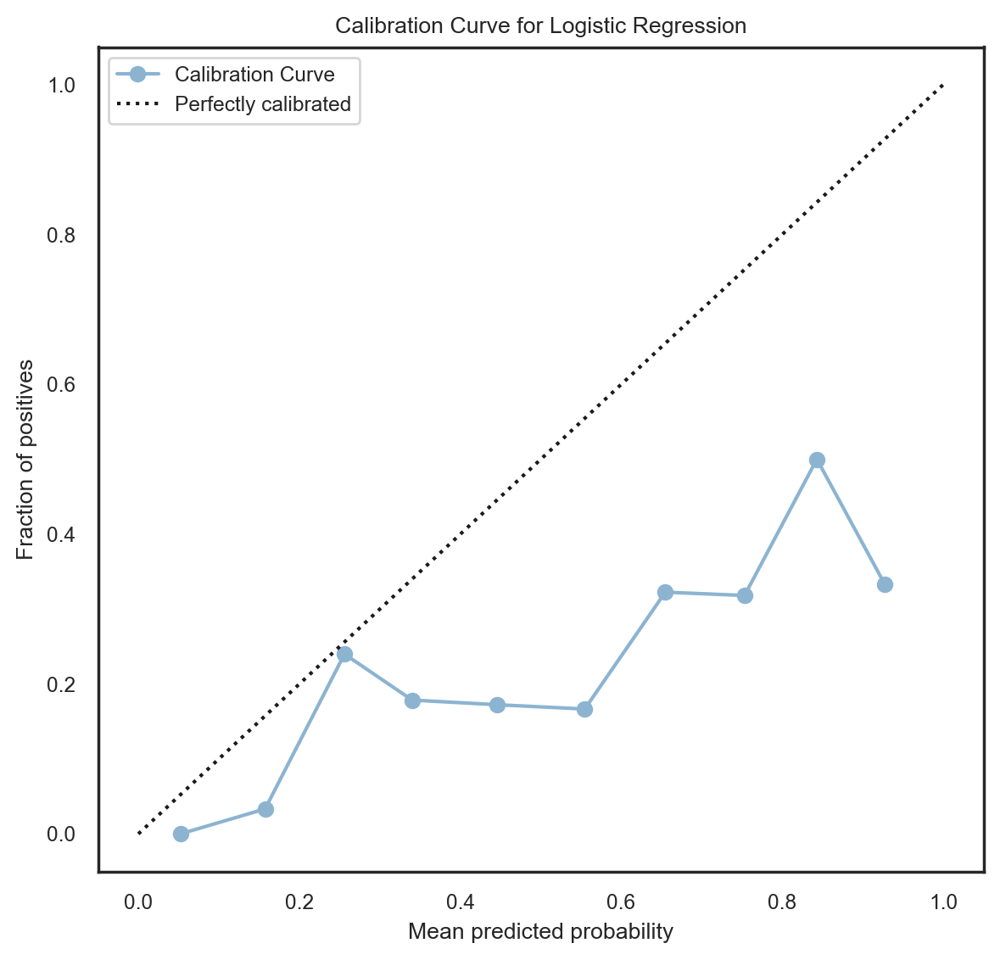

--- KNN ---
Jaccard score = 0.2358490566037736
F1 score = 0.3816793893129771
Accuracy = 0.6553191489361702
Matthews Correlation Coefficient = 0.17366198068384106
Precision = 0.3048780487804878
ROC AUC = 0.6038512179065174
Brier score = 0.22754026124755788
Log loss = 0.6513611747511613
Recall = 0.5102040816326531
Confusion Matrix:
[[129  57]
 [ 24  25]]


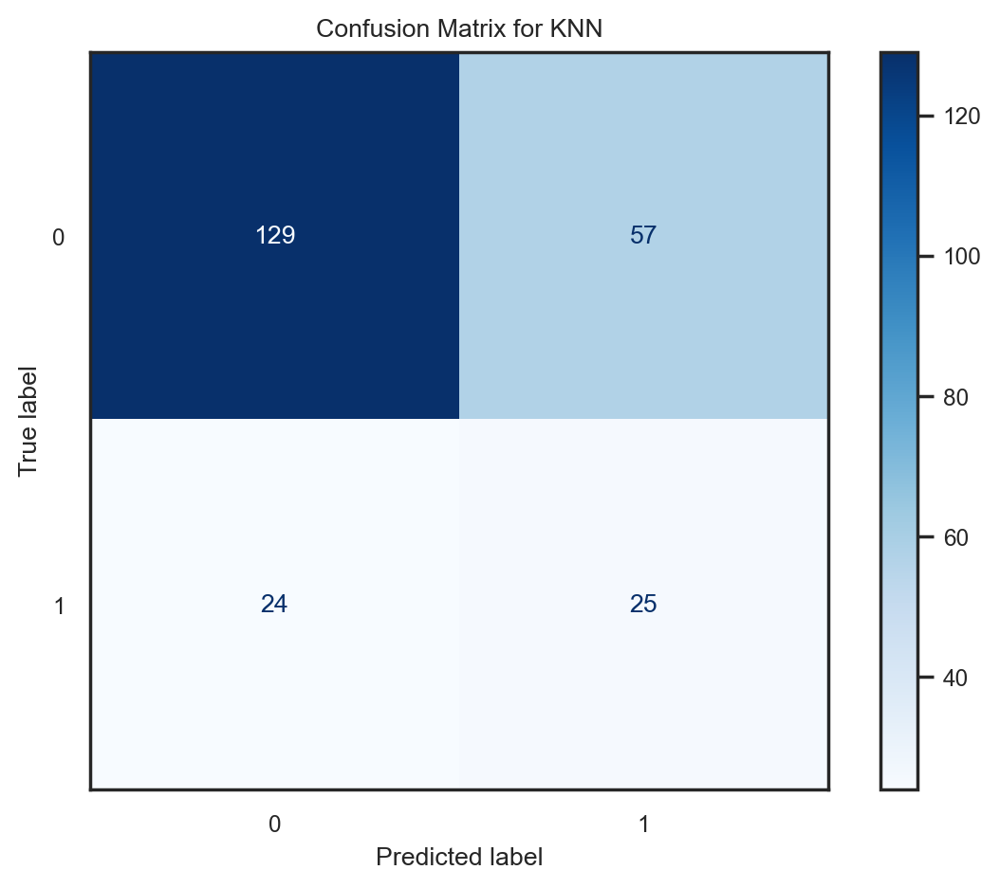

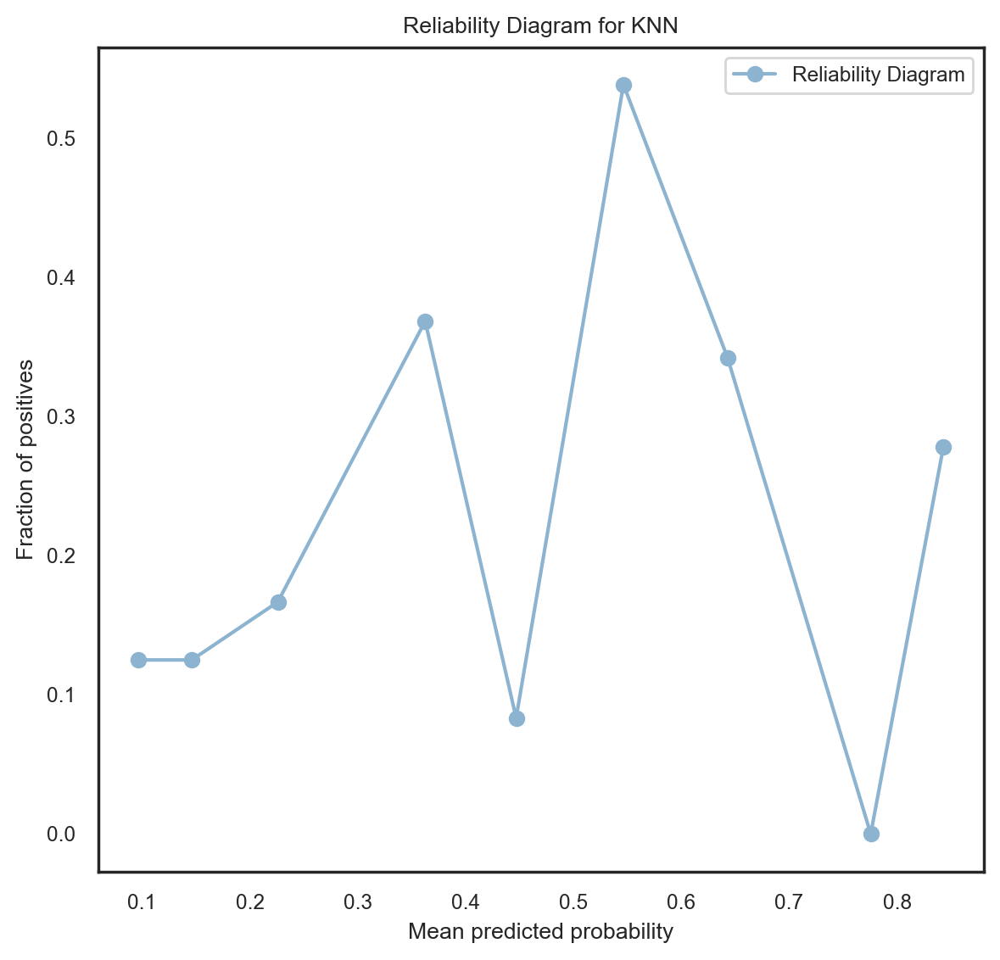

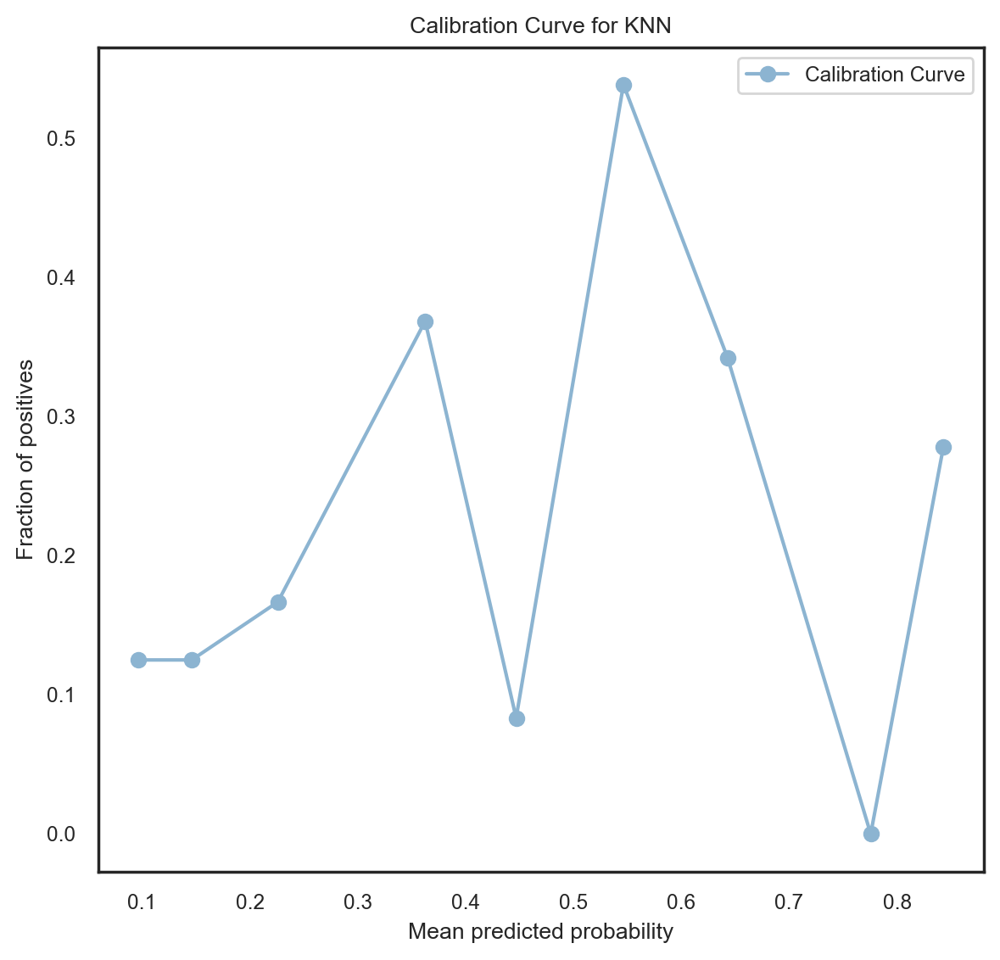

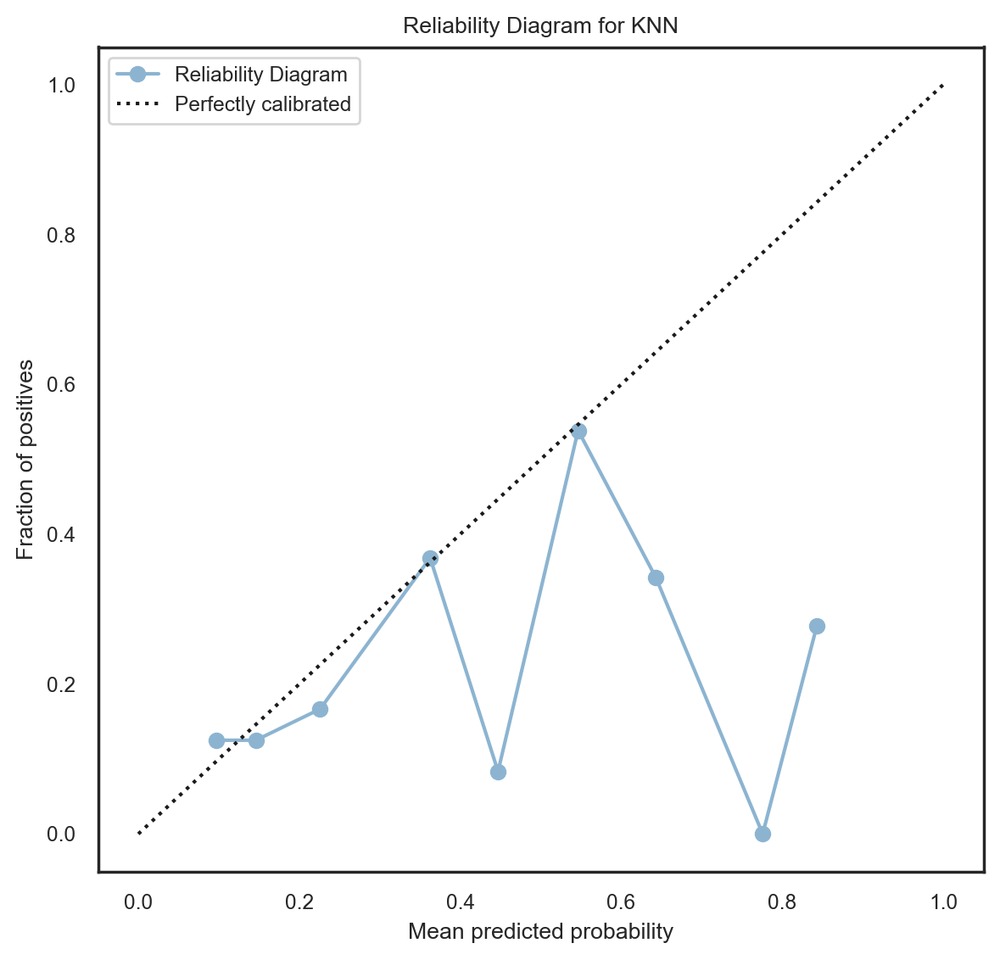

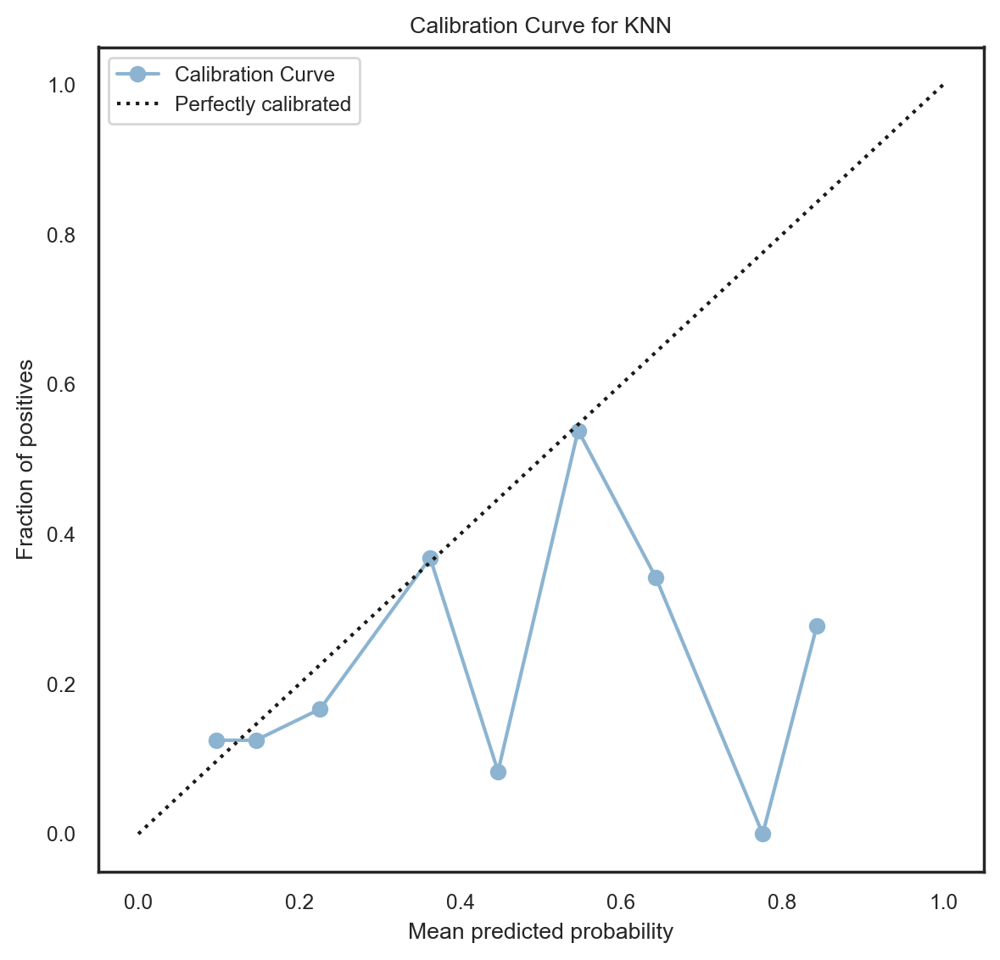

--- Naive Bayes ---
Jaccard score = 0.2803030303030303
F1 score = 0.4378698224852071
Accuracy = 0.5957446808510638
Matthews Correlation Coefficient = 0.2510061392689148
Precision = 0.30833333333333335
ROC AUC = 0.6837283300416941
Brier score = 0.23322561349021784
Log loss = 0.6514344026847427
Recall = 0.7551020408163265
Confusion Matrix:
[[103  83]
 [ 12  37]]


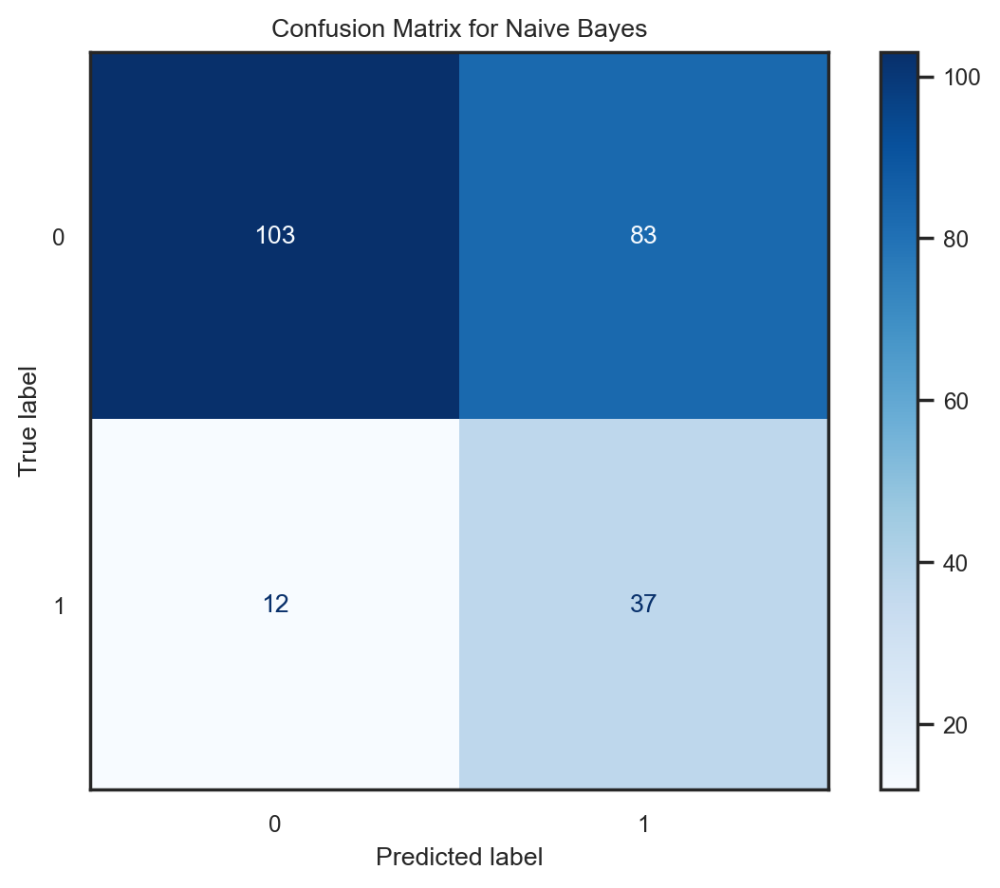

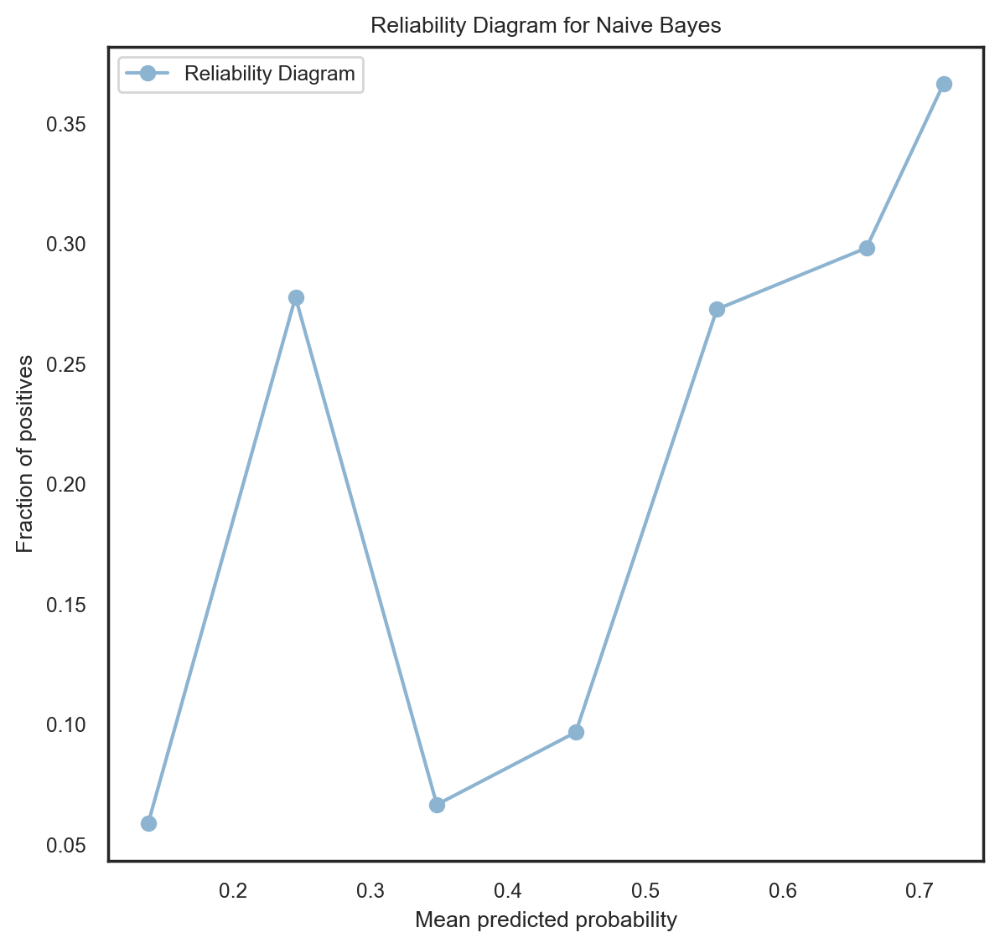

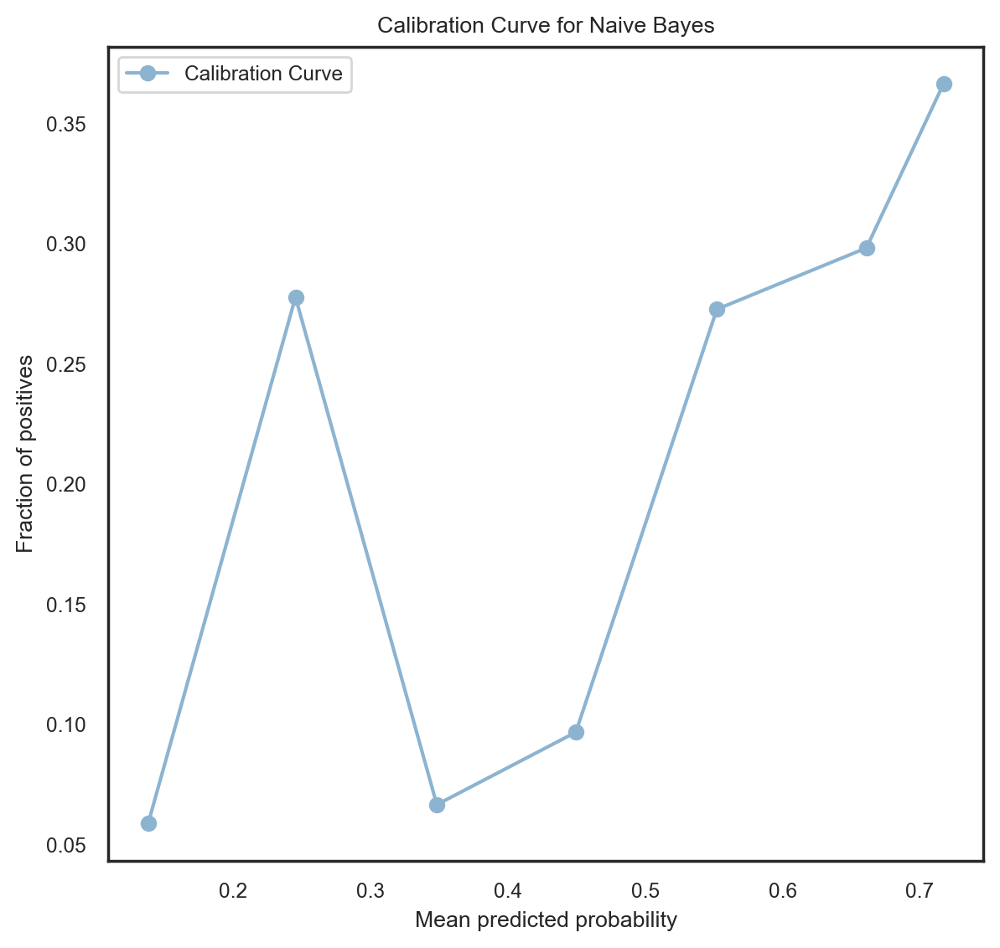

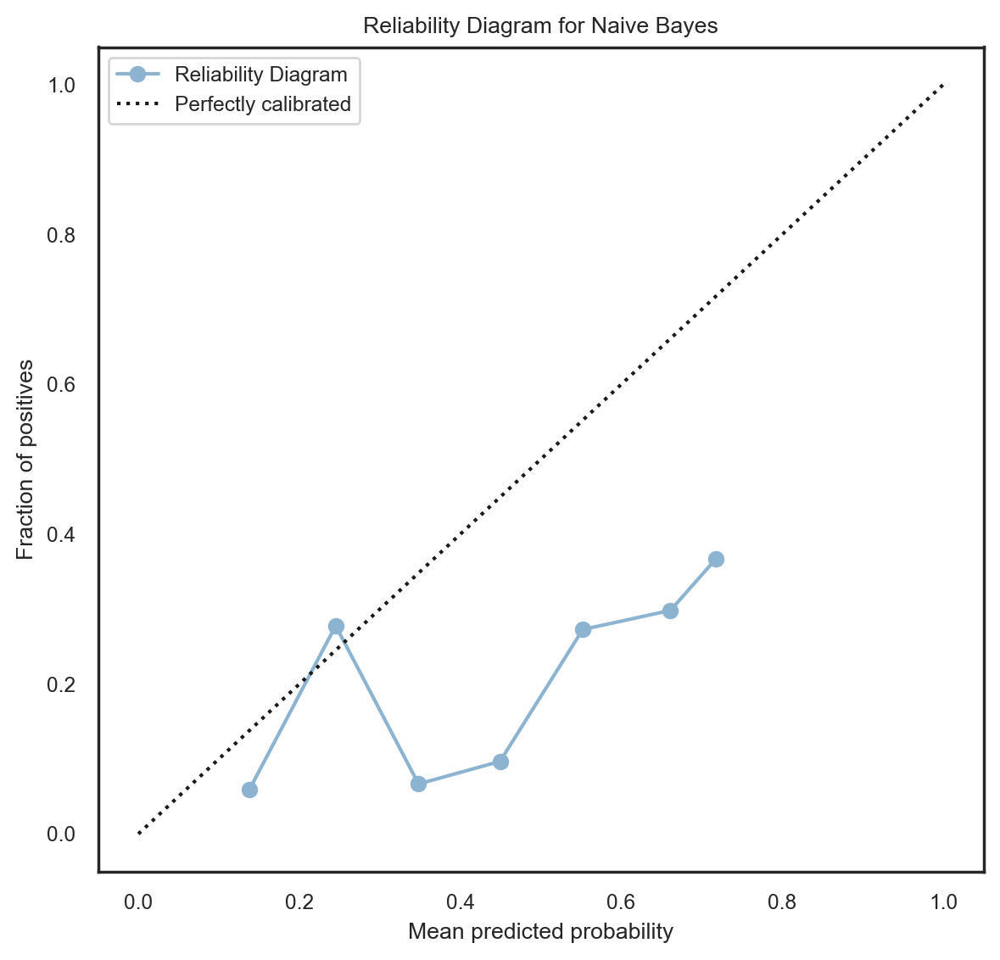

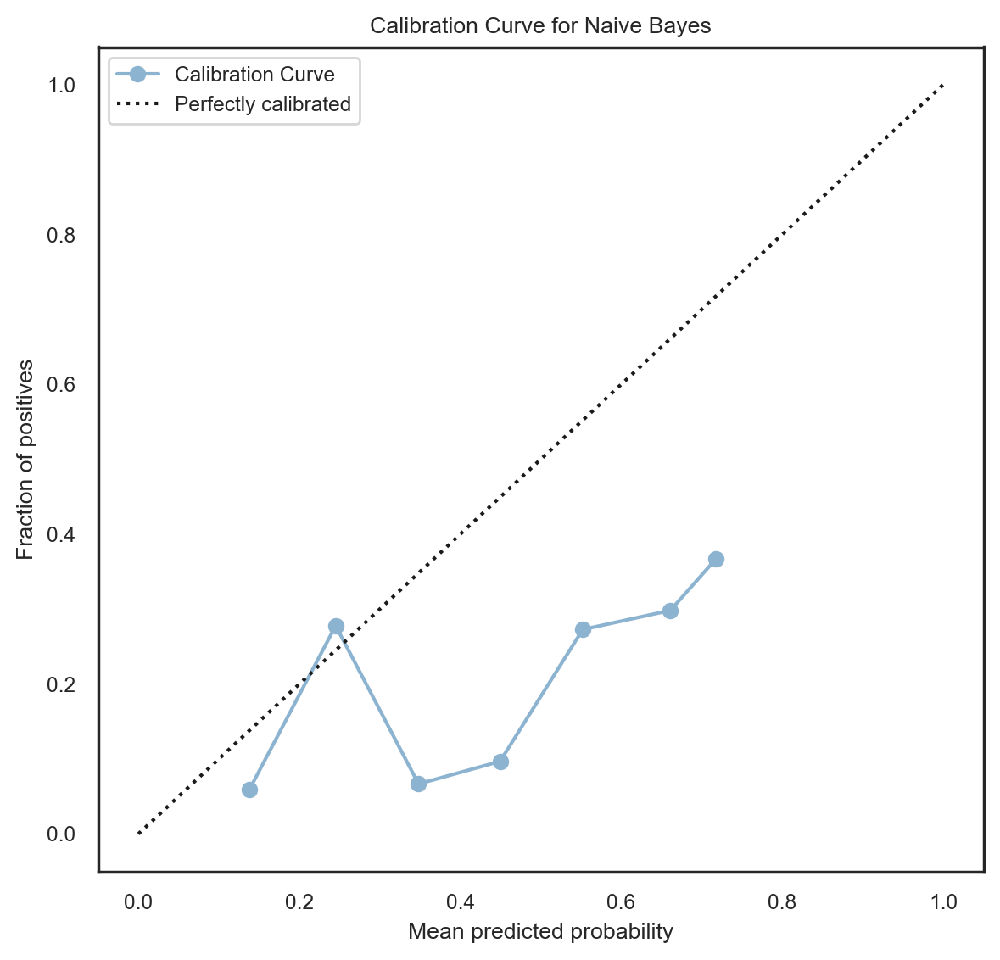

--- LDA ---
Jaccard score = 0.248
F1 score = 0.39743589743589747
Accuracy = 0.6
Matthews Correlation Coefficient = 0.18276976437996223
Precision = 0.2897196261682243
ROC AUC = 0.6838380513495721
Brier score = 0.23280983194384974
Log loss = 0.6612192783334523
Recall = 0.6326530612244898
Confusion Matrix:
[[110  76]
 [ 18  31]]


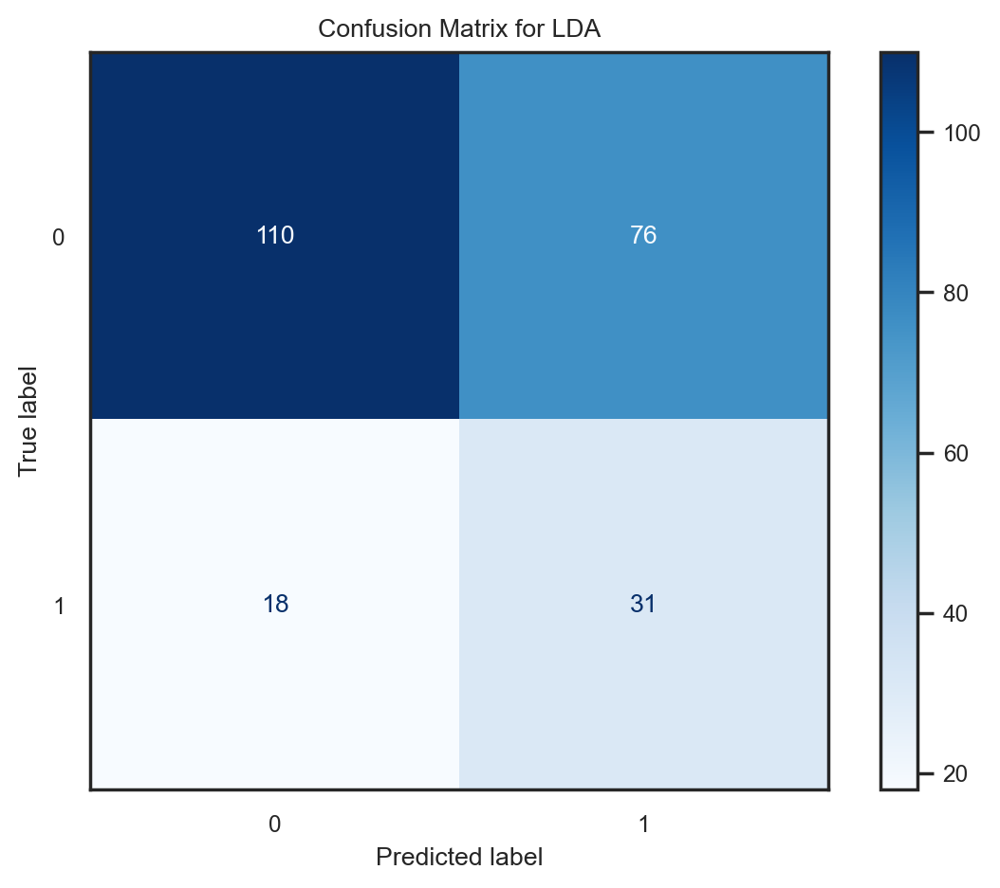

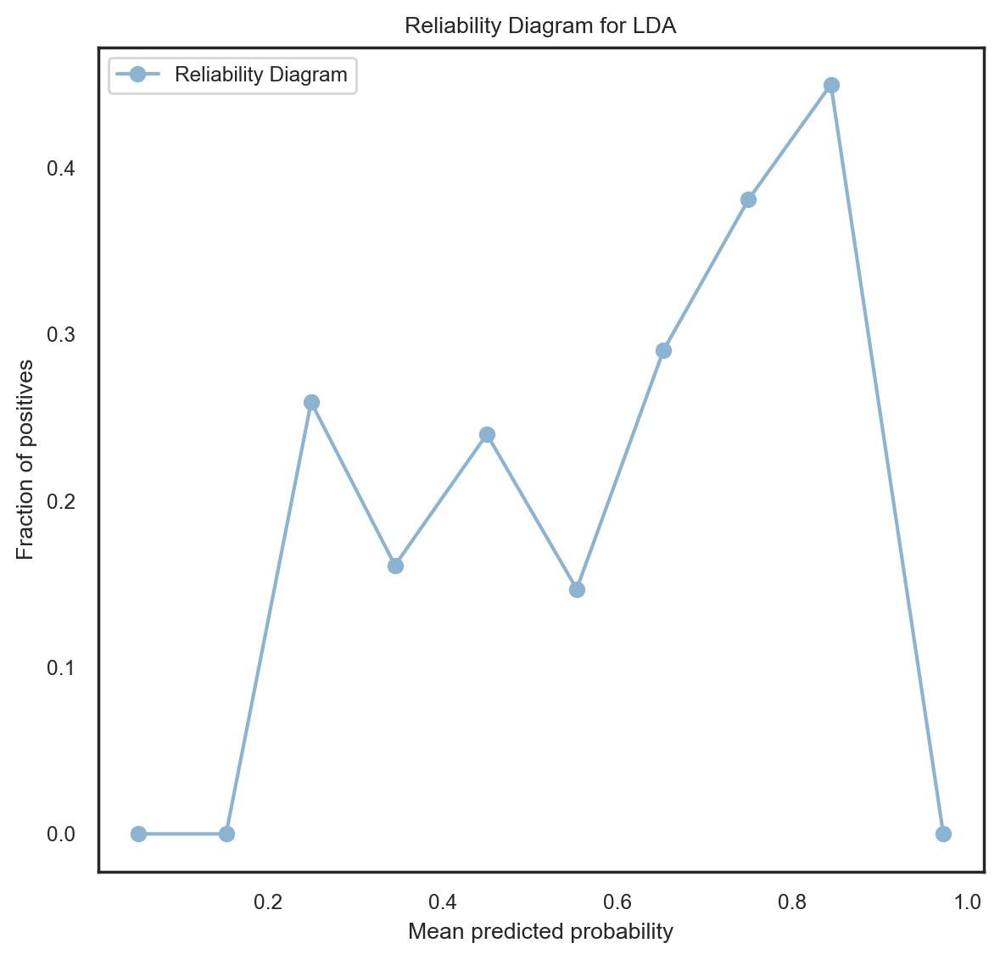

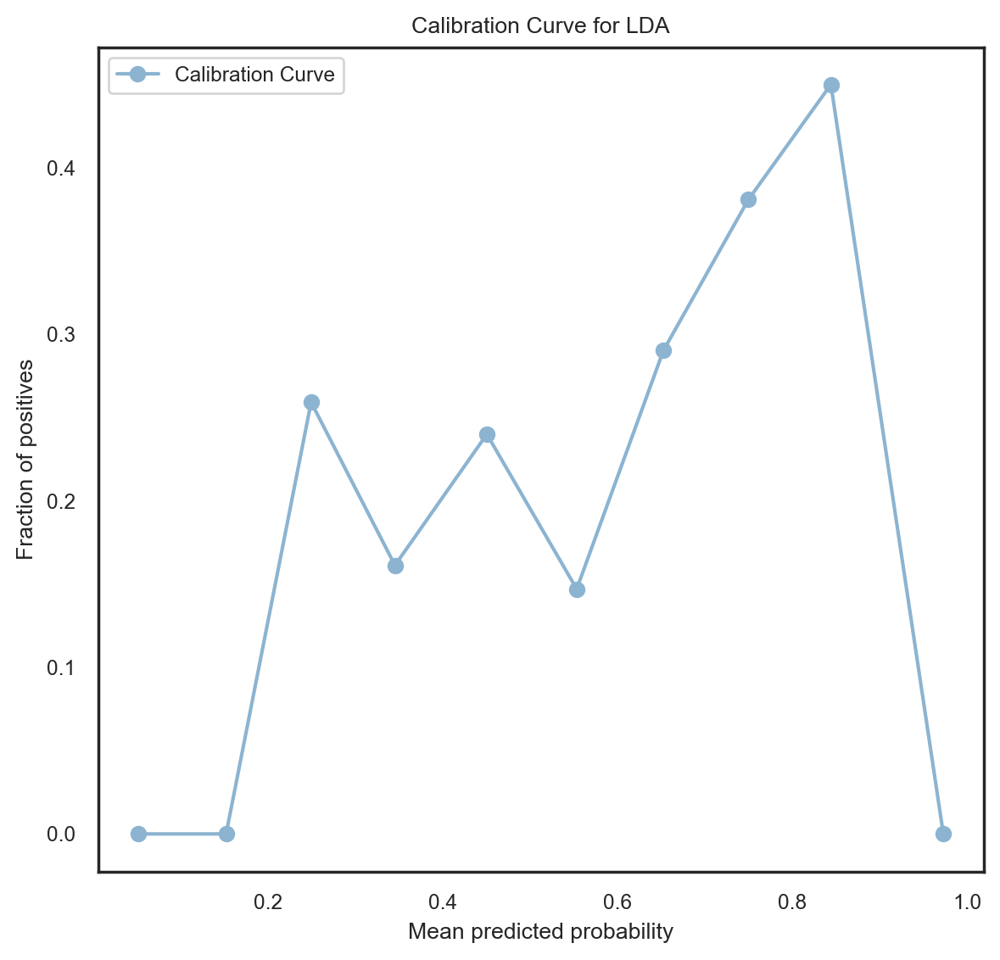

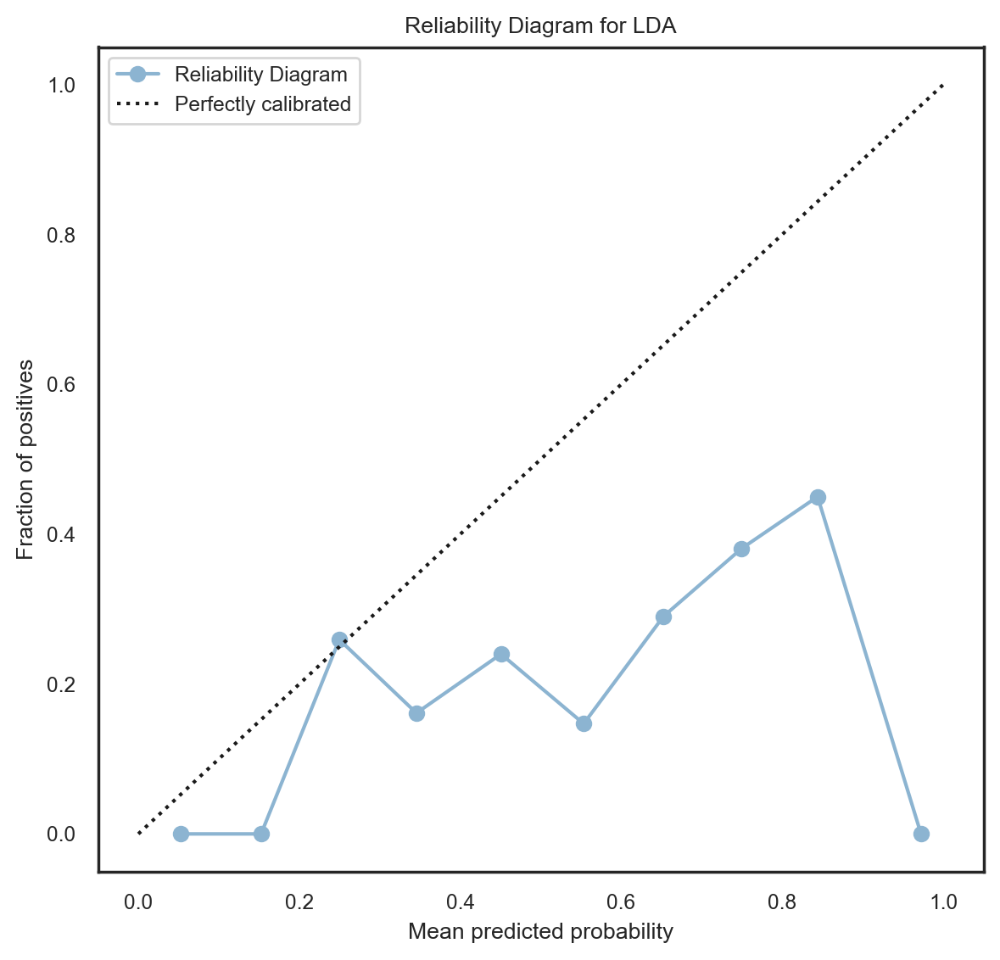

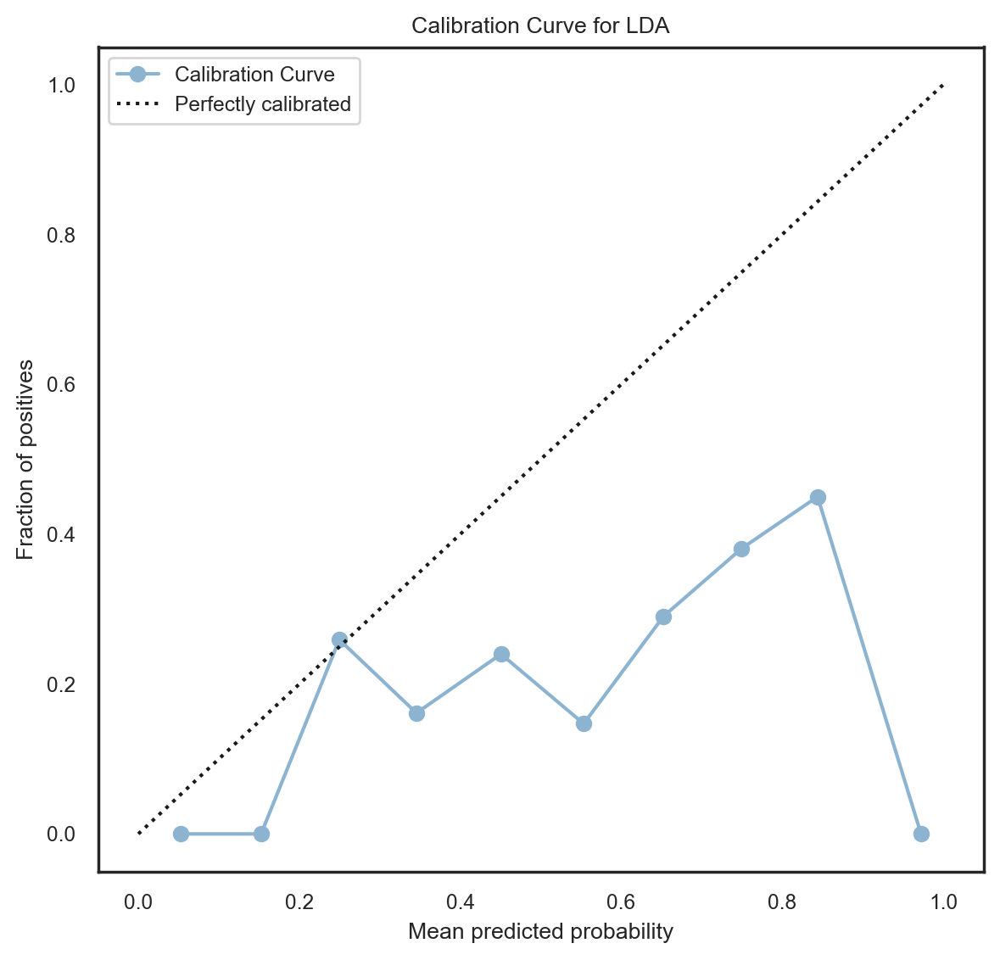

--- SVM ---
Jaccard score = 0.25862068965517243
F1 score = 0.410958904109589
Accuracy = 0.6340425531914894
Matthews Correlation Coefficient = 0.20796060525047483
Precision = 0.30927835051546393
ROC AUC = 0.6544327408382707
Brier score = 0.22975859488624217
Log loss = 0.6472044521069569
Recall = 0.6122448979591837
Confusion Matrix:
[[119  67]
 [ 19  30]]


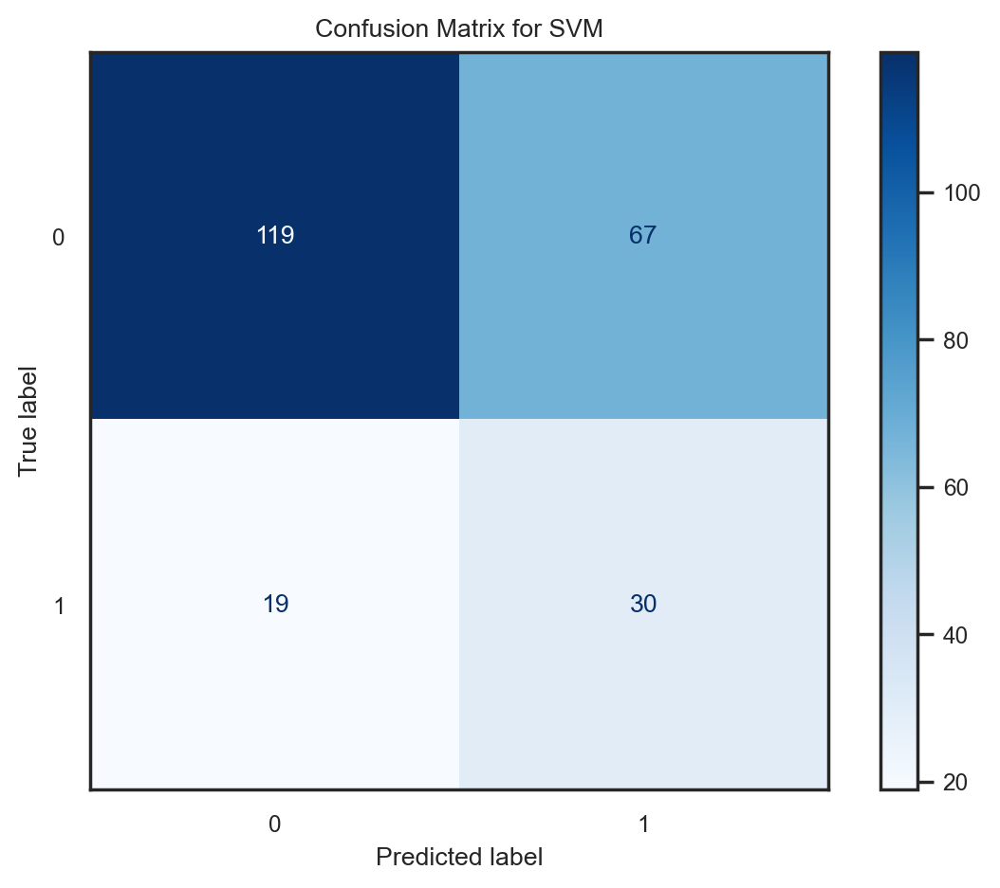

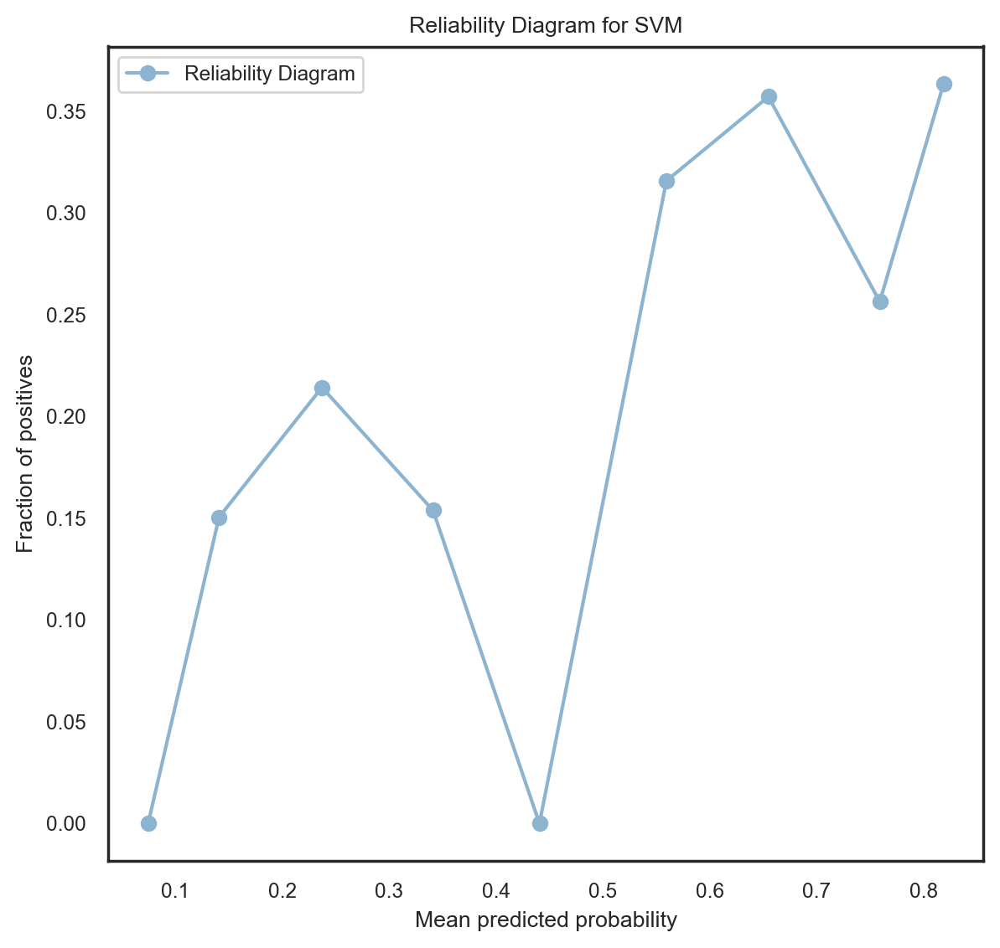

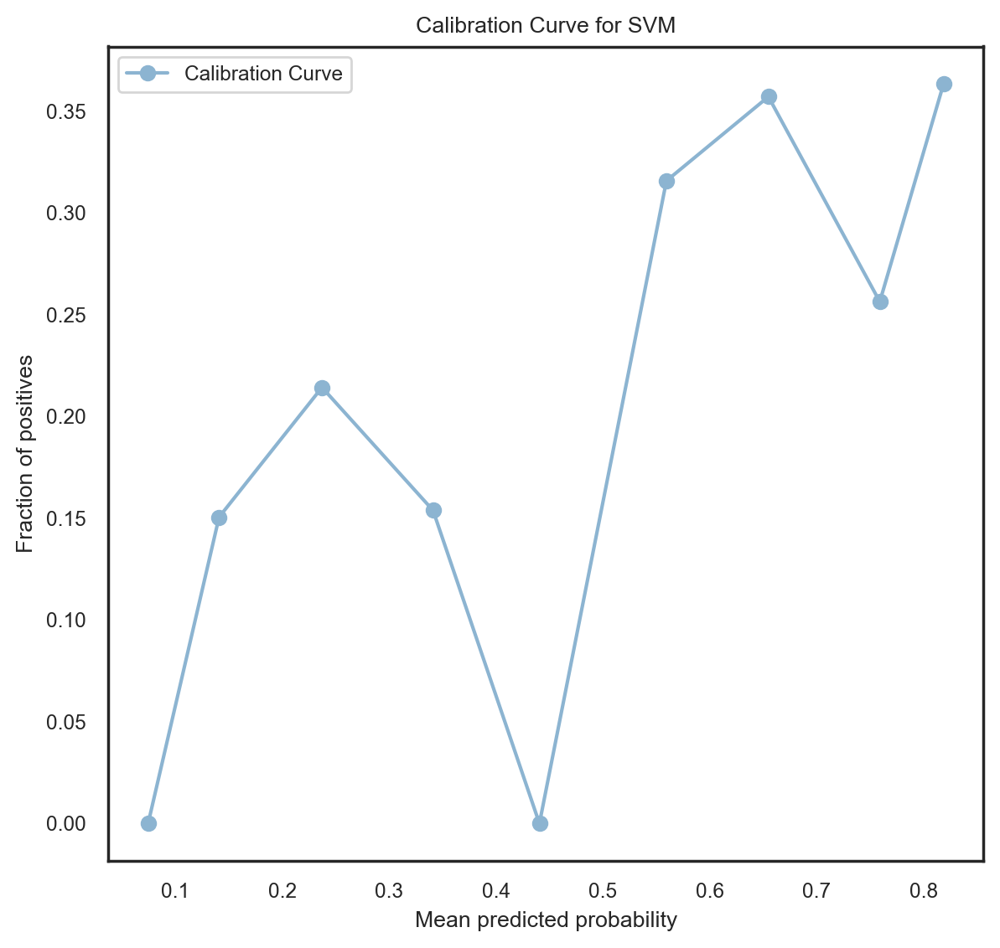

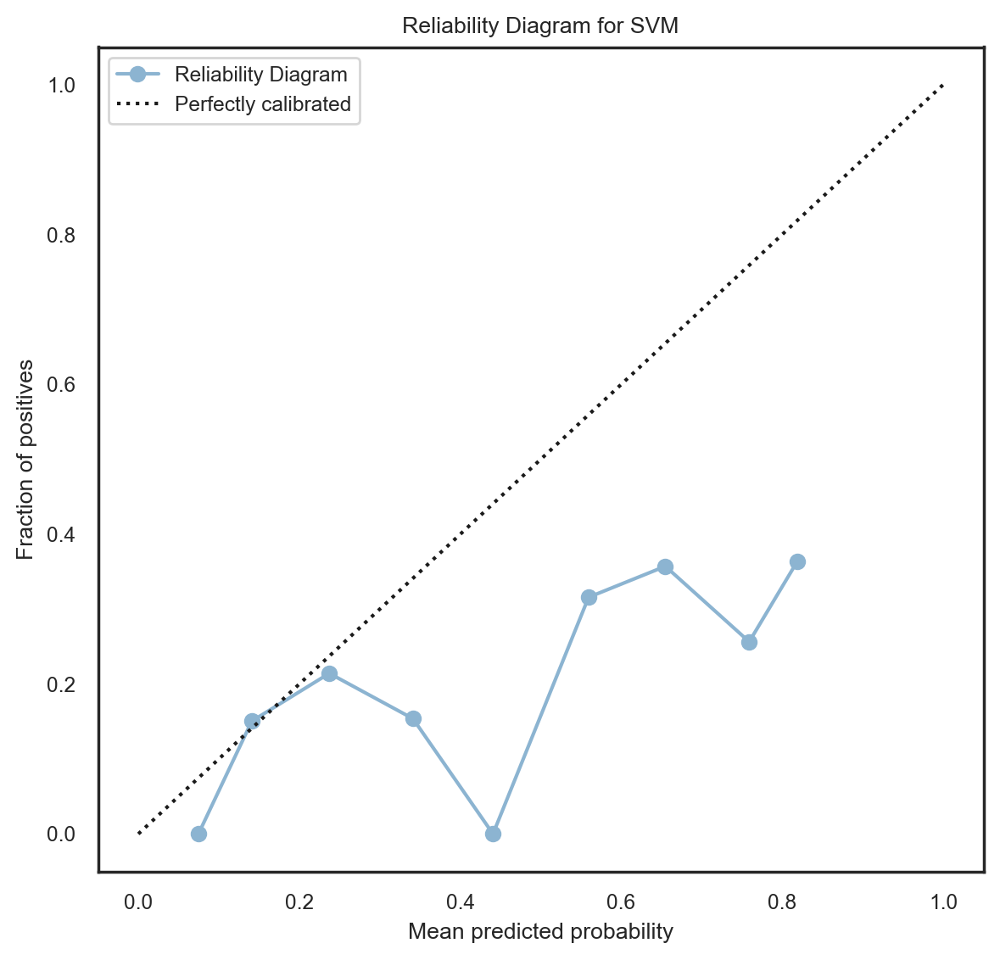

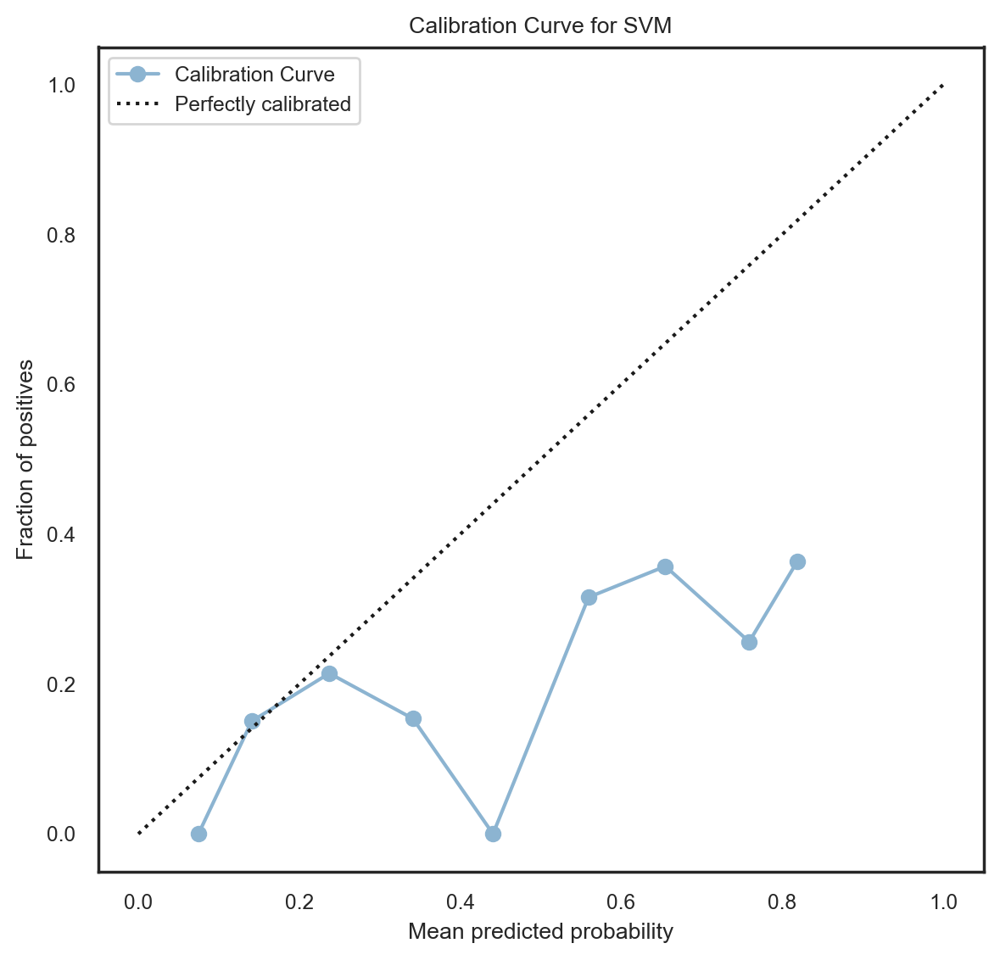

--- Decision Tree ---
Jaccard score = 0.18888888888888888
F1 score = 0.3177570093457944
Accuracy = 0.6893617021276596
Matthews Correlation Coefficient = 0.11919942630941124
Precision = 0.29310344827586204
ROC AUC = 0.5834430546412113
Brier score = 0.21022265029628284
Log loss = 0.6108315896373803
Recall = 0.3469387755102041
Confusion Matrix:
[[145  41]
 [ 32  17]]


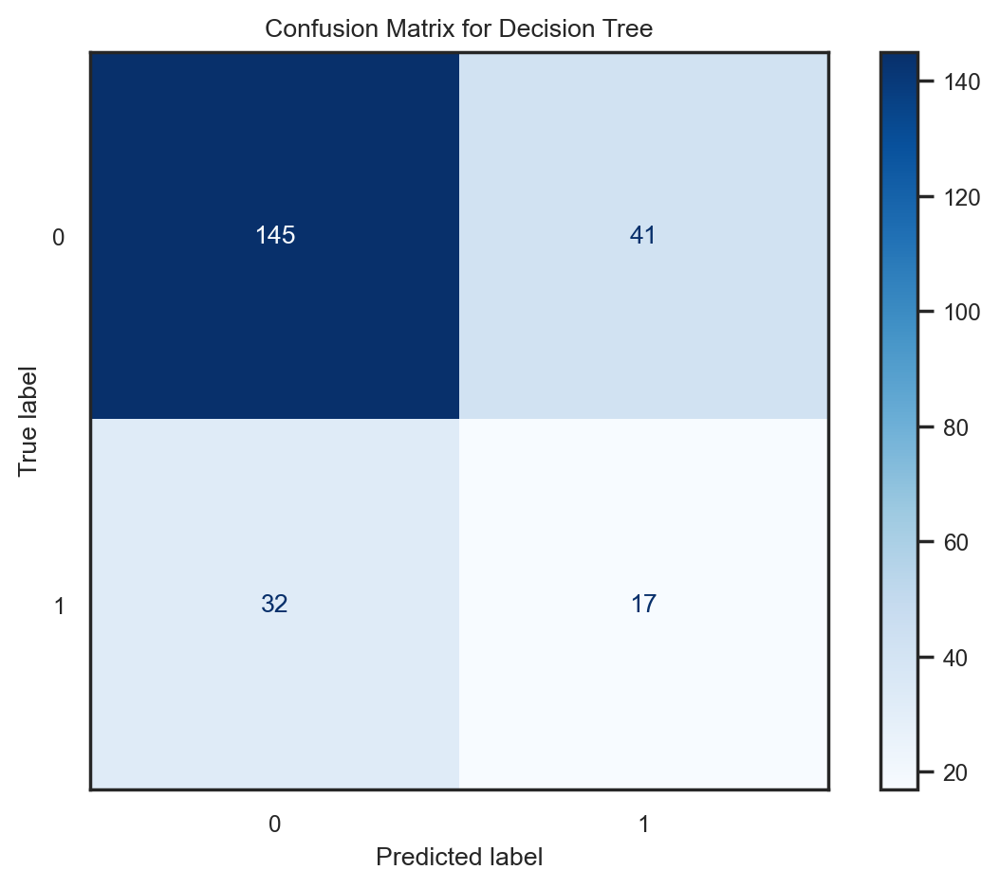

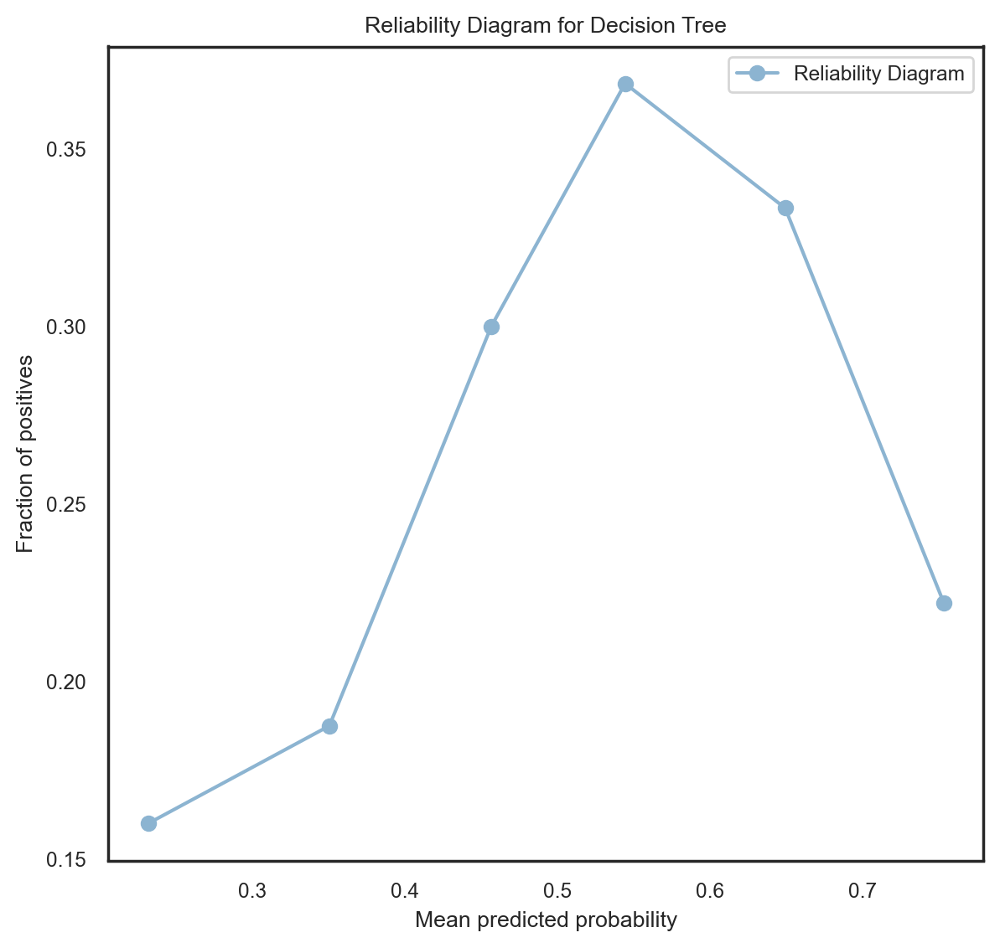

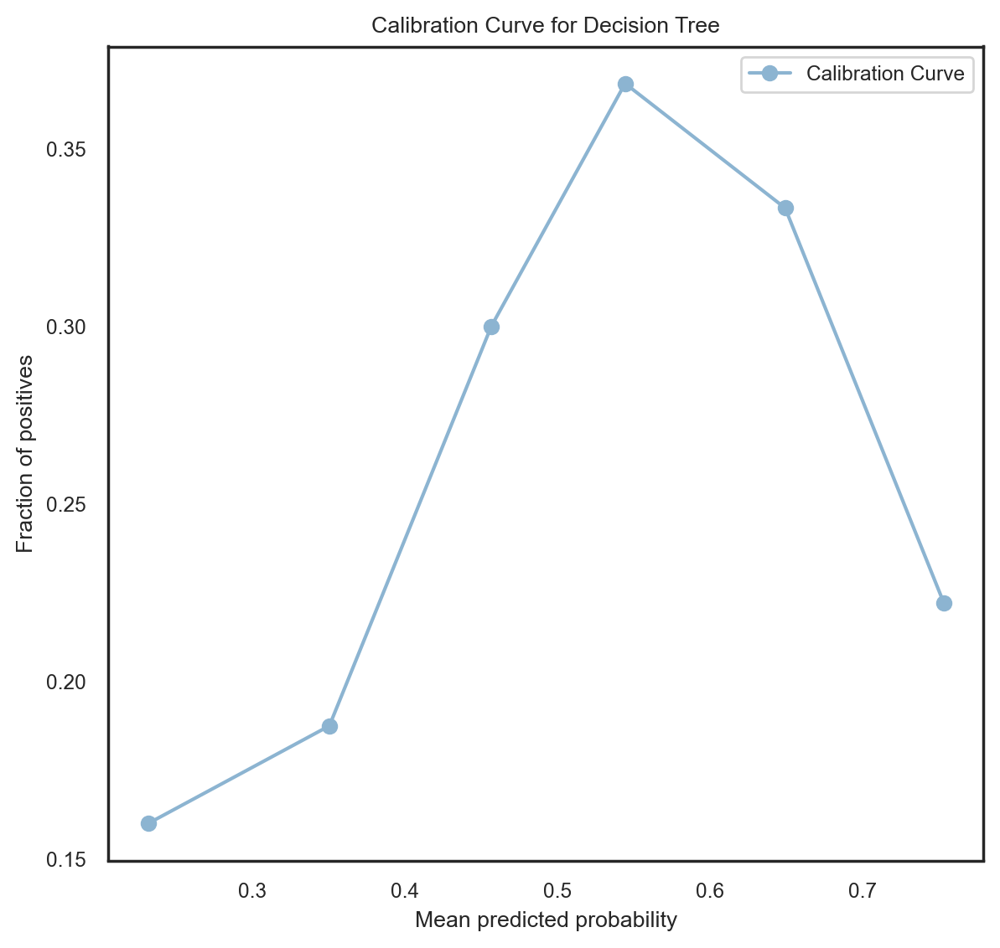

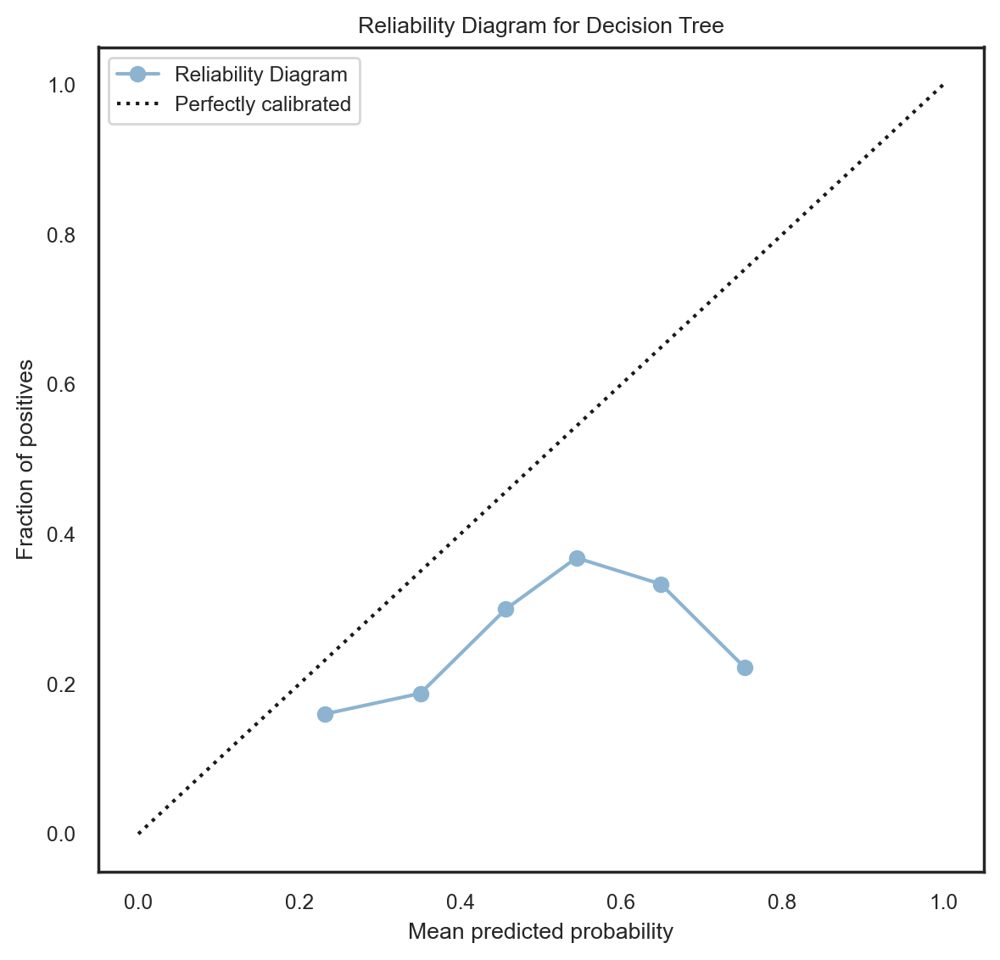

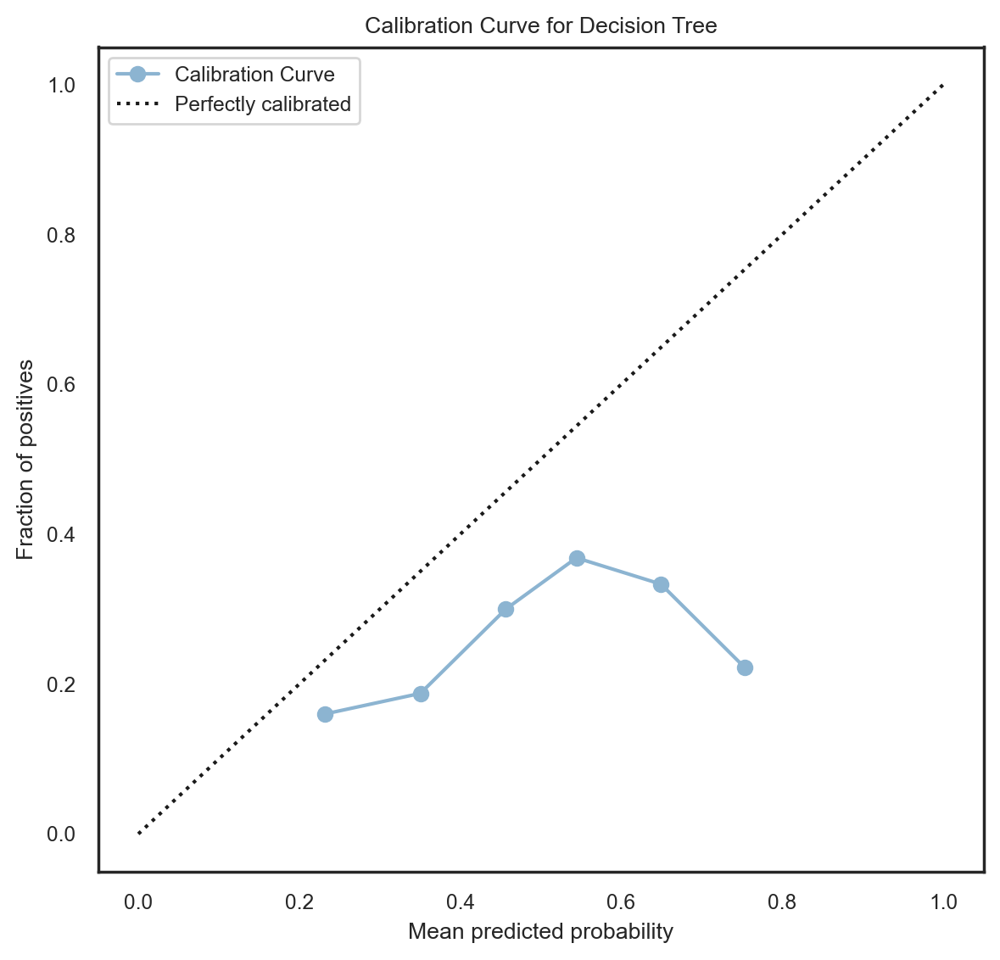

In [ ]:
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import jaccard_score, f1_score, accuracy_score, matthews_corrcoef, precision_score, roc_auc_score
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, plot_confusion_matrix
from sklearn.calibration import calibration_curve as sklearn_calibration_curve
from sklearn.calibration import calibration_curve
#from sklearn.calibration import reliability_curve
import matplotlib.pyplot as plt
from sklearn.metrics import confusion_matrix, plot_confusion_matrix, brier_score_loss, log_loss, recall_score
from sklearn.calibration import calibration_curve as sklearn_calibration_curve
from sklearn.calibration import calibration_curve

# Prepare the models
models = [
    ('Logistic Regression', LogisticRegression(max_iter=1000)),
    ('KNN', KNeighborsClassifier(n_neighbors=3)),
    ('Naive Bayes', GaussianNB()),
    ('LDA', LinearDiscriminantAnalysis()),
    ('SVM', SVC()),
    ('Decision Tree', DecisionTreeClassifier())
]

# Iterate over models
for name, model in models:
    print(f'--- {name} ---')
    calibrated = CalibratedClassifierCV(model, method='sigmoid', cv=5)
    calibrated.fit(X_train_resampled, y_train_resampled)
    y_pred = calibrated.predict(X_test)
    y_prob = calibrated.predict_proba(X_test)[:, 1]  # For ROC AUC

    # print metrics
    print('Jaccard score = {}'.format(jaccard_score(y_test, y_pred, average='binary')))
    print('F1 score = {}'.format(f1_score(y_test, y_pred)))
    print('Accuracy = {}'.format(accuracy_score(y_test, y_pred)))
    print('Matthews Correlation Coefficient = {}'.format(matthews_corrcoef(y_test, y_pred)))
    print('Precision = {}'.format(precision_score(y_test, y_pred)))
    print('ROC AUC = {}'.format(roc_auc_score(y_test, y_prob)))
    print('Brier score = {}'.format(brier_score_loss(y_test, y_prob)))
    print('Log loss = {}'.format(log_loss(y_test, y_prob)))
    print('Recall = {}'.format(recall_score(y_test, y_pred)))

     # Calculate the confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred)
    print('Confusion Matrix:')
    print(conf_matrix)
    plot_confusion_matrix(calibrated, X_test, y_test, cmap='Blues')
    plt.title(f'Confusion Matrix for {name}')
    plt.show()
    '''
    plt.figure(figsize=(8, 6))
        sns.heatmap(conf_matrix_calibrated, annot=True, fmt='d', cmap='Blues',
                    xticklabels=['Predicted Negative', 'Predicted Positive'],
                    yticklabels=['Actual Negative', 'Actual Positive'])
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix for {key} Calibrated Predictions')
        plt.show()
'''

     # Plot the reliability diagram
    prob_true, prob_pred = sklearn_calibration_curve(y_test, y_prob, n_bins=10)
    plt.figure(figsize=(6, 6))
    plt.plot(prob_pred, prob_true, marker='o', label='Reliability Diagram')
    plt.xlabel("Mean predicted probability")
    plt.ylabel("Fraction of positives")
    plt.title(f'Reliability Diagram for {name}')
    plt.legend()
    plt.show()


    # Plot the calibration curve
    fraction_of_positives, mean_predicted_value = calibration_curve(y_test, y_prob, n_bins=10)
    plt.figure(figsize=(6, 6))
    plt.plot(mean_predicted_value, fraction_of_positives, marker='o', label='Calibration Curve')
    plt.xlabel("Mean predicted probability")
    plt.ylabel("Fraction of positives")
    plt.title(f'Calibration Curve for {name}')
    plt.legend()
    plt.show()

     # Plot the reliability diagram
    prob_true, prob_pred = sklearn_calibration_curve(y_test, y_prob, n_bins=10)
    plt.figure(figsize=(6, 6))
    plt.plot(prob_pred, prob_true, marker='o', label='Reliability Diagram')
    plt.plot([0, 1], [0, 1], "k:", label="Perfectly calibrated")  # Standard calibration curve
    plt.xlabel("Mean predicted probability")
    plt.ylabel("Fraction of positives")
    plt.title(f'Reliability Diagram for {name}')
    plt.legend()
    plt.show()

    # Plot the calibration curve
    fraction_of_positives, mean_predicted_value = sklearn_calibration_curve(y_test, y_prob, n_bins=10)
    plt.figure(figsize=(6, 6))
    plt.plot(mean_predicted_value, fraction_of_positives, marker='o', label='Calibration Curve')
    plt.plot([0, 1], [0, 1], "k:", label="Perfectly calibrated")  # Standard calibration curve
    plt.xlabel("Mean predicted probability")
    plt.ylabel("Fraction of positives")
    plt.title(f'Calibration Curve for {name}')
    plt.legend()
    plt.show()












### ISOTONIC CALIBRATION

--- Logistic Regression ---
Jaccard score = 0.24193548387096775
F1 score = 0.3896103896103896
Accuracy = 0.6
Matthews Correlation Coefficient = 0.17079460262935803
Precision = 0.2857142857142857
ROC AUC = 0.6767061663375028
Brier score = 0.24656853993286718
Log loss = 0.6781456515425386
Recall = 0.6122448979591837
Confusion Matrix:
[[111  75]
 [ 19  30]]


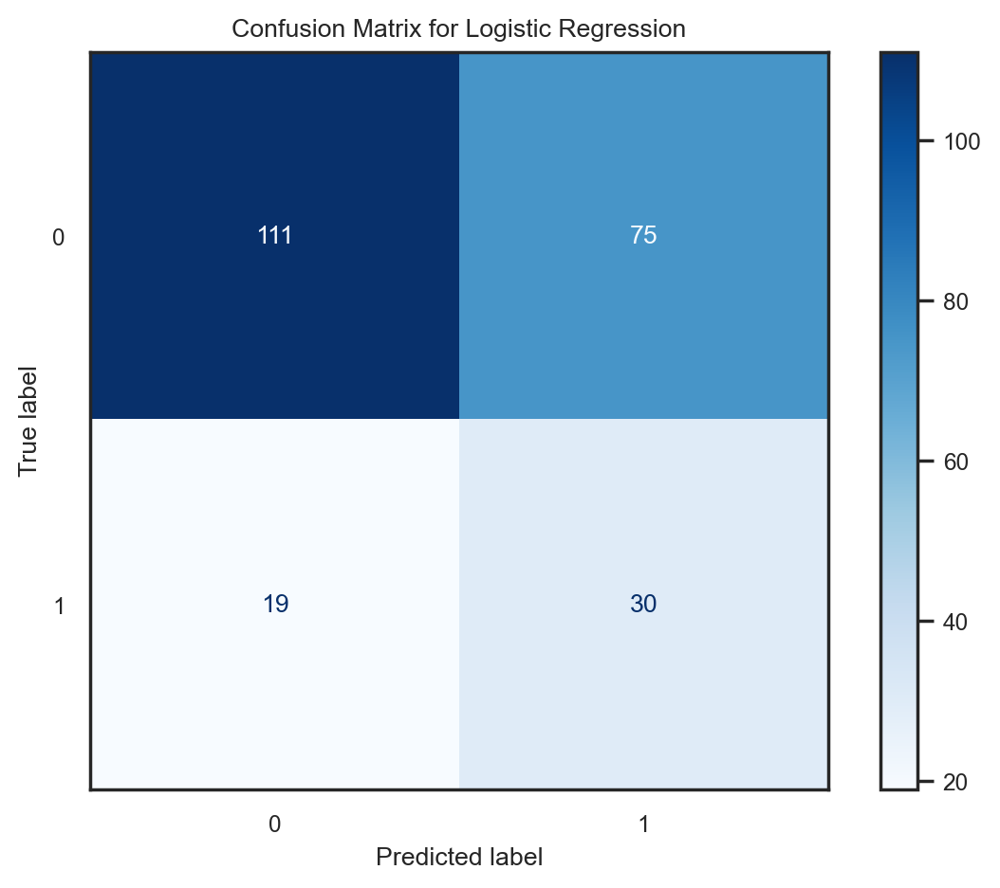

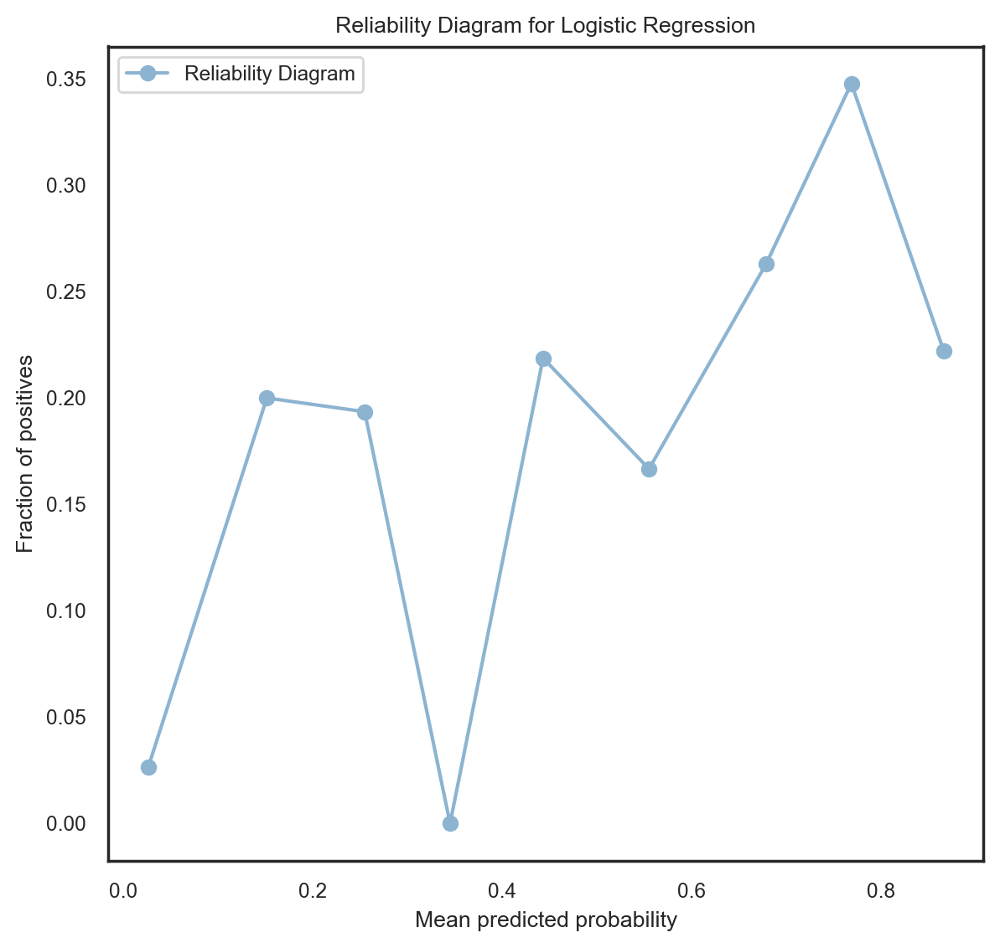

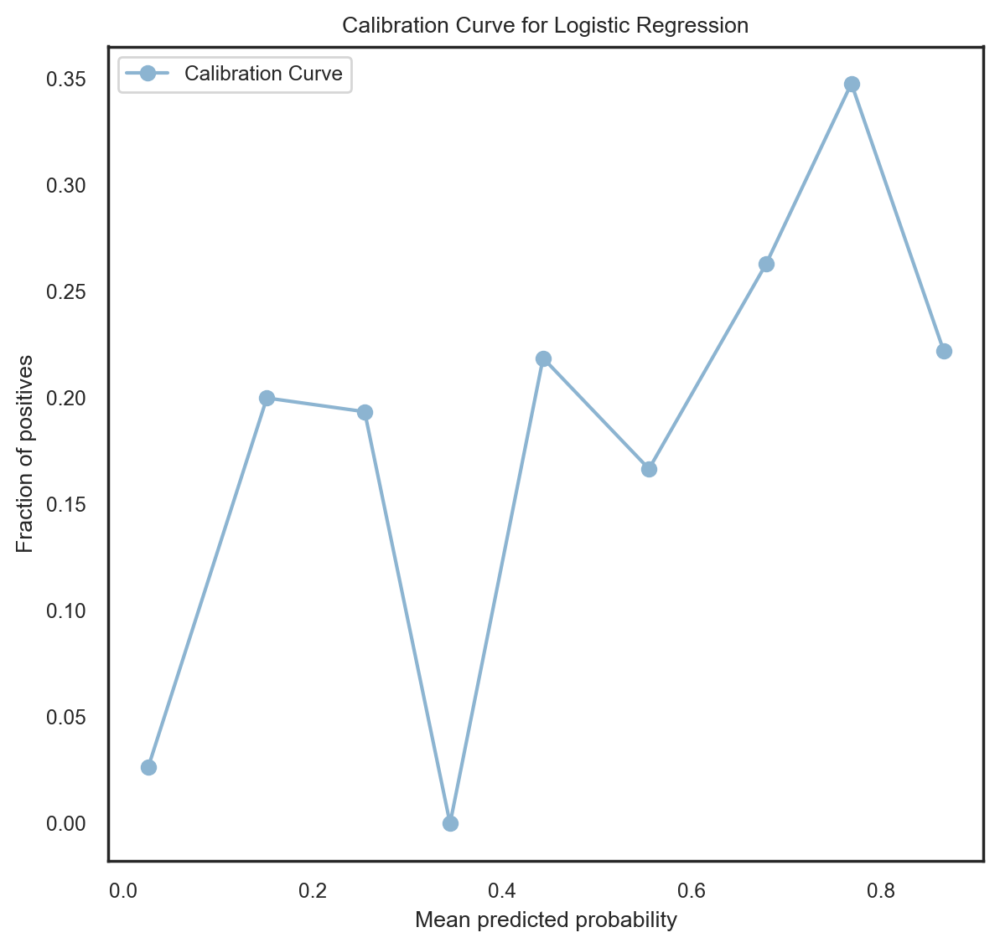

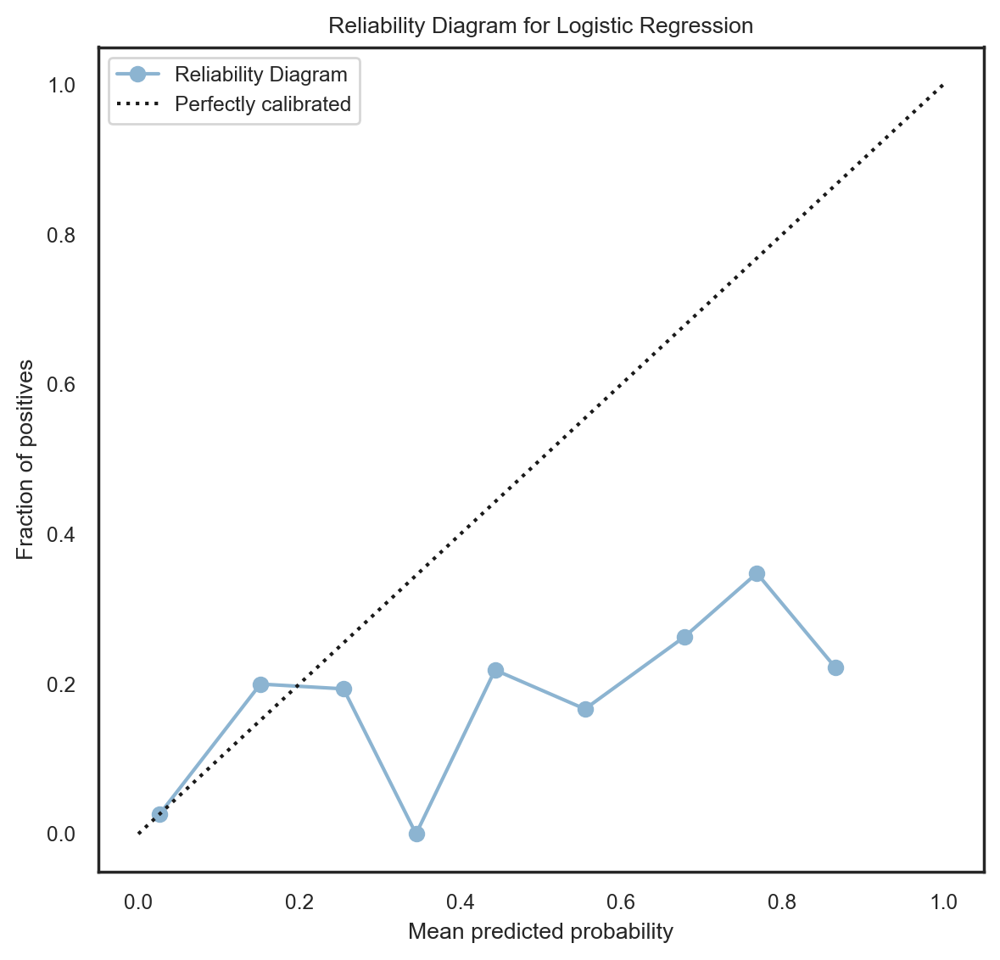

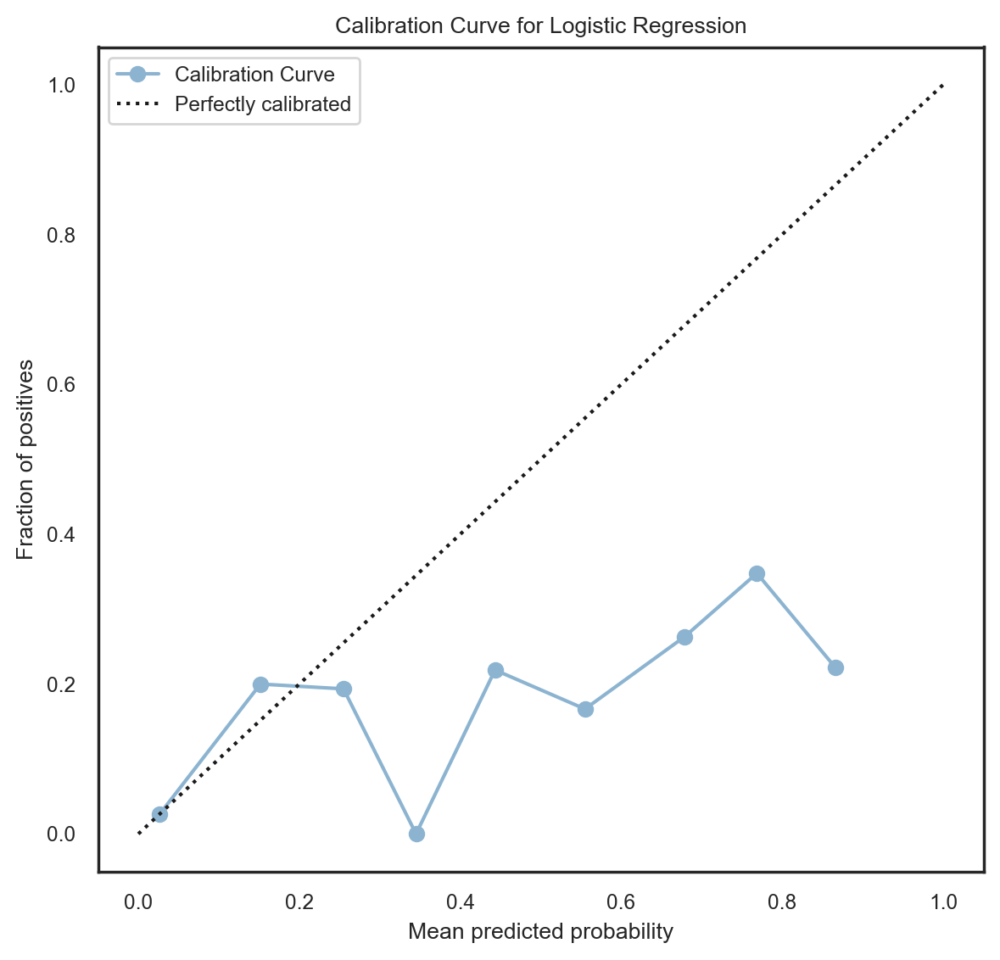

--- KNN ---
Jaccard score = 0.2231404958677686
F1 score = 0.36486486486486486
Accuracy = 0.6
Matthews Correlation Coefficient = 0.13486803621253954
Precision = 0.2727272727272727
ROC AUC = 0.6052775949089313
Brier score = 0.24488922646767114
Log loss = 0.7213032333902406
Recall = 0.5510204081632653
Confusion Matrix:
[[114  72]
 [ 22  27]]


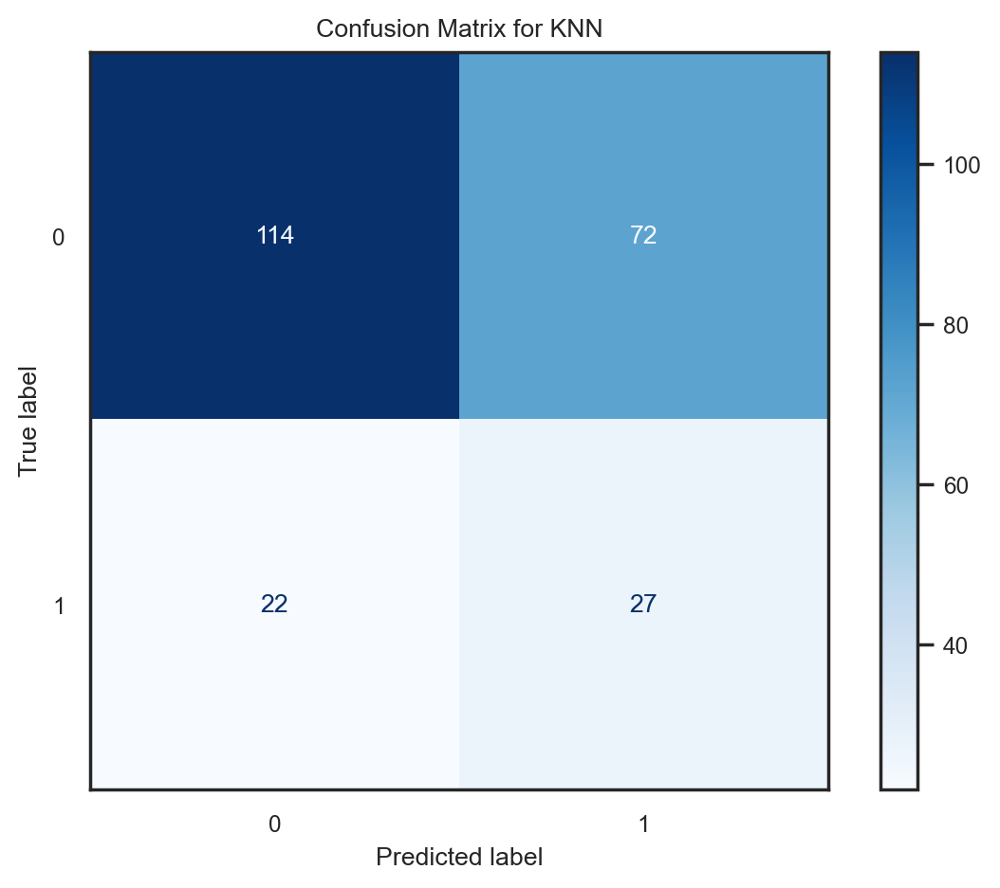

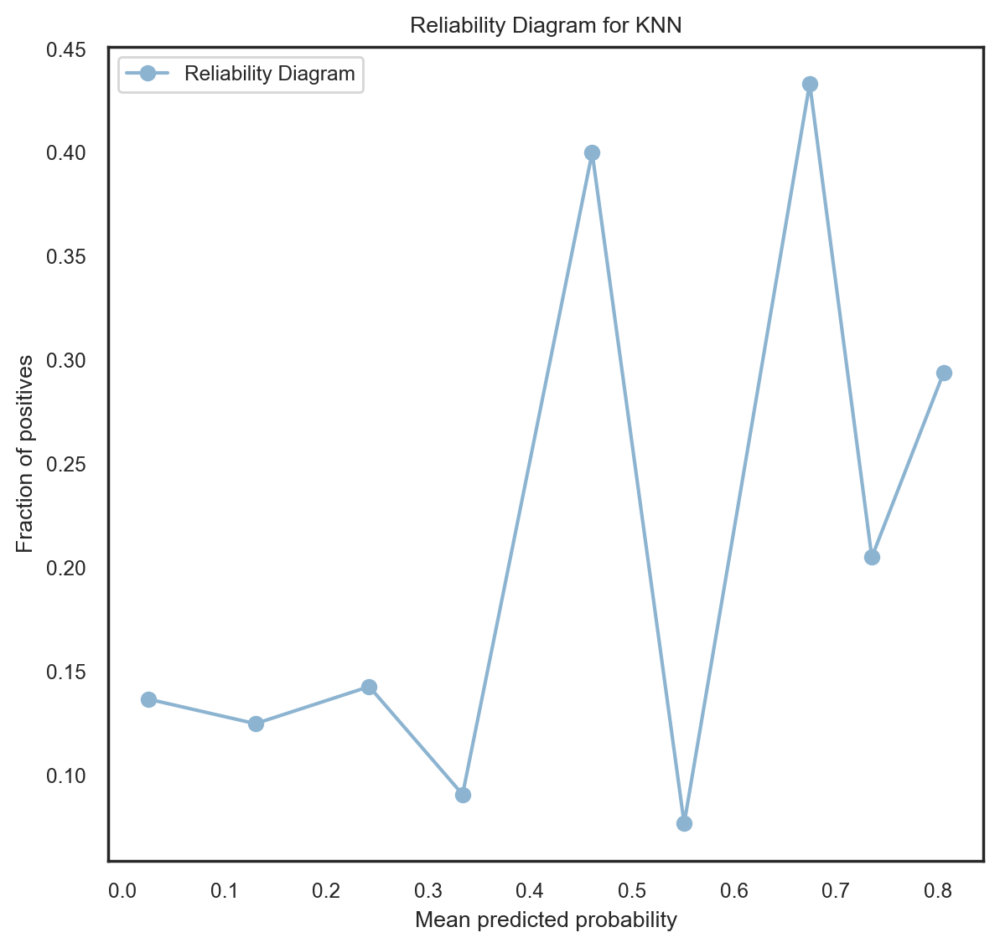

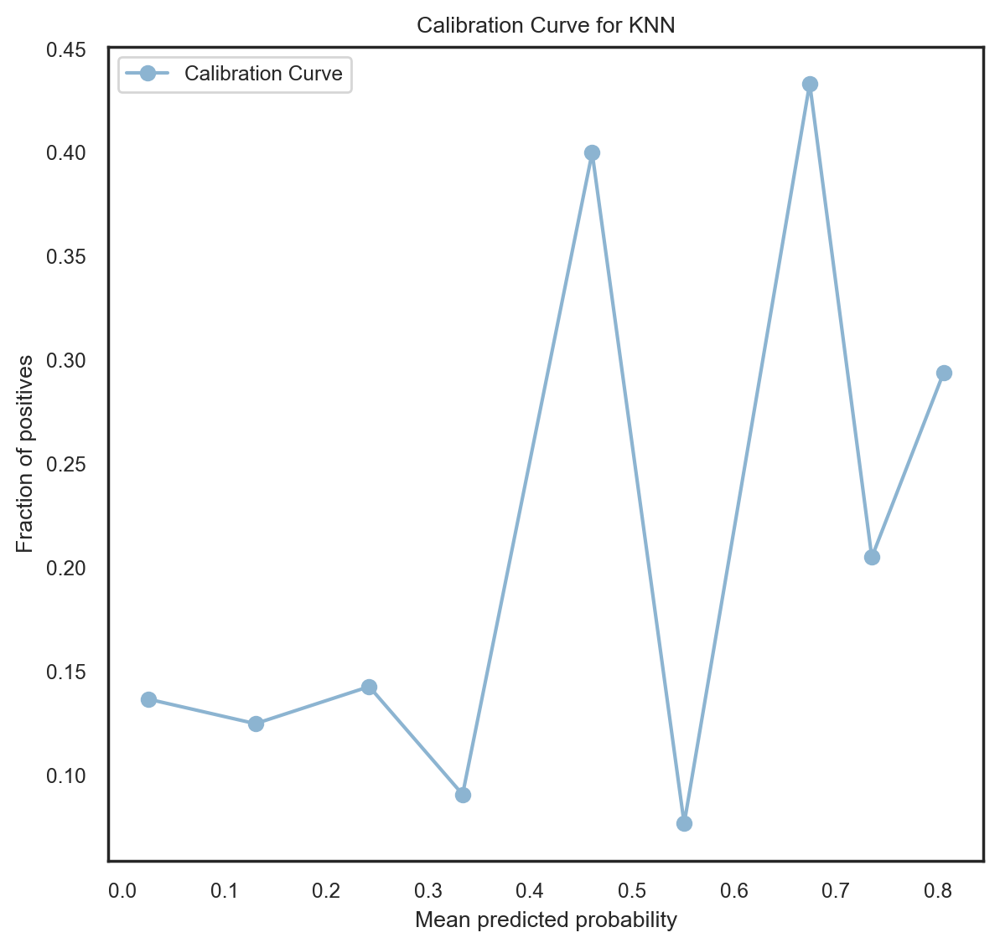

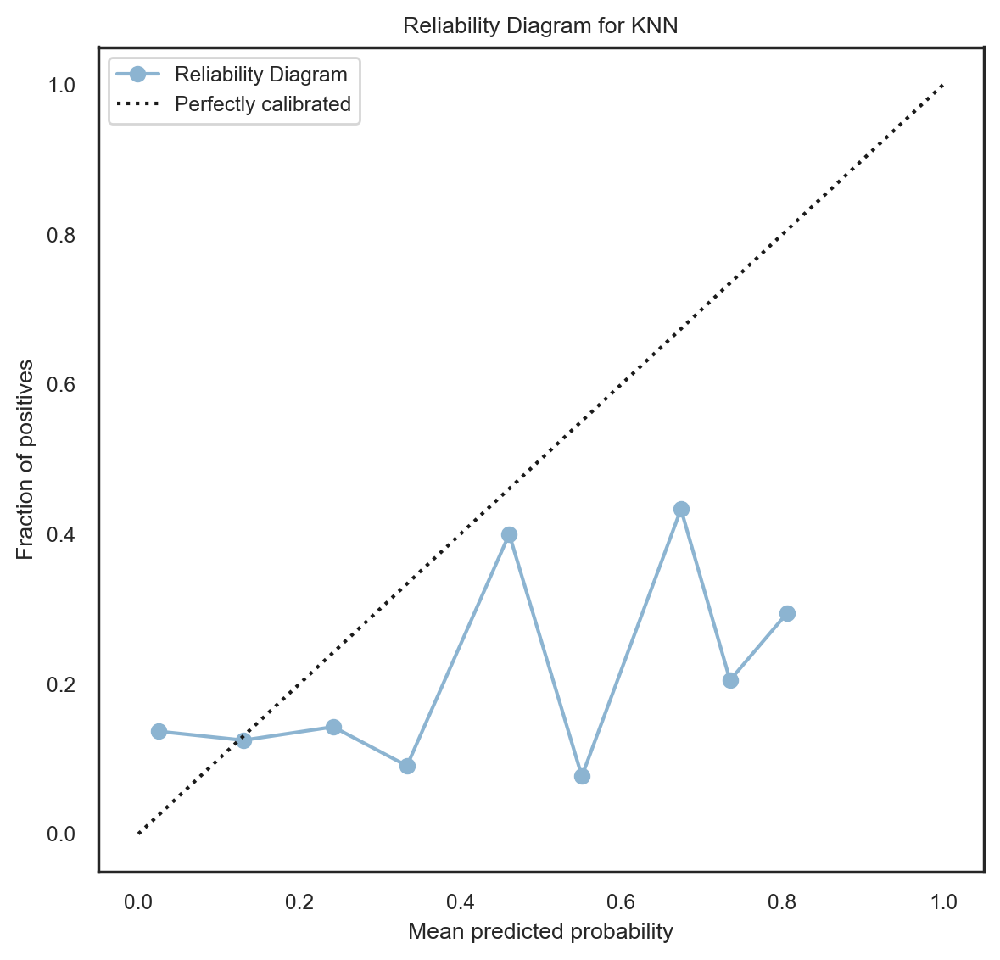

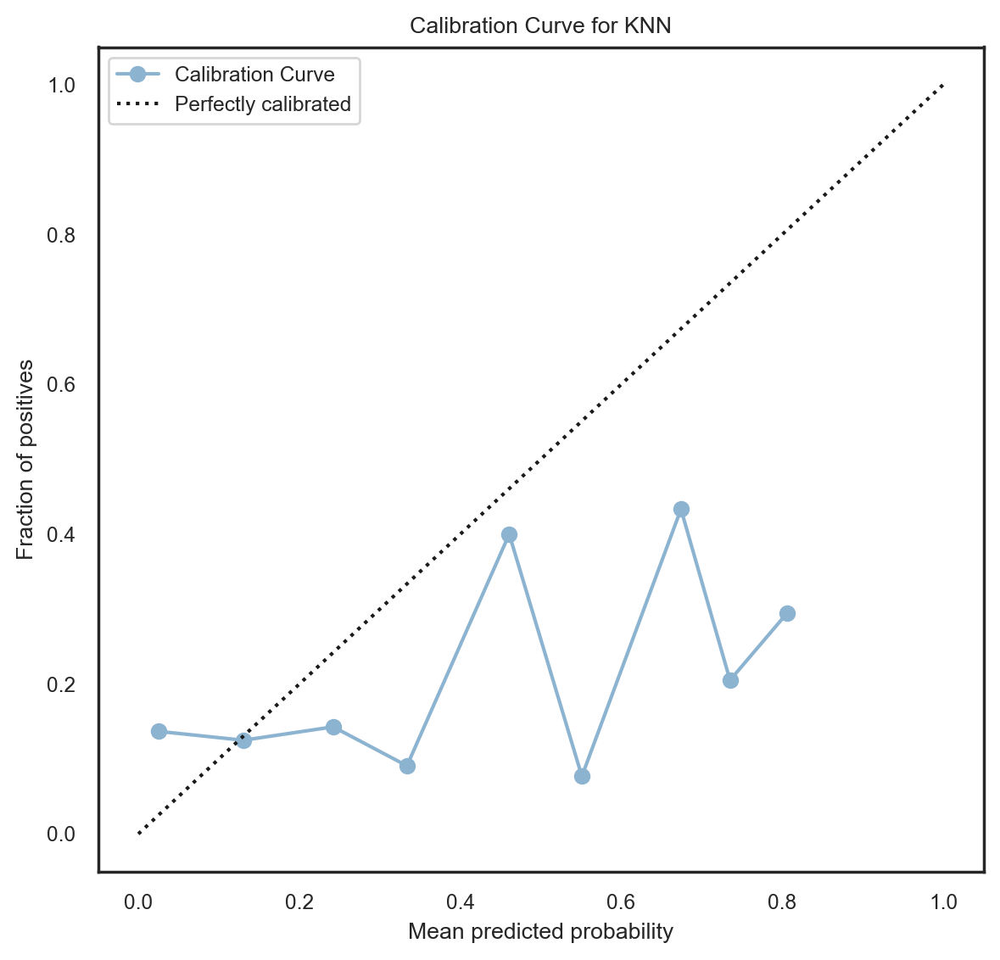

--- Naive Bayes ---
Jaccard score = 0.2698412698412698
F1 score = 0.42500000000000004
Accuracy = 0.6085106382978723
Matthews Correlation Coefficient = 0.22776323074921886
Precision = 0.3063063063063063
ROC AUC = 0.6802721088435374
Brier score = 0.23372620304034591
Log loss = 0.6626500320563881
Recall = 0.6938775510204082
Confusion Matrix:
[[109  77]
 [ 15  34]]


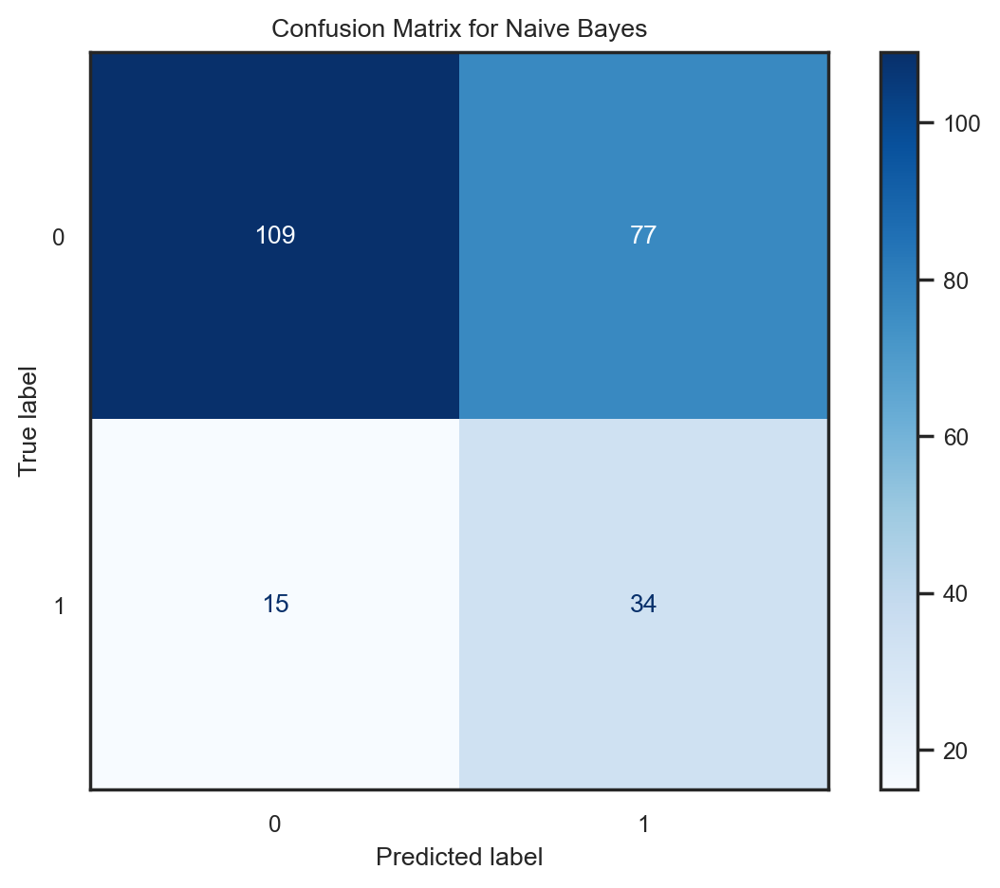

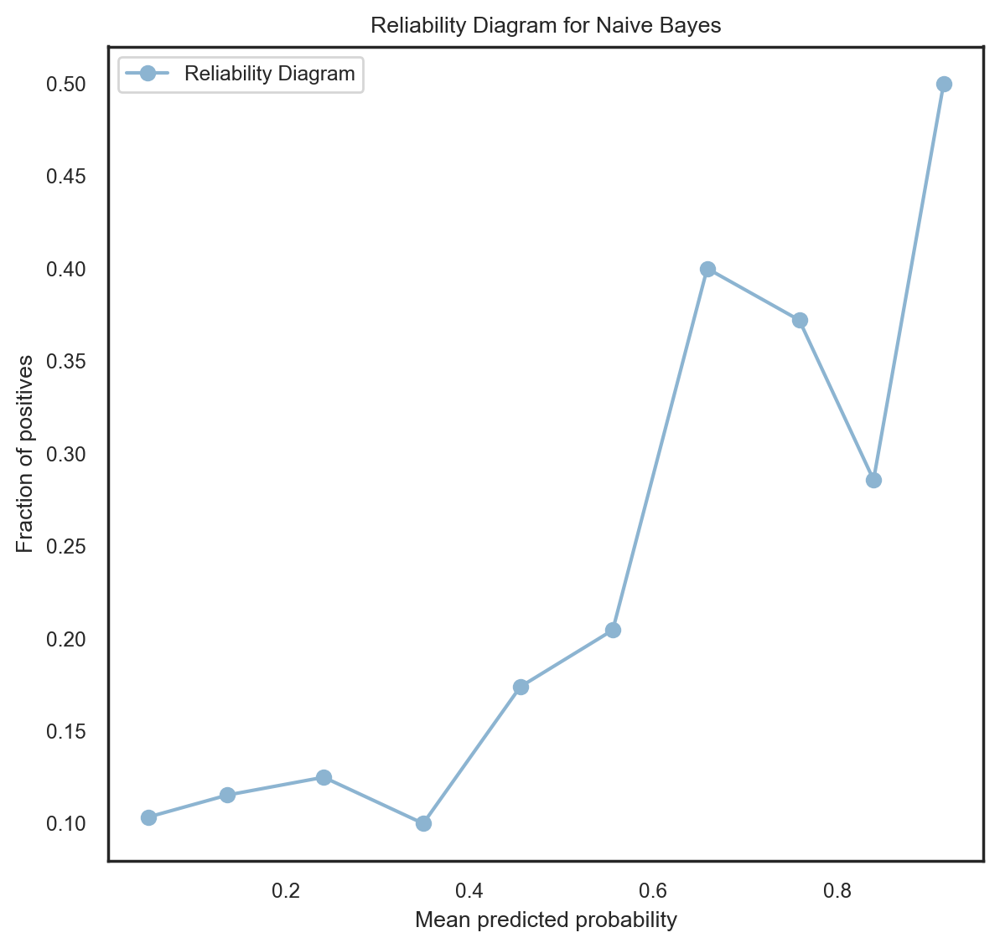

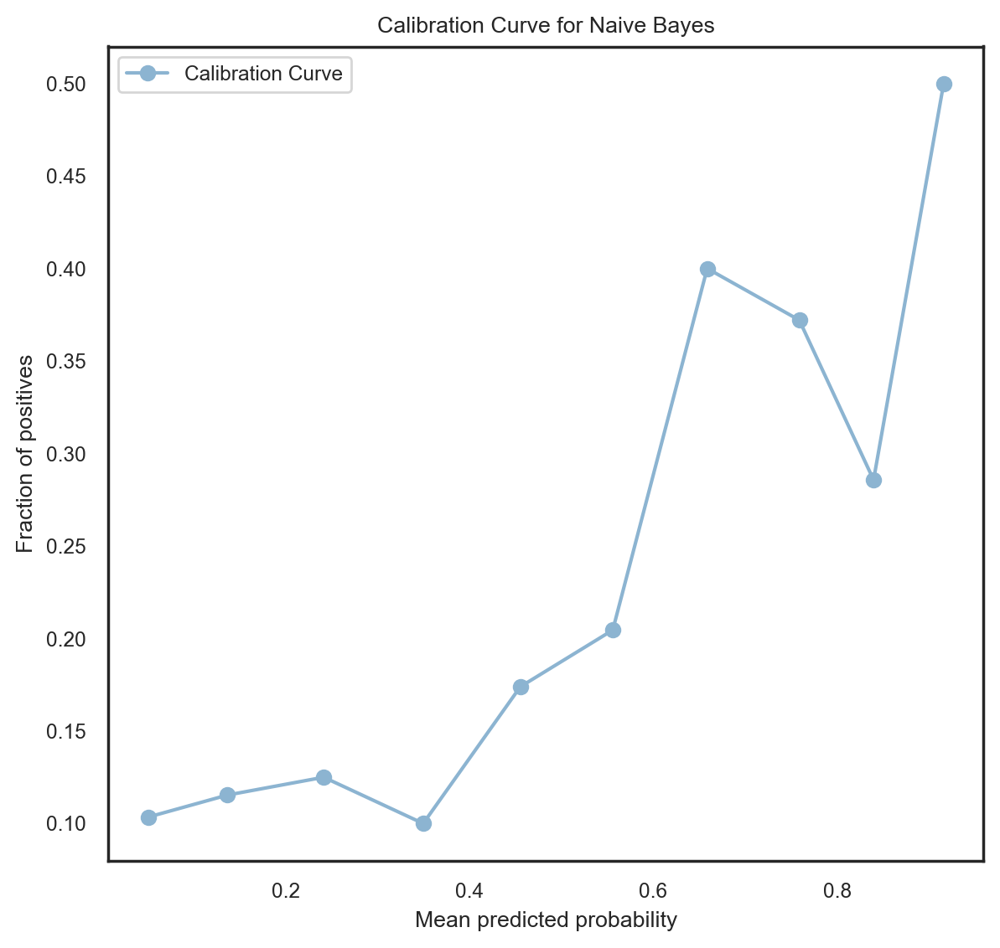

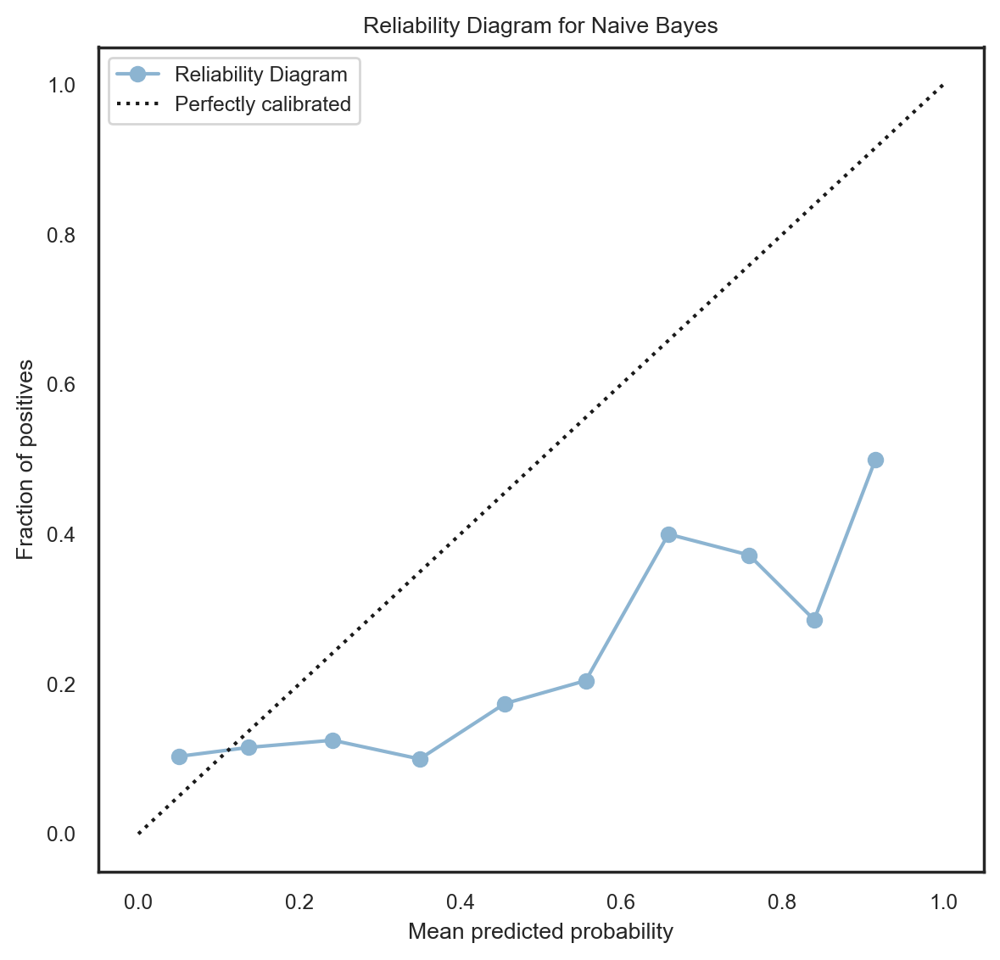

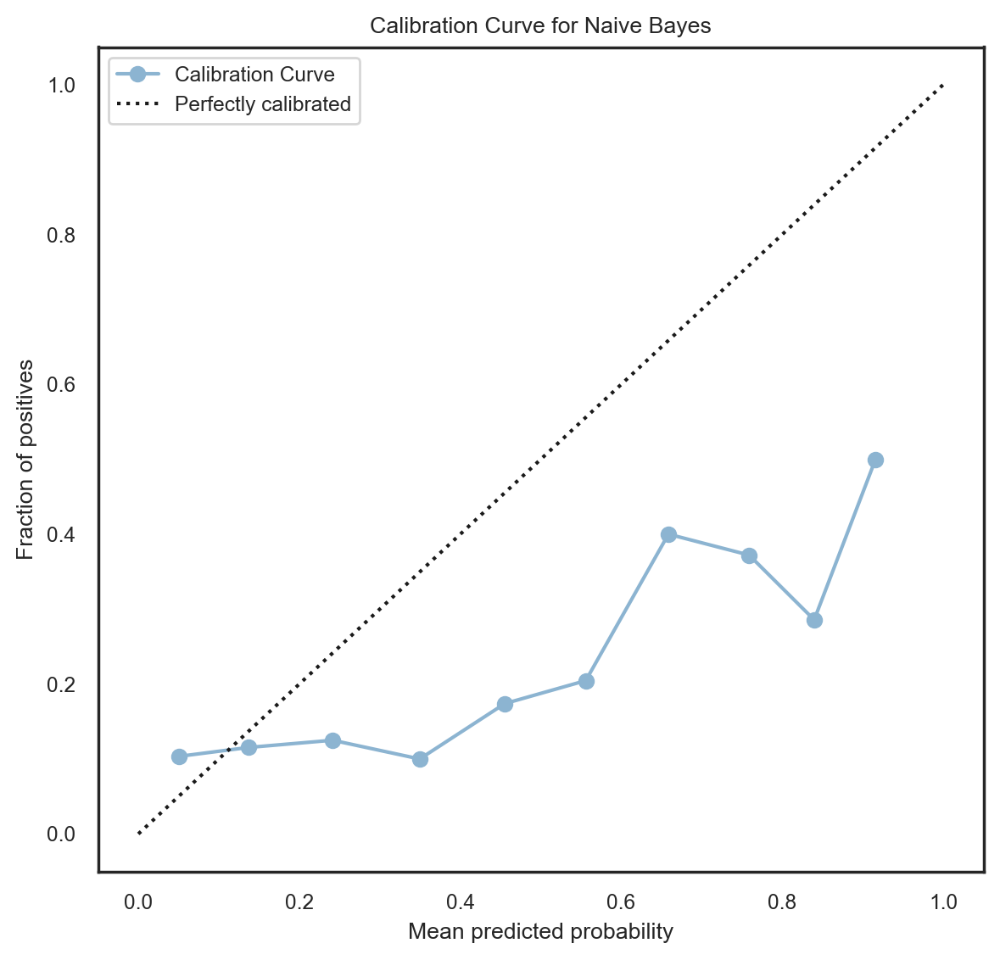

--- LDA ---
Jaccard score = 0.2440944881889764
F1 score = 0.3924050632911392
Accuracy = 0.5914893617021276
Matthews Correlation Coefficient = 0.17375736699205055
Precision = 0.28440366972477066
ROC AUC = 0.6771999122229537
Brier score = 0.24452939639467552
Log loss = 0.6746087809285612
Recall = 0.6326530612244898
Confusion Matrix:
[[108  78]
 [ 18  31]]


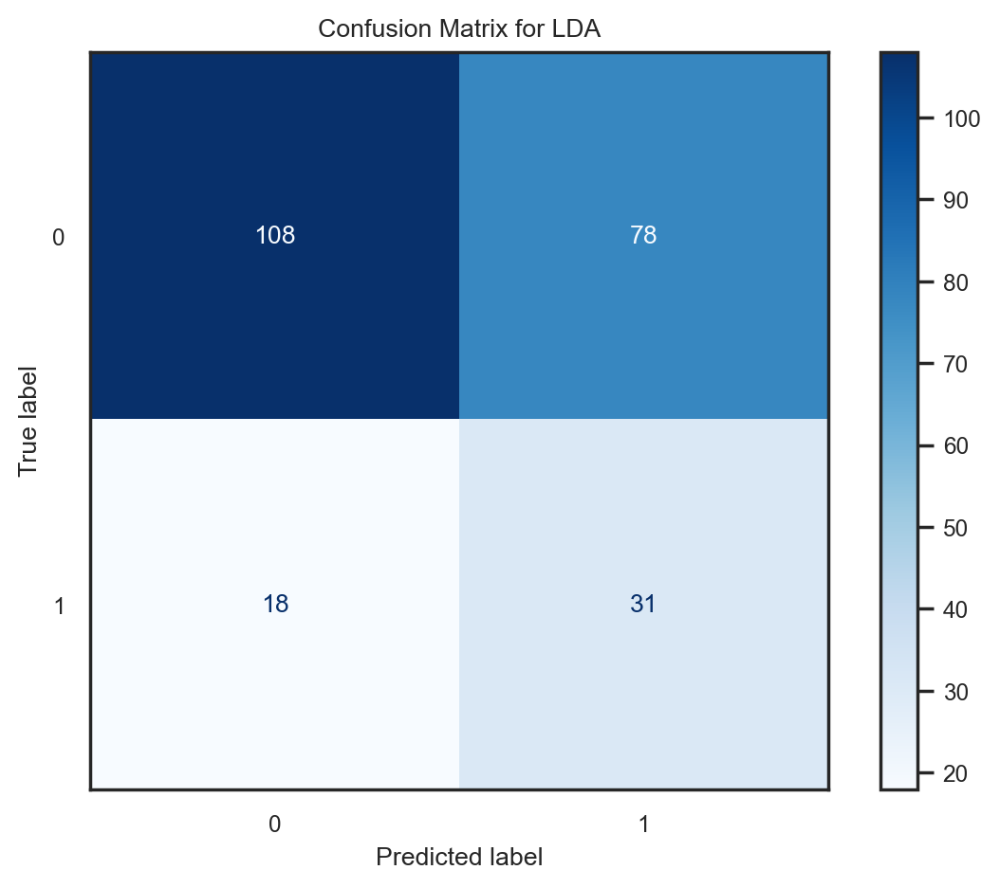

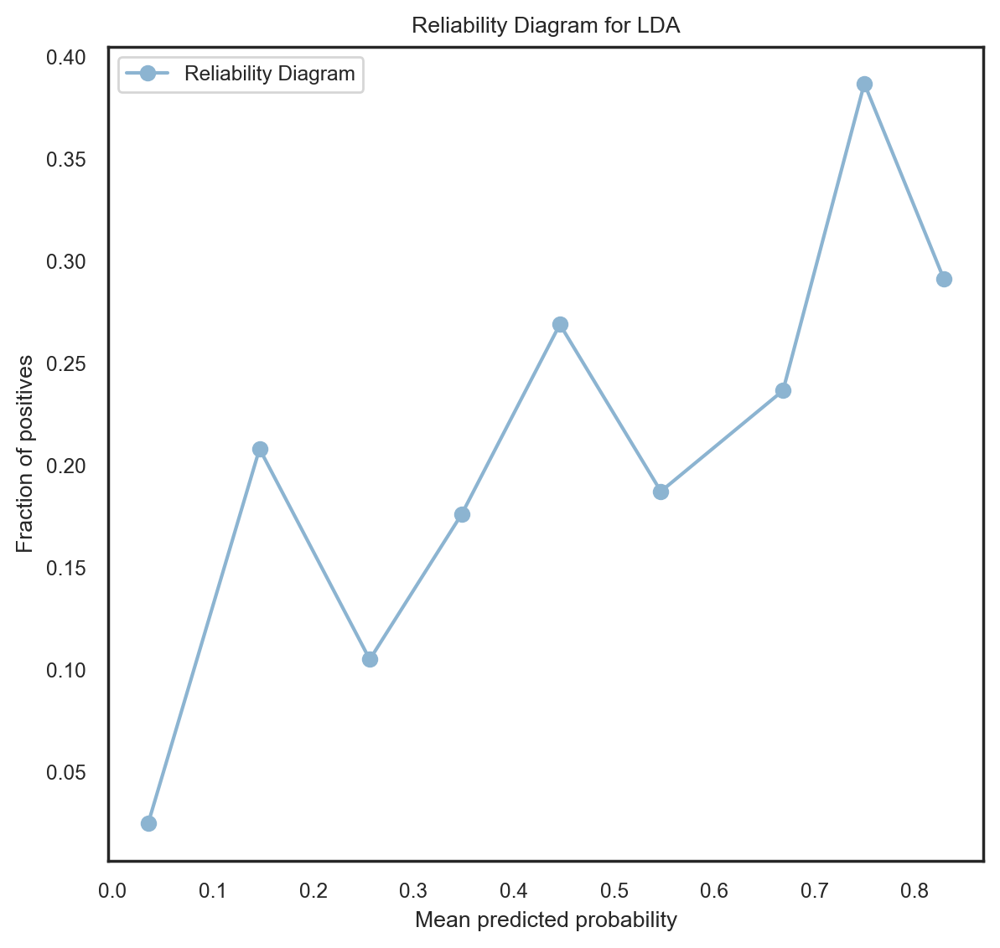

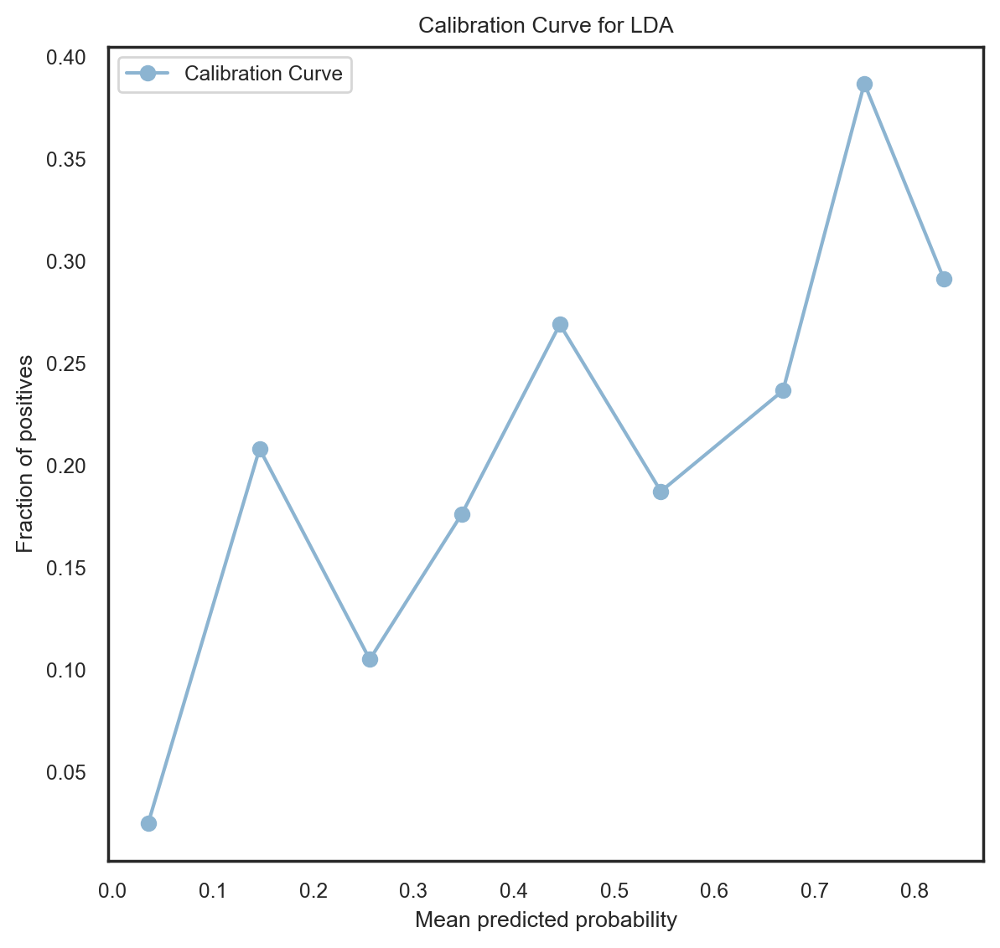

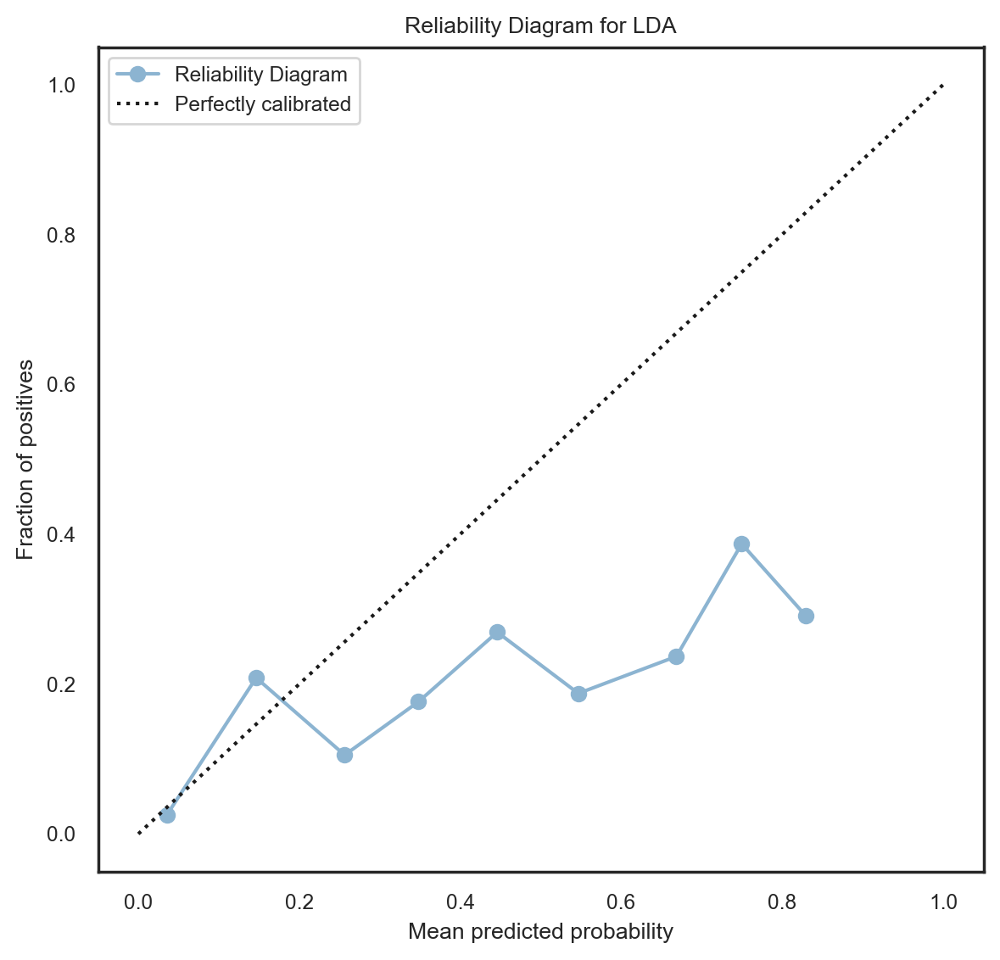

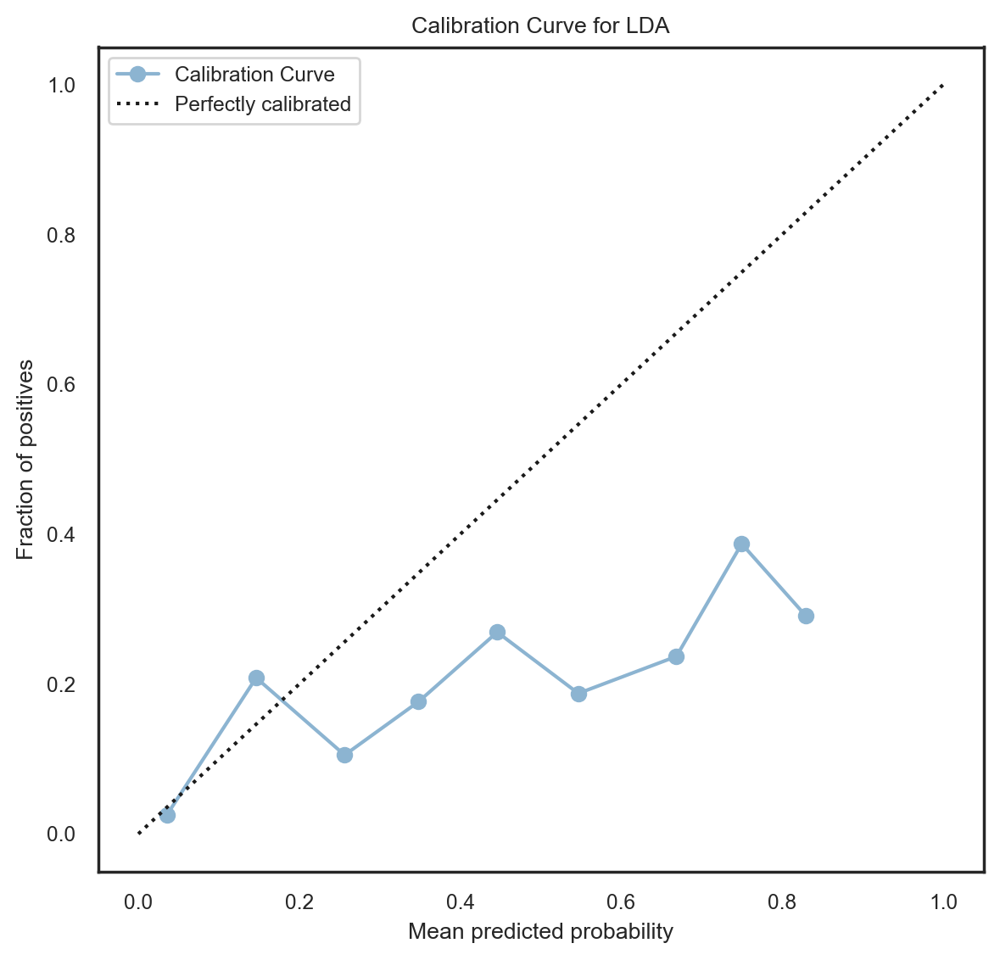

--- SVM ---
Jaccard score = 0.23148148148148148
F1 score = 0.37593984962406013
Accuracy = 0.6468085106382979
Matthews Correlation Coefficient = 0.16359996659452197
Precision = 0.2976190476190476
ROC AUC = 0.6614000438885231
Brier score = 0.2283219145483367
Log loss = 0.6473697176491112
Recall = 0.5102040816326531
Confusion Matrix:
[[127  59]
 [ 24  25]]


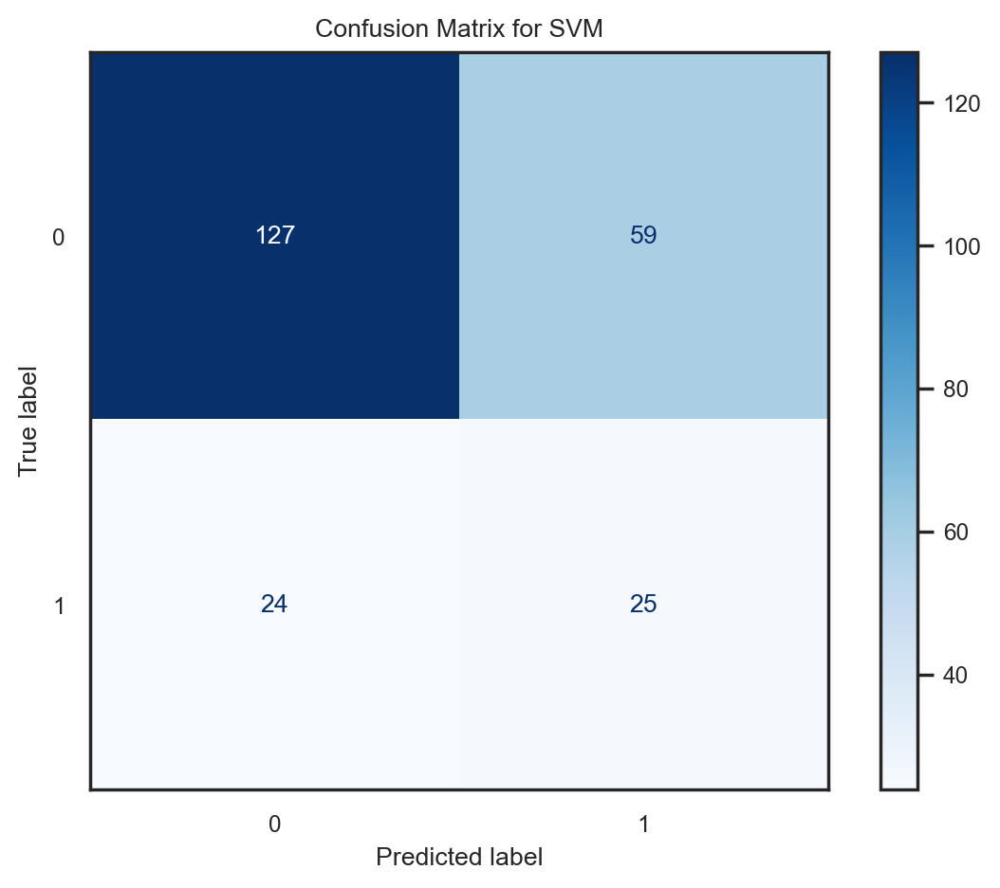

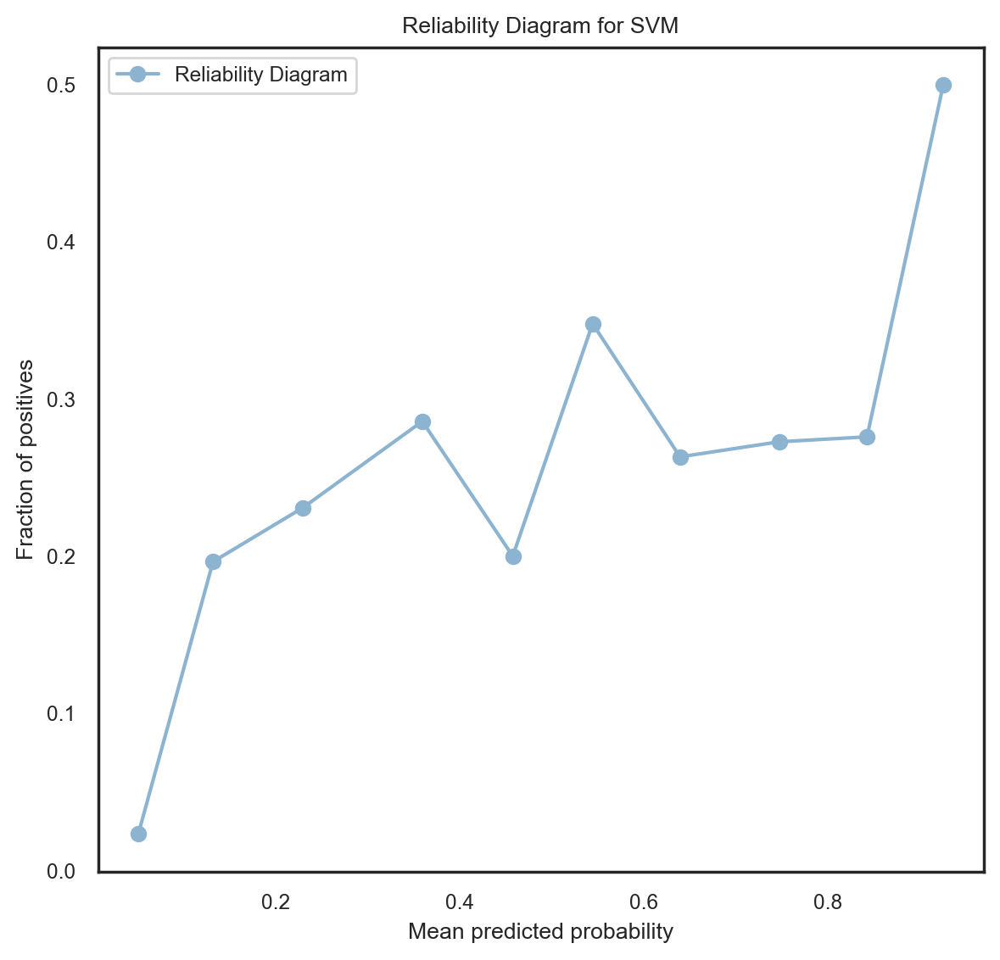

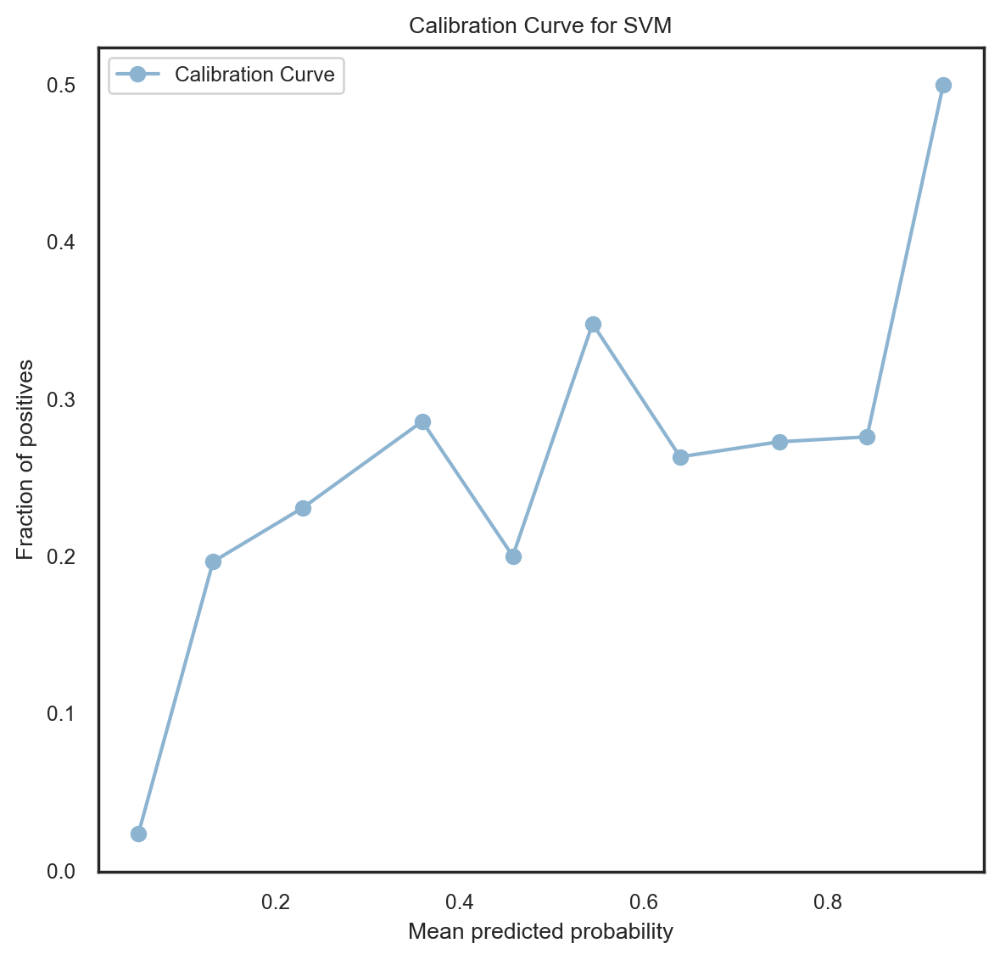

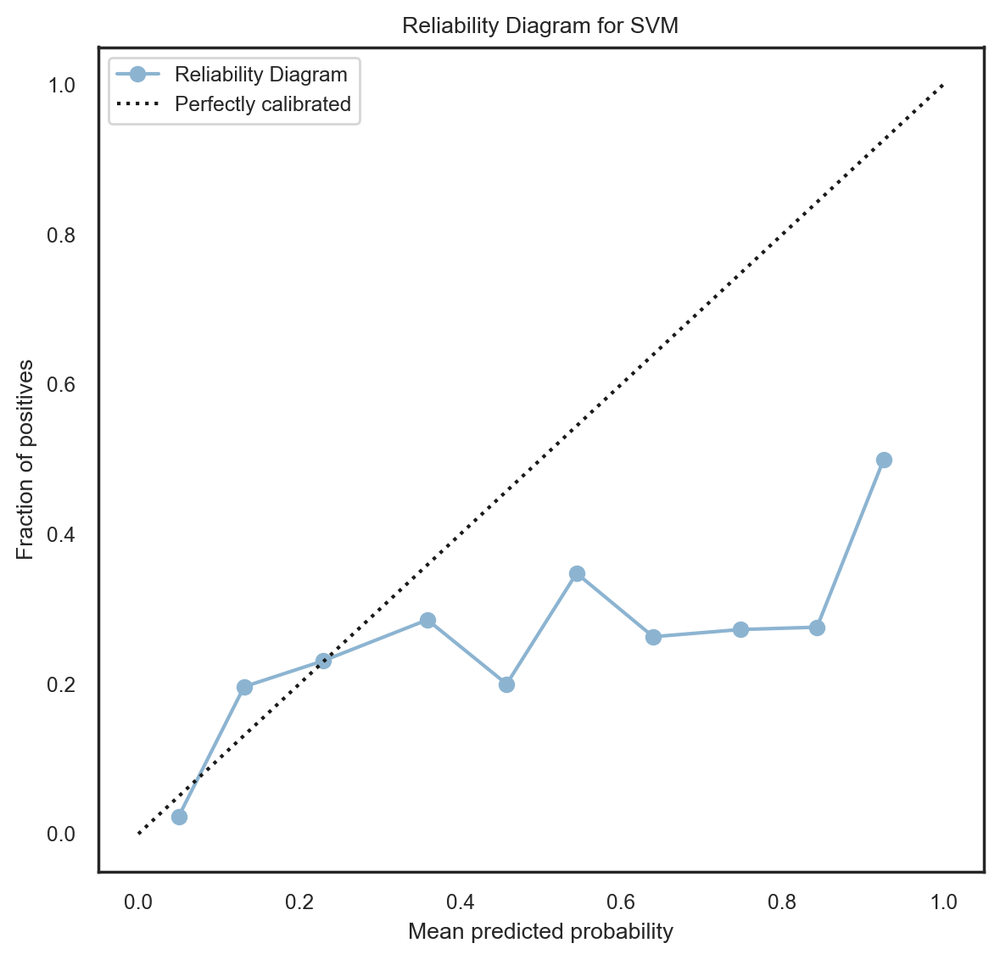

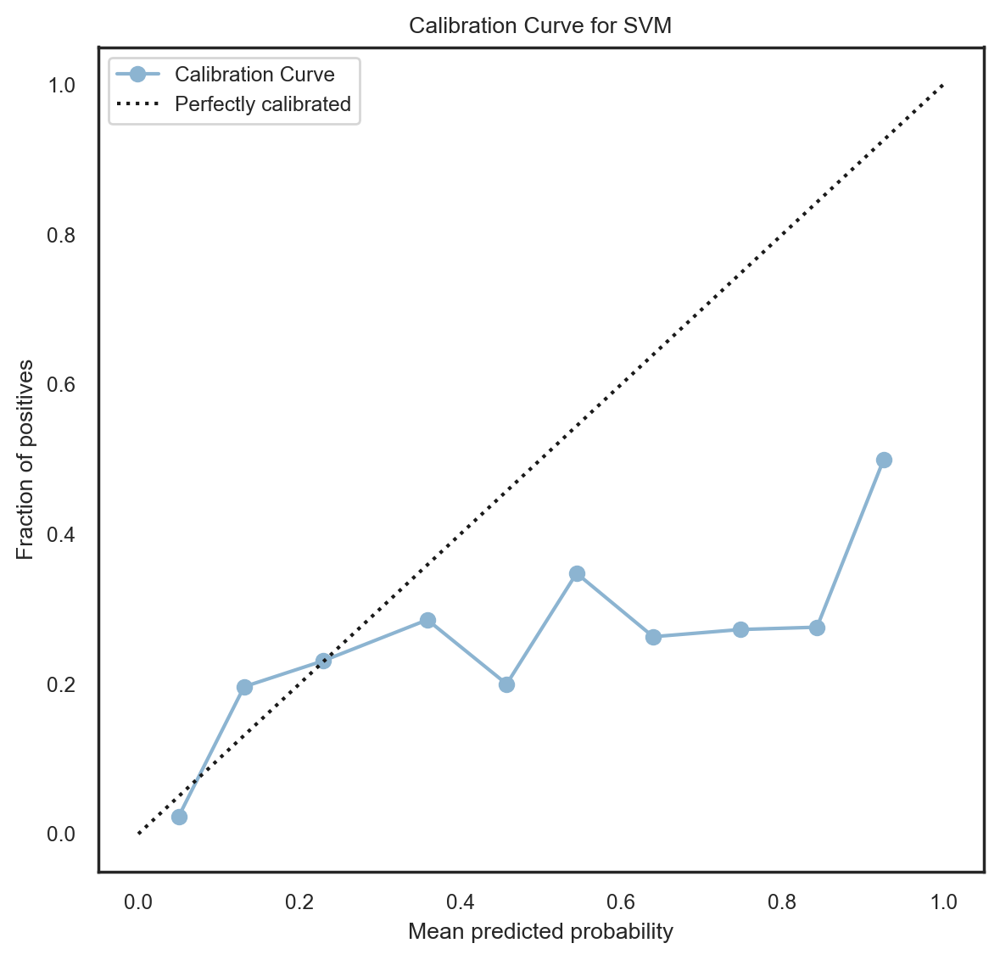

--- Decision Tree ---
Jaccard score = 0.19540229885057472
F1 score = 0.3269230769230769
Accuracy = 0.7021276595744681
Matthews Correlation Coefficient = 0.13685833208833248
Precision = 0.3090909090909091
ROC AUC = 0.5930436690805354
Brier score = 0.20648786569779137
Log loss = 0.6024968299081654
Recall = 0.3469387755102041
Confusion Matrix:
[[148  38]
 [ 32  17]]


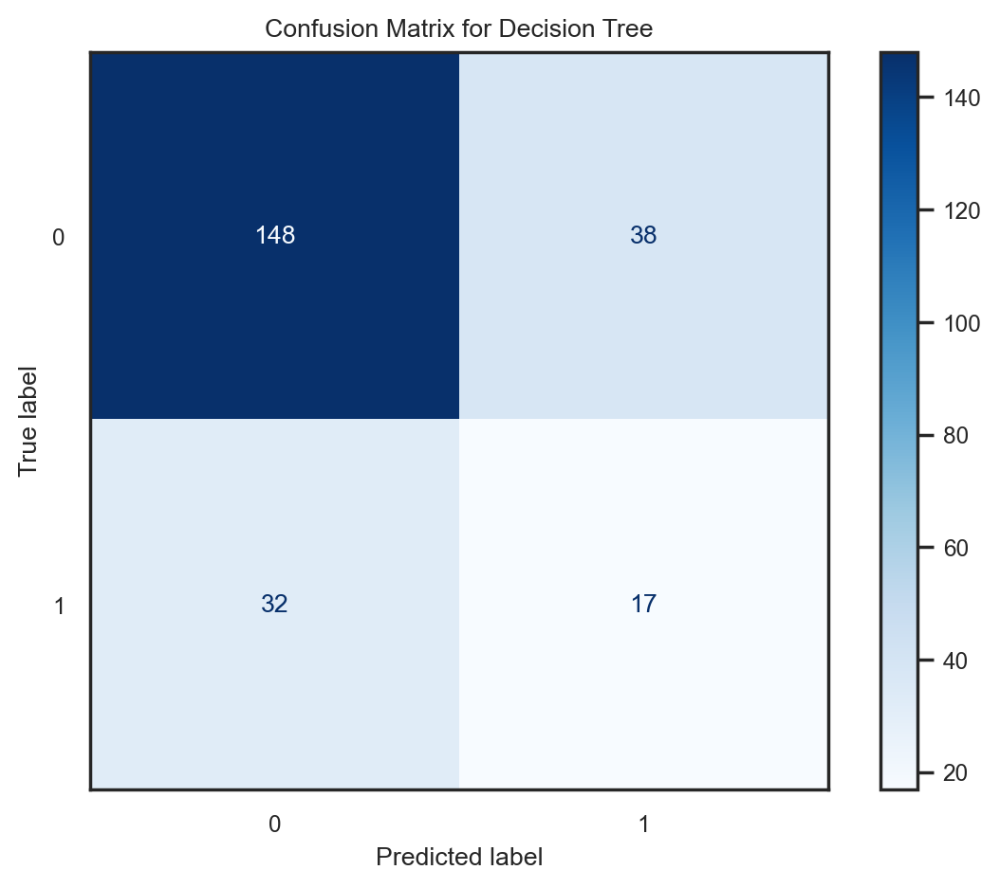

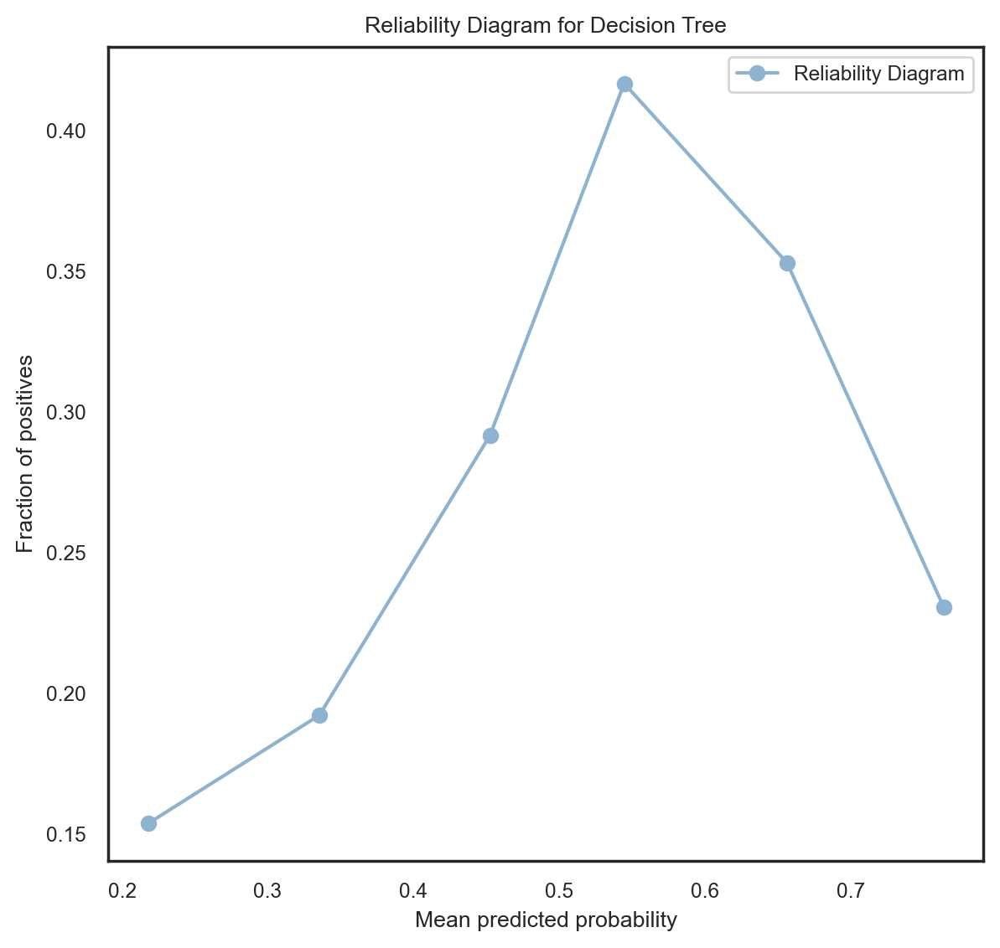

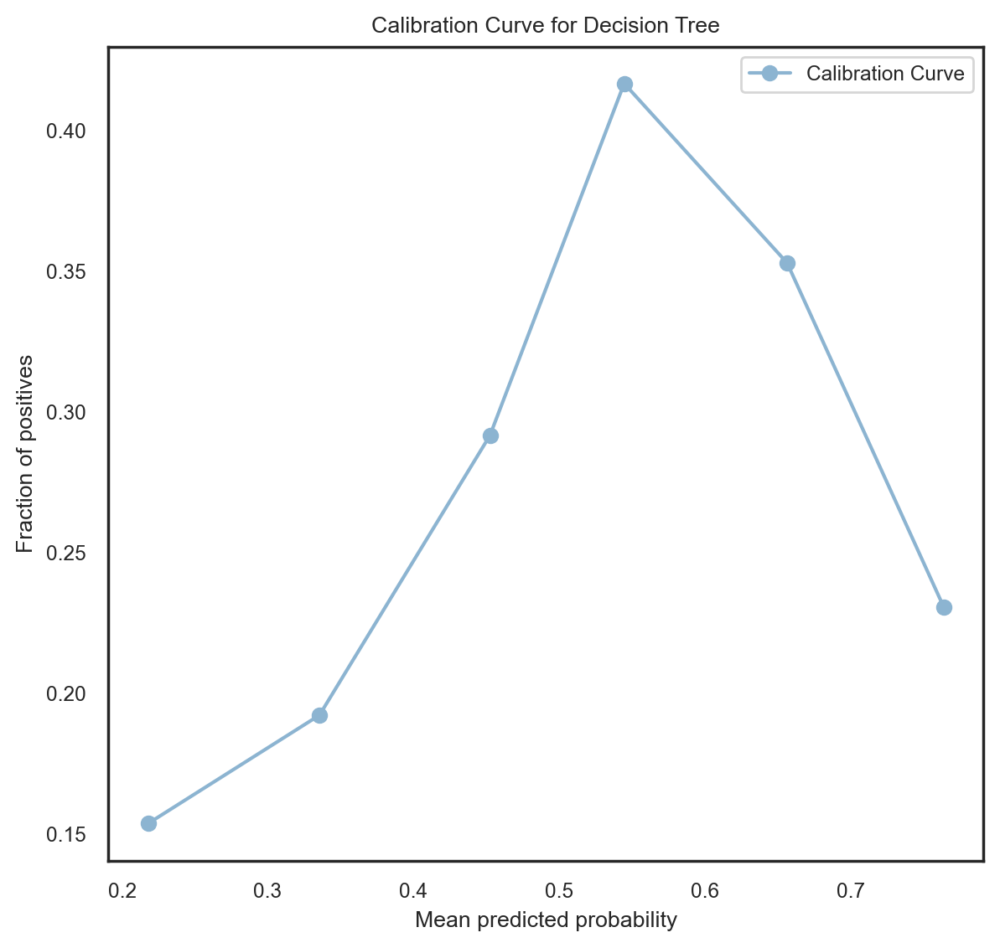

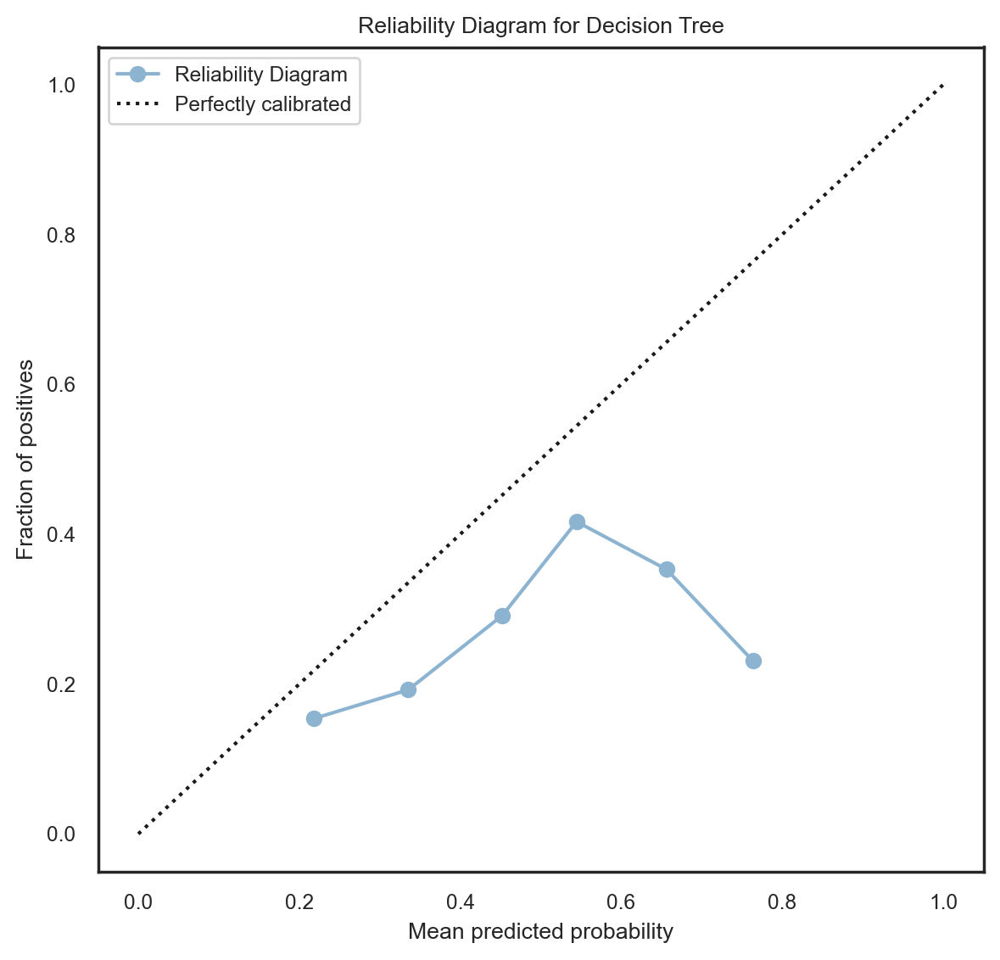

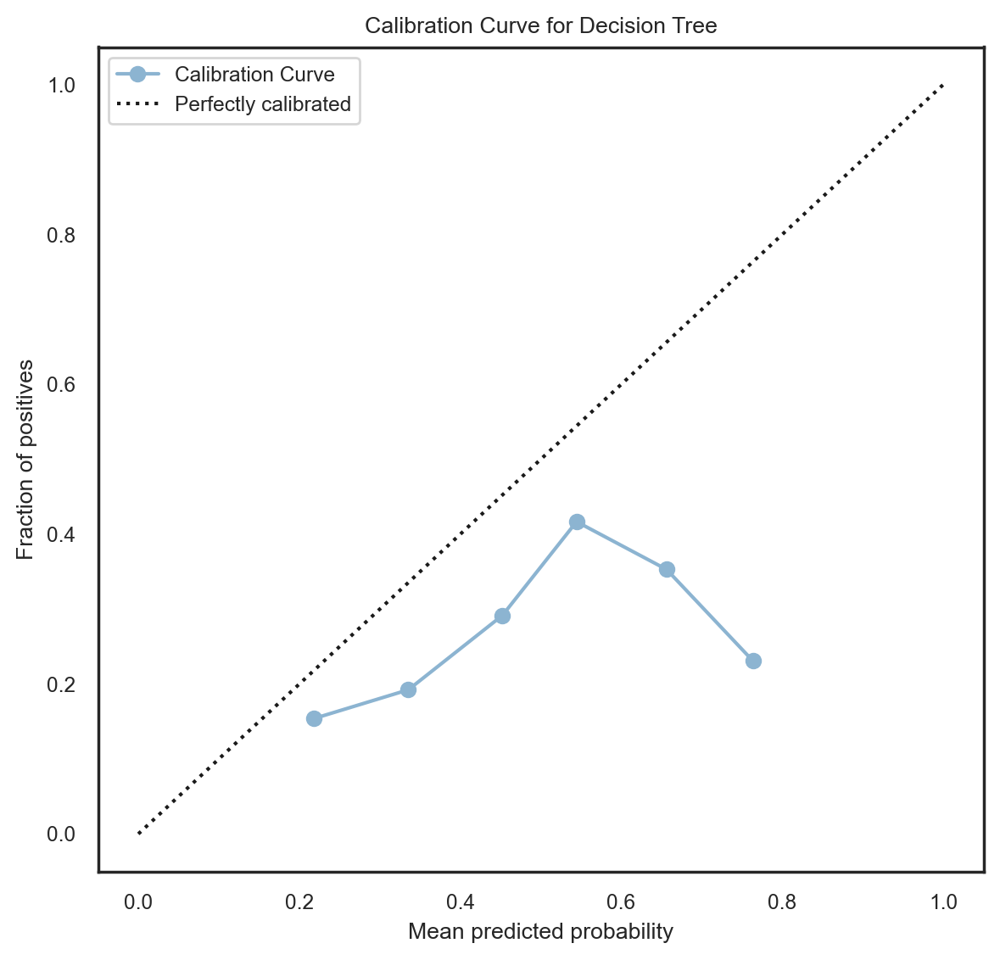

In [ ]:
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import jaccard_score, f1_score, accuracy_score, matthews_corrcoef, precision_score, roc_auc_score


# Prepare the models
models = [
    ('Logistic Regression', LogisticRegression(max_iter=1000)),
    ('KNN', KNeighborsClassifier(n_neighbors=3)),
    ('Naive Bayes', GaussianNB()),
    ('LDA', LinearDiscriminantAnalysis()),
    ('SVM', SVC()),
    ('Decision Tree', DecisionTreeClassifier())
]

# Iterate over models
for name, model in models:
    print(f'--- {name} ---')
    calibrated = CalibratedClassifierCV(model, method='isotonic', cv=5)
    calibrated.fit(X_train_resampled, y_train_resampled)
    y_pred = calibrated.predict(X_test)
    y_prob = calibrated.predict_proba(X_test)[:, 1]  # For ROC AUC

    # print metrics
    print('Jaccard score = {}'.format(jaccard_score(y_test, y_pred, average='binary')))
    print('F1 score = {}'.format(f1_score(y_test, y_pred)))
    print('Accuracy = {}'.format(accuracy_score(y_test, y_pred)))
    print('Matthews Correlation Coefficient = {}'.format(matthews_corrcoef(y_test, y_pred)))
    print('Precision = {}'.format(precision_score(y_test, y_pred)))
    print('ROC AUC = {}'.format(roc_auc_score(y_test, y_prob)))
    print('Brier score = {}'.format(brier_score_loss(y_test, y_prob)))
    print('Log loss = {}'.format(log_loss(y_test, y_prob)))
    print('Recall = {}'.format(recall_score(y_test, y_pred)))

       # Calculate the confusion matrix
    conf_matrix = confusion_matrix(y_test, y_pred)
    print('Confusion Matrix:')
    print(conf_matrix)
    plot_confusion_matrix(calibrated, X_test, y_test, cmap='Blues')
    plt.title(f'Confusion Matrix for {name}')
    plt.show()
    '''
    plt.figure(figsize=(8, 6))
        sns.heatmap(conf_matrix_calibrated, annot=True, fmt='d', cmap='Blues',
                    xticklabels=['Predicted Negative', 'Predicted Positive'],
                    yticklabels=['Actual Negative', 'Actual Positive'])
        plt.xlabel('Predicted Label')
        plt.ylabel('True Label')
        plt.title(f'Confusion Matrix for {key} Calibrated Predictions')
        plt.show()
'''

     # Plot the reliability diagram
    prob_true, prob_pred = sklearn_calibration_curve(y_test, y_prob, n_bins=10)
    plt.figure(figsize=(6, 6))
    plt.plot(prob_pred, prob_true, marker='o', label='Reliability Diagram')
    plt.xlabel("Mean predicted probability")
    plt.ylabel("Fraction of positives")
    plt.title(f'Reliability Diagram for {name}')
    plt.legend()
    plt.show()


    # Plot the calibration curve
    fraction_of_positives, mean_predicted_value = calibration_curve(y_test, y_prob, n_bins=10)
    plt.figure(figsize=(6, 6))
    plt.plot(mean_predicted_value, fraction_of_positives, marker='o', label='Calibration Curve')
    plt.xlabel("Mean predicted probability")
    plt.ylabel("Fraction of positives")
    plt.title(f'Calibration Curve for {name}')
    plt.legend()
    plt.show()

     # Plot the reliability diagram
    prob_true, prob_pred = sklearn_calibration_curve(y_test, y_prob, n_bins=10)
    plt.figure(figsize=(6, 6))
    plt.plot(prob_pred, prob_true, marker='o', label='Reliability Diagram')
    plt.plot([0, 1], [0, 1], "k:", label="Perfectly calibrated")  # Standard calibration curve
    plt.xlabel("Mean predicted probability")
    plt.ylabel("Fraction of positives")
    plt.title(f'Reliability Diagram for {name}')
    plt.legend()
    plt.show()

    # Plot the calibration curve
    fraction_of_positives, mean_predicted_value = sklearn_calibration_curve(y_test, y_prob, n_bins=10)
    plt.figure(figsize=(6, 6))
    plt.plot(mean_predicted_value, fraction_of_positives, marker='o', label='Calibration Curve')
    plt.plot([0, 1], [0, 1], "k:", label="Perfectly calibrated")  # Standard calibration curve
    plt.xlabel("Mean predicted probability")
    plt.ylabel("Fraction of positives")
    plt.title(f'Calibration Curve for {name}')
    plt.legend()
    plt.show()


    # ... (remaining metrics printing)


# SIMULATED DATASET

To generate simulated imbalanced data with the described characteristics in Python, you can use the NumPy library to create the data and scikit-learn to introduce noise, cluster the data, and add random labels. Here's a sample code that accomplishes this task:
In this code:

1. We set the parameters for the number of samples, features, informative features, redundant features, clusters per class, and the probability of the minority class.

2. We create informative features using `make_classification` from scikit-learn. This generates features that help distinguish between classes.

3. We generate random noise features using NumPy.

4. We combine informative and noise features to create the final feature matrix `X`.

5. We introduce the class separator parameter by adding random values to the first feature of the data.

6. We introduce random labels (approximately 5% of samples have randomly assigned labels) to simulate the imbalanced dataset.

7. Finally, we print the class distribution to verify the imbalance.

You can use the `X` and `y` arrays for further machine learning experiments and algorithms on this simulated imbalanced dataset.

In [ ]:
import numpy as np
from sklearn.datasets import make_blobs
from sklearn.datasets import make_classification

# Set random seed for reproducibility
np.random.seed(42)

# Parameters
n_samples = 500
n_features = 20
n_informative = 10
n_redundant = 5
n_clusters_per_class = 2
p_minority_class = 0.1

# Create informative features
X_informative, _ = make_classification(
    n_samples=n_samples,
    n_features=n_informative,
    n_redundant=n_redundant,
    n_clusters_per_class=n_clusters_per_class,
    weights=[1 - p_minority_class, p_minority_class],
)

# Create random noise features
X_noise = np.random.rand(n_samples, n_features - n_informative - n_redundant)

# Combine informative and noise features
X = np.hstack((X_informative, X_noise))

# Introduce class separator parameter
class_separator = np.random.rand(n_samples, 1)
X[:, 0] += class_separator.squeeze()

# Introduce random labels (approximately 5%)
y = np.random.randint(2, size=n_samples)

# Check class distribution
unique, counts = np.unique(y, return_counts=True)
class_distribution = dict(zip(unique, counts))
print("Class Distribution:", class_distribution)




Class Distribution: {0: 256, 1: 244}


In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import accuracy_score, f1_score, precision_score, matthews_corrcoef, roc_auc_score, recall_score, jaccard_score, brier_score_loss, log_loss
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize classifiers
classifiers = {
    "Logistic Regression": LogisticRegression(),
    "Naive Bayes": GaussianNB(),
    "Linear Discriminant Analysis": LinearDiscriminantAnalysis(),
    "Support Vector Machine": SVC(probability=True),
    "Decision Tree": DecisionTreeClassifier(),
    "K-Nearest Neighbor": KNeighborsClassifier(),
}

# Evaluate classifiers and apply calibration
results = {}

for name, classifier in classifiers.items():
    classifier.fit(X_train, y_train)

    # Predict probabilities for calibration
    y_pred_proba = classifier.predict_proba(X_test)[:, 1]

    # Uncalibrated metrics
    y_pred = classifier.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    mcc = matthews_corrcoef(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred_proba)
    recall = recall_score(y_test, y_pred)

    # Calibrate the classifier
    calibrated_classifier = CalibratedClassifierCV(classifier, method="sigmoid", cv="prefit")
    calibrated_classifier.fit(X_train, y_train)

    # Predict probabilities after calibration
    y_calibrated_proba = calibrated_classifier.predict_proba(X_test)[:, 1]

    # Calibrated metrics
    y_calibrated_pred = calibrated_classifier.predict(X_test)
    jaccard = jaccard_score(y_test, y_calibrated_pred)
    brier = brier_score_loss(y_test, y_calibrated_proba)
    logloss = log_loss(y_test, y_calibrated_proba)

    results[name] = {
        "Uncalibrated Metrics": {
            "Accuracy": accuracy,
            "F1-Score": f1,
            "Precision": precision,
            "Matthews Correlation Coefficient": mcc,
            "ROC-AUC Score": roc_auc,
            "Recall": recall,
        },
        "Calibrated Metrics (Sigmoid)": {
            "Jaccard Score": jaccard,
            "Brier Score": brier,
            "Log Loss": logloss,
        },
    }

# Print the results
for name, metrics in results.items():
    print(f"Classifier: {name}")
    for metric_name, metric_value in metrics.items():
        print(f"{metric_name}: {metric_value}")
    print()


Classifier: Logistic Regression
Uncalibrated Metrics: {'Accuracy': 0.53, 'F1-Score': 0.5252525252525253, 'Precision': 0.5098039215686274, 'Matthews Correlation Coefficient': 0.0608608718377616, 'ROC-AUC Score': 0.5296474358974359, 'Recall': 0.5416666666666666}
Calibrated Metrics (Sigmoid): {'Jaccard Score': 0.3561643835616438, 'Brier Score': 0.2499903330845867, 'Log Loss': 0.6931432941401683}

Classifier: Naive Bayes
Uncalibrated Metrics: {'Accuracy': 0.51, 'F1-Score': 0.5585585585585586, 'Precision': 0.49206349206349204, 'Matthews Correlation Coefficient': 0.031507951262355866, 'ROC-AUC Score': 0.5528846153846154, 'Recall': 0.6458333333333334}
Calibrated Metrics (Sigmoid): {'Jaccard Score': 0.3815789473684211, 'Brier Score': 0.24844151348076352, 'Log Loss': 0.6899505232722309}

Classifier: Linear Discriminant Analysis
Uncalibrated Metrics: {'Accuracy': 0.51, 'F1-Score': 0.5050505050505051, 'Precision': 0.49019607843137253, 'Matthews Correlation Coefficient': 0.020820824576076338, 'ROC

In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.calibration import CalibratedClassifierCV
from sklearn.metrics import accuracy_score, f1_score, precision_score, matthews_corrcoef, roc_auc_score, recall_score, jaccard_score, brier_score_loss, log_loss
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Initialize classifiers
classifiers = {
    "Logistic Regression": LogisticRegression(),
    "Naive Bayes": GaussianNB(),
    "Linear Discriminant Analysis": LinearDiscriminantAnalysis(),
    "Support Vector Machine": SVC(probability=True),
    "Decision Tree": DecisionTreeClassifier(),
    "K-Nearest Neighbor": KNeighborsClassifier(),
}

# Evaluate classifiers and apply calibration
results = {}

for name, classifier in classifiers.items():
    classifier.fit(X_train, y_train)

    # Predict probabilities for calibration
    y_pred_proba = classifier.predict_proba(X_test)[:, 1]

    # Uncalibrated metrics
    y_pred = classifier.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred)
    mcc = matthews_corrcoef(y_test, y_pred)
    roc_auc = roc_auc_score(y_test, y_pred_proba)
    recall = recall_score(y_test, y_pred)

    # Calibrate the classifier
    calibrated_classifier = CalibratedClassifierCV(classifier, method="isotonic", cv="prefit")
    calibrated_classifier.fit(X_train, y_train)

    # Predict probabilities after calibration
    y_calibrated_proba = calibrated_classifier.predict_proba(X_test)[:, 1]

    # Calibrated metrics
    y_calibrated_pred = calibrated_classifier.predict(X_test)
    jaccard = jaccard_score(y_test, y_calibrated_pred)
    brier = brier_score_loss(y_test, y_calibrated_proba)
    logloss = log_loss(y_test, y_calibrated_proba)

    results[name] = {
        "Uncalibrated Metrics": {
            "Accuracy": accuracy,
            "F1-Score": f1,
            "Precision": precision,
            "Matthews Correlation Coefficient": mcc,
            "ROC-AUC Score": roc_auc,
            "Recall": recall,
        },
        "Calibrated Metrics (Isotonic)": {
            "Jaccard Score": jaccard,
            "Brier Score": brier,
            "Log Loss": logloss,
        },
    }

# Print the results
for name, metrics in results.items():
    print(f"Classifier: {name}")
    for metric_name, metric_value in metrics.items():
        print(f"{metric_name}: {metric_value}")
    print()


Classifier: Logistic Regression
Uncalibrated Metrics: {'Accuracy': 0.53, 'F1-Score': 0.5252525252525253, 'Precision': 0.5098039215686274, 'Matthews Correlation Coefficient': 0.0608608718377616, 'ROC-AUC Score': 0.5296474358974359, 'Recall': 0.5416666666666666}
Calibrated Metrics (Isotonic): {'Jaccard Score': 0.37662337662337664, 'Brier Score': 0.2505475033550836, 'Log Loss': 0.6942792823476449}

Classifier: Naive Bayes
Uncalibrated Metrics: {'Accuracy': 0.51, 'F1-Score': 0.5585585585585586, 'Precision': 0.49206349206349204, 'Matthews Correlation Coefficient': 0.031507951262355866, 'ROC-AUC Score': 0.5528846153846154, 'Recall': 0.6458333333333334}
Calibrated Metrics (Isotonic): {'Jaccard Score': 0.39759036144578314, 'Brier Score': 0.2622321911163541, 'Log Loss': 1.3657036683267234}

Classifier: Linear Discriminant Analysis
Uncalibrated Metrics: {'Accuracy': 0.51, 'F1-Score': 0.5050505050505051, 'Precision': 0.49019607843137253, 'Matthews Correlation Coefficient': 0.020820824576076338, '